In [4]:
from skimage.segmentation import find_boundaries
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from skimage.morphology import binary_dilation
import numpy as np
import math
import matplotlib.pyplot as plt
from skimage import draw
get_ipython().run_line_magic('matplotlib', 'inline')
from heapq import nsmallest
#from sklearn import preprocessing
from mpl_toolkits import mplot3d
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

import tifffile as tiff
from numpy import asarray
import numpy as np
import matplotlib.pyplot as plt
w0 = 10
sigma = 5


# credit to: https://jaidevd.github.io/posts/weighted-loss-functions-for-instance-segmentation/

def make_weight_map(masks):
    """
    Generate the weight maps as specified in the UNet paper
    for a set of binary masks.
    
    Parameters
    ----------
    masks: array-like
        A 3D array of shape (n_masks, image_height, image_width),
        where each slice of the matrix along the 0th axis represents one binary mask.

    Returns
    -------
    array-like
        A 2D array of shape (image_height, image_width)
    
    """
    nrows, ncols = masks.shape[1:]
    print("nrows,ncols:",nrows,ncols) # the size of the canvas
    masks = (masks > 0).astype(int) # make sure all numbers are greater than 0
    
    distMap = np.zeros((nrows * ncols, masks.shape[0])) 
    # placeholder that will become weight_map matrix
    
    X1, Y1 = np.meshgrid(np.arange(nrows), np.arange(ncols))
    X1, Y1 = np.c_[X1.ravel(), Y1.ravel()].T
    # a giant flatten matrix with X1 and Y1 being the x-y coordinates
    print("X1.shape",X1.shape)
    print("Y1.shape",Y1.shape)
    
    
    for i, mask in enumerate(masks): # each mask is a circle, NOT a layer
        # find the boundary of each mask, using skilearn
        bounds = find_boundaries(mask, mode='outer')
        X2, Y2 = np.nonzero(bounds)
        print("X2.shape",X2.shape)
        print("Y2.shape",Y2.shape)
        
        
        # X1 is all pixel indices, X2 is all boundary pixel indices
        # xSum is computes the sum distance between one pixel to *every* boundary pixel, and
        # repeat this for every pixel.
        xSum = (X2.reshape(-1, 1) - X1.reshape(1, -1)) ** 2
        ySum = (Y2.reshape(-1, 1) - Y1.reshape(1, -1)) ** 2
        print("xSum.shape",xSum.shape)
        print("ySum.shape",ySum.shape)
        
        if len(X2) == 0 and len(Y2) == 0:
            loss = np.zeros((nrows, ncols))
            return loss
        else: 
            # finally, Pythagorean theorem (already squared above) to calculate the normal distance
            # from the current pixel to *all* boundar. Do this for every pixel
            distMap[:, i] = np.sqrt(xSum + ySum).min(axis=0)
            print("distMap:",distMap)
        
        
    ix = np.arange(distMap.shape[0])
    print("ix:",ix) # ix is index for all the pixel in the image. If there
    # are nrow*ncol, then there are nrow*ncol pixels. ix is all the way upto
    # nrow*ncol
    
    if distMap.shape[1] == 1: # if there is only one shape on the image
        d1 = distMap.ravel()
        border_loss_map = w0 * np.exp((-1 * (d1) ** 2) / (2 * (sigma ** 2)))
    else: # if there are more shapes on the image
        if distMap.shape[1] == 2:
            d1_ix, d2_ix = np.argpartition(distMap, 1, axis=1)[:, :2].T
        else:
            d1_ix, d2_ix = np.argpartition(distMap, 2, axis=1)[:, :2].T
        
        # argpartition is a very efficient way to sort the element in distMap
        # and find the index of minimum and second minimum 
        print("d1_ix:", d1_ix)
        print("d2_ix:",d2_ix) 
        
        d1 = distMap[ix, d1_ix]
        d2 = distMap[ix, d2_ix] # finally, find that actual distance by indexing distMap
        
        border_loss_map = w0 * np.exp((-1 * (d1 + d2) ** 2) / (2 * (sigma ** 2)))
    
    xBLoss = np.zeros((nrows, ncols))
    xBLoss[X1, Y1] = border_loss_map
    
    # class weight map
    loss = np.zeros((nrows, ncols))
    w_1 = 1 - masks.sum() / loss.size
    w_0 = 1 - w_1
    loss[masks.sum(0) == 1] = w_1
    loss[masks.sum(0) == 0] = w_0
    ZZ = xBLoss + loss
    return ZZ

In [6]:
__author__ = "Sreenivas Bhattiprolu"
__license__ = "Feel free to copy, I appreciate if you acknowledge Python for Microscopists"

# https://www.youtube.com/watch?v=68HR_eyzk00
# https://www.youtube.com/watch?v=cUHPL_dk17E&list=PLZsOBAyNTZwYuFfht61R0b-N1TNIX5_Vy&index=7


"""
@author: Sreenivas Bhattiprolu
"""

import tensorflow as tf
import os
import random
import numpy as np
from skimage.io import imread,imshow
from skimage.transform import resize

from tqdm import tqdm
import matplotlib.pyplot as plt

IMG_WIDTH = 128
IMG_HEIGHT = 128
IMG_CHANNELS = 3 # what is the number of possible values of each pixel

TRAIN_PATH = 'stage1_train/'
TEST_PATH = 'stage1_test/'

# train image preprocessing
train_ids = next(os.walk(TRAIN_PATH))[1]
test_ids = next(os.walk(TEST_PATH))[1] # read the folder one by one in stage_train 

X_train = np.zeros((len(train_ids),IMG_HEIGHT,IMG_WIDTH,IMG_CHANNELS),dtype=np.uint8)
Y_train = np.zeros((len(train_ids),IMG_HEIGHT,IMG_WIDTH,1),dtype=np.bool)
train_weightmap = np.zeros((len(train_ids),IMG_HEIGHT,IMG_WIDTH,1),dtype=np.uint8)
# an empty array that will be updated once we read the image

print('Resizing training images and masks')
# great way to read all the images at once and put them in a huge tuple 
for n,id_ in tqdm(enumerate(train_ids),total=len(train_ids)):
    path = TRAIN_PATH + id_
    img = imread(path + '/images/' + id_ + '.png')[:,:,:IMG_CHANNELS]
    img = resize(img,(IMG_HEIGHT,IMG_WIDTH),mode='constant',preserve_range=True)
    X_train[n] = img
    mask = np.zeros((IMG_HEIGHT,IMG_WIDTH,1),dtype=np.bool) # empty arrays with all zeros
    
    cell_idx = 0
    MASK_PATH = path+'/masks/'
    mask_ids = next(os.walk(MASK_PATH))[2] # a list of all the mask filename
    num_of_masks = len(mask_ids) # the total number of masks
    cell_labels_ind = np.zeros((num_of_masks,IMG_HEIGHT,IMG_WIDTH)) # create a new matrix that takes out individual cells.
        # first dimension is the number of items, second and third dimension is the size of the canvas
    for mask_file in next(os.walk(path+'/masks/'))[2]:
        mask_ = imread(path+'/masks/'+mask_file) # arrays that represent each mask for a particular raw image. 
            # remember, there are many masks for one image because each cell has its own mask

        mask_ = np.expand_dims(resize(mask_,(IMG_HEIGHT,IMG_WIDTH),
                                          mode='constant',preserve_range=True),axis=-1) # resize each image

        mask = np.maximum(mask,mask_) # by taking the maximum between mask and mask_, we update mask to contain
            # all the information in the original image, i.e. when the pixel value is not zer

        iscell_idx = np.where(mask_ == 255) # find, for each individual cell's mask, where the cell is, or pixel value == 1
            # return two arrays, which consists of the xy coordinate
        #print(iscell_idx)

        temp = np.zeros((IMG_HEIGHT,IMG_WIDTH))

        for a in range(len(iscell_idx[0])):
                x_idx = iscell_idx[0][a]
                y_idx = iscell_idx[1][a]
                temp[x_idx][y_idx] = 1  
        cell_labels_ind[cell_idx,:,:] = temp
        #print(np.where(cell_labels_ind == 1))

        cell_idx += 1 # update the index, because I'm too lazy to get the length of how many masks there are
            #print("the weight map input is")
            #print(np.where(cell_labels_ind[10,:,:] ==1))

    print(cell_labels_ind)
    Y_train[n] = mask
    wmap = make_weight_map(cell_labels_ind)
    wmap = np.expand_dims(wmap,axis = 2)
    print(wmap.shape)
    train_weightmap[n] = wmap

  0%|          | 0/670 [00:00<?, ?it/s]

Resizing training images and masks
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 

('xSum.shape', (50, 16384))
('ySum.shape', (50, 16384))
('distMap:', array([[167.59773268, 151.16216458, 143.83671298, ...,   0.        ,
          0.        ,   0.        ],
       [166.88319268, 150.3362897 , 143.08738589, ...,   0.        ,
          0.        ,   0.        ],
       [166.17159805, 149.51254128, 142.34113952, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [  3.        ,  38.01315562,  29.06888371, ...,   0.        ,
          0.        ,   0.        ],
       [  4.        ,  38.        ,  29.52964612, ...,   0.        ,
          0.        ,   0.        ],
       [  5.        ,  38.        ,  29.96664813, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (40,))
('Y2.shape', (40,))
('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[167.59773268, 151.16216458, 143.83671298, ...,   0.        ,
          0.        ,   0.        ],
       [166.88319268, 150.3362897 , 143.08738589, ...,   0.       

  0%|          | 2/670 [00:00<02:47,  3.98it/s]

('distMap:', array([[167.59773268, 151.16216458, 143.83671298, ...,   0.        ,
          0.        ,   0.        ],
       [166.88319268, 150.3362897 , 143.08738589, ...,   0.        ,
          0.        ,   0.        ],
       [166.17159805, 149.51254128, 142.34113952, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [  3.        ,  38.01315562,  29.06888371, ...,   0.        ,
          0.        ,   0.        ],
       [  4.        ,  38.        ,  29.52964612, ...,   0.        ,
          0.        ,   0.        ],
       [  5.        ,  38.        ,  29.96664813, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[167.59773268, 151.16216458, 143.83671298, ...,   0.        ,
          0.        ,   0.        ],
       [166.88319268, 150.3362897 , 143.08738589, ...,   0.        ,
          0.        ,   0.        ],
       [166.1715

  0%|          | 3/670 [00:00<02:47,  3.97it/s]

('distMap:', array([[ 90.47098983, 121.1981848 ,  78.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 89.55445271, 120.74767078,  78.00640999, ...,   0.        ,
          0.        ,   0.        ],
       [ 88.63972022, 120.30378215,  78.02563681, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 76.69419796,  61.81423784, 131.24404748, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.07788269,  62.80127387, 132.18925826, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.47257579,  63.78871374, 133.13526956, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (25,))
('Y2.shape', (25,))
('xSum.shape', (25, 16384))
('ySum.shape', (25, 16384))
('distMap:', array([[ 90.47098983, 121.1981848 ,  78.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 89.55445271, 120.74767078,  78.00640999, ...,   0.        ,
          0.        ,   0.        ],
       [ 88.6397

  1%|          | 4/670 [00:01<02:46,  4.00it/s]

('distMap:', array([[ 28.28427125,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 27.29468813,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 26.30589288,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [136.45878499,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.01094847,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.56816492,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[ 28.28427125, 111.80339887,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 27.29468813, 111.07204869,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 26.3058

  1%|          | 6/670 [00:01<02:08,  5.17it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

  1%|▏         | 9/670 [00:01<01:32,  7.14it/s]

('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[149.03690818, 146.50938536, 125.        , ...,   0.        ,
          0.        ,   0.        ],
       [148.39474384, 145.83552379, 124.06449935, ...,   0.        ,
          0.        ,   0.        ],
       [147.75655654, 145.16542288, 123.13001259, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 26.2488095 ,  25.55386468,  76.00657866, ...,   0.        ,
          0.        ,   0.        ],
       [ 27.20294102,  26.41968963,  76.02631123, ...,   0.        ,
          0.        ,   0.        ],
       [ 28.16025568,  27.29468813,  76.05918748, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[149.03690818, 146.50938536, 125.        , ...,   0.        ,
          0.        ,   0.        ],
       [148.39474384, 145.

  1%|▏         | 10/670 [00:01<01:47,  6.16it/s]

('distMap:', array([[ 51.623638  , 100.17983829,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 50.7740091 ,  99.74467404,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 49.92995093,  99.31767214,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [118.1058847 ,  81.59656856,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [118.80235688,  82.54089895,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [119.50313803,  83.48652586,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (36,))
('Y2.shape', (36,))
('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[ 51.623638  , 100.17983829, 154.98709624, ...,   0.        ,
          0.        ,   0.        ],
       [ 50.7740091 ,  99.74467404, 154.25303887, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.9299

  2%|▏         | 13/670 [00:02<02:23,  4.59it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

  2%|▏         | 14/670 [00:02<02:23,  4.58it/s]

('xSum.shape', (61, 16384))
('ySum.shape', (61, 16384))
('distMap:', array([[122.33151679,  82.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [121.62236636,  82.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [120.91732713,  82.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 36.23534186, 116.41735266,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 36.87817783, 117.38824473,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 37.53664876, 118.35962149,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (72,))
('Y2.shape', (72,))
('xSum.shape', (72, 16384))
('ySum.shape', (72, 16384))
('distMap:', array([[122.33151679,  82.        ,  96.60745313, ...,   0.        ,
          0.        ,   0.        ],
       [121.62236636,  82.        ,  95.8018789 , ...,   0.       

('distMap:', array([[121.80722474,  24.73863375, 106.56922633, ...,   0.        ,
          0.        ,   0.        ],
       [120.83045974,  23.76972865, 106.47065323, ...,   0.        ,
          0.        ,   0.        ],
       [119.85407794,  22.8035085 , 106.38138935, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 92.00543462, 145.71547619, 111.01801656, ...,   0.        ,
          0.        ,   0.        ],
       [ 92.02173656, 146.34889819, 112.00892822, ...,   0.        ,
          0.        ,   0.        ],
       [ 92.04890005, 146.98639393, 113.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[121.80722474,  24.73863375, 106.56922633, ...,   0.        ,
          0.        ,   0.        ],
       [120.83045974,  23.76972865, 106.47065323, ...,   0.        ,
          0.        ,   0.        ],
       [119.8540

  2%|▏         | 16/670 [00:02<02:12,  4.93it/s]

('distMap:', array([[111.        ,  19.        ,  84.07734534, ...,   0.        ,
          0.        ,   0.        ],
       [111.        ,  19.        ,  83.18653737, ...,   0.        ,
          0.        ,   0.        ],
       [111.00450441,  19.02629759,  82.29823813, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [120.33702672, 154.30165262,  89.89438247, ...,   0.        ,
          0.        ,   0.        ],
       [121.33424908, 155.08062419,  90.35485598, ...,   0.        ,
          0.        ,   0.        ],
       [122.33151679, 155.86211855,  90.82400564, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (46,))
('Y2.shape', (46,))
('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[111.        ,  19.        ,  84.07734534, ...,   0.        ,
          0.        ,   0.        ],
       [111.        ,  19.        ,  83.18653737, ...,   0.        ,
          0.        ,   0.        ],
       [111.0045

('distMap:', array([[128.42507543,  97.1699542 , 149.03690818, ...,   0.        ,
          0.        ,   0.        ],
       [127.6636205 ,  96.25487001, 148.39474384, ...,   0.        ,
          0.        ,   0.        ],
       [126.90547664,  95.34149149, 147.75655654, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 46.06517123,  86.97700846,  17.4642492 , ...,   0.        ,
          0.        ,   0.        ],
       [ 46.5295605 ,  87.31551981,  18.38477631, ...,   0.        ,
          0.        ,   0.        ],
       [ 47.01063709,  87.66413178,  19.31320792, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (36,))
('Y2.shape', (36,))
('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[128.42507543,  97.1699542 , 149.03690818, ...,   0.        ,
          0.        ,   0.        ],
       [127.6636205 ,  96.25487001, 148.39474384, ...,   0.        ,
          0.        ,   0.        ],
       [126.9054

('distMap:', array([[128.42507543,  97.1699542 , 149.03690818, ...,   0.        ,
          0.        ,   0.        ],
       [127.6636205 ,  96.25487001, 148.39474384, ...,   0.        ,
          0.        ,   0.        ],
       [126.90547664,  95.34149149, 147.75655654, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 46.06517123,  86.97700846,  17.4642492 , ...,   0.        ,
          0.        ,   0.        ],
       [ 46.5295605 ,  87.31551981,  18.38477631, ...,   0.        ,
          0.        ,   0.        ],
       [ 47.01063709,  87.66413178,  19.31320792, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[128.42507543,  97.1699542 , 149.03690818, ...,   0.        ,
          0.        ,   0.        ],
       [127.6636205 ,  96.25487001, 148.39474384, ...,   0.        ,
          0.        ,   0.        ],
       [126.9054

  3%|▎         | 17/670 [00:03<03:14,  3.35it/s]

('d1_ix:', array([ 4,  4,  4, ..., 10, 10, 10]))
('d2_ix:', array([53, 53, 53, ...,  2,  2,  2]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0

  3%|▎         | 18/670 [00:03<03:32,  3.07it/s]

('distMap:', array([[171.8982257 , 149.01342221, 109.20164834, ...,   0.        ,
          0.        ,   0.        ],
       [171.17242769, 148.22280526, 108.60018416, ...,   0.        ,
          0.        ,   0.        ],
       [170.44940598, 147.43473132, 108.00462953, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [  2.82842712,  24.33105012,  59.9082632 , ...,   0.        ,
          0.        ,   0.        ],
       [  2.23606798,  24.51530134,  60.74537019, ...,   0.        ,
          0.        ,   0.        ],
       [  2.        ,  24.73863375,  61.58733636, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (8,))
('Y2.shape', (8,))
('xSum.shape', (8, 16384))
('ySum.shape', (8, 16384))
('distMap:', array([[171.8982257 , 149.01342221, 109.20164834, ...,   0.        ,
          0.        ,   0.        ],
       [171.17242769, 148.22280526, 108.60018416, ...,   0.        ,
          0.        ,   0.        ],
       [170.44940598

  3%|▎         | 19/670 [00:03<02:54,  3.73it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

  3%|▎         | 21/670 [00:04<02:29,  4.34it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [1. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [0. 0. 1. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

  3%|▎         | 22/670 [00:04<03:05,  3.49it/s]

('xSum.shape', (23, 16384))
('ySum.shape', (23, 16384))
('distMap:', array([[ 97.86214794, 126.46343345,  53.81449619, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.49871794, 125.53883861,  53.07541804, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.14422268, 124.61540836,  52.34500931, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 85.72630868,  74.24284477, 114.62983905, ...,   0.        ,
          0.        ,   0.        ],
       [ 86.68333173,  74.33034374, 115.31261856, ...,   0.        ,
          0.        ,   0.        ],
       [ 87.64131446,  74.43117626, 116.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 97.86214794, 126.46343345,  53.81449619, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.49871794, 125.53883861,  53.07541804, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

  3%|▎         | 23/670 [00:04<03:19,  3.24it/s]

('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 41.03656906,  83.95236745,  81.46778504, ...,   0.        ,
          0.        ,   0.        ],
       [ 40.36087214,  83.74365648,  80.72174428, ...,   0.        ,
          0.        ,   0.        ],
       [ 39.69886648,  83.5463943 ,  79.9812478 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [130.8166656 , 110.30865787,  92.09777413, ...,   0.        ,
          0.        ,   0.        ],
       [131.5218613 , 111.23398761,  92.76313923, ...,   0.        ,
          0.        ,   0.        ],
       [132.23085873, 112.16059914,  93.43446901, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (15,))
('Y2.shape', (15,))
('xSum.shape', (15, 16384))
('ySum.shape', (15, 16384))
('distMap:', array([[ 41.03656906,  83.95236745,  81.46778504, ...,   0.        ,
          0.        ,   0.        ],
       [ 40.36087214,  83.

  4%|▎         | 25/670 [00:05<02:27,  4.38it/s]

('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 63.2455532 ,  18.02775638, 129.02712893, ...,   0.        ,
          0.        ,   0.        ],
       [ 62.42595614,  17.49285568, 128.08200498, ...,   0.        ,
          0.        ,   0.        ],
       [ 61.6116872 ,  17.        , 127.1377206 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [111.04053314, 154.8967398 ,  81.        , ...,   0.        ,
          0.        ,   0.        ],
       [111.6646766 , 155.6213353 ,  81.        , ...,   0.        ,
          0.        ,   0.        ],
       [112.29425631, 156.34896866,  81.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 63.2455532 ,  18.02775638, 129.02712893, ...,   0.        ,
          0.        ,   0.        ],
       [ 62.42595614,  17.

  4%|▍         | 26/670 [00:05<02:17,  4.67it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[147.55676874, 108.40664186, 124.91997438, ...,   0.        ,
          0.        ,   0.        ],
       [146.73104648, 107.91200119, 124.61942064, ...,   0.        ,
          0.        ,   0.        ],
       [145.90750495, 107.42439202, 124.32618389, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 34.0147027 ,  69.35416354,  77.1621669 , ...,   0.        ,
          0.        ,   0.        ],
       [ 34.        ,  70.26378868,  78.16009212, ...,   0.        ,
          0.        ,   0.        ],
       [ 34.0147027 ,  71.1758386 ,  79.15806971, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[147.55676874, 108.40664186, 124.91997438, ...,   0.        ,
          0.        ,   0.        ],
       [146.73104648, 107.91200119, 124.61942064, ...,   0.        ,
          0.        ,   0.        ],
       [145.9075

  4%|▍         | 27/670 [00:05<03:15,  3.28it/s]

('distMap:', array([[147.55676874, 108.40664186, 124.91997438, ..., 101.11874208,
          0.        ,   0.        ],
       [146.73104648, 107.91200119, 124.61942064, ..., 100.40916293,
          0.        ,   0.        ],
       [145.90750495, 107.42439202, 124.32618389, ...,  99.70456359,
          0.        ,   0.        ],
       ...,
       [ 34.0147027 ,  69.35416354,  77.1621669 , ...,  61.61980201,
          0.        ,   0.        ],
       [ 34.        ,  70.26378868,  78.16009212, ...,  62.28964601,
          0.        ,   0.        ],
       [ 34.0147027 ,  71.1758386 ,  79.15806971, ...,  62.96824597,
          0.        ,   0.        ]]))
('X2.shape', (52,))
('Y2.shape', (52,))
('xSum.shape', (52, 16384))
('ySum.shape', (52, 16384))
('distMap:', array([[147.55676874, 108.40664186, 124.91997438, ..., 101.11874208,
        134.16407865,   0.        ],
       [146.73104648, 107.91200119, 124.61942064, ..., 100.40916293,
        133.71985642,   0.        ],
       [145.9075

  4%|▍         | 28/670 [00:06<03:07,  3.43it/s]

('distMap:', array([[  0.        ,  95.713113  ,  46.        , ...,   0.        ,
          0.        ,   0.        ],
       [  0.        ,  95.25754563,  45.        , ...,   0.        ,
          0.        ,   0.        ],
       [  0.        ,  94.81033699,  44.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [169.9176271 ,  81.39410298, 139.29106217, ...,   0.        ,
          0.        ,   0.        ],
       [170.59015212,  82.29216245, 139.7891269 , ...,   0.        ,
          0.        ,   0.        ],
       [171.26587518,  83.19254774, 140.29255148, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (58,))
('Y2.shape', (58,))
('xSum.shape', (58, 16384))
('ySum.shape', (58, 16384))
('distMap:', array([[  0.        ,  95.713113  ,  46.        , ...,   0.        ,
          0.        ,   0.        ],
       [  0.        ,  95.25754563,  45.        , ...,   0.        ,
          0.        ,   0.        ],
       [  0.    

('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 82.61961026,  59.77457654,  69.46221995, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.83520025,  59.48108943,  69.35416354, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.05553652,  59.20304046,  69.26037828, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 92.61749295, 123.71337842, 127.04723531, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.23625904, 124.55520864, 127.95311641, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.86160024, 125.39936204, 128.86038957, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[ 82.61961026,  59.77457654,  69.46221995, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.83520025,  59.

('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 82.61961026,  59.77457654,  69.46221995, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.83520025,  59.48108943,  69.35416354, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.05553652,  59.20304046,  69.26037828, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 92.61749295, 123.71337842, 127.04723531, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.23625904, 124.55520864, 127.95311641, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.86160024, 125.39936204, 128.86038957, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 82.61961026,  59.77457654,  69.46221995, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.83520025,  59.48108943,  69.35416354, ...,   0.       

('distMap:', array([[ 82.61961026,  59.77457654,  69.46221995, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.83520025,  59.48108943,  69.35416354, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.05553652,  59.20304046,  69.26037828, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 92.61749295, 123.71337842, 127.04723531, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.23625904, 124.55520864, 127.95311641, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.86160024, 125.39936204, 128.86038957, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 82.61961026,  59.77457654,  69.46221995, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.83520025,  59.48108943,  69.35416354, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.0555

('distMap:', array([[ 82.61961026,  59.77457654,  69.46221995, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.83520025,  59.48108943,  69.35416354, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.05553652,  59.20304046,  69.26037828, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 92.61749295, 123.71337842, 127.04723531, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.23625904, 124.55520864, 127.95311641, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.86160024, 125.39936204, 128.86038957, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 82.61961026,  59.77457654,  69.46221995, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.83520025,  59.48108943,  69.35416354, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.0555

('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 82.61961026,  59.77457654,  69.46221995, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.83520025,  59.48108943,  69.35416354, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.05553652,  59.20304046,  69.26037828, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 92.61749295, 123.71337842, 127.04723531, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.23625904, 124.55520864, 127.95311641, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.86160024, 125.39936204, 128.86038957, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[ 82.61961026,  59.77457654,  69.46221995, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.83520025,  59.48108943,  69.35416354, ...,   0.       

('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 82.61961026,  59.77457654,  69.46221995, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.83520025,  59.48108943,  69.35416354, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.05553652,  59.20304046,  69.26037828, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 92.61749295, 123.71337842, 127.04723531, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.23625904, 124.55520864, 127.95311641, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.86160024, 125.39936204, 128.86038957, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 82.61961026,  59.77457654,  69.46221995, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.83520025,  59.48108943,  69.35416354, ...,   0.       

  4%|▍         | 29/670 [00:08<08:59,  1.19it/s]

(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.

('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[120.        , 109.41663493, 128.03515142, ...,   0.        ,
          0.        ,   0.        ],
       [119.        , 108.55873986, 127.63228432, ...,   0.        ,
          0.        ,   0.        ],
       [118.        , 107.70329614, 127.23600119, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [124.        ,  74.33034374,  69.46221995, ...,   0.        ,
          0.        ,   0.        ],
       [124.        ,  74.67261881,  70.45565982, ...,   0.        ,
          0.        ,   0.        ],
       [124.00403219,  75.02666193,  71.44928271, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[120.        , 109.41663493, 128.03515142, ...,   0.        ,
          0.        ,   0.        ],
       [119.        , 108.

('distMap:', array([[120.        , 109.41663493, 128.03515142, ...,   0.        ,
          0.        ,   0.        ],
       [119.        , 108.55873986, 127.63228432, ...,   0.        ,
          0.        ,   0.        ],
       [118.        , 107.70329614, 127.23600119, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [124.        ,  74.33034374,  69.46221995, ...,   0.        ,
          0.        ,   0.        ],
       [124.        ,  74.67261881,  70.45565982, ...,   0.        ,
          0.        ,   0.        ],
       [124.00403219,  75.02666193,  71.44928271, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[120.        , 109.41663493, 128.03515142, ...,   0.        ,
          0.        ,   0.        ],
       [119.        , 108.55873986, 127.63228432, ...,   0.        ,
          0.        ,   0.        ],
       [118.    

('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[120.        , 109.41663493, 128.03515142, ...,   0.        ,
          0.        ,   0.        ],
       [119.        , 108.55873986, 127.63228432, ...,   0.        ,
          0.        ,   0.        ],
       [118.        , 107.70329614, 127.23600119, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [124.        ,  74.33034374,  69.46221995, ...,   0.        ,
          0.        ,   0.        ],
       [124.        ,  74.67261881,  70.45565982, ...,   0.        ,
          0.        ,   0.        ],
       [124.00403219,  75.02666193,  71.44928271, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[120.        , 109.41663493, 128.03515142, ...,   0.        ,
          0.        ,   0.        ],
       [119.        , 108.

  4%|▍         | 30/670 [00:09<10:17,  1.04it/s]

('distMap:', array([[120.        , 109.41663493, 128.03515142, ...,   0.        ,
          0.        ,   0.        ],
       [119.        , 108.55873986, 127.63228432, ...,   0.        ,
          0.        ,   0.        ],
       [118.        , 107.70329614, 127.23600119, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [124.        ,  74.33034374,  69.46221995, ...,   0.        ,
          0.        ,   0.        ],
       [124.        ,  74.67261881,  70.45565982, ...,   0.        ,
          0.        ,   0.        ],
       [124.00403219,  75.02666193,  71.44928271, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[120.        , 109.41663493, 128.03515142, ..., 102.83968106,
          0.        ,   0.        ],
       [119.        , 108.55873986, 127.63228432, ..., 102.6109156 ,
          0.        ,   0.        ],
       [118.    

('X2.shape', (44,))
('Y2.shape', (44,))
('xSum.shape', (44, 16384))
('ySum.shape', (44, 16384))
('distMap:', array([[118.33849754,  78.33900689, 126.76355943, ...,   0.        ,
          0.        ,   0.        ],
       [117.83462988,  78.10249676, 125.89678312, ...,   0.        ,
          0.        ,   0.        ],
       [117.33712115,  77.87810989, 125.03199591, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 66.73080248, 112.69871339,  62.80127387, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.67569726, 113.59577457,  62.96824597, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.62215386, 114.49454135,  63.15061362, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[118.33849754,  78.33900689, 126.76355943, ...,   0.        ,
          0.        ,   0.        ],
       [117.83462988,  78.

  5%|▍         | 31/670 [00:10<08:46,  1.21it/s]

('X2.shape', (39,))
('Y2.shape', (39,))
('xSum.shape', (39, 16384))
('ySum.shape', (39, 16384))
('distMap:', array([[118.33849754,  78.33900689, 126.76355943, ...,   0.        ,
          0.        ,   0.        ],
       [117.83462988,  78.10249676, 125.89678312, ...,   0.        ,
          0.        ,   0.        ],
       [117.33712115,  77.87810989, 125.03199591, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 66.73080248, 112.69871339,  62.80127387, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.67569726, 113.59577457,  62.96824597, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.62215386, 114.49454135,  63.15061362, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (25,))
('Y2.shape', (25,))
('xSum.shape', (25, 16384))
('ySum.shape', (25, 16384))
('distMap:', array([[118.33849754,  78.33900689, 126.76355943, ...,   0.        ,
          0.        ,   0.        ],
       [117.83462988,  78.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

  5%|▍         | 32/670 [00:10<07:19,  1.45it/s]

('distMap:', array([[127.75758295,  40.36087214,  94.66784037, ...,   0.        ,
          0.        ,   0.        ],
       [126.81088281,  39.69886648,  94.15412896, ...,   0.        ,
          0.        ,   0.        ],
       [125.86500705,  39.05124838,  93.64827815, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 83.00602388, 131.5218613 ,  86.092973  , ...,   0.        ,
          0.        ,   0.        ],
       [ 83.02409289, 132.23085873,  86.95401083, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.05419917, 132.94359706,  87.8179936 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[127.75758295,  40.36087214,  94.66784037, ...,   0.        ,
          0.        ,   0.        ],
       [126.81088281,  39.69886648,  94.15412896, ...,   0.        ,
          0.        ,   0.        ],
       [125.8650

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

  5%|▍         | 33/670 [00:11<06:59,  1.52it/s]

('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 94.42986816,  79.0569415 , 159.29846201, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.33981132,  79.0253124 , 158.67261894, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.26027795,  79.00632886, 158.0506248 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [113.50770899, 127.94530081,  19.10497317, ...,   0.        ,
          0.        ,   0.        ],
       [114.47707194, 128.87590931,  20.09975124, ...,   0.        ,
          0.        ,   0.        ],
       [115.44695752, 129.80754986,  21.09502311, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 94.42986816,  79.0569415 , 159.29846201, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.33981132,  79.0253124 , 158.67261894, ...,   0.       

('distMap:', array([[ 64.        ,  71.02816343,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 64.00781202,  71.0070419 ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 64.03124237,  71.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [134.18271126, 128.03515142,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [135.08515833, 128.94960256,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [135.98897014, 129.86531485,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (44,))
('Y2.shape', (44,))
('xSum.shape', (44, 16384))
('ySum.shape', (44, 16384))
('distMap:', array([[ 64.        ,  71.02816343,  88.29496022, ...,   0.        ,
          0.        ,   0.        ],
       [ 64.00781202,  71.0070419 ,  88.07383266, ...,   0.        ,
          0.        ,   0.        ],
       [ 64.0312

  5%|▌         | 34/670 [00:11<06:10,  1.72it/s]

('distMap:', array([[ 64.        ,  71.02816343,  88.29496022, ...,   0.        ,
          0.        ,   0.        ],
       [ 64.00781202,  71.0070419 ,  88.07383266, ...,   0.        ,
          0.        ,   0.        ],
       [ 64.03124237,  71.        ,  87.86353055, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [134.18271126, 128.03515142, 103.40696302, ...,   0.        ,
          0.        ,   0.        ],
       [135.08515833, 128.94960256, 104.35516279, ...,   0.        ,
          0.        ,   0.        ],
       [135.98897014, 129.86531485, 105.3043209 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 64.        ,  71.02816343,  88.29496022, ...,   0.        ,
          0.        ,   0.        ],
       [ 64.00781202,  71.0070419 ,  88.07383266, ...,   0.        ,
          0.        ,   0.        ],
       [ 64.0312

  5%|▌         | 35/670 [00:11<04:59,  2.12it/s]

('distMap:', array([[133.76471882,  30.06659276,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [132.88340754,  29.06888371,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [132.00378782,  28.0713377 ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 57.        , 146.60491124,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 57.        , 147.20054348,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 57.        , 147.80054127,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[133.76471882,  30.06659276, 128.39003077, ...,   0.        ,
          0.        ,   0.        ],
       [132.88340754,  29.06888371, 128.08200498, ...,   0.        ,
          0.        ,   0.        ],
       [132.0037

  5%|▌         | 36/670 [00:11<04:16,  2.47it/s]

('distMap:', array([[158.25612152,  97.75479528,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [157.6134512 ,  97.24710793,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [156.97452023,  96.74709298,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [  6.32455532,  73.79024326,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [  7.28010989,  74.6860094 ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [  8.24621125,  75.58438992,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (50,))
('Y2.shape', (50,))
('xSum.shape', (50, 16384))
('ySum.shape', (50, 16384))
('distMap:', array([[158.25612152,  97.75479528,  42.19004622, ...,   0.        ,
          0.        ,   0.        ],
       [157.6134512 ,  97.24710793,  41.34005322, ...,   0.        ,
          0.        ,   0.        ],
       [156.9745

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

  6%|▌         | 38/670 [00:12<03:30,  3.01it/s]

('distMap:', array([[117.64352936,  17.80449381, 118.53269591, ...,   0.        ,
          0.        ,   0.        ],
       [116.82893477,  17.02938637, 117.63077829, ...,   0.        ,
          0.        ,   0.        ],
       [116.0172401 ,  16.2788206 , 116.73045875, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 45.69463864, 138.62178761,  65.62011887, ...,   0.        ,
          0.        ,   0.        ],
       [ 46.09772229, 139.31618714,  65.76473219, ...,   0.        ,
          0.        ,   0.        ],
       [ 46.4865572 , 140.01428499,  65.9241989 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (110,))
('Y2.shape', (110,))
('xSum.shape', (110, 16384))
('ySum.shape', (110, 16384))
('distMap:', array([[117.64352936,  17.80449381, 118.53269591, ...,   0.        ,
          0.        ,   0.        ],
       [116.82893477,  17.02938637, 117.63077829, ...,   0.        ,
          0.        ,   0.        ],
       [116.

  6%|▌         | 39/670 [00:12<03:39,  2.88it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

  6%|▌         | 41/670 [00:12<02:58,  3.53it/s]

('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 67.06713055,  86.02325267, 145.05516192, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.12866247,  85.44588931, 144.22205102, ...,   0.        ,
          0.        ,   0.        ],
       [ 65.19202405,  84.8763807 , 143.39107364, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [112.50777751,  87.4185335 ,  41.01219331, ...,   0.        ,
          0.        ,   0.        ],
       [113.01769773,  88.23264702,  41.0487515 , ...,   0.        ,
          0.        ,   0.        ],
       [113.53413584,  89.05054744,  41.10960958, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 67.06713055,  86.02325267, 145.05516192, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.12866247,  85.44588931, 144.22205102, ...,   0.       

  6%|▋         | 42/670 [00:13<02:42,  3.86it/s]

('distMap:', array([[102.42070103, 138.43771163, 107.89810008, ...,   0.        ,
          0.        ,   0.        ],
       [101.53324579, 137.90576493, 107.33592129, ...,   0.        ,
          0.        ,   0.        ],
       [100.64790112, 137.3790377 , 106.78014797, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 75.61084578,  49.81967483,  60.8358447 , ...,   0.        ,
          0.        ,   0.        ],
       [ 75.96051606,  50.80354318,  61.74139616, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.32168761,  51.7880295 ,  62.64982043, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[102.42070103, 138.43771163, 107.89810008, ...,   0.        ,
          0.        ,   0.        ],
       [101.53324579, 137.90576493, 107.33592129, ...,   0.        ,
          0.        ,   0.        ],
       [100.6479

  6%|▋         | 43/670 [00:13<03:16,  3.19it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

  7%|▋         | 44/670 [00:13<02:59,  3.49it/s]

('distMap:', array([[140.08925726, 106.83164325, 101.78899744, ...,   0.        ,
          0.        ,   0.        ],
       [139.26952287, 106.10372284, 101.24228366, ...,   0.        ,
          0.        ,   0.        ],
       [138.4521578 , 105.38026381, 100.70253224, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 45.89117562,  61.7170965 ,  70.83784299, ...,   0.        ,
          0.        ,   0.        ],
       [ 46.09772229,  62.48199741,  71.78439942, ...,   0.        ,
          0.        ,   0.        ],
       [ 46.32493929,  63.2534584 ,  72.73238618, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[140.08925726, 106.83164325, 101.78899744, ...,   0.        ,
          0.        ,   0.        ],
       [139.26952287, 106.10372284, 101.24228366, ...,   0.        ,
          0.        ,   0.        ],
       [138.4521

('distMap:', array([[123.96773774,   9.21954446, 158.54967676, ...,   0.        ,
          0.        ,   0.        ],
       [122.98373876,   8.48528137, 157.87653404, ...,   0.        ,
          0.        ,   0.        ],
       [122.        ,   7.81024968, 157.20687008, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 99.02019996, 156.34896866,  10.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 99.00505038, 157.03502794,  10.81665383, ...,   0.        ,
          0.        ,   0.        ],
       [ 99.        , 157.72444325,  11.66190379, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[123.96773774,   9.21954446, 158.54967676, ...,   0.        ,
          0.        ,   0.        ],
       [122.98373876,   8.48528137, 157.87653404, ...,   0.        ,
          0.        ,   0.        ],
       [122.    

  7%|▋         | 45/670 [00:14<03:15,  3.19it/s]

('xSum.shape', (41, 16384))
('ySum.shape', (41, 16384))
('distMap:', array([[123.96773774,   9.21954446, 158.54967676, ...,  45.69463864,
         51.4781507 ,  18.35755975],
       [122.98373876,   8.48528137, 157.87653404, ...,  44.77722635,
         50.48762225,  17.88854382],
       [122.        ,   7.81024968, 157.20687008, ...,  43.8634244 ,
         49.49747468,  17.4642492 ],
       ...,
       [ 99.02019996, 156.34896866,  10.        , ..., 127.06297651,
        129.3754227 , 151.3274595 ],
       [ 99.00505038, 157.03502794,  10.81665383, ..., 127.64011908,
        129.86531485, 152.04275714],
       [ 99.        , 157.72444325,  11.66190379, ..., 128.22246293,
        130.36103712, 152.76125163]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
('d1_ix:', array([10, 15, 15, ..., 22, 22, 22]))
('d2_ix:', array([15, 10, 10, ..., 35, 35, 35]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0.

  7%|▋         | 46/670 [00:14<02:58,  3.50it/s]

('X2.shape', (54,))
('Y2.shape', (54,))
('xSum.shape', (54, 16384))
('ySum.shape', (54, 16384))
('distMap:', array([[ 71.50524456, 122.03687967, 122.69066794, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.83784299, 122.01639234, 122.58874337, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.17834424, 122.00409829, 122.49489785, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 96.17692031, 118.        , 104.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 96.89685237, 119.        , 105.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 97.62171889, 120.        , 106.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (37,))
('Y2.shape', (37,))
('xSum.shape', (37, 16384))
('ySum.shape', (37, 16384))
('distMap:', array([[ 71.50524456, 122.03687967, 122.69066794, ..., 119.23925528,
          0.        ,   0.        ],
       [ 70.83784299, 122.

('xSum.shape', (35, 16384))
('ySum.shape', (35, 16384))
('distMap:', array([[  1.        ,  72.13875519, 105.9481005 , ...,   0.        ,
          0.        ,   0.        ],
       [  1.        ,  71.44928271, 104.99523799, ...,   0.        ,
          0.        ,   0.        ],
       [  0.        ,  70.76722405, 104.04326023, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [176.7766953 ,  98.99494937,  92.19544457, ...,   0.        ,
          0.        ,   0.        ],
       [177.48521065,  99.70456359,  92.4175308 , ...,   0.        ,
          0.        ,   0.        ],
       [178.19090886, 100.40916293,  92.64987858, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[  1.        ,  72.13875519, 105.9481005 , ...,   0.        ,
          0.        ,   0.        ],
       [  1.        ,  71.44928271, 104.99523799, ...,   0.       

  7%|▋         | 47/670 [00:15<04:33,  2.28it/s]

('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[  1.        ,  72.13875519, 105.9481005 , ...,   0.        ,
          0.        ,   0.        ],
       [  1.        ,  71.44928271, 104.99523799, ...,   0.        ,
          0.        ,   0.        ],
       [  0.        ,  70.76722405, 104.04326023, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [176.7766953 ,  98.99494937,  92.19544457, ...,   0.        ,
          0.        ,   0.        ],
       [177.48521065,  99.70456359,  92.4175308 , ...,   0.        ,
          0.        ,   0.        ],
       [178.19090886, 100.40916293,  92.64987858, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[  1.        ,  72.13875519, 105.9481005 , ...,   0.        ,
          0.        ,   0.        ],
       [  1.        ,  71.

  7%|▋         | 48/670 [00:15<03:54,  2.65it/s]

('xSum.shape', (90, 16384))
('ySum.shape', (90, 16384))
('distMap:', array([[123.22337441, 149.26486526,  64.        , ...,   0.        ,
          0.        ,   0.        ],
       [122.24974438, 148.44864432,  64.        , ...,   0.        ,
          0.        ,   0.        ],
       [121.27654349, 147.63468427,  64.00781202, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 83.00602388,  19.        , 120.55289296, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.        ,  19.        , 121.49074039, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.        ,  19.        , 122.42957159, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (56,))
('Y2.shape', (56,))
('xSum.shape', (56, 16384))
('ySum.shape', (56, 16384))
('distMap:', array([[123.22337441, 149.26486526,  64.        , ...,   0.        ,
          0.        ,   0.        ],
       [122.24974438, 148.44864432,  64.        , ...,   0.       

  7%|▋         | 49/670 [00:15<03:31,  2.94it/s]

('xSum.shape', (64, 16384))
('ySum.shape', (64, 16384))
('distMap:', array([[ 98.85848471, 111.36426716, 126.90547664, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.23441352, 111.28791489, 125.92855117, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.61659695, 111.22050171, 124.95199078, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 73.87827827, 113.86395391,  98.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 74.65252842, 114.85643212,  98.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 75.43208866, 115.8490397 ,  98.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 98.85848471, 111.36426716, 126.90547664, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.23441352, 111.28791489, 125.92855117, ...,   0.       

  8%|▊         | 51/670 [00:15<02:36,  3.94it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

  8%|▊         | 53/670 [00:16<02:07,  4.85it/s]

('distMap:', array([[150.60212482, 167.58579892,  54.62600113, ...,   0.        ,
          0.        ,   0.        ],
       [149.77316181, 166.87720036,  53.71219601, ...,   0.        ,
          0.        ,   0.        ],
       [148.94629905, 166.17159805,  52.80151513, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 38.01315562,   6.32455532, 122.88612615, ...,   0.        ,
          0.        ,   0.        ],
       [ 38.        ,   6.70820393, 123.45849505, ...,   0.        ,
          0.        ,   0.        ],
       [ 38.        ,   7.21110255, 124.03628501, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[150.60212482, 167.58579892,  54.62600113, ...,   0.        ,
          0.        ,   0.        ],
       [149.77316181, 166.87720036,  53.71219601, ...,   0.        ,
          0.        ,   0.        ],
       [148.9462

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

  8%|▊         | 55/670 [00:16<02:06,  4.87it/s]

('distMap:', array([[ 15.65247584,  54.34151268, 149.1643389 , ...,   0.        ,
          0.        ,   0.        ],
       [ 14.76482306,  53.36665626, 148.52945836, ...,   0.        ,
          0.        ,   0.        ],
       [ 13.89244399,  52.39274759, 147.89861392, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [155.72411502, 119.88744722,  15.62049935, ...,   0.        ,
          0.        ,   0.        ],
       [156.40012788, 120.41594579,  16.40121947, ...,   0.        ,
          0.        ,   0.        ],
       [157.07959766, 120.95040306,  17.20465053, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (50,))
('Y2.shape', (50,))
('xSum.shape', (50, 16384))
('ySum.shape', (50, 16384))
('distMap:', array([[ 15.65247584,  54.34151268, 149.1643389 , ...,   0.        ,
          0.        ,   0.        ],
       [ 14.76482306,  53.36665626, 148.52945836, ...,   0.        ,
          0.        ,   0.        ],
       [ 13.8924

  8%|▊         | 56/670 [00:16<02:02,  5.00it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

  9%|▊         | 57/670 [00:16<02:09,  4.72it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

  9%|▊         | 58/670 [00:17<02:16,  4.47it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[104.23531072,  82.        ,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [103.24727599,  81.        ,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [102.25947389,  80.        ,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [106.53168543, 130.64838307, 135.08515833, ...,   0.        ,
          0.        ,   0.        ],
       [106.70520137, 130.94273558, 135.98897014, ...,   0.        ,
          0.        ,   0.        ],
       [106.88779163, 131.24404748, 136.89411967, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[104.23531072,  82.        ,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [103.24727599,  81.        ,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [102.2594

  9%|▉         | 60/670 [00:17<02:04,  4.90it/s]

('distMap:', array([[ 73.17103252,  88.09086218,  82.00609733, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.10950691,  88.05112151,  81.04319836, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.06161783,  88.02272434,  80.08120878, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [123.1665539 , 114.56002793,  98.08159868, ...,   0.        ,
          0.        ,   0.        ],
       [124.08464853, 115.52056094,  98.43271814, ...,   0.        ,
          0.        ,   0.        ],
       [125.00399994, 116.48175823,  98.79271228, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (70,))
('Y2.shape', (70,))
('xSum.shape', (70, 16384))
('ySum.shape', (70, 16384))
('distMap:', array([[ 73.17103252,  88.09086218,  82.00609733, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.10950691,  88.05112151,  81.04319836, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.0616

  9%|▉         | 61/670 [00:18<03:25,  2.96it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

  9%|▉         | 62/670 [00:18<03:04,  3.30it/s]

('distMap:', array([[ 68.        ,  54.7813837 , 123.32072008, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.00735254,  54.4242593 , 123.17873193, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.02940541,  54.08326913, 123.04470732, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [128.69343418, 111.13955192,  99.        , ...,   0.        ,
          0.        ,   0.        ],
       [129.61867149, 112.0044642 , 100.        , ...,   0.        ,
          0.        ,   0.        ],
       [130.54501139, 112.87160848, 101.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (74,))
('Y2.shape', (74,))
('xSum.shape', (74, 16384))
('ySum.shape', (74, 16384))
('distMap:', array([[ 68.        ,  54.7813837 , 123.32072008, ...,  86.83893136,
          0.        ,   0.        ],
       [ 68.00735254,  54.4242593 , 123.17873193, ...,  86.02325267,
          0.        ,   0.        ],
       [ 68.0294

  9%|▉         | 63/670 [00:18<02:41,  3.76it/s]

('distMap:', array([[ 81.4002457 ,  84.17244205,  16.4924225 , ..., 131.01526629,
         86.21484791,   0.        ],
       [ 80.80222769,  83.95236745,  16.2788206 , ..., 130.20752666,
         85.60373824,   0.        ],
       [ 80.21221852,  83.74365648,  16.1245155 , ..., 129.40247293,
         85.        ,   0.        ],
       ...,
       [ 93.23625904, 109.00458706, 159.9624956 , ...,  49.33558553,
         86.37129153,   0.        ],
       [ 94.02127419, 109.93179704, 160.7015868 , ...,  49.64876635,
         87.1148667 ,   0.        ],
       [ 94.81033699, 110.86027242, 161.44348856, ...,  49.979996  ,
         87.86353055,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 81.4002457 ,  84.17244205,  16.4924225 , ..., 131.01526629,
         86.21484791,  98.35141077],
       [ 80.80222769,  83.95236745,  16.2788206 , ..., 130.20752666,
         85.60373824,  98.03060747],
       [ 80.2122

('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[ 92.20086767,  77.83315489, 169.17742166, ...,   0.        ,
          0.        ,   0.        ],
       [ 91.40021882,  77.49193506, 168.43990026, ...,   0.        ,
          0.        ,   0.        ],
       [ 90.60353194,  77.1621669 , 167.70509831, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 80.45495634, 106.55045753,  11.18033989, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.99382693, 107.42439202,  11.04536102, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.54140053, 108.30050785,  11.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[ 92.20086767,  77.83315489, 169.17742166, ...,   0.        ,
          0.        ,   0.        ],
       [ 91.40021882,  77.

 10%|▉         | 64/670 [00:19<04:10,  2.42it/s]

('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[ 92.20086767,  77.83315489, 169.17742166, ...,   0.        ,
          0.        ,   0.        ],
       [ 91.40021882,  77.49193506, 168.43990026, ...,   0.        ,
          0.        ,   0.        ],
       [ 90.60353194,  77.1621669 , 167.70509831, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 80.45495634, 106.55045753,  11.18033989, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.99382693, 107.42439202,  11.04536102, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.54140053, 108.30050785,  11.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[ 92.20086767,  77.83315489, 169.17742166, ...,   0.        ,
          0.        ,   0.        ],
       [ 91.40021882,  77.

 10%|▉         | 65/670 [00:19<04:01,  2.51it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 10%|▉         | 66/670 [00:20<04:54,  2.05it/s]

('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[122.64175472, 135.20355025, 112.64102272, ...,   0.        ,
          0.        ,   0.        ],
       [121.82774725, 134.33167906, 111.6467644 , ...,   0.        ,
          0.        ,   0.        ],
       [121.0165278 , 133.46160497, 110.65260955, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 53.85164807,  58.21511831, 112.28535078, ...,   0.        ,
          0.        ,   0.        ],
       [ 54.23098745,  58.30951895, 112.36102527, ...,   0.        ,
          0.        ,   0.        ],
       [ 54.62600113,  58.42088668, 112.44554237, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[122.64175472, 135.20355025, 112.64102272, ...,   0.        ,
          0.        ,   0.        ],
       [121.82774725, 134.33167906, 111.6467644 , ...,   0.       

 10%|█         | 67/670 [00:20<04:08,  2.42it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 1. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 10%|█         | 68/670 [00:20<03:31,  2.85it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 10%|█         | 69/670 [00:20<02:52,  3.48it/s]

('xSum.shape', (122, 16384))
('ySum.shape', (122, 16384))
('distMap:', array([[108.11567879, 118.19052415,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [107.11675873, 117.66052864,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [106.11785901, 117.13667231,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [103.        ,  35.77708764,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [103.00485425,  36.67424164,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [103.01941565,  37.57658846,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (54,))
('Y2.shape', (54,))
('xSum.shape', (54, 16384))
('ySum.shape', (54, 16384))
('distMap:', array([[108.11567879, 118.19052415, 126.57408898, ...,   0.        ,
          0.        ,   0.        ],
       [107.11675873, 117.66052864, 126.14277625, ...,   0.     

 11%|█         | 71/670 [00:21<02:13,  4.49it/s]

('distMap:', array([[123.17873193, 116.15506877,  63.95310782, ...,   0.        ,
          0.        ,   0.        ],
       [123.04470732, 116.10770862,  63.78871374, ...,   0.        ,
          0.        ,   0.        ],
       [122.9186723 , 116.06894503,  63.63961031, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [104.        , 115.27792503, 123.54756169, ...,   0.        ,
          0.        ,   0.        ],
       [105.        , 116.27553483, 124.42266675, ...,   0.        ,
          0.        ,   0.        ],
       [106.        , 117.27318534, 125.29964086, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[123.17873193, 116.15506877,  63.95310782, ...,   0.        ,
          0.        ,   0.        ],
       [123.04470732, 116.10770862,  63.78871374, ...,   0.        ,
          0.        ,   0.        ],
       [122.9186

 11%|█         | 73/670 [00:21<01:58,  5.02it/s]

('distMap:', array([[ 48.16637832,  12.        ,  82.49242389, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.09365863,  12.        ,  81.49846624, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.0416486 ,  12.04159458,  80.50465825, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [137.90576493, 165.61400907, 118.27087554, ...,   0.        ,
          0.        ,   0.        ],
       [138.75518008, 166.35203636, 118.59595271, ...,   0.        ,
          0.        ,   0.        ],
       [139.6065901 , 167.09278859, 118.92854998, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 48.16637832,  12.        ,  82.49242389, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.09365863,  12.        ,  81.49846624, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.0416

('xSum.shape', (48, 16384))
('ySum.shape', (48, 16384))
('distMap:', array([[143.05593312,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [142.2743828 ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [141.49558297,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 29.83286778,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 30.08321791,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 30.3644529 ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (50,))
('Y2.shape', (50,))
('xSum.shape', (50, 16384))
('ySum.shape', (50, 16384))
('distMap:', array([[143.05593312,  85.44588931,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [142.2743828 ,  84.8763807 ,   0.        , ...,   0.       

 11%|█         | 74/670 [00:21<02:48,  3.54it/s]

('xSum.shape', (78, 16384))
('ySum.shape', (78, 16384))
('distMap:', array([[143.05593312,  85.44588931,  72.86288493, ...,   0.        ,
          0.        ,   0.        ],
       [142.2743828 ,  84.8763807 ,  72.13875519, ...,   0.        ,
          0.        ,   0.        ],
       [141.49558297,  84.31488599,  71.42128534, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 29.83286778,  81.4002457 ,  91.21951546, ...,   0.        ,
          0.        ,   0.        ],
       [ 30.08321791,  82.20097323,  91.92388155, ...,   0.        ,
          0.        ,   0.        ],
       [ 30.3644529 ,  83.00602388,  92.63368718, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[143.05593312,  85.44588931,  72.86288493, ...,   0.        ,
          0.        ,   0.        ],
       [142.2743828 ,  84.8763807 ,  72.13875519, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,ncols:', 128, 128)
('X1.shape', (16384,))
('Y1.shape', (16384,))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:'

('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[160.86018774, 126.11502686, 120.28299963, ...,   0.        ,
          0.        ,   0.        ],
       [160.24044433, 125.13193038, 119.60351165, ...,   0.        ,
          0.        ,   0.        ],
       [159.62455951, 124.1491039 , 118.92854998, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 17.        , 101.        ,  48.7954916 , ...,   0.        ,
          0.        ,   0.        ],
       [ 18.        , 101.        ,  49.51767361, ...,   0.        ,
          0.        ,   0.        ],
       [ 19.        , 101.        ,  50.24937811, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[160.86018774, 126.11502686, 120.28299963, ...,   0.        ,
          0.        ,   0.        ],
       [160.24044433, 125.13193038, 119.60351165, ...,   0.       

 11%|█▏        | 76/670 [00:22<03:02,  3.25it/s]

('distMap:', array([[160.86018774, 126.11502686, 120.28299963, ...,   0.        ,
          0.        ,   0.        ],
       [160.24044433, 125.13193038, 119.60351165, ...,   0.        ,
          0.        ,   0.        ],
       [159.62455951, 124.1491039 , 118.92854998, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 17.        , 101.        ,  48.7954916 , ...,   0.        ,
          0.        ,   0.        ],
       [ 18.        , 101.        ,  49.51767361, ...,   0.        ,
          0.        ,   0.        ],
       [ 19.        , 101.        ,  50.24937811, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[160.86018774, 126.11502686, 120.28299963, ...,   0.        ,
          0.        ,   0.        ],
       [160.24044433, 125.13193038, 119.60351165, ...,   0.        ,
          0.        ,   0.        ],
       [159.6245

 11%|█▏        | 77/670 [00:22<02:51,  3.47it/s]

('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 71.44928271,  99.72462083,  53.75872022, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.76722405,  98.73196038,  53.60037313, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.09279564,  97.73944956,  53.46026562, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [101.11874208, 113.95174417, 133.14653582, ...,   0.        ,
          0.        ,   0.        ],
       [101.83319694, 114.14026459, 133.9888055 , ...,   0.        ,
          0.        ,   0.        ],
       [102.55242562, 114.33722054, 134.83323033, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 71.44928271,  99.72462083,  53.75872022, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.76722405,  98.

('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[113.29607231, 137.29530218,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [112.36102527, 136.45878499,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [111.42710622, 135.62448157,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 80.23091673,  48.50773134,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 80.41144197,  48.66210024,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 80.60397013,  48.83646179,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[113.29607231, 137.29530218,  60.        , ...,   0.        ,
          0.        ,   0.        ],
       [112.36102527, 136.45878499,  59.        , ...,   0.       

 12%|█▏        | 78/670 [00:23<03:05,  3.19it/s]

('distMap:', array([[113.29607231, 137.29530218,  60.        , ...,   0.        ,
          0.        ,   0.        ],
       [112.36102527, 136.45878499,  59.        , ...,   0.        ,
          0.        ,   0.        ],
       [111.42710622, 135.62448157,  58.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 80.23091673,  48.50773134, 136.97079981, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.41144197,  48.66210024, 137.38267722, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.60397013,  48.83646179, 137.80058055, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[113.29607231, 137.29530218,  60.        , ...,   0.        ,
          0.        ,   0.        ],
       [112.36102527, 136.45878499,  59.        , ...,   0.        ,
          0.        ,   0.        ],
       [111.4271

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 12%|█▏        | 79/670 [00:23<03:24,  2.89it/s]

('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[ 53.71219601,  97.63708312,  78.49203781, ...,   0.        ,
          0.        ,   0.        ],
       [ 52.80151513,  96.79876032,  77.78174593, ...,   0.        ,
          0.        ,   0.        ],
       [ 51.89412298,  95.96353474,  77.07788269, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [122.88612615,  80.0624756 ,  92.02173656, ...,   0.        ,
          0.        ,   0.        ],
       [123.45849505,  80.5294977 ,  92.6984358 , ...,   0.        ,
          0.        ,   0.        ],
       [124.03628501,  81.0061726 ,  93.38094024, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[ 53.71219601,  97.63708312,  78.49203781, ...,   0.        ,
          0.        ,   0.        ],
       [ 52.80151513,  96.79876032,  77.78174593, ...,   0.       

 12%|█▏        | 80/670 [00:23<02:49,  3.49it/s]

('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[124.34226956, 117.64352936,  88.88756943, ...,   0.        ,
          0.        ,   0.        ],
       [123.82245354, 116.82893477,  87.93179175, ...,   0.        ,
          0.        ,   0.        ],
       [123.30855607, 116.0172401 ,  86.97700846, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 56.61271942,  59.80802622, 105.0047618 , ...,   0.        ,
          0.        ,   0.        ],
       [ 57.56735186,  60.16643583, 105.3422992 , ...,   0.        ,
          0.        ,   0.        ],
       [ 58.52349955,  60.53924347, 105.68822072, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[124.34226956, 117.64352936,  88.88756943, ...,   0.        ,
          0.        ,   0.        ],
       [123.82245354, 116.82893477,  87.93179175, ...,   0.       

 12%|█▏        | 82/670 [00:24<02:25,  4.04it/s]

('distMap:', array([[128.41339494,  66.03786792,  62.39390996, ...,   0.        ,
          0.        ,   0.        ],
       [127.86320816,  65.51335742,  62.28964601, ...,   0.        ,
          0.        ,   0.        ],
       [127.31849826,  65.        ,  62.20128616, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 55.02726597, 110.20889256, 124.33824834, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.97320788, 111.01801656, 125.23977004, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.92099788, 111.83022847, 126.14277625, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[128.41339494,  66.03786792,  62.39390996, ...,   0.        ,
          0.        ,   0.        ],
       [127.86320816,  65.51335742,  62.28964601, ...,   0.        ,
          0.        ,   0.        ],
       [127.3184

 12%|█▏        | 83/670 [00:24<02:06,  4.63it/s]

('distMap:', array([[ 58.41232747, 132.77424449,  88.32326987, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.62811814, 132.00757554,  87.36131867, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.85068161, 131.24404748,  86.40023148, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [111.01801656,  43.01162634, 106.89246933, ...,   0.        ,
          0.        ,   0.        ],
       [111.73182179,  43.32435804, 107.22406446, ...,   0.        ,
          0.        ,   0.        ],
       [112.44998888,  43.65775991, 107.56393448, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (19,))
('Y2.shape', (19,))
('xSum.shape', (19, 16384))
('ySum.shape', (19, 16384))
('distMap:', array([[ 58.41232747, 132.77424449,  88.32326987, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.62811814, 132.00757554,  87.36131867, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.8506

('xSum.shape', (48, 16384))
('ySum.shape', (48, 16384))
('distMap:', array([[ 51.31276644,  97.18538985,  45.54119015, ...,   0.        ,
          0.        ,   0.        ],
       [ 50.47771786,  96.42613754,  45.39823785, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.64876635,  95.67131231,  45.27692569, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [117.6137747 ,  71.56116265, 135.09256086, ...,   0.        ,
          0.        ,   0.        ],
       [118.22859214,  72.11102551, 135.91541487, ...,   0.        ,
          0.        ,   0.        ],
       [118.84864324,  72.6704892 , 136.74063039, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (72,))
('Y2.shape', (72,))
('xSum.shape', (72, 16384))
('ySum.shape', (72, 16384))
('distMap:', array([[ 51.31276644,  97.18538985,  45.54119015, ...,   0.        ,
          0.        ,   0.        ],
       [ 50.47771786,  96.42613754,  45.39823785, ...,   0.       

('distMap:', array([[ 51.31276644,  97.18538985,  45.54119015, ...,   0.        ,
          0.        ,   0.        ],
       [ 50.47771786,  96.42613754,  45.39823785, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.64876635,  95.67131231,  45.27692569, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [117.6137747 ,  71.56116265, 135.09256086, ...,   0.        ,
          0.        ,   0.        ],
       [118.22859214,  72.11102551, 135.91541487, ...,   0.        ,
          0.        ,   0.        ],
       [118.84864324,  72.6704892 , 136.74063039, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (46,))
('Y2.shape', (46,))
('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[ 51.31276644,  97.18538985,  45.54119015, ...,   0.        ,
          0.        ,   0.        ],
       [ 50.47771786,  96.42613754,  45.39823785, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.6487

 13%|█▎        | 84/670 [00:24<03:14,  3.01it/s]

('xSum.shape', (56, 16384))
('ySum.shape', (56, 16384))
('distMap:', array([[ 51.31276644,  97.18538985,  45.54119015, ...,   0.        ,
          0.        ,   0.        ],
       [ 50.47771786,  96.42613754,  45.39823785, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.64876635,  95.67131231,  45.27692569, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [117.6137747 ,  71.56116265, 135.09256086, ...,   0.        ,
          0.        ,   0.        ],
       [118.22859214,  72.11102551, 135.91541487, ...,   0.        ,
          0.        ,   0.        ],
       [118.84864324,  72.6704892 , 136.74063039, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (46,))
('Y2.shape', (46,))
('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[ 51.31276644,  97.18538985,  45.54119015, ...,   0.        ,
          0.        ,   0.        ],
       [ 50.47771786,  96.42613754,  45.39823785, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 69.4046108 ,  72.47068373,  79.7057087 , ...,   0.        ,
          0.        ,   0.        ],
       [ 68.60029154,  71.84010022,  79.30952024, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.80117993,  71.21797526,  78.92401409, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [103.7111373 , 101.11874208,  99.84988733, ...,   0.        ,
          0.        ,   0.        ],
       [104.35037135, 101.82337649, 100.72239076, ...,   0.        ,
          0.        ,   0.        ],
       [104.99523799, 102.53292154, 101.59724406, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 69.4046108 ,  72.47068373,  79.7057087 , ...,   0.        ,
          0.        ,   0.        ],
       [ 68.60029154,  71.

('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[ 69.4046108 ,  72.47068373,  79.7057087 , ...,   0.        ,
          0.        ,   0.        ],
       [ 68.60029154,  71.84010022,  79.30952024, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.80117993,  71.21797526,  78.92401409, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [103.7111373 , 101.11874208,  99.84988733, ...,   0.        ,
          0.        ,   0.        ],
       [104.35037135, 101.82337649, 100.72239076, ...,   0.        ,
          0.        ,   0.        ],
       [104.99523799, 102.53292154, 101.59724406, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 69.4046108 ,  72.47068373,  79.7057087 , ...,   0.        ,
          0.        ,   0.        ],
       [ 68.60029154,  71.84010022,  79.30952024, ...,   0.       

 13%|█▎        | 85/670 [00:25<05:24,  1.80it/s]

('distMap:', array([[ 69.4046108 ,  72.47068373,  79.7057087 , ...,   0.        ,
          0.        ,   0.        ],
       [ 68.60029154,  71.84010022,  79.30952024, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.80117993,  71.21797526,  78.92401409, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [103.7111373 , 101.11874208,  99.84988733, ...,   0.        ,
          0.        ,   0.        ],
       [104.35037135, 101.82337649, 100.72239076, ...,   0.        ,
          0.        ,   0.        ],
       [104.99523799, 102.53292154, 101.59724406, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 69.4046108 ,  72.47068373,  79.7057087 , ...,   0.        ,
          0.        ,   0.        ],
       [ 68.60029154,  71.84010022,  79.30952024, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.8011

('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[152.89538907,  71.28113355, 122.48265183, ...,  41.34005322,
         80.        ,   0.        ],
       [152.11837496,  70.72481884, 122.24974438, ...,  40.49691346,
         80.        ,   0.        ],
       [151.34397907,  70.17834424, 122.02458769, ...,  39.66106403,
         80.00624976,   0.        ],
       ...,
       [ 26.07680962, 102.20078278,  91.13725912, ..., 130.29965464,
        130.63307391,   0.        ],
       [ 26.17250466, 103.00485425,  92.13576938, ..., 130.96946209,
        131.57507363,   0.        ],
       [ 26.30589288, 103.81233067,  93.13431162, ..., 131.64345787,
        132.51792332,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[152.89538907,  71.28113355, 122.48265183, ...,  41.34005322,
         80.        , 141.73566947],
       [152.11837496,  70.72481884, 122.24974438, ...,  40.4969134

 13%|█▎        | 87/670 [00:26<04:09,  2.34it/s]

('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[  6.40312424, 171.26587518,  16.40121947, ...,  87.66413178,
        133.71985642, 135.66502866],
       [  5.65685425, 170.59015212,  15.62049935, ...,  87.23531395,
        133.28165665, 134.84806265],
       [  5.        , 169.9176271 ,  14.86606875, ...,  86.81589716,
        132.84953895, 134.03357788],
       ...,
       [167.59773268,   4.        , 149.96666296, ...,  89.47066558,
         62.07253821,  41.77319715],
       [168.29735589,   5.        , 150.65523555, ...,  90.37698822,
         63.07138812,  41.97618372],
       [169.        ,   6.        , 151.34728276, ...,  91.28526716,
         64.07027392,  42.20189569]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
('d1_ix:', array([0, 0, 0, ..., 1, 1, 1]))
('d2_ix:', array([ 2,  2,  2, ..., 16, 16, 16]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
 

 13%|█▎        | 88/670 [00:26<03:41,  2.63it/s]

('distMap:', array([[ 25.3179778 ,  17.02938637,  53.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 24.33105012,  16.2788206 ,  53.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 23.34523506,  15.55634919,  53.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [150.0833102 , 137.17871555, 127.05904139, ...,   0.        ,
          0.        ,   0.        ],
       [150.7116452 , 137.88763541, 127.94139283, ...,   0.        ,
          0.        ,   0.        ],
       [151.34397907, 138.6001443 , 128.82546332, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[ 25.3179778 ,  17.02938637,  53.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 24.33105012,  16.2788206 ,  53.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 23.3452

 13%|█▎        | 89/670 [00:26<03:17,  2.95it/s]

('distMap:', array([[101.25709852,  93.02150289,  81.84130986, ...,   0.        ,
          0.        ,   0.        ],
       [100.68763579,  92.13034245,  81.27115109, ...,   0.        ,
          0.        ,   0.        ],
       [100.12492197,  91.24143795,  80.7093551 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 65.29931087,  75.13321503,  80.95677859, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.18912297,  75.59100476,  81.85963596, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.08203932,  76.05918748,  82.76472679, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (58,))
('Y2.shape', (58,))
('xSum.shape', (58, 16384))
('ySum.shape', (58, 16384))
('distMap:', array([[101.25709852,  93.02150289,  81.84130986, ...,   0.        ,
          0.        ,   0.        ],
       [100.68763579,  92.13034245,  81.27115109, ...,   0.        ,
          0.        ,   0.        ],
       [100.1249

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[115.13470372,  26.        ,  68.24954212, ...,   0.        ,
          0.        ,   0.        ],
       [114.17968296,  25.        ,  67.47592163, ...,   0.        ,
          0.        ,   0.        ],
       [113.22543884,  24.        ,  66.70832032, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 91.44397192, 155.        , 103.07764064, ...,   0.        ,
          0.        ,   0.        ],
       [ 91.54780172, 155.60205654, 103.7111373 , ...,   0.        ,
          0.        ,   0.        ],
       [ 91.66242414, 156.20819441, 104.35037135, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[115.13470372,  26.        ,  68.24954212, ...,   0.        ,
          0.        ,   0.        ],
       [114.17968296,  25.        ,  67.47592163, ...,   0.        ,
          0.        ,   0.        ],
       [113.2254

 14%|█▎        | 91/670 [00:27<03:17,  2.94it/s]

('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[115.13470372,  26.        ,  68.24954212, ...,   0.        ,
          0.        ,   0.        ],
       [114.17968296,  25.        ,  67.47592163, ...,   0.        ,
          0.        ,   0.        ],
       [113.22543884,  24.        ,  66.70832032, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 91.44397192, 155.        , 103.07764064, ...,   0.        ,
          0.        ,   0.        ],
       [ 91.54780172, 155.60205654, 103.7111373 , ...,   0.        ,
          0.        ,   0.        ],
       [ 91.66242414, 156.20819441, 104.35037135, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[115.13470372,  26.        ,  68.24954212, ...,   0.        ,
          0.        ,   0.        ],
       [114.17968296,  25.        ,  67.47592163, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 14%|█▎        | 92/670 [00:27<03:12,  3.00it/s]

('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[101.51847123,  85.14693183, 120.81390648, ...,   0.        ,
          0.        ,   0.        ],
       [100.62305899,  84.31488599, 119.87076374, ...,   0.        ,
          0.        ,   0.        ],
       [ 99.72963451,  83.48652586, 118.92854998, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 79.37883849,  77.1038261 ,  80.05623024, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.71198153,  77.66595136,  80.09993758, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.05623024,  78.23681998,  80.15609771, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (68,))
('Y2.shape', (68,))
('xSum.shape', (68, 16384))
('ySum.shape', (68, 16384))
('distMap:', array([[101.51847123,  85.14693183, 120.81390648, ...,   0.        ,
          0.        ,   0.        ],
       [100.62305899,  84.

 14%|█▍        | 93/670 [00:28<02:53,  3.33it/s]

('distMap:', array([[ 77.83315489,  54.56189146, 110.16805345, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.1038261 ,  53.66563146, 110.02726935, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.38062582,  52.77309921, 109.89540482, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 93.50935782, 120.80149006, 105.92922165, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.17536833, 121.40016474, 106.92053124, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.84724561, 122.00409829, 107.91200119, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (25,))
('Y2.shape', (25,))
('xSum.shape', (25, 16384))
('ySum.shape', (25, 16384))
('distMap:', array([[ 77.83315489,  54.56189146, 110.16805345, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.1038261 ,  53.66563146, 110.02726935, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.3806

 14%|█▍        | 94/670 [00:28<03:10,  3.02it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[141.01418368,  21.84032967, 126.8739532 , ...,   0.        ,
          0.        ,   0.        ],
       [140.26403673,  21.58703314, 125.93649193, ...,   0.        ,
          0.        ,   0.        ],
       [139.51702405,  21.37755833, 125.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 25.94224354, 149.80320424,  73.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 26.40075756, 150.5722418 ,  73.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 26.83281573, 151.34397907,  73.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[141.01418368,  21.84032967, 126.8739532 , ...,   0.        ,
          0.        ,   0.        ],
       [140.26403673,  21.58703314, 125.93649193, ...,   0.        ,
          0.        ,   0.        ],
       [139.5170

 14%|█▍        | 96/670 [00:28<02:42,  3.54it/s]

(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.

 14%|█▍        | 97/670 [00:29<03:37,  2.63it/s]

('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[102.25947389, 119.40268004,  33.54101966, ...,   0.        ,
          0.        ,   0.        ],
       [101.27191121, 118.81077392,  32.64965543, ...,   0.        ,
          0.        ,   0.        ],
       [100.28459503, 118.22436297,  31.76476035, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [109.48972555,  55.47071299, 141.11342955, ...,   0.        ,
          0.        ,   0.        ],
       [109.658561  ,  56.35601121, 141.76741516, ...,   0.        ,
          0.        ,   0.        ],
       [109.83624174,  57.24508713, 142.42541908, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[102.25947389, 119.40268004,  33.54101966, ...,   0.        ,
          0.        ,   0.        ],
       [101.27191121, 118.81077392,  32.64965543, ...,   0.       

 15%|█▍        | 98/670 [00:29<03:28,  2.75it/s]

('distMap:', array([[103.01941565,  57.62811814,  45.        , ...,   0.        ,
          0.        ,   0.        ],
       [102.01960596,  56.85068161,  44.        , ...,   0.        ,
          0.        ,   0.        ],
       [101.01980004,  56.08029957,  43.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [120.07081244, 113.45483683, 146.29080627, ...,   0.        ,
          0.        ,   0.        ],
       [120.2081528 , 114.10959644, 146.81280598, ...,   0.        ,
          0.        ,   0.        ],
       [120.35364556, 114.76933388, 147.33974345, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[103.01941565,  57.62811814,  45.        , ...,   0.        ,
          0.        ,   0.        ],
       [102.01960596,  56.85068161,  44.        , ...,   0.        ,
          0.        ,   0.        ],
       [101.0198

 15%|█▍        | 99/670 [00:30<03:45,  2.53it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 15%|█▌        | 101/670 [00:30<02:57,  3.21it/s]

('distMap:', array([[129.24782397, 111.22050171,  42.57933771, ...,   0.        ,
          0.        ,   0.        ],
       [128.70120435, 110.38568748,  42.42640687, ...,   0.        ,
          0.        ,   0.        ],
       [128.16005618, 109.55363983,  42.29657197, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 51.92301994,  65.9241989 , 139.5206078 , ...,   0.        ,
          0.        ,   0.        ],
       [ 52.88667129,  66.3098786 , 140.34600101, ...,   0.        ,
          0.        ,   0.        ],
       [ 53.85164807,  66.70832032, 141.17365193, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (46,))
('Y2.shape', (46,))
('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[129.24782397, 111.22050171,  42.57933771, ...,   0.        ,
          0.        ,   0.        ],
       [128.70120435, 110.38568748,  42.42640687, ...,   0.        ,
          0.        ,   0.        ],
       [128.1600

 15%|█▌        | 102/670 [00:30<02:47,  3.38it/s]

('distMap:', array([[ 53.33854141,  93.33809512,  92.08691547, ...,   0.        ,
          0.        ,   0.        ],
       [ 52.34500931,  92.63368718,  92.04890005, ...,   0.        ,
          0.        ,   0.        ],
       [ 51.35172831,  91.92388155,  92.02173656, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [125.29964086,  66.06814664, 105.36128321, ...,   0.        ,
          0.        ,   0.        ],
       [125.78155668,  66.84309987, 106.32027088, ...,   0.        ,
          0.        ,   0.        ],
       [126.26955294,  67.62396025, 107.28000746, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (29,))
('Y2.shape', (29,))
('xSum.shape', (29, 16384))
('ySum.shape', (29, 16384))
('distMap:', array([[ 53.33854141,  93.33809512,  92.08691547, ...,   0.        ,
          0.        ,   0.        ],
       [ 52.34500931,  92.63368718,  92.04890005, ...,   0.        ,
          0.        ,   0.        ],
       [ 51.3517

 15%|█▌        | 103/670 [00:31<02:36,  3.63it/s]

('X2.shape', (44,))
('Y2.shape', (44,))
('xSum.shape', (44, 16384))
('ySum.shape', (44, 16384))
('distMap:', array([[ 78.00640999,  97.08243919, 129.34063553, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.4209274 ,  96.17692031, 128.39003077, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.84399781,  95.27329112, 127.44018205, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 91.40021882,  85.38149682,  78.02563681, ...,   0.        ,
          0.        ,   0.        ],
       [ 92.20086767,  85.70297544,  78.00640999, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.00537619,  86.02325267,  78.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (44,))
('Y2.shape', (44,))
('xSum.shape', (44, 16384))
('ySum.shape', (44, 16384))
('distMap:', array([[ 78.00640999,  97.08243919, 129.34063553, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.4209274 ,  96.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[ 13.        , 155.86211855,  64.00781202, ...,   0.        ,
          0.        ,   0.        ],
       [ 13.        , 155.24174696,  64.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 13.03840481, 154.62535368,  64.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [164.26807359,  17.72004515, 126.56223765, ...,   0.        ,
          0.        ,   0.        ],
       [165.01212077,  18.68154169, 127.45587472, ...,   0.        ,
          0.        ,   0.        ],
       [165.758861  ,  19.6468827 , 128.35108102, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 13.        , 155.86211855,  64.00781202, ...,   0.        ,
          0.        ,   0.        ],
       [ 13.        , 155.24174696,  64.        , ...,   0.       

 16%|█▌        | 104/670 [00:31<03:22,  2.80it/s]

('distMap:', array([[ 13.        , 155.86211855,  64.00781202, ...,   0.        ,
          0.        ,   0.        ],
       [ 13.        , 155.24174696,  64.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 13.03840481, 154.62535368,  64.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [164.26807359,  17.72004515, 126.56223765, ...,   0.        ,
          0.        ,   0.        ],
       [165.01212077,  18.68154169, 127.45587472, ...,   0.        ,
          0.        ,   0.        ],
       [165.758861  ,  19.6468827 , 128.35108102, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[ 13.        , 155.86211855,  64.00781202, ...,   0.        ,
          0.        ,   0.        ],
       [ 13.        , 155.24174696,  64.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 13.0384

 16%|█▌        | 105/670 [00:31<02:52,  3.28it/s]

('distMap:', array([[103.32473082, 160.56151469,  87.1148667 , ...,   0.        ,
          0.        ,   0.        ],
       [102.59142264, 159.92810885,  86.37129153, ...,   0.        ,
          0.        ,   0.        ],
       [101.86265263, 159.29846201,  85.63293759, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 70.9365914 ,  22.        ,  85.91274643, ...,   0.        ,
          0.        ,   0.        ],
       [ 71.58910532,  23.        ,  86.55634003, ...,   0.        ,
          0.        ,   0.        ],
       [ 72.24956747,  24.        ,  87.20665112, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[103.32473082, 160.56151469,  87.1148667 , ...,   0.        ,
          0.        ,   0.        ],
       [102.59142264, 159.92810885,  86.37129153, ...,   0.        ,
          0.        ,   0.        ],
       [101.8626

 16%|█▌        | 106/670 [00:32<02:43,  3.44it/s]

('X2.shape', (58,))
('Y2.shape', (58,))
('xSum.shape', (58, 16384))
('ySum.shape', (58, 16384))
('distMap:', array([[132.03408651,  88.20430828,  62.20128616, ...,   0.        ,
          0.        ,   0.        ],
       [131.10301293,  87.20665112,  62.12889827, ...,   0.        ,
          0.        ,   0.        ],
       [130.17296186,  86.20904825,  62.07253821, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 74.02702209, 115.20850663, 127.90621564, ...,   0.        ,
          0.        ,   0.        ],
       [ 74.00675645, 115.44695752, 128.79829191, ...,   0.        ,
          0.        ,   0.        ],
       [ 74.        , 115.69356075, 129.69194269, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[132.03408651,  88.20430828,  62.20128616, ...,   0.        ,
          0.        ,   0.        ],
       [131.10301293,  87.

 16%|█▌        | 107/670 [00:32<02:41,  3.50it/s]

('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 74.81310046, 108.50345617,  78.4346862 , ...,   0.        ,
          0.        ,   0.        ],
       [ 74.02702209, 107.56393448,  78.10889834, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.24616031, 106.62551289,  77.79460136, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 95.90099061,  83.95236745, 105.99056562, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.54014709,  84.17244205, 106.88779163, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.18538985,  84.40379138, 107.78218777, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 74.81310046, 108.50345617,  78.4346862 , ...,   0.        ,
          0.        ,   0.        ],
       [ 74.02702209, 107.56393448,  78.10889834, ...,   0.       

('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 36.12478374, 123.01625909, 103.07764064, ...,   0.        ,
          0.        ,   0.        ],
       [ 36.05551275, 122.01639234, 102.10778619, ...,   0.        ,
          0.        ,   0.        ],
       [ 36.01388621, 121.0165278 , 101.13851887, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [149.6161756 , 121.        ,  99.92497185, ...,   0.        ,
          0.        ,   0.        ],
       [150.42606157, 121.        , 100.16985575, ...,   0.        ,
          0.        ,   0.        ],
       [151.23822268, 121.        , 100.42410069, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 36.12478374, 123.01625909, 103.07764064, ...,   0.        ,
          0.        ,   0.        ],
       [ 36.05551275, 122.

 16%|█▋        | 109/670 [00:32<02:17,  4.09it/s]

('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[160.77624203,  87.86353055, 121.24768039, ...,   0.        ,
          0.        ,   0.        ],
       [160.11246048,  87.20665112, 120.34118165, ...,   0.        ,
          0.        ,   0.        ],
       [159.45218719,  86.55634003, 119.43617542, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [  8.06225775,  85.63293759,  67.89698079, ...,   0.        ,
          0.        ,   0.        ],
       [  9.05538514,  86.37129153,  68.0661443 , ...,   0.        ,
          0.        ,   0.        ],
       [ 10.04987562,  87.1148667 ,  68.24954212, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[160.77624203,  87.86353055, 121.24768039, ...,   0.        ,
          0.        ,   0.        ],
       [160.11246048,  87.

 17%|█▋        | 111/670 [00:32<01:52,  4.99it/s]

('distMap:', array([[ 22.09072203,  52.34500931, 132.92479077, ...,   0.        ,
          0.        ,   0.        ],
       [ 21.09502311,  51.66236541, 132.07573585, ...,   0.        ,
          0.        ,   0.        ],
       [ 20.09975124,  50.99019514, 131.22880781, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [154.45711379, 118.82760622,  53.75872022, ...,   0.        ,
          0.        ,   0.        ],
       [155.08062419, 119.55333538,  53.93514624, ...,   0.        ,
          0.        ,   0.        ],
       [155.70806016, 120.28299963,  54.12947441, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 22.09072203,  52.34500931, 132.92479077, ...,   0.        ,
          0.        ,   0.        ],
       [ 21.09502311,  51.66236541, 132.07573585, ...,   0.        ,
          0.        ,   0.        ],
       [ 20.0997

 17%|█▋        | 113/670 [00:32<01:33,  5.98it/s]

('xSum.shape', (64, 16384))
('ySum.shape', (64, 16384))
('distMap:', array([[ 99.12618221,  67.35725648,  28.65309756, ...,  43.        ,
         88.58893836,   0.        ],
       [ 99.08077513,  66.70832032,  28.17800561, ...,  42.        ,
         88.1192374 ,   0.        ],
       [ 99.04544412,  66.06814664,  27.73084925, ...,  41.        ,
         87.658428  ,   0.        ],
       ...,
       [103.81714695,  84.81155582, 137.53544998, ..., 146.29080627,
         85.90692638,   0.        ],
       [104.80935073,  85.60373824, 138.29316686, ..., 146.81280598,
         86.81589716,   0.        ],
       [105.80170131,  86.40023148, 139.05394637, ..., 147.33974345,
         87.7268488 ,   0.        ]]))
('X2.shape', (40,))
('Y2.shape', (40,))
('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[ 99.12618221,  67.35725648,  28.65309756, ...,  43.        ,
         88.58893836,  75.        ],
       [ 99.08077513,  66.70832032,  28.17800561, ...,  42.       

 17%|█▋        | 115/670 [00:33<01:25,  6.47it/s]

('distMap:', array([[144.62710673,  82.56512581, 114.56002793, ...,   0.        ,
          0.        ,   0.        ],
       [144.01388822,  82.28000972, 114.28473214, ...,   0.        ,
          0.        ,   0.        ],
       [143.40502083,  82.00609733, 114.01754251, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 26.01922366,  98.43271814,  73.43704787, ...,   0.        ,
          0.        ,   0.        ],
       [ 27.01851217,  99.3680029 ,  74.43117626, ...,   0.        ,
          0.        ,   0.        ],
       [ 28.01785145, 100.30453629,  75.42545989, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[144.62710673,  82.56512581, 114.56002793, ...,   0.        ,
          0.        ,   0.        ],
       [144.01388822,  82.28000972, 114.28473214, ...,   0.        ,
          0.        ,   0.        ],
       [143.4050

('distMap:', array([[ 26.47640459, 131.91285002, 118.20744477, ...,   0.        ,
          0.        ,   0.        ],
       [ 25.49509757, 131.57507363, 117.33712115, ...,   0.        ,
          0.        ,   0.        ],
       [ 24.51530134, 131.24404748, 116.46887996, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [147.89861392,  76.        ,  59.66573556, ...,   0.        ,
          0.        ,   0.        ],
       [148.52945836,  77.        ,  59.9082632 , ...,   0.        ,
          0.        ,   0.        ],
       [149.1643389 ,  78.        ,  60.16643583, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[ 26.47640459, 131.91285002, 118.20744477, ...,   0.        ,
          0.        ,   0.        ],
       [ 25.49509757, 131.57507363, 117.33712115, ...,   0.        ,
          0.        ,   0.        ],
       [ 24.5153

 17%|█▋        | 116/670 [00:33<02:20,  3.95it/s]

('distMap:', array([[ 26.47640459, 131.91285002, 118.20744477, ...,   0.        ,
          0.        ,   0.        ],
       [ 25.49509757, 131.57507363, 117.33712115, ...,   0.        ,
          0.        ,   0.        ],
       [ 24.51530134, 131.24404748, 116.46887996, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [147.89861392,  76.        ,  59.66573556, ...,   0.        ,
          0.        ,   0.        ],
       [148.52945836,  77.        ,  59.9082632 , ...,   0.        ,
          0.        ,   0.        ],
       [149.1643389 ,  78.        ,  60.16643583, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[ 26.47640459, 131.91285002, 118.20744477, ...,   0.        ,
          0.        ,   0.        ],
       [ 25.49509757, 131.57507363, 117.33712115, ...,   0.        ,
          0.        ,   0.        ],
       [ 24.5153

 17%|█▋        | 117/670 [00:33<02:16,  4.04it/s]

('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 60.        ,  75.17978452, 147.56693397, ...,   0.        ,
          0.        ,   0.        ],
       [ 59.        ,  74.70609078, 147.02720837, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.        ,  74.24284477, 146.49232062, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [132.84953895,  89.47066558,  36.        , ...,   0.        ,
          0.        ,   0.        ],
       [133.28165665,  90.35485598,  37.        , ...,   0.        ,
          0.        ,   0.        ],
       [133.71985642,  91.24143795,  38.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[ 60.        ,  75.17978452, 147.56693397, ...,   0.        ,
          0.        ,   0.        ],
       [ 59.        ,  74.70609078, 147.02720837, ...,   0.       

 18%|█▊        | 118/670 [00:34<01:55,  4.77it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 18%|█▊        | 119/670 [00:34<03:04,  2.99it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 18%|█▊        | 122/670 [00:35<02:40,  3.42it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 18%|█▊        | 123/670 [00:35<02:20,  3.91it/s]

('xSum.shape', (88, 16384))
('ySum.shape', (88, 16384))
('distMap:', array([[ 68.59300256,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 67.60177512,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 66.61080993,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [104.99523799,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [105.3043209 ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [105.62196741,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (102,))
('Y2.shape', (102,))
('xSum.shape', (102, 16384))
('ySum.shape', (102, 16384))
('distMap:', array([[ 68.59300256, 140.24621207,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 67.60177512, 139.62807741,   0.        , ...,   0.   

 19%|█▊        | 124/670 [00:35<02:19,  3.93it/s]

('X2.shape', (48,))
('Y2.shape', (48,))
('xSum.shape', (48, 16384))
('ySum.shape', (48, 16384))
('distMap:', array([[  8.94427191, 115.55085461,  81.84130986, ...,   0.        ,
          0.        ,   0.        ],
       [  8.54400375, 115.15641537,  81.0246876 , ...,   0.        ,
          0.        ,   0.        ],
       [  8.24621125, 114.76933388,  80.21221852, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [161.22034611,  63.50590524,  76.00657866, ...,   0.        ,
          0.        ,   0.        ],
       [161.92899679,  64.49806199,  76.55063684, ...,   0.        ,
          0.        ,   0.        ],
       [162.64070831,  65.49045732,  77.1038261 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (80,))
('Y2.shape', (80,))
('xSum.shape', (80, 16384))
('ySum.shape', (80, 16384))
('distMap:', array([[  8.94427191, 115.55085461,  81.84130986, ...,   0.        ,
          0.        ,   0.        ],
       [  8.54400375, 115.

 19%|█▊        | 125/670 [00:36<02:59,  3.04it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[121.04957662,  37.10795063,  88.95504483, ...,   0.        ,
          0.        ,   0.        ],
       [120.07497658,  36.87817783,  88.81441324, ...,   0.        ,
          0.        ,   0.        ],
       [119.10079765,  36.67424164,  88.68483523, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 98.04590761, 140.86873322, 112.57886125, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.08159868, 141.65097952, 113.52973179, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.12746812, 142.43595052, 114.48143954, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[121.04957662,  37.10795063,  88.95504483, ...,   0.        ,
          0.        ,   0.        ],
       [120.07497658,  36.87817783,  88.81441324, ...,   0.        ,
          0.        ,   0.        ],
       [119.1007

('xSum.shape', (50, 16384))
('ySum.shape', (50, 16384))
('distMap:', array([[121.04957662,  37.10795063,  88.95504483, ...,   0.        ,
          0.        ,   0.        ],
       [120.07497658,  36.87817783,  88.81441324, ...,   0.        ,
          0.        ,   0.        ],
       [119.10079765,  36.67424164,  88.68483523, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 98.04590761, 140.86873322, 112.57886125, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.08159868, 141.65097952, 113.52973179, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.12746812, 142.43595052, 114.48143954, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[121.04957662,  37.10795063,  88.95504483, ...,   0.        ,
          0.        ,   0.        ],
       [120.07497658,  36.87817783,  88.81441324, ...,   0.       

 19%|█▉        | 126/670 [00:37<05:08,  1.76it/s]

('distMap:', array([[121.04957662,  37.10795063,  88.95504483, ...,   0.        ,
          0.        ,   0.        ],
       [120.07497658,  36.87817783,  88.81441324, ...,   0.        ,
          0.        ,   0.        ],
       [119.10079765,  36.67424164,  88.68483523, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 98.04590761, 140.86873322, 112.57886125, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.08159868, 141.65097952, 113.52973179, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.12746812, 142.43595052, 114.48143954, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[121.04957662,  37.10795063,  88.95504483, ...,   0.        ,
          0.        ,   0.        ],
       [120.07497658,  36.87817783,  88.81441324, ...,   0.        ,
          0.        ,   0.        ],
       [119.1007

 19%|█▉        | 127/670 [00:37<03:59,  2.27it/s]

('distMap:', array([[135.38463724, 153.83757668, 141.01418368, ...,   0.        ,
          0.        ,   0.        ],
       [134.46189051, 153.22206107, 140.26403673, ...,   0.        ,
          0.        ,   0.        ],
       [133.5402561 , 152.61061562, 139.51702405, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 73.00684899,  27.45906044,  31.6227766 , ...,   0.        ,
          0.        ,   0.        ],
       [ 73.        ,  28.44292531,  32.20248438, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.        ,  29.42787794,  32.80243893, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (8,))
('Y2.shape', (8,))
('xSum.shape', (8, 16384))
('ySum.shape', (8, 16384))
('distMap:', array([[135.38463724, 153.83757668, 141.01418368, ...,   0.        ,
          0.        ,   0.        ],
       [134.46189051, 153.22206107, 140.26403673, ...,   0.        ,
          0.        ,   0.        ],
       [133.5402561 

 19%|█▉        | 128/670 [00:37<03:12,  2.82it/s]

('distMap:', array([[ 34.        , 118.        ,  78.72102642, ...,   0.        ,
          0.        ,   0.        ],
       [ 34.0147027 , 117.        ,  77.82030583, ...,   0.        ,
          0.        ,   0.        ],
       [ 34.05877273, 116.        ,  76.92203845, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [152.63354808, 122.00409829,  88.5663593 , ...,   0.        ,
          0.        ,   0.        ],
       [153.44705927, 122.01639234,  89.        , ...,   0.        ,
          0.        ,   0.        ],
       [154.26276284, 122.03687967,  89.4427191 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[ 34.        , 118.        ,  78.72102642, ...,   0.        ,
          0.        ,   0.        ],
       [ 34.0147027 , 117.        ,  77.82030583, ...,   0.        ,
          0.        ,   0.        ],
       [ 34.0587

 19%|█▉        | 130/670 [00:37<02:37,  3.42it/s]

('distMap:', array([[103.23274674, 101.49384218, 117.1836166 , ...,   0.        ,
          0.        ,   0.        ],
       [102.61578826, 101.40019724, 116.7261753 , ...,   0.        ,
          0.        ,   0.        ],
       [102.00490184, 101.31633629, 116.27553483, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 63.12685641, 110.64357189,  63.56099433, ...,   0.        ,
          0.        ,   0.        ],
       [ 63.89053138, 111.62884932,  64.5368112 , ...,   0.        ,
          0.        ,   0.        ],
       [ 64.66065264, 112.61438629,  65.51335742, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[103.23274674, 101.49384218, 117.1836166 , ...,   0.        ,
          0.        ,   0.        ],
       [102.61578826, 101.40019724, 116.7261753 , ...,   0.        ,
          0.        ,   0.        ],
       [102.0049

 20%|█▉        | 131/670 [00:38<02:54,  3.08it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[164.75739741, 114.85643212, 127.5813466 , ...,   0.        ,
          0.        ,   0.        ],
       [164.04877324, 114.03946685, 127.22421153, ...,   0.        ,
          0.        ,   0.        ],
       [163.34319698, 113.22543884, 126.8739532 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [  6.        ,  57.24508713,  74.        , ...,   0.        ,
          0.        ,   0.        ],
       [  6.        ,  57.5847202 ,  75.        , ...,   0.        ,
          0.        ,   0.        ],
       [  6.08276253,  57.93962375,  76.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (11,))
('Y2.shape', (11,))
('xSum.shape', (11, 16384))
('ySum.shape', (11, 16384))
('distMap:', array([[164.75739741, 114.85643212, 127.5813466 , ...,   0.        ,
          0.        ,   0.        ],
       [164.04877324, 114.03946685, 127.22421153, ...,   0.       

 20%|█▉        | 132/670 [00:38<03:19,  2.70it/s]

('distMap:', array([[164.75739741, 114.85643212, 127.5813466 , ...,   0.        ,
          0.        ,   0.        ],
       [164.04877324, 114.03946685, 127.22421153, ...,   0.        ,
          0.        ,   0.        ],
       [163.34319698, 113.22543884, 126.8739532 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [  6.        ,  57.24508713,  74.        , ...,   0.        ,
          0.        ,   0.        ],
       [  6.        ,  57.5847202 ,  75.        , ...,   0.        ,
          0.        ,   0.        ],
       [  6.08276253,  57.93962375,  76.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[164.75739741, 114.85643212, 127.5813466 , ...,   0.        ,
          0.        ,   0.        ],
       [164.04877324, 114.03946685, 127.22421153, ...,   0.        ,
          0.        ,   0.        ],
       [163.3431

 20%|██        | 136/670 [00:39<01:54,  4.68it/s]

('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 68.59300256,  64.77653896,  65.4599114 , ...,   0.        ,
          0.        ,   0.        ],
       [ 67.89698079,  63.78871374,  65.1459899 , ...,   0.        ,
          0.        ,   0.        ],
       [ 67.2086304 ,  62.80127387,  64.84597135, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [106.06601718, 125.21980674, 118.33849754, ...,   0.        ,
          0.        ,   0.        ],
       [106.77546535, 125.67020331, 119.20151006, ...,   0.        ,
          0.        ,   0.        ],
       [107.48953437, 126.1269202 , 120.06664816, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 68.59300256,  64.77653896,  65.4599114 , ...,   0.        ,
          0.        ,   0.        ],
       [ 67.89698079,  63.78871374,  65.1459899 , ...,   0.       

('xSum.shape', (76, 16384))
('ySum.shape', (76, 16384))
('distMap:', array([[ 57.28001397, 117.83462988,  65.19202405, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.56854249, 116.84177335,  64.19501538, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.86591089, 115.8490397 ,  63.19810124, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 95.48298278, 101.        , 132.38202295, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.20810777, 101.00495037, 132.82319075, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.9381246 , 101.01980004, 133.27040182, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (8,))
('Y2.shape', (8,))
('xSum.shape', (8, 16384))
('ySum.shape', (8, 16384))
('distMap:', array([[ 57.28001397, 117.83462988,  65.19202405, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.56854249, 116.84177335,  64.19501538, ...,   0.        ,
 

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[ 99.84988733, 103.81233067, 125.60254774, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.97979592, 103.5857133 , 125.44720005, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.11218069, 103.36827366, 125.29964086, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 80.11242101,  97.08243919, 101.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 80.5294977 ,  98.06120538, 102.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 80.95677859,  99.0403958 , 103.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 99.84988733, 103.81233067, 125.60254774, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.97979592, 103.5857133 , 125.44720005, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.1121

 21%|██        | 139/670 [00:39<01:52,  4.74it/s]

('distMap:', array([[ 99.84988733, 103.81233067, 125.60254774, ...,  64.49806199,
        110.04090149,   0.        ],
       [ 98.97979592, 103.5857133 , 125.44720005, ...,  64.00781202,
        110.01818032,   0.        ],
       [ 98.11218069, 103.36827366, 125.29964086, ...,  63.5295207 ,
        110.00454536,   0.        ],
       ...,
       [ 80.11242101,  97.08243919, 101.        , ..., 113.00442469,
        117.27318534,   0.        ],
       [ 80.5294977 ,  98.06120538, 102.        , ..., 113.81124725,
        118.27087554,   0.        ],
       [ 80.95677859,  99.0403958 , 103.        , ..., 114.62111498,
        119.26860442,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 99.84988733, 103.81233067, 125.60254774, ...,  64.49806199,
        110.04090149,  61.55485359],
       [ 98.97979592, 103.5857133 , 125.44720005, ...,  64.00781202,
        110.01818032,  60.87692502],
       [ 98.1121

('distMap:', array([[  4.        ,  20.02498439,  90.19977827, ...,   0.        ,
          0.        ,   0.        ],
       [  4.12310563,  19.02629759,  89.20201791, ...,   0.        ,
          0.        ,   0.        ],
       [  4.47213595,  18.02775638,  88.20430828, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [144.49913495, 144.03124661, 103.        , ...,   0.        ,
          0.        ,   0.        ],
       [145.24806367, 144.61673485, 103.        , ...,   0.        ,
          0.        ,   0.        ],
       [146.        , 145.20674915, 103.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (7,))
('Y2.shape', (7,))
('xSum.shape', (7, 16384))
('ySum.shape', (7, 16384))
('distMap:', array([[  4.        ,  20.02498439,  90.19977827, ...,   0.        ,
          0.        ,   0.        ],
       [  4.12310563,  19.02629759,  89.20201791, ...,   0.        ,
          0.        ,   0.        ],
       [  4.47213595

 21%|██        | 140/670 [00:40<02:09,  4.09it/s]

('distMap:', array([[  4.        ,  20.02498439,  90.19977827, ...,  84.40379138,
         91.39474821,   0.        ],
       [  4.12310563,  19.02629759,  89.20201791, ...,  83.43260753,
         90.44335244,   0.        ],
       [  4.47213595,  18.02775638,  88.20430828, ...,  82.46211251,
         89.49301649,   0.        ],
       ...,
       [144.49913495, 144.03124661, 103.        , ..., 105.77334258,
         58.00862005,   0.        ],
       [145.24806367, 144.61673485, 103.        , ..., 106.04244433,
         58.03447251,   0.        ],
       [146.        , 145.20674915, 103.        , ..., 106.32027088,
         58.07753438,   0.        ]]))
('X2.shape', (78,))
('Y2.shape', (78,))
('xSum.shape', (78, 16384))
('ySum.shape', (78, 16384))
('distMap:', array([[  4.        ,  20.02498439,  90.19977827, ...,  84.40379138,
         91.39474821,  17.49285568],
       [  4.12310563,  19.02629759,  89.20201791, ...,  83.43260753,
         90.44335244,  16.64331698],
       [  4.4721

 21%|██        | 142/670 [00:40<01:53,  4.67it/s]

('distMap:', array([[ 76.40026178,  86.14522622, 124.03628501, ...,   0.        ,
          0.        ,   0.        ],
       [ 75.43208866,  85.98837131, 123.22337441, ...,   0.        ,
          0.        ,   0.        ],
       [ 74.46475676,  85.84287973, 122.41323458, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [113.31813624, 112.27199116,  52.92447449, ...,   0.        ,
          0.        ,   0.        ],
       [113.71895181, 113.22543884,  53.31041174, ...,   0.        ,
          0.        ,   0.        ],
       [114.12712211, 114.17968296,  53.71219601, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 76.40026178,  86.14522622, 124.03628501, ...,   0.        ,
          0.        ,   0.        ],
       [ 75.43208866,  85.98837131, 123.22337441, ...,   0.        ,
          0.        ,   0.        ],
       [ 74.4647

('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[ 43.        ,  45.        , 120.07081244, ...,   0.        ,
          0.        ,   0.        ],
       [ 43.        ,  45.        , 119.81652641, ...,   0.        ,
          0.        ,   0.        ],
       [ 43.01162634,  45.01110974, 119.57006314, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [147.82760229, 145.8903698 ,  92.34717104, ...,   0.        ,
          0.        ,   0.        ],
       [148.66068747, 146.72763884,  93.34345183, ...,   0.        ,
          0.        ,   0.        ],
       [149.49581934, 147.56693397,  94.33981132, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 43.        ,  45.        , 120.07081244, ...,   0.        ,
          0.        ,   0.        ],
       [ 43.        ,  45.

 21%|██▏       | 143/670 [00:40<02:06,  4.16it/s]

(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 1. 1. 1.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.

('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 81.74350127,  63.03173804, 120.07081244, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.49233093,  62.03224968, 119.07980517, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.25269226,  61.03277808, 118.08894953, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [108.74741376, 133.28165665, 109.        , ...,   0.        ,
          0.        ,   0.        ],
       [109.658561  , 133.71985642, 109.00458706, ...,   0.        ,
          0.        ,   0.        ],
       [110.571244  , 134.16407865, 109.01834708, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (36,))
('Y2.shape', (36,))
('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[ 81.74350127,  63.03173804, 120.07081244, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.49233093,  62.

 21%|██▏       | 144/670 [00:41<03:43,  2.35it/s]

('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 81.74350127,  63.03173804, 120.07081244, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.49233093,  62.03224968, 119.07980517, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.25269226,  61.03277808, 118.08894953, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [108.74741376, 133.28165665, 109.        , ...,   0.        ,
          0.        ,   0.        ],
       [109.658561  , 133.71985642, 109.00458706, ...,   0.        ,
          0.        ,   0.        ],
       [110.571244  , 134.16407865, 109.01834708, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 81.74350127,  63.03173804, 120.07081244, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.49233093,  62.03224968, 119.07980517, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[1. 1. 0. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 22%|██▏       | 146/670 [00:42<02:35,  3.38it/s]

('distMap:', array([[ 75.23961722, 103.35376142,  25.8069758 , ...,  96.54014709,
          0.        ,   0.        ],
       [ 74.3236167 , 102.47438704,  25.23885893, ...,  95.77577982,
          0.        ,   0.        ],
       [ 73.40980861, 101.59724406,  24.69817807, ...,  95.01578816,
          0.        ,   0.        ],
       ...,
       [100.64790112,  74.8465096 , 135.79396157, ...,  74.81310046,
          0.        ,   0.        ],
       [101.11874208,  75.23961722, 136.51739816, ...,  75.43208866,
          0.        ,   0.        ],
       [101.59724406,  75.6439026 , 137.24430771, ...,  76.05918748,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[ 75.23961722, 103.35376142,  25.8069758 , ...,  96.54014709,
          2.        ,   0.        ],
       [ 74.3236167 , 102.47438704,  25.23885893, ...,  95.77577982,
          2.23606798,   0.        ],
       [ 73.4098

('xSum.shape', (66, 16384))
('ySum.shape', (66, 16384))
('distMap:', array([[ 47.70744177, 119.43617542,  99.72963451, ...,   0.        ,
          0.        ,   0.        ],
       [ 46.87216658, 118.45674316,  98.8382517 , ...,   0.        ,
          0.        ,   0.        ],
       [ 46.04345773, 117.47765745,  97.9489663 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [112.16059914,  89.0056178 ,  76.89603371, ...,   0.        ,
          0.        ,   0.        ],
       [112.80514173,  89.02246907,  77.25283166, ...,   0.        ,
          0.        ,   0.        ],
       [113.45483683,  89.05054744,  77.62087348, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (55,))
('Y2.shape', (55,))
('xSum.shape', (55, 16384))
('ySum.shape', (55, 16384))
('distMap:', array([[ 47.70744177, 119.43617542,  99.72963451, ...,   0.        ,
          0.        ,   0.        ],
       [ 46.87216658, 118.45674316,  98.8382517 , ...,   0.       

 22%|██▏       | 147/670 [00:42<02:37,  3.33it/s]

('distMap:', array([[ 47.70744177, 119.43617542,  99.72963451, ...,   0.        ,
          0.        ,   0.        ],
       [ 46.87216658, 118.45674316,  98.8382517 , ...,   0.        ,
          0.        ,   0.        ],
       [ 46.04345773, 117.47765745,  97.9489663 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [112.16059914,  89.0056178 ,  76.89603371, ...,   0.        ,
          0.        ,   0.        ],
       [112.80514173,  89.02246907,  77.25283166, ...,   0.        ,
          0.        ,   0.        ],
       [113.45483683,  89.05054744,  77.62087348, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (56,))
('Y2.shape', (56,))
('xSum.shape', (56, 16384))
('ySum.shape', (56, 16384))
('distMap:', array([[ 47.70744177, 119.43617542,  99.72963451, ..., 111.80339887,
          0.        ,   0.        ],
       [ 46.87216658, 118.45674316,  98.8382517 , ..., 110.81967334,
          0.        ,   0.        ],
       [ 46.0434

 22%|██▏       | 148/670 [00:42<02:35,  3.36it/s]

('xSum.shape', (60, 16384))
('ySum.shape', (60, 16384))
('distMap:', array([[127.80062598,  78.        ,  28.31960452, ...,   0.        ,
          0.        ,   0.        ],
       [127.00393695,  78.        ,  27.58622845, ...,   0.        ,
          0.        ,   0.        ],
       [126.21014222,  78.        ,  26.87005769, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 42.72001873, 124.42266675, 138.03260484, ...,   0.        ,
          0.        ,   0.        ],
       [ 43.08131846, 125.35549449, 138.70832708, ...,   0.        ,
          0.        ,   0.        ],
       [ 43.46262762, 126.2893503 , 139.38794783, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (54,))
('Y2.shape', (54,))
('xSum.shape', (54, 16384))
('ySum.shape', (54, 16384))
('distMap:', array([[127.80062598,  78.        ,  28.31960452, ...,   0.        ,
          0.        ,   0.        ],
       [127.00393695,  78.        ,  27.58622845, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[107.91200119,  92.61209424,  77.3369252 , ...,   0.        ,
          0.        ,   0.        ],
       [107.07007051,  92.19544457,  76.69419796, ...,   0.        ,
          0.        ,   0.        ],
       [106.23088063,  91.78779875,  76.05918748, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 72.49827584,  90.37698822,  93.43446901, ...,   0.        ,
          0.        ,   0.        ],
       [ 72.9177619 ,  91.28526716,  94.17536833, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.34848328,  92.19544457,  94.9210198 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[107.91200119,  92.61209424,  77.3369252 , ...,   0.        ,
          0.        ,   0.        ],
       [107.07007051,  92.

 22%|██▏       | 149/670 [00:43<03:49,  2.27it/s]

('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[107.91200119,  92.61209424,  77.3369252 , ...,   0.        ,
          0.        ,   0.        ],
       [107.07007051,  92.19544457,  76.69419796, ...,   0.        ,
          0.        ,   0.        ],
       [106.23088063,  91.78779875,  76.05918748, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 72.49827584,  90.37698822,  93.43446901, ...,   0.        ,
          0.        ,   0.        ],
       [ 72.9177619 ,  91.28526716,  94.17536833, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.34848328,  92.19544457,  94.9210198 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[107.91200119,  92.61209424,  77.3369252 , ...,   0.        ,
          0.        ,   0.        ],
       [107.07007051,  92.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 22%|██▏       | 150/670 [00:43<03:50,  2.26it/s]

('distMap:', array([[130.58713566, 118.98319209,  99.46356117, ...,   0.        ,
          0.        ,   0.        ],
       [130.14607178, 118.1524439 ,  98.47842403, ...,   0.        ,
          0.        ,   0.        ],
       [129.71121771, 117.32433678,  97.49358953, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 58.13776741,  57.93962375, 103.75451797, ...,   0.        ,
          0.        ,   0.        ],
       [ 59.13543777,  58.30951895, 103.94229168, ...,   0.        ,
          0.        ,   0.        ],
       [ 60.13318551,  58.69412236, 104.13932975, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (21,))
('Y2.shape', (21,))
('xSum.shape', (21, 16384))
('ySum.shape', (21, 16384))
('distMap:', array([[130.58713566, 118.98319209,  99.46356117, ...,   0.        ,
          0.        ,   0.        ],
       [130.14607178, 118.1524439 ,  98.47842403, ...,   0.        ,
          0.        ,   0.        ],
       [129.7112

 23%|██▎       | 151/670 [00:44<02:59,  2.89it/s]

('xSum.shape', (126, 16384))
('ySum.shape', (126, 16384))
('distMap:', array([[81.93289938,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [80.99382693,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [80.05623024,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       ...,
       [57.218878  ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [57.31491952,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [57.42821606,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ]]))
('X2.shape', (68,))
('Y2.shape', (68,))
('xSum.shape', (68, 16384))
('ySum.shape', (68, 16384))
('distMap:', array([[ 81.93289938,  22.6715681 ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 80.99382693,  21.9317122 ,   0.        , ...,   0.        ,
          0.        ,   0.     

 23%|██▎       | 152/670 [00:44<02:36,  3.32it/s]

('distMap:', array([[ 74.        ,  24.59674775,  76.84399781, ...,   0.        ,
          0.        ,   0.        ],
       [ 74.00675645,  23.70653918,  76.02631123, ...,   0.        ,
          0.        ,   0.        ],
       [ 74.02702209,  22.82542442,  75.21303079, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [130.3840481 , 138.84163641,  86.60831369, ...,   0.        ,
          0.        ,   0.        ],
       [131.32021931, 139.46325681,  87.13208364, ...,   0.        ,
          0.        ,   0.        ],
       [132.25732494, 140.08925726,  87.66413178, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[ 74.        ,  24.59674775,  76.84399781, ...,   0.        ,
          0.        ,   0.        ],
       [ 74.00675645,  23.70653918,  76.02631123, ...,   0.        ,
          0.        ,   0.        ],
       [ 74.0270

 23%|██▎       | 153/670 [00:44<02:29,  3.45it/s]

('distMap:', array([[101.5480182 ,  12.52996409, 129.24395537, ...,   0.        ,
          0.        ,   0.        ],
       [101.01980004,  12.08304597, 128.87590931, ...,   0.        ,
          0.        ,   0.        ],
       [100.49875621,  11.70469991, 128.51459061, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 60.37383539, 146.65946952,  60.00833275, ...,   0.        ,
          0.        ,   0.        ],
       [ 61.26989473, 147.41099009,  61.00819617, ...,   0.        ,
          0.        ,   0.        ],
       [ 62.16912417, 148.16544806,  62.00806399, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (82,))
('Y2.shape', (82,))
('xSum.shape', (82, 16384))
('ySum.shape', (82, 16384))
('distMap:', array([[101.5480182 ,  12.52996409, 129.24395537, ...,   0.        ,
          0.        ,   0.        ],
       [101.01980004,  12.08304597, 128.87590931, ...,   0.        ,
          0.        ,   0.        ],
       [100.4987

 23%|██▎       | 155/670 [00:44<02:03,  4.18it/s]

('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[121.65936051,  73.00684899,  33.54101966, ...,   0.        ,
          0.        ,   0.        ],
       [121.03718437,  72.42237223,  32.55764119, ...,   0.        ,
          0.        ,   0.        ],
       [120.42009799,  71.84705979,  31.57530681, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 50.21951812,  96.04686356, 143.00349646, ...,   0.        ,
          0.        ,   0.        ],
       [ 51.03920062,  96.8297475 , 143.60013928, ...,   0.        ,
          0.        ,   0.        ],
       [ 51.86520992,  97.61659695, 144.20124826, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[121.65936051,  73.00684899,  33.54101966, ..., 102.55242562,
          0.        ,   0.        ],
       [121.03718437,  72.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[ 91.00549434,  49.47726751,  95.00526301, ...,   0.        ,
          0.        ,   0.        ],
       [ 90.02777349,  48.50773134,  94.005319  , ...,   0.        ,
          0.        ,   0.        ],
       [ 89.05054744,  47.5394573 ,  93.00537619, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [107.96758773, 132.60844619, 124.5351356 , ...,   0.        ,
          0.        ,   0.        ],
       [108.24047302, 133.14653582, 124.73972904, ...,   0.        ,
          0.        ,   0.        ],
       [108.52188719, 133.68993979, 124.95199078, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 91.00549434,  49.47726751,  95.00526301, ...,   0.        ,
          0.        ,   0.        ],
       [ 90.02777349,  48.50773134,  94.005319  , ...,   0.        ,
          0.        ,   0.        ],
       [ 89.0505

('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 91.00549434,  49.47726751,  95.00526301, ...,   0.        ,
          0.        ,   0.        ],
       [ 90.02777349,  48.50773134,  94.005319  , ...,   0.        ,
          0.        ,   0.        ],
       [ 89.05054744,  47.5394573 ,  93.00537619, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [107.96758773, 132.60844619, 124.5351356 , ...,   0.        ,
          0.        ,   0.        ],
       [108.24047302, 133.14653582, 124.73972904, ...,   0.        ,
          0.        ,   0.        ],
       [108.52188719, 133.68993979, 124.95199078, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 91.00549434,  49.47726751,  95.00526301, ...,   0.        ,
          0.        ,   0.        ],
       [ 90.02777349,  48.50773134,  94.005319  , ...,   0.       

 24%|██▎       | 158/670 [00:46<03:15,  2.62it/s]

('distMap:', array([[ 91.00549434,  49.47726751,  95.00526301, ...,   0.        ,
          0.        ,   0.        ],
       [ 90.02777349,  48.50773134,  94.005319  , ...,   0.        ,
          0.        ,   0.        ],
       [ 89.05054744,  47.5394573 ,  93.00537619, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [107.96758773, 132.60844619, 124.5351356 , ...,   0.        ,
          0.        ,   0.        ],
       [108.24047302, 133.14653582, 124.73972904, ...,   0.        ,
          0.        ,   0.        ],
       [108.52188719, 133.68993979, 124.95199078, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 91.00549434,  49.47726751,  95.00526301, ...,   0.        ,
          0.        ,   0.        ],
       [ 90.02777349,  48.50773134,  94.005319  , ...,   0.        ,
          0.        ,   0.        ],
       [ 89.0505

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 24%|██▎       | 159/670 [00:46<03:08,  2.71it/s]

('distMap:', array([[ 95.51963149,  32.984845  ,  72.83543094, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.18928511,  32.75667871,  72.12489168, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.86832981,  32.55764119,  71.42128534, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 97.14422268, 135.09256086,  92.84934033, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.08159868, 135.8712626 ,  93.50935782, ...,   0.        ,
          0.        ,   0.        ],
       [ 99.02019996, 136.65284483,  94.17536833, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (9,))
('Y2.shape', (9,))
('xSum.shape', (9, 16384))
('ySum.shape', (9, 16384))
('distMap:', array([[ 95.51963149,  32.984845  ,  72.83543094, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.18928511,  32.75667871,  72.12489168, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.86832981

 24%|██▍       | 161/670 [00:46<02:30,  3.38it/s]

('distMap:', array([[ 27.73084925,  43.8634244 ,  34.53983208, ...,   0.        ,
          0.        ,   0.        ],
       [ 27.31300057,  43.13930922,  33.61547263, ...,   0.        ,
          0.        ,   0.        ],
       [ 26.92582404,  42.42640687,  32.69556545, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [142.52368224, 118.82760622, 137.90576493, ...,   0.        ,
          0.        ,   0.        ],
       [143.28293688, 119.51987282, 138.53880323, ...,   0.        ,
          0.        ,   0.        ],
       [144.04513182, 120.21647142, 139.17614738, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (44,))
('Y2.shape', (44,))
('xSum.shape', (44, 16384))
('ySum.shape', (44, 16384))
('distMap:', array([[ 27.73084925,  43.8634244 ,  34.53983208, ...,   0.        ,
          0.        ,   0.        ],
       [ 27.31300057,  43.13930922,  33.61547263, ...,   0.        ,
          0.        ,   0.        ],
       [ 26.9258

 24%|██▍       | 162/670 [00:46<02:24,  3.50it/s]

('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[131.89389675,  33.10589071,  97.12878049, ...,   0.        ,
          0.        ,   0.        ],
       [131.13733259,  32.20248438,  96.13012015, ...,   0.        ,
          0.        ,   0.        ],
       [130.3840481 ,  31.30495168,  95.13148795, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 41.67733197, 138.53880323, 118.66338947, ...,   0.        ,
          0.        ,   0.        ],
       [ 42.19004622, 139.17614738, 118.87808881, ...,   0.        ,
          0.        ,   0.        ],
       [ 42.72001873, 139.8177385 , 119.10079765, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[131.89389675,  33.10589071,  97.12878049, ...,   0.        ,
          0.        ,   0.        ],
       [131.13733259,  32.20248438,  96.13012015, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 24%|██▍       | 163/670 [00:47<02:50,  2.97it/s]

('distMap:', array([[ 69.89277502, 111.83022847,  86.33075929, ...,   0.        ,
          0.        ,   0.        ],
       [ 69.33974329, 110.85576214,  85.90692638, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.79680225, 109.88175463,  85.49268975, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [107.44766168,  97.73944956,  94.36630755, ...,   0.        ,
          0.        ,   0.        ],
       [108.23123394,  97.86725704,  95.25754563, ...,   0.        ,
          0.        ,   0.        ],
       [109.01834708,  98.00510191,  96.15092303, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[ 69.89277502, 111.83022847,  86.33075929, ...,   0.        ,
          0.        ,   0.        ],
       [ 69.33974329, 110.85576214,  85.90692638, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.7968

 24%|██▍       | 164/670 [00:47<02:19,  3.64it/s]

('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 39.81205847,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 38.91015292,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 38.01315562,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [134.80726983,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [135.41787179,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [136.03308421,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 39.81205847,  94.04786016,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 38.91015292,  93.90420651,   0.        , ...,   0.       

('distMap:', array([[137.18600512, 120.83045974,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [136.48809472, 119.95415791,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [135.79396157, 119.07980517,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 24.04163056,  64.5368112 ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 24.75883681,  64.76109943,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 25.45584412,  65.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (11,))
('Y2.shape', (11,))
('xSum.shape', (11, 16384))
('ySum.shape', (11, 16384))
('distMap:', array([[137.18600512, 120.83045974, 174.65680634, ...,   0.        ,
          0.        ,   0.        ],
       [136.48809472, 119.95415791, 173.94826817, ...,   0.        ,
          0.        ,   0.        ],
       [135.7939

 25%|██▍       | 165/670 [00:47<02:24,  3.49it/s]

('distMap:', array([[137.18600512, 120.83045974, 174.65680634, ..., 104.08650249,
        109.93179704,  84.3860178 ],
       [136.48809472, 119.95415791, 173.94826817, ..., 103.09704166,
        109.00458706,  83.63013811],
       [135.79396157, 119.07980517, 173.24260446, ..., 102.10778619,
        108.07867505,  82.8794305 ],
       ...,
       [ 24.04163056,  64.5368112 ,   2.        , ..., 105.2235715 ,
         85.14693183,  83.81527307],
       [ 24.75883681,  64.76109943,   3.        , ..., 105.38026381,
         85.37564055,  84.40379138],
       [ 25.45584412,  65.        ,   3.60555128, ..., 105.54619842,
         85.61541917,  85.        ]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
('d1_ix:', array([19, 19, 19, ...,  2,  2,  2]))
('d2_ix:', array([31, 31, 31, ..., 14, 14, 14]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]

 25%|██▍       | 167/670 [00:48<02:01,  4.14it/s]

('distMap:', array([[124.65151423, 159.9624956 , 111.        , ...,   0.        ,
          0.        ,   0.        ],
       [123.71337842, 159.28904545, 110.        , ...,   0.        ,
          0.        ,   0.        ],
       [122.7762192 , 158.61904047, 109.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 65.00769185,   7.        , 112.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 65.03076195,   8.        , 112.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 65.06919394,   9.        , 112.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (42,))
('Y2.shape', (42,))
('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[124.65151423, 159.9624956 , 111.        , ...,   0.        ,
          0.        ,   0.        ],
       [123.71337842, 159.28904545, 110.        , ...,   0.        ,
          0.        ,   0.        ],
       [122.7762

 25%|██▌       | 169/670 [00:48<01:49,  4.57it/s]

('distMap:', array([[ 64.51356447, 119.85407794, 137.20787149, ...,   0.        ,
          0.        ,   0.        ],
       [ 63.5688603 , 119.03780912, 136.48809472, ...,   0.        ,
          0.        ,   0.        ],
       [ 62.62587325, 118.22436297, 135.77186748, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [106.88779163,  49.39635614,  16.1245155 , ...,   0.        ,
          0.        ,   0.        ],
       [107.33126292,  49.76946855,  16.64331698, ...,   0.        ,
          0.        ,   0.        ],
       [107.78218777,  50.15974482,  17.20465053, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[ 64.51356447, 119.85407794, 137.20787149, ...,   0.        ,
          0.        ,   0.        ],
       [ 63.5688603 , 119.03780912, 136.48809472, ...,   0.        ,
          0.        ,   0.        ],
       [ 62.6258

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 1. 1. 1.]
  [0. 0. 0. ... 1. 1. 1.]
  [0. 0. 0. ... 1. 1. 1.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 25%|██▌       | 170/670 [00:48<01:54,  4.37it/s]

('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 86.57944329, 172.58621034,  47.80167361, ...,  79.15806971,
         74.09453421, 114.05700329],
       [ 85.58621384, 171.86331778,  47.5394573 , ...,  78.16009212,
         73.73601562, 113.20777358],
       [ 84.59314393, 171.14321488,  47.29693436, ...,  77.1621669 ,
         73.38937253, 112.36102527],
       ...,
       [107.22406446,   1.        , 125.41929676, ..., 124.06449935,
        101.87246929,  67.67569726],
       [107.56393448,   2.        , 126.21014222, ..., 124.42266675,
        102.72779565,  68.00735254],
       [107.91200119,   3.        , 127.00393695, ..., 124.78781992,
        103.5857133 ,  68.35202996]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
('d1_ix:', array([18, 18, 18, ...,  1,  1,  1]))
('d2_ix:', array([17, 17, 17, ..., 14, 14, 14]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. .

('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[108.6738239 ,   7.81024968, 115.43396381, ...,   0.        ,
          0.        ,   0.        ],
       [108.2266141 ,   7.21110255, 114.85643212, ...,   0.        ,
          0.        ,   0.        ],
       [107.78682665,   6.70820393, 114.28473214, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 74.67261881, 164.05486887,  59.94163828, ...,   0.        ,
          0.        ,   0.        ],
       [ 75.61084578, 164.75739741,  60.8276253 , ...,   0.        ,
          0.        ,   0.        ],
       [ 76.55063684, 165.4629868 ,  61.7170965 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[108.6738239 ,   7.81024968, 115.43396381, ...,   0.        ,
          0.        ,   0.        ],
       [108.2266141 ,   7.21110255, 114.85643212, ...,   0.       

 26%|██▌       | 171/670 [00:49<03:12,  2.59it/s]

('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[108.6738239 ,   7.81024968, 115.43396381, ...,   0.        ,
          0.        ,   0.        ],
       [108.2266141 ,   7.21110255, 114.85643212, ...,   0.        ,
          0.        ,   0.        ],
       [107.78682665,   6.70820393, 114.28473214, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 74.67261881, 164.05486887,  59.94163828, ...,   0.        ,
          0.        ,   0.        ],
       [ 75.61084578, 164.75739741,  60.8276253 , ...,   0.        ,
          0.        ,   0.        ],
       [ 76.55063684, 165.4629868 ,  61.7170965 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[108.6738239 ,   7.81024968, 115.43396381, ...,   0.        ,
          0.        ,   0.        ],
       [108.2266141 ,   7.21110255, 114.85643212, ...,   0.       

('xSum.shape', (27, 16384))
('ySum.shape', (27, 16384))
('distMap:', array([[106.60675401, 122.64175472, 158.49290205, ...,   0.        ,
          0.        ,   0.        ],
       [106.01886625, 122.11470018, 157.81318069, ...,   0.        ,
          0.        ,   0.        ],
       [105.43718509, 121.59358536, 157.136883  , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 60.8276253 ,  53.75872022,   6.40312424, ...,   0.        ,
          0.        ,   0.        ],
       [ 61.7170965 ,  54.70831747,   7.07106781, ...,   0.        ,
          0.        ,   0.        ],
       [ 62.60990337,  55.6596802 ,   7.81024968, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (62,))
('Y2.shape', (62,))
('xSum.shape', (62, 16384))
('ySum.shape', (62, 16384))
('distMap:', array([[106.60675401, 122.64175472, 158.49290205, ...,   0.        ,
          0.        ,   0.        ],
       [106.01886625, 122.11470018, 157.81318069, ...,   0.       

 26%|██▌       | 172/670 [00:49<03:01,  2.75it/s]

('distMap:', array([[106.60675401, 122.64175472, 158.49290205, ..., 135.80132547,
          0.        ,   0.        ],
       [106.01886625, 122.11470018, 157.81318069, ..., 135.        ,
          0.        ,   0.        ],
       [105.43718509, 121.59358536, 157.136883  , ..., 134.20134127,
          0.        ,   0.        ],
       ...,
       [ 60.8276253 ,  53.75872022,   6.40312424, ...,  37.        ,
          0.        ,   0.        ],
       [ 61.7170965 ,  54.70831747,   7.07106781, ...,  37.33630941,
          0.        ,   0.        ],
       [ 62.60990337,  55.6596802 ,   7.81024968, ...,  37.64306045,
          0.        ,   0.        ]]))
('X2.shape', (43,))
('Y2.shape', (43,))
('xSum.shape', (43, 16384))
('ySum.shape', (43, 16384))
('distMap:', array([[106.60675401, 122.64175472, 158.49290205, ..., 135.80132547,
        157.07959766,   0.        ],
       [106.01886625, 122.11470018, 157.81318069, ..., 135.        ,
        156.34896866,   0.        ],
       [105.4371

 26%|██▌       | 174/670 [00:50<02:31,  3.28it/s]

('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[ 91.26883367, 114.02192772,  56.8594759 , ...,   0.        ,
          0.        ,   0.        ],
       [ 90.73588044, 113.35784049,  56.0357029 , ...,   0.        ,
          0.        ,   0.        ],
       [ 90.21086409, 112.69871339,  55.21775077, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 80.45495634,  56.61271942, 116.82465493, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.3019065 ,  57.42821606, 117.44360349, ...,   0.        ,
          0.        ,   0.        ],
       [ 82.15229759,  58.24946352, 118.06777715, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 91.26883367, 114.02192772,  56.8594759 , ...,   0.        ,
          0.        ,   0.        ],
       [ 90.73588044, 113.35784049,  56.0357029 , ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 26%|██▌       | 175/670 [00:50<02:56,  2.81it/s]

('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[131.22880781,  48.08326112,  49.92995093, ...,   0.        ,
          0.        ,   0.        ],
       [130.36103712,  47.80167361,  49.09175083, ...,   0.        ,
          0.        ,   0.        ],
       [129.49517366,  47.5394573 ,  48.25971405, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 57.70615219, 130.91982279, 121.65936051, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.87054518, 131.74596768, 122.28654873, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.05170109, 132.57450735, 122.9186723 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[131.22880781,  48.08326112,  49.92995093, ...,   0.        ,
          0.        ,   0.        ],
       [130.36103712,  47.

('distMap:', array([[ 52.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 52.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 52.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [130.51053597,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [131.36970731,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [132.23085873,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (36,))
('Y2.shape', (36,))
('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[ 52.        ,  94.33981132,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 52.        ,  93.34345183,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 52.    

('distMap:', array([[ 52.        ,  94.33981132, 130.54501139, ...,   0.        ,
          0.        ,   0.        ],
       [ 52.        ,  93.34345183, 129.61867149, ...,   0.        ,
          0.        ,   0.        ],
       [ 52.        ,  92.34717104, 128.69343418, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [130.51053597, 112.58774356,  72.00694411, ...,   0.        ,
          0.        ,   0.        ],
       [131.36970731, 112.80514173,  72.        , ...,   0.        ,
          0.        ,   0.        ],
       [132.23085873, 113.03096921,  72.00694411, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (40,))
('Y2.shape', (40,))
('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[ 52.        ,  94.33981132, 130.54501139, ...,   0.        ,
          0.        ,   0.        ],
       [ 52.        ,  93.34345183, 129.61867149, ...,   0.        ,
          0.        ,   0.        ],
       [ 52.    

 26%|██▋       | 176/670 [00:51<03:17,  2.50it/s]

('distMap:', array([[ 52.        ,  94.33981132, 130.54501139, ..., 105.9481005 ,
          7.        ,  26.47640459],
       [ 52.        ,  93.34345183, 129.61867149, ..., 105.39449701,
          6.        ,  26.30589288],
       [ 52.        ,  92.34717104, 128.69343418, ..., 104.84750832,
          5.        ,  26.17250466],
       ...,
       [130.51053597, 112.58774356,  72.00694411, ...,  59.81638571,
        163.78339354, 145.5781577 ],
       [131.36970731, 112.80514173,  72.        , ...,  60.6052803 ,
        164.43843833, 146.34889819],
       [132.23085873, 113.03096921,  72.00694411, ...,  61.40032573,
        165.09694122, 147.12239802]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
('d1_ix:', array([27, 56, 56, ..., 38, 38, 38]))
('d2_ix:', array([56, 27, 27, ..., 42, 42, 42]))
(128, 128, 1)


 26%|██▋       | 177/670 [00:51<04:11,  1.96it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[117.41379817,  63.56099433,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [116.69190203,  63.34824386,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [115.97413505,  63.15061362,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 56.72741841, 118.59595271,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 57.38466694, 119.47384651,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 58.05170109, 120.35364556,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[117.41379817,  63.56099433, 141.67568599, ...,   0.        ,
          0.        ,   0.        ],
       [116.69190203,  63.34824386, 141.01418368, ...,   0.        ,
          0.        ,   0.        ],
       [115.9741

('xSum.shape', (48, 16384))
('ySum.shape', (48, 16384))
('distMap:', array([[117.41379817,  63.56099433, 141.67568599, ...,   0.        ,
          0.        ,   0.        ],
       [116.69190203,  63.34824386, 141.01418368, ...,   0.        ,
          0.        ,   0.        ],
       [115.97413505,  63.15061362, 140.35668848, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 56.72741841, 118.59595271,  28.3019434 , ...,   0.        ,
          0.        ,   0.        ],
       [ 57.38466694, 119.47384651,  29.15475947, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.05170109, 120.35364556,  30.01666204, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[117.41379817,  63.56099433, 141.67568599, ...,   0.        ,
          0.        ,   0.        ],
       [116.69190203,  63.34824386, 141.01418368, ...,   0.       

 27%|██▋       | 178/670 [00:52<04:24,  1.86it/s]

('X2.shape', (52,))
('Y2.shape', (52,))
('xSum.shape', (52, 16384))
('ySum.shape', (52, 16384))
('distMap:', array([[117.41379817,  63.56099433, 141.67568599, ...,   0.        ,
          0.        ,   0.        ],
       [116.69190203,  63.34824386, 141.01418368, ...,   0.        ,
          0.        ,   0.        ],
       [115.97413505,  63.15061362, 140.35668848, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 56.72741841, 118.59595271,  28.3019434 , ...,   0.        ,
          0.        ,   0.        ],
       [ 57.38466694, 119.47384651,  29.15475947, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.05170109, 120.35364556,  30.01666204, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[117.41379817,  63.56099433, 141.67568599, ...,   0.        ,
          0.        ,   0.        ],
       [116.69190203,  63.

 27%|██▋       | 179/670 [00:52<03:39,  2.24it/s]

('distMap:', array([[ 65.76473219,  61.74139616, 165.61400907, ...,   0.        ,
          0.        ,   0.        ],
       [ 65.62011887,  61.32699243, 164.87874332, ...,   0.        ,
          0.        ,   0.        ],
       [ 65.49045732,  60.92618485, 164.14627623, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [124.77980606, 114.28473214,   8.        , ...,   0.        ,
          0.        ,   0.        ],
       [125.67020331, 115.10864433,   8.        , ...,   0.        ,
          0.        ,   0.        ],
       [126.56223765, 115.9353268 ,   8.06225775, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 65.76473219,  61.74139616, 165.61400907, ...,   0.        ,
          0.        ,   0.        ],
       [ 65.62011887,  61.32699243, 164.87874332, ...,   0.        ,
          0.        ,   0.        ],
       [ 65.4904

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[ 59.66573556,  29.        ,  53.46026562, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.69412236,  28.        ,  52.46903849, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.72347876,  27.        ,  51.4781507 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [124.53112061, 155.42522318, 134.46189051, ...,   0.        ,
          0.        ,   0.        ],
       [125.03199591, 156.01281999, 134.97036712, ...,   0.        ,
          0.        ,   0.        ],
       [125.53883861, 156.60459763, 135.48431644, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[ 59.66573556,  29.        ,  53.46026562, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.69412236,  28.        ,  52.46903849, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.7234

('distMap:', array([[ 59.66573556,  29.        ,  53.46026562, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.69412236,  28.        ,  52.46903849, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.72347876,  27.        ,  51.4781507 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [124.53112061, 155.42522318, 134.46189051, ...,   0.        ,
          0.        ,   0.        ],
       [125.03199591, 156.01281999, 134.97036712, ...,   0.        ,
          0.        ,   0.        ],
       [125.53883861, 156.60459763, 135.48431644, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 59.66573556,  29.        ,  53.46026562, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.69412236,  28.        ,  52.46903849, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.7234

 27%|██▋       | 180/670 [00:53<05:19,  1.53it/s]

('distMap:', array([[ 59.66573556,  29.        ,  53.46026562, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.69412236,  28.        ,  52.46903849, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.72347876,  27.        ,  51.4781507 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [124.53112061, 155.42522318, 134.46189051, ...,   0.        ,
          0.        ,   0.        ],
       [125.03199591, 156.01281999, 134.97036712, ...,   0.        ,
          0.        ,   0.        ],
       [125.53883861, 156.60459763, 135.48431644, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[ 59.66573556,  29.        ,  53.46026562, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.69412236,  28.        ,  52.46903849, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.7234

 27%|██▋       | 181/670 [00:53<03:57,  2.06it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 27%|██▋       | 182/670 [00:54<03:13,  2.52it/s]

('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 75.02666193,  96.42095208, 116.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 74.67261881,  96.33275663, 115.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 74.33034374,  96.25487001, 114.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [106.47065323, 113.15917992, 125.09996003, ...,   0.        ,
          0.        ,   0.        ],
       [107.35455277, 114.14026459, 125.14391715, ...,   0.        ,
          0.        ,   0.        ],
       [108.24047302, 115.12167476, 125.19584658, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (31,))
('Y2.shape', (31,))
('xSum.shape', (31, 16384))
('ySum.shape', (31, 16384))
('distMap:', array([[ 75.02666193,  96.42095208, 116.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 74.67261881,  96.

 27%|██▋       | 184/670 [00:54<02:27,  3.29it/s]

('distMap:', array([[ 58.18075283,  59.9082632 , 101.65136497, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.30619513,  59.66573556, 100.68763579, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.43580424,  59.43904441,  99.72462083, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [112.89375536, 113.87712676,  97.86214794, ...,   0.        ,
          0.        ,   0.        ],
       [113.46365057, 114.73883388,  98.06120538, ...,   0.        ,
          0.        ,   0.        ],
       [114.03946685, 115.60276813,  98.27003612, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (56,))
('Y2.shape', (56,))
('xSum.shape', (56, 16384))
('ySum.shape', (56, 16384))
('distMap:', array([[ 58.18075283,  59.9082632 , 101.65136497, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.30619513,  59.66573556, 100.68763579, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.4358

 28%|██▊       | 185/670 [00:54<02:22,  3.40it/s]

('distMap:', array([[ 56.71860365,  22.47220505,   8.06225775, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.56854249,  21.54065923,   7.07106781, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.43580424,  20.61552813,   6.08276253, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [128.99612397, 147.32277489, 162.11415731, ...,   0.        ,
          0.        ,   0.        ],
       [129.86531485, 147.98986452, 162.78820596, ...,   0.        ,
          0.        ,   0.        ],
       [130.73637596, 148.66068747, 163.46559271, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (36,))
('Y2.shape', (36,))
('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[ 56.71860365,  22.47220505,   8.06225775, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.56854249,  21.54065923,   7.07106781, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.4358

 28%|██▊       | 187/670 [00:54<01:56,  4.15it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 28%|██▊       | 188/670 [00:54<01:51,  4.30it/s]

('distMap:', array([[174.66825699,  38.47076812,  49.64876635, ...,   0.        ,
          0.        ,   0.        ],
       [173.97126199,  38.01315562,  48.82622246, ...,   0.        ,
          0.        ,   0.        ],
       [173.27723451,  37.57658846,  48.01041554, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [  2.        , 123.23960402, 110.39021696, ...,   0.        ,
          0.        ,   0.        ],
       [  2.        , 123.98790264, 111.07204869, ...,   0.        ,
          0.        ,   0.        ],
       [  2.        , 124.73972904, 111.75866857, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (13,))
('Y2.shape', (13,))
('xSum.shape', (13, 16384))
('ySum.shape', (13, 16384))
('distMap:', array([[174.66825699,  38.47076812,  49.64876635, ...,   0.        ,
          0.        ,   0.        ],
       [173.97126199,  38.01315562,  48.82622246, ...,   0.        ,
          0.        ,   0.        ],
       [173.2772

 28%|██▊       | 189/670 [00:55<03:29,  2.30it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 29%|██▊       | 191/670 [00:56<02:49,  2.83it/s]

('distMap:', array([[102.21545871,  61.        , 138.95682783, ...,   0.        ,
          0.        ,   0.        ],
       [101.35580891,  60.        , 138.1303732 , ...,   0.        ,
          0.        ,   0.        ],
       [100.49875621,  59.        , 137.3062271 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 65.4599114 , 132.40090634,  37.21558813, ...,   0.        ,
          0.        ,   0.        ],
       [ 65.78753681, 132.77424449,  37.33630941, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.12866247, 133.15404613,  37.48332963, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[102.21545871,  61.        , 138.95682783, ...,   0.        ,
          0.        ,   0.        ],
       [101.35580891,  60.        , 138.1303732 , ...,   0.        ,
          0.        ,   0.        ],
       [100.4987

 29%|██▊       | 192/670 [00:56<02:31,  3.15it/s]

('xSum.shape', (84, 16384))
('ySum.shape', (84, 16384))
('distMap:', array([[ 40.        , 133.28165665,  14.86606875, ...,   0.        ,
          0.        ,   0.        ],
       [ 39.20459157, 132.38202295,  14.14213562, ...,   0.        ,
          0.        ,   0.        ],
       [ 38.41874542, 131.48383931,  13.45362405, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [121.03718437,  53.        , 135.05924626, ...,   0.        ,
          0.        ,   0.        ],
       [121.65936051,  53.00943312, 135.76450199, ...,   0.        ,
          0.        ,   0.        ],
       [122.28654873,  53.03772242, 136.47344064, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (62,))
('Y2.shape', (62,))
('xSum.shape', (62, 16384))
('ySum.shape', (62, 16384))
('distMap:', array([[ 40.        , 133.28165665,  14.86606875, ...,   0.        ,
          0.        ,   0.        ],
       [ 39.20459157, 132.38202295,  14.14213562, ...,   0.       

 29%|██▉       | 193/670 [00:56<02:03,  3.86it/s]

('distMap:', array([[112.44554237, 116.70903992,  38.94868419, ...,   0.        ,
          0.        ,   0.        ],
       [112.36102527, 115.73245007,  38.28837944, ...,   0.        ,
          0.        ,   0.        ],
       [112.28535078, 114.75626345,  37.64306045, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [110.54863183,  94.19129471, 130.83195328, ...,   0.        ,
          0.        ,   0.        ],
       [111.5437134 ,  94.26027795, 131.55227098, ...,   0.        ,
          0.        ,   0.        ],
       [112.53888217,  94.33981132, 132.27622613, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[112.44554237, 116.70903992,  38.94868419, ...,   0.        ,
          0.        ,   0.        ],
       [112.36102527, 115.73245007,  38.28837944, ...,   0.        ,
          0.        ,   0.        ],
       [112.2853

 29%|██▉       | 194/670 [00:56<02:09,  3.68it/s]

('distMap:', array([[ 48.50773134,  99.5690715 , 167.02694393, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.27007354,  98.73702446, 166.29191201, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.05205511,  97.90812019, 165.55965692, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [125.23977004,  57.24508713,   3.60555128, ...,   0.        ,
          0.        ,   0.        ],
       [126.1269202 ,  57.5847202 ,   3.16227766, ...,   0.        ,
          0.        ,   0.        ],
       [127.01574706,  57.93962375,   3.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (72,))
('Y2.shape', (72,))
('xSum.shape', (72, 16384))
('ySum.shape', (72, 16384))
('distMap:', array([[ 48.50773134,  99.5690715 , 167.02694393, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.27007354,  98.73702446, 166.29191201, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.0520

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[1. 1. 1. ... 0. 0. 0.]
  [0. 1. 1. ... 0. 0. 0.]
  [0. 0. 1. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 29%|██▉       | 195/670 [00:57<02:33,  3.10it/s]

('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 19.6468827 ,  43.26661531, 100.24470061, ...,   0.        ,
          0.        ,   0.        ],
       [ 18.68154169,  42.72001873, 100.17983829, ...,   0.        ,
          0.        ,   0.        ],
       [ 17.72004515,  42.19004622, 100.12492197, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [149.48244044, 125.25573839, 111.00450441, ...,   0.        ,
          0.        ,   0.        ],
       [150.14659503, 125.99206324, 111.98660634, ...,   0.        ,
          0.        ,   0.        ],
       [150.81445554, 126.73200069, 112.9690223 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (40,))
('Y2.shape', (40,))
('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[ 19.6468827 ,  43.26661531, 100.24470061, ...,   0.        ,
          0.        ,   0.        ],
       [ 18.68154169,  42.72001873, 100.17983829, ...,   0.       

 29%|██▉       | 196/670 [00:57<02:22,  3.33it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 29%|██▉       | 197/670 [00:57<02:35,  3.05it/s]

('distMap:', array([[127.14165328,  79.        ,  51.        , ...,   0.        ,
          0.        ,   0.        ],
       [126.65701718,  78.        ,  50.        , ...,   0.        ,
          0.        ,   0.        ],
       [126.17844507,  77.        ,  49.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 63.15061362, 132.18925826, 143.26548782, ...,   0.        ,
          0.        ,   0.        ],
       [ 64.13267498, 132.51792332, 143.75673897, ...,   0.        ,
          0.        ,   0.        ],
       [ 65.11528238, 132.85330256, 144.25324953, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[127.14165328,  79.        ,  51.        , ...,   0.        ,
          0.        ,   0.        ],
       [126.65701718,  78.        ,  50.        , ...,   0.        ,
          0.        ,   0.        ],
       [126.1784

('xSum.shape', (76, 16384))
('ySum.shape', (76, 16384))
('distMap:', array([[ 45.61797891,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 45.18849411,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 44.77722635,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [119.63277143,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [120.42009799,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [121.2105606 ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (70,))
('Y2.shape', (70,))
('xSum.shape', (70, 16384))
('ySum.shape', (70, 16384))
('distMap:', array([[ 45.61797891,  66.57326791,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 45.18849411,  66.03786792,   0.        , ...,   0.       

 30%|██▉       | 199/670 [00:58<02:13,  3.53it/s]

('distMap:', array([[ 45.61797891,  66.57326791, 143.83671298, ...,   0.        ,
          0.        ,   0.        ],
       [ 45.18849411,  66.03786792, 143.08738589, ...,   0.        ,
          0.        ,   0.        ],
       [ 44.77722635,  65.51335742, 142.34113952, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [119.63277143,  98.00510191,  18.02775638, ...,   0.        ,
          0.        ,   0.        ],
       [120.42009799,  98.81295462,  18.11077028, ...,   0.        ,
          0.        ,   0.        ],
       [121.2105606 ,  99.62429423,  18.24828759, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (11,))
('Y2.shape', (11,))
('xSum.shape', (11, 16384))
('ySum.shape', (11, 16384))
('distMap:', array([[ 45.61797891,  66.57326791, 143.83671298, ...,   0.        ,
          0.        ,   0.        ],
       [ 45.18849411,  66.03786792, 143.08738589, ...,   0.        ,
          0.        ,   0.        ],
       [ 44.7772

 30%|██▉       | 200/670 [00:58<02:10,  3.61it/s]

('distMap:', array([[103.00485425, 130.59862174,  88.86506625, ...,   0.        ,
          0.        ,   0.        ],
       [102.20078278, 129.83451005,  88.23831367, ...,   0.        ,
          0.        ,   0.        ],
       [101.40019724, 129.0736224 ,  87.6184912 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 66.88796603,  39.39543121,  83.24061509, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.41661516,  39.81205847,  84.02380615, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.95586803,  40.24922359,  84.81155582, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (42,))
('Y2.shape', (42,))
('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[103.00485425, 130.59862174,  88.86506625, ...,   0.        ,
          0.        ,   0.        ],
       [102.20078278, 129.83451005,  88.23831367, ...,   0.        ,
          0.        ,   0.        ],
       [101.4001

('distMap:', array([[ 76.68767828,  95.8018789 , 151.32085117, ...,  40.31128874,
        131.55227098,  72.49827584],
       [ 75.70997292,  95.21029356, 150.61540426, ...,  39.39543121,
        130.60245021,  72.09022125],
       [ 74.73285757,  94.62557794, 149.90663761, ...,  38.48376281,
        129.65338407,  71.69379332],
       ...,
       [114.01754251,  81.0246876 ,  19.10497317, ..., 132.20060514,
         81.0246876 , 105.15227054],
       [114.38968485,  81.84130986,  19.79898987, ..., 132.80060241,
         81.0061726 , 106.        ],
       [114.76933388,  82.66196223,  20.51828453, ..., 133.40539719,
         81.        , 106.85036266]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
('d1_ix:', array([7, 7, 7, ..., 2, 2, 2]))
('d2_ix:', array([8, 8, 8, ..., 4, 4, 4]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,n

('distMap:', array([[136.49908425, 151.3274595 ,  77.        , ...,   0.        ,
          0.        ,   0.        ],
       [135.8712626 , 150.62868253,  76.        , ...,   0.        ,
          0.        ,   0.        ],
       [135.2479205 , 149.93331851,  75.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 32.20248438,  11.40175425, 128.44454056, ...,   0.        ,
          0.        ,   0.        ],
       [ 33.01514804,  12.20655562, 128.73616431, ...,   0.        ,
          0.        ,   0.        ],
       [ 33.83784863,  13.03840481, 129.03487901, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (58,))
('Y2.shape', (58,))
('xSum.shape', (58, 16384))
('ySum.shape', (58, 16384))
('distMap:', array([[136.49908425, 151.3274595 ,  77.        , ...,   0.        ,
          0.        ,   0.        ],
       [135.8712626 , 150.62868253,  76.        , ...,   0.        ,
          0.        ,   0.        ],
       [135.2479

 30%|███       | 203/670 [00:59<02:00,  3.87it/s]

('xSum.shape', (80, 16384))
('ySum.shape', (80, 16384))
('distMap:', array([[136.49908425, 151.3274595 ,  77.        , ...,   0.        ,
          0.        ,   0.        ],
       [135.8712626 , 150.62868253,  76.        , ...,   0.        ,
          0.        ,   0.        ],
       [135.2479205 , 149.93331851,  75.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 32.20248438,  11.40175425, 128.44454056, ...,   0.        ,
          0.        ,   0.        ],
       [ 33.01514804,  12.20655562, 128.73616431, ...,   0.        ,
          0.        ,   0.        ],
       [ 33.83784863,  13.03840481, 129.03487901, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (60,))
('Y2.shape', (60,))
('xSum.shape', (60, 16384))
('ySum.shape', (60, 16384))
('distMap:', array([[136.49908425, 151.3274595 ,  77.        , ...,   0.        ,
          0.        ,   0.        ],
       [135.8712626 , 150.62868253,  76.        , ...,   0.       

 30%|███       | 204/670 [00:59<01:47,  4.35it/s]

('xSum.shape', (80, 16384))
('ySum.shape', (80, 16384))
('distMap:', array([[ 61.20457499, 111.00450441,  40.26164428, ...,   0.        ,
          0.        ,   0.        ],
       [ 60.20797289, 110.02272493,  40.02499219, ...,   0.        ,
          0.        ,   0.        ],
       [ 59.21148537, 109.04127659,  39.81205847, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [134.61426373,  97.41663102, 129.79984592, ...,   0.        ,
          0.        ,   0.        ],
       [135.07035204,  97.51410154, 130.63307391, ...,   0.        ,
          0.        ,   0.        ],
       [135.53228398,  97.62171889, 131.46862744, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (15,))
('Y2.shape', (15,))
('xSum.shape', (15, 16384))
('ySum.shape', (15, 16384))
('distMap:', array([[ 61.20457499, 111.00450441,  40.26164428, ...,   0.        ,
          0.        ,   0.        ],
       [ 60.20797289, 110.02272493,  40.02499219, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 31%|███       | 205/670 [00:59<02:23,  3.24it/s]

('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[146.72763884, 116.10340219, 114.69088891, ...,   0.        ,
          0.        ,   0.        ],
       [145.8903698 , 115.3646393 , 114.02192772, ...,   0.        ,
          0.        ,   0.        ],
       [145.05516192, 114.62983905, 113.35784049, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 41.0487515 ,  59.81638571,  53.74011537, ...,   0.        ,
          0.        ,   0.        ],
       [ 41.01219331,  60.44005295,  54.45181356, ...,   0.        ,
          0.        ,   0.        ],
       [ 41.        ,  61.07372594,  55.1724569 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[146.72763884, 116.10340219, 114.69088891, ...,   0.        ,
          0.        ,   0.        ],
       [145.8903698 , 115.3646393 , 114.02192772, ...,   0.       

 31%|███       | 206/670 [01:00<02:06,  3.66it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[114.82595525,  39.8246155 ,  45.04442252, ...,   0.        ,
          0.        ,   0.        ],
       [113.99122773,  39.35733731,  45.01110974, ...,   0.        ,
          0.        ,   0.        ],
       [113.15917992,  38.91015292,  45.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 55.6596802 , 136.78084661, 130.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 55.97320788, 137.53544998, 130.86252328, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.30275304, 138.29316686, 131.7269904 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[114.82595525,  39.8246155 ,  45.04442252, ...,   0.        ,
          0.        ,   0.        ],
       [113.99122773,  39.35733731,  45.01110974, ...,   0.        ,
          0.        ,   0.        ],
       [113.1591

 31%|███       | 207/670 [01:00<02:13,  3.47it/s]

('distMap:', array([[114.82595525,  39.8246155 ,  45.04442252, ...,   0.        ,
          0.        ,   0.        ],
       [113.99122773,  39.35733731,  45.01110974, ...,   0.        ,
          0.        ,   0.        ],
       [113.15917992,  38.91015292,  45.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 55.6596802 , 136.78084661, 130.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 55.97320788, 137.53544998, 130.86252328, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.30275304, 138.29316686, 131.7269904 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (54,))
('Y2.shape', (54,))
('xSum.shape', (54, 16384))
('ySum.shape', (54, 16384))
('distMap:', array([[114.82595525,  39.8246155 ,  45.04442252, ..., 121.93850909,
          0.        ,   0.        ],
       [113.99122773,  39.35733731,  45.01110974, ..., 121.07848694,
          0.        ,   0.        ],
       [113.1591

 31%|███       | 208/670 [01:00<02:01,  3.81it/s]

('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[ 55.54277631,  81.88406438,  69.92138443, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.31726674,  81.74350127,  69.64194139, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.10898293,  81.61494961,  69.37578828, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [123.17467272, 112.00892822, 113.64858116, ...,   0.        ,
          0.        ,   0.        ],
       [124.02015965, 112.94689017, 114.52947219, ...,   0.        ,
          0.        ,   0.        ],
       [124.86793023, 113.88590782, 115.41230437, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (5,))
('Y2.shape', (5,))
('xSum.shape', (5, 16384))
('ySum.shape', (5, 16384))
('distMap:', array([[ 55.54277631,  81.88406438,  69.92138443, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.31726674,  81.74350127,  69.64194139, ...,   0.        ,
 

('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[117.38824473,  10.        ,  85.5628424 , ...,   0.        ,
          0.        ,   0.        ],
       [116.40017182,  10.        ,  84.85281374, ...,   0.        ,
          0.        ,   0.        ],
       [115.41230437,  10.04987562,  84.14867795, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [101.01980004, 165.68041526,  82.80700453, ...,   0.        ,
          0.        ,   0.        ],
       [101.00495037, 166.4241569 ,  83.48652586, ...,   0.        ,
          0.        ,   0.        ],
       [101.        , 167.17057157,  84.17244205, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (50,))
('Y2.shape', (50,))
('xSum.shape', (50, 16384))
('ySum.shape', (50, 16384))
('distMap:', array([[117.38824473,  10.        ,  85.5628424 , ...,   0.        ,
          0.        ,   0.        ],
       [116.40017182,  10.        ,  84.85281374, ...,   0.       

('distMap:', array([[117.38824473,  10.        ,  85.5628424 , ...,   0.        ,
          0.        ,   0.        ],
       [116.40017182,  10.        ,  84.85281374, ...,   0.        ,
          0.        ,   0.        ],
       [115.41230437,  10.04987562,  84.14867795, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [101.01980004, 165.68041526,  82.80700453, ...,   0.        ,
          0.        ,   0.        ],
       [101.00495037, 166.4241569 ,  83.48652586, ...,   0.        ,
          0.        ,   0.        ],
       [101.        , 167.17057157,  84.17244205, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[117.38824473,  10.        ,  85.5628424 , ...,   0.        ,
          0.        ,   0.        ],
       [116.40017182,  10.        ,  84.85281374, ...,   0.        ,
          0.        ,   0.        ],
       [115.4123

 31%|███       | 209/670 [01:01<02:51,  2.69it/s]

('X2.shape', (41,))
('Y2.shape', (41,))
('xSum.shape', (41, 16384))
('ySum.shape', (41, 16384))
('distMap:', array([[117.38824473,  10.        ,  85.5628424 , ...,   0.        ,
          0.        ,   0.        ],
       [116.40017182,  10.        ,  84.85281374, ...,   0.        ,
          0.        ,   0.        ],
       [115.41230437,  10.04987562,  84.14867795, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [101.01980004, 165.68041526,  82.80700453, ...,   0.        ,
          0.        ,   0.        ],
       [101.00495037, 166.4241569 ,  83.48652586, ...,   0.        ,
          0.        ,   0.        ],
       [101.        , 167.17057157,  84.17244205, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (78,))
('Y2.shape', (78,))
('xSum.shape', (78, 16384))
('ySum.shape', (78, 16384))
('distMap:', array([[117.38824473,  10.        ,  85.5628424 , ...,   0.        ,
          0.        ,   0.        ],
       [116.40017182,  10.

 31%|███▏      | 211/670 [01:01<02:27,  3.12it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 32%|███▏      | 212/670 [01:01<02:11,  3.49it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 32%|███▏      | 213/670 [01:02<02:17,  3.33it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 32%|███▏      | 214/670 [01:02<02:23,  3.17it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[ 40.02499219, 104.        ,  21.47091055, ...,   0.        ,
          0.        ,   0.        ],
       [ 39.81205847, 103.61949624,  20.59126028, ...,   0.        ,
          0.        ,   0.        ],
       [ 39.62322551, 103.24727599,  19.72308292, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [133.96268137,  80.00624976, 144.36065946, ...,   0.        ,
          0.        ,   0.        ],
       [134.79243302,  80.95677859, 145.04137341, ...,   0.        ,
          0.        ,   0.        ],
       [135.62448157,  81.90848552, 145.72576986, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (48,))
('Y2.shape', (48,))
('xSum.shape', (48, 16384))
('ySum.shape', (48, 16384))
('distMap:', array([[ 40.02499219, 104.        ,  21.47091055, ...,   0.        ,
          0.        ,   0.        ],
       [ 39.81205847, 103.61949624,  20.59126028, ...,   0.       

 32%|███▏      | 215/670 [01:03<02:45,  2.75it/s]

('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 40.02499219, 104.        ,  21.47091055, ...,   0.        ,
          0.        ,   0.        ],
       [ 39.81205847, 103.61949624,  20.59126028, ...,   0.        ,
          0.        ,   0.        ],
       [ 39.62322551, 103.24727599,  19.72308292, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [133.96268137,  80.00624976, 144.36065946, ...,   0.        ,
          0.        ,   0.        ],
       [134.79243302,  80.95677859, 145.04137341, ...,   0.        ,
          0.        ,   0.        ],
       [135.62448157,  81.90848552, 145.72576986, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 40.02499219, 104.        ,  21.47091055, ...,   0.        ,
          0.        ,   0.        ],
       [ 39.81205847, 103.61949624,  20.59126028, ...,   0.       

 32%|███▏      | 216/670 [01:03<02:52,  2.63it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[133.77593207,  41.67733197,  64.28841264, ...,   0.        ,
          0.        ,   0.        ],
       [132.92479077,  41.18252056,  64.03124237, ...,   0.        ,
          0.        ,   0.        ],
       [132.07573585,  40.70626487,  63.78871374, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 55.73149917, 133.20660644, 120.56948204, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.90169944, 133.95894894, 121.43310916, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.08921465, 134.71451295, 122.29881439, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[133.77593207,  41.67733197,  64.28841264, ...,   0.        ,
          0.        ,   0.        ],
       [132.92479077,  41.18252056,  64.03124237, ...,   0.       

 33%|███▎      | 218/670 [01:04<02:16,  3.30it/s]

('d1_ix:', array([30, 30, 30, ..., 12, 12, 12]))
('d2_ix:', array([21, 21, 21, ..., 15, 15, 15]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 33%|███▎      | 219/670 [01:04<02:17,  3.28it/s]

('distMap:', array([[107.29864864,  18.24828759,  84.30895563, ...,   0.        ,
          0.        ,   0.        ],
       [107.22872749,  17.2626765 ,  83.93449827, ...,   0.        ,
          0.        ,   0.        ],
       [107.16809227,  16.2788206 ,  83.57032966, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [101.04454463, 144.8067678 ,  89.88882022, ...,   0.        ,
          0.        ,   0.        ],
       [102.04410811, 145.41664279,  90.82400564, ...,   0.        ,
          0.        ,   0.        ],
       [103.04368006, 146.03081867,  91.76055798, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (66,))
('Y2.shape', (66,))
('xSum.shape', (66, 16384))
('ySum.shape', (66, 16384))
('distMap:', array([[107.29864864,  18.24828759,  84.30895563, ...,   0.        ,
          0.        ,   0.        ],
       [107.22872749,  17.2626765 ,  83.93449827, ...,   0.        ,
          0.        ,   0.        ],
       [107.1680

 33%|███▎      | 220/670 [01:04<02:09,  3.46it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 33%|███▎      | 221/670 [01:04<02:07,  3.52it/s]

('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 95.81753493,  78.77182237,  62.20128616, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.50916186,  78.63841301,  61.40032573, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.21029356,  78.51751397,  60.6052803 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 97.4063653 , 118.84864324, 111.52129841, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.35141077, 119.77478867, 112.16059914, ...,   0.        ,
          0.        ,   0.        ],
       [ 99.2975327 , 120.70211266, 112.80514173, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 95.81753493,  78.77182237,  62.20128616, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.50916186,  78.63841301,  61.40032573, ...,   0.       

 33%|███▎      | 222/670 [01:05<02:06,  3.54it/s]

('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[122.        , 101.        , 103.75451797, ...,   0.        ,
          0.        ,   0.        ],
       [121.        , 100.        , 103.31505215, ...,   0.        ,
          0.        ,   0.        ],
       [120.        ,  99.        , 102.88342918, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [125.        , 125.89678312,  73.92563831, ...,   0.        ,
          0.        ,   0.        ],
       [125.        , 126.01983971,  74.8465096 , ...,   0.        ,
          0.        ,   0.        ],
       [125.        , 126.15070353,  75.76938696, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (54,))
('Y2.shape', (54,))
('xSum.shape', (54, 16384))
('ySum.shape', (54, 16384))
('distMap:', array([[122.        , 101.        , 103.75451797, ...,   0.        ,
          0.        ,   0.        ],
       [121.        , 100.

 33%|███▎      | 223/670 [01:05<01:47,  4.16it/s]

('distMap:', array([[127.38916751,  98.61541462,  68.59300256, ...,   0.        ,
          0.        ,   0.        ],
       [127.01574706,  98.50888285,  68.46897107, ...,   0.        ,
          0.        ,   0.        ],
       [126.64912159,  98.41239759,  68.35934464, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 73.        , 111.62884932, 119.9208072 , ...,   0.        ,
          0.        ,   0.        ],
       [ 74.        , 112.61438629, 120.83045974, ...,   0.        ,
          0.        ,   0.        ],
       [ 75.        , 113.60017606, 121.74152948, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (9,))
('Y2.shape', (9,))
('xSum.shape', (9, 16384))
('ySum.shape', (9, 16384))
('distMap:', array([[127.38916751,  98.61541462,  68.59300256, ...,   0.        ,
          0.        ,   0.        ],
       [127.01574706,  98.50888285,  68.46897107, ...,   0.        ,
          0.        ,   0.        ],
       [126.64912159

 33%|███▎      | 224/670 [01:05<01:55,  3.85it/s]

('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 68.30812543,  32.        ,  83.24061509, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.00735254,  32.        ,  82.28000972, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.72001181,  32.        ,  81.32035416, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [115.48592988, 148.21943192, 104.67568963, ...,   0.        ,
          0.        ,   0.        ],
       [116.36150566, 149.03019828, 105.0047618 , ...,   0.        ,
          0.        ,   0.        ],
       [117.23907199, 149.84325143, 105.3422992 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (40,))
('Y2.shape', (40,))
('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[ 68.30812543,  32.        ,  83.24061509, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.00735254,  32.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 34%|███▎      | 225/670 [01:05<02:05,  3.55it/s]

('distMap:', array([[116.40017182, 124.61942064, 110.85576214, ...,   0.        ,
          0.        ,   0.        ],
       [115.80155439, 123.66486971, 110.63453349, ...,   0.        ,
          0.        ,   0.        ],
       [115.20850663, 122.7110427 , 110.42191811, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 53.23532662,  83.        ,  95.75489544, ...,   0.        ,
          0.        ,   0.        ],
       [ 54.12023651,  83.        ,  96.74709298, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.00909016,  83.        ,  97.73944956, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (15,))
('Y2.shape', (15,))
('xSum.shape', (15, 16384))
('ySum.shape', (15, 16384))
('distMap:', array([[116.40017182, 124.61942064, 110.85576214, ...,   0.        ,
          0.        ,   0.        ],
       [115.80155439, 123.66486971, 110.63453349, ...,   0.        ,
          0.        ,   0.        ],
       [115.2085

 34%|███▎      | 226/670 [01:06<02:05,  3.54it/s]

('distMap:', array([[ 97.49358953, 126.8739532 ,  73.34848328, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.60227741, 126.5306287 ,  72.44998275, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.713113  , 126.19429464,  71.55417528, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 68.9492567 ,  65.        ,  84.90583019, ...,   0.        ,
          0.        ,   0.        ],
       [ 69.28924881,  66.        ,  85.44003745, ...,   0.        ,
          0.        ,   0.        ],
       [ 69.64194139,  67.        ,  85.98255637, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (9,))
('Y2.shape', (9,))
('xSum.shape', (9, 16384))
('ySum.shape', (9, 16384))
('distMap:', array([[ 97.49358953, 126.8739532 ,  73.34848328, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.60227741, 126.5306287 ,  72.44998275, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.713113  

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 34%|███▍      | 227/670 [01:06<02:19,  3.16it/s]

('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[ 45.96737974,  60.46486583,  65.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 45.27692569,  59.9082632 ,  64.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 44.59820624,  59.36328832,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [126.57408898, 113.70136323, 137.38267722, ...,   0.        ,
          0.        ,   0.        ],
       [127.28707711, 114.47707194, 137.80058055, ...,   0.        ,
          0.        ,   0.        ],
       [128.00390619, 115.25623627, 138.22445514, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[ 45.96737974,  60.46486583,  65.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 45.27692569,  59.9082632 ,  64.        , ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 34%|███▍      | 229/670 [01:06<02:01,  3.63it/s]

('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[100.00499988,  20.61552813,  66.61080993, ...,   0.        ,
          0.        ,   0.        ],
       [ 99.24716621,  19.84943324,  65.80273551, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.49365462,  19.10497317,  65.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 74.02702209, 152.02960238, 105.89145386, ...,   0.        ,
          0.        ,   0.        ],
       [ 74.65252842, 152.73506474, 106.52699188, ...,   0.        ,
          0.        ,   0.        ],
       [ 75.2861209 , 153.44380079, 107.16809227, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[100.00499988,  20.61552813,  66.61080993, ...,   0.        ,
          0.        ,   0.        ],
       [ 99.24716621,  19.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[ 69.85699679,  99.24716621,  64.20280368, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.8839604 ,  98.49365462,  63.41135545, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.91170739,  97.74456507,  62.62587325, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [119.9208072 ,  73.40980861, 109.48059189, ...,   0.        ,
          0.        ,   0.        ],
       [120.34118165,  74.02702209, 110.11357773, ...,   0.        ,
          0.        ,   0.        ],
       [120.76837334,  74.65252842, 110.75197515, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 69.85699679,  99.24716621,  64.20280368, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.8839604 ,  98.49365462,  63.41135545, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.9117

('distMap:', array([[ 69.85699679,  99.24716621,  64.20280368, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.8839604 ,  98.49365462,  63.41135545, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.91170739,  97.74456507,  62.62587325, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [119.9208072 ,  73.40980861, 109.48059189, ...,   0.        ,
          0.        ,   0.        ],
       [120.34118165,  74.02702209, 110.11357773, ...,   0.        ,
          0.        ,   0.        ],
       [120.76837334,  74.65252842, 110.75197515, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[ 69.85699679,  99.24716621,  64.20280368, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.8839604 ,  98.49365462,  63.41135545, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.9117

('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 69.85699679,  99.24716621,  64.20280368, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.8839604 ,  98.49365462,  63.41135545, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.91170739,  97.74456507,  62.62587325, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [119.9208072 ,  73.40980861, 109.48059189, ...,   0.        ,
          0.        ,   0.        ],
       [120.34118165,  74.02702209, 110.11357773, ...,   0.        ,
          0.        ,   0.        ],
       [120.76837334,  74.65252842, 110.75197515, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 69.85699679,  99.24716621,  64.20280368, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.8839604 ,  98.49365462,  63.41135545, ...,   0.       

 34%|███▍      | 231/670 [01:08<02:48,  2.60it/s]

('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[ 69.85699679,  99.24716621,  64.20280368, ...,  91.41662868,
          0.        ,   0.        ],
       [ 68.8839604 ,  98.49365462,  63.41135545, ...,  90.47651629,
          0.        ,   0.        ],
       [ 67.91170739,  97.74456507,  62.62587325, ...,  89.53770156,
          0.        ,   0.        ],
       ...,
       [119.9208072 ,  73.40980861, 109.48059189, ...,  98.35141077,
          0.        ,   0.        ],
       [120.34118165,  74.02702209, 110.11357773, ...,  98.68130522,
          0.        ,   0.        ],
       [120.76837334,  74.65252842, 110.75197515, ...,  99.02019996,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[ 69.85699679,  99.24716621,  64.20280368, ...,  91.41662868,
         55.94640292,   0.        ],
       [ 68.8839604 ,  98.

 35%|███▍      | 232/670 [01:08<02:24,  3.03it/s]

('distMap:', array([[ 88.95504483, 133.12400234,  30.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 88.60022573, 132.45754037,  29.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 88.25531145, 131.79529582,  28.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 95.34149149,  25.45584412, 151.99013126, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.25487001,  26.17250466, 152.5516306 , ...,   0.        ,
          0.        ,   0.        ],
       [ 97.1699542 ,  26.87005769, 153.11760186, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[ 88.95504483, 133.12400234,  30.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 88.60022573, 132.45754037,  29.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 88.2553

 35%|███▍      | 233/670 [01:08<02:20,  3.11it/s]

('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[111.97321108,  45.48626166, 151.21177203, ...,   0.        ,
          0.        ,   0.        ],
       [111.01801656,  44.65422712, 150.4460036 , ...,   0.        ,
          0.        ,   0.        ],
       [110.06361797,  43.829214  , 149.68299837, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 92.39588735, 131.24404748,  26.68332813, ...,   0.        ,
          0.        ,   0.        ],
       [ 92.57429449, 131.89389675,  26.92582404, ...,   0.        ,
          0.        ,   0.        ],
       [ 92.76313923, 132.54810448,  27.20294102, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[111.97321108,  45.48626166, 151.21177203, ...,   0.        ,
          0.        ,   0.        ],
       [111.01801656,  44.

 35%|███▍      | 234/670 [01:08<02:05,  3.47it/s]

('distMap:', array([[115.52488909,  71.61005516,  86.        , ...,   0.        ,
          0.        ,   0.        ],
       [114.52947219,  71.02816343,  85.        , ...,   0.        ,
          0.        ,   0.        ],
       [113.53413584,  70.45565982,  84.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [101.00495037,  82.61961026, 121.20231021, ...,   0.        ,
          0.        ,   0.        ],
       [101.01980004,  83.40863265, 121.39604606, ...,   0.        ,
          0.        ,   0.        ],
       [101.04454463,  84.20213774, 121.59769735, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[115.52488909,  71.61005516,  86.        , ...,   0.        ,
          0.        ,   0.        ],
       [114.52947219,  71.02816343,  85.        , ...,   0.        ,
          0.        ,   0.        ],
       [113.5341

 35%|███▌      | 235/670 [01:09<01:53,  3.82it/s]

('xSum.shape', (74, 16384))
('ySum.shape', (74, 16384))
('distMap:', array([[ 80.21221852, 124.23365084, 135.07405376, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.63039621, 123.85879056, 134.38005804, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.0253124 , 123.49089035, 133.68993979, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 80.26207074,  69.        ,  25.45584412, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.12336285,  70.        ,  26.17250466, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.98780397,  71.        ,  26.87005769, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (72,))
('Y2.shape', (72,))
('xSum.shape', (72, 16384))
('ySum.shape', (72, 16384))
('distMap:', array([[ 80.21221852, 124.23365084, 135.07405376, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.63039621, 123.85879056, 134.38005804, ...,   0.       

('xSum.shape', (74, 16384))
('ySum.shape', (74, 16384))
('distMap:', array([[149.96666296, 125.60254774, 115.8706175 , ...,   0.        ,
          0.        ,   0.        ],
       [149.28161307, 125.44720005, 114.96521213, ...,   0.        ,
          0.        ,   0.        ],
       [148.60013459, 125.29964086, 114.06138698, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 24.41311123, 102.01960596,  60.40695324, ...,   0.        ,
          0.        ,   0.        ],
       [ 25.23885893, 103.01941565,  60.5309838 , ...,   0.        ,
          0.        ,   0.        ],
       [ 26.07680962, 104.01922899,  60.67124525, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (84,))
('Y2.shape', (84,))
('xSum.shape', (84, 16384))
('ySum.shape', (84, 16384))
('distMap:', array([[149.96666296, 125.60254774, 115.8706175 , ...,   0.        ,
          0.        ,   0.        ],
       [149.28161307, 125.44720005, 114.96521213, ...,   0.       

 35%|███▌      | 237/670 [01:09<01:37,  4.44it/s]

('distMap:', array([[149.96666296, 125.60254774, 115.8706175 , ...,  49.64876635,
        135.20724833,   0.        ],
       [149.28161307, 125.44720005, 114.96521213, ...,  49.09175083,
        134.46932736,   0.        ],
       [148.60013459, 125.29964086, 114.06138698, ...,  48.54894438,
        133.73481222,   0.        ],
       ...,
       [ 24.41311123, 102.01960596,  60.40695324, ..., 107.71258051,
         22.47220505,   0.        ],
       [ 25.23885893, 103.01941565,  60.5309838 , ..., 108.46658472,
         23.02172887,   0.        ],
       [ 26.07680962, 104.01922899,  60.67124525, ..., 109.22453937,
         23.60084744,   0.        ]]))
('X2.shape', (84,))
('Y2.shape', (84,))
('xSum.shape', (84, 16384))
('ySum.shape', (84, 16384))
('distMap:', array([[149.96666296, 125.60254774, 115.8706175 , ...,  49.64876635,
        135.20724833,  60.08327554],
       [149.28161307, 125.44720005, 114.96521213, ...,  49.09175083,
        134.46932736,  59.77457654],
       [148.6001

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 36%|███▌      | 238/670 [01:10<02:08,  3.35it/s]

('X2.shape', (8,))
('Y2.shape', (8,))
('xSum.shape', (8, 16384))
('ySum.shape', (8, 16384))
('distMap:', array([[ 90.60353194, 123.36936411, 120.33702672, ...,   0.        ,
          0.        ,   0.        ],
       [ 89.81091248, 122.41323458, 120.26637103, ...,   0.        ,
          0.        ,   0.        ],
       [ 89.02246907, 121.45781161, 120.20399328, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 82.66196223,  86.        , 112.01785572, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.23460819,  86.        , 113.01769773, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.81527307,  86.        , 114.01754251, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 90.60353194, 123.36936411, 120.33702672, ...,   0.        ,
          0.        ,   0.        ],
       [ 89.81091248, 122.4132

 36%|███▌      | 240/670 [01:10<01:46,  4.02it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[107.16809227,   1.        , 136.48809472, ...,   0.        ,
          0.        ,   0.        ],
       [106.52699188,   0.        , 135.77186748, ...,   0.        ,
          0.        ,   0.        ],
       [105.89145386,   1.        , 135.05924626, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 62.62587325, 171.11984105,  39.05124838, ...,   0.        ,
          0.        ,   0.        ],
       [ 63.41135545, 171.82840277,  39.69886648, ...,   0.        ,
          0.        ,   0.        ],
       [ 64.20280368, 172.53985047,  40.36087214, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (36,))
('Y2.shape', (36,))
('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[107.16809227,   1.        , 136.48809472, ...,   0.        ,
          0.        ,   0.        ],
       [106.52699188,   0.        , 135.77186748, ...,   0.        ,
          0.        ,   0.        ],
       [105.8914

 36%|███▌      | 242/670 [01:10<01:35,  4.50it/s]

('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[ 95.18928511,  78.4346862 ,  93.64827815, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.66784037,  78.10889834,  92.78469701, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.15412896,  77.79460136,  91.92388155, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 83.00602388, 106.89246933,  83.18653737, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.86298349, 107.78218777,  83.63013811, ...,   0.        ,
          0.        ,   0.        ],
       [ 84.72307832, 108.6738239 ,  84.07734534, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 95.18928511,  78.4346862 ,  93.64827815, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.66784037,  78.

 36%|███▋      | 243/670 [01:10<01:36,  4.43it/s]

('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 82.29823813,  65.74191966, 106.97663296, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.84130986,  65.30696747, 106.62551289, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.39410298,  64.88451279, 106.28264204, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 98.61541462, 114.54693361,  87.64131446, ...,   0.        ,
          0.        ,   0.        ],
       [ 99.47864092, 115.37764081,  88.60022573, ...,   0.        ,
          0.        ,   0.        ],
       [100.34440692, 116.21101497,  89.56003573, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 82.29823813,  65.74191966, 106.97663296, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.84130986,  65.30696747, 106.62551289, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[118.60016863,  29.83286778,  94.64142856, ...,   0.        ,
          0.        ,   0.        ],
       [118.00423721,  29.20616373,  94.3716059 , ...,   0.        ,
          0.        ,   0.        ],
       [117.41379817,  28.60069929,  94.11163584, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 55.22680509, 141.42135624,  99.62429423, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.08029957, 142.13022198, 100.56838469, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.93856338, 142.8355698 , 101.51354589, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[118.60016863,  29.83286778,  94.64142856, ...,   0.        ,
          0.        ,   0.        ],
       [118.00423721,  29.

('distMap:', array([[118.60016863,  29.83286778,  94.64142856, ...,   0.        ,
          0.        ,   0.        ],
       [118.00423721,  29.20616373,  94.3716059 , ...,   0.        ,
          0.        ,   0.        ],
       [117.41379817,  28.60069929,  94.11163584, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 55.22680509, 141.42135624,  99.62429423, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.08029957, 142.13022198, 100.56838469, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.93856338, 142.8355698 , 101.51354589, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[118.60016863,  29.83286778,  94.64142856, ...,   0.        ,
          0.        ,   0.        ],
       [118.00423721,  29.20616373,  94.3716059 , ...,   0.        ,
          0.        ,   0.        ],
       [117.4137

 36%|███▋      | 244/670 [01:11<03:09,  2.25it/s]

('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[118.60016863,  29.83286778,  94.64142856, ...,   0.        ,
          0.        ,   0.        ],
       [118.00423721,  29.20616373,  94.3716059 , ...,   0.        ,
          0.        ,   0.        ],
       [117.41379817,  28.60069929,  94.11163584, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 55.22680509, 141.42135624,  99.62429423, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.08029957, 142.13022198, 100.56838469, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.93856338, 142.8355698 , 101.51354589, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[118.60016863,  29.83286778,  94.64142856, ...,   0.        ,
          0.        ,   0.        ],
       [118.00423721,  29.20616373,  94.3716059 , ...,   0.       

 37%|███▋      | 245/670 [01:12<04:36,  1.54it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 37%|███▋      | 247/670 [01:13<03:29,  2.02it/s]

('xSum.shape', (95, 16384))
('ySum.shape', (95, 16384))
('distMap:', array([[118.84864324,  20.        ,  87.        , ...,   0.        ,
          0.        ,   0.        ],
       [118.47362576,  20.        ,  87.        , ...,   0.        ,
          0.        ,   0.        ],
       [118.1058847 ,  20.        ,  87.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 51.623638  , 113.35784049,  86.83317338, ...,   0.        ,
          0.        ,   0.        ],
       [ 52.61178575, 114.10959644,  87.82368701, ...,   0.        ,
          0.        ,   0.        ],
       [ 53.60037313, 114.86513831,  88.81441324, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (140,))
('Y2.shape', (140,))
('xSum.shape', (140, 16384))
('ySum.shape', (140, 16384))
('distMap:', array([[118.84864324,  20.        ,  87.        , ...,   0.        ,
          0.        ,   0.        ],
       [118.47362576,  20.        ,  87.        , ...,   0.   

 37%|███▋      | 249/670 [01:13<02:40,  2.62it/s]

('distMap:', array([[ 19.23538406,   2.        , 153.22206107, ...,   0.        ,
          0.        ,   0.        ],
       [ 18.35755975,   1.        , 152.61061562, ...,   0.        ,
          0.        ,   0.        ],
       [ 17.49285568,   0.        , 152.00328944, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [152.8397854 , 172.53405461,  25.3179778 , ...,   0.        ,
          0.        ,   0.        ],
       [153.5219854 , 173.24260446,  26.30589288, ...,   0.        ,
          0.        ,   0.        ],
       [154.20765221, 173.94826817,  27.29468813, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 19.23538406,   2.        , 153.22206107, ...,   0.        ,
          0.        ,   0.        ],
       [ 18.35755975,   1.        , 152.61061562, ...,   0.        ,
          0.        ,   0.        ],
       [ 17.4928

 37%|███▋      | 250/670 [01:13<02:21,  2.96it/s]

('distMap:', array([[ 82.        , 163.41664542,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 81.        , 162.73291001,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 80.        , 162.05246064,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [130.50670481,   1.41421356,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [130.77079185,   1.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [131.04197801,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (86,))
('Y2.shape', (86,))
('xSum.shape', (86, 16384))
('ySum.shape', (86, 16384))
('distMap:', array([[ 82.        , 163.41664542,  99.02019996, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.        , 162.73291001,  98.08159868, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.    

 38%|███▊      | 252/670 [01:13<01:46,  3.92it/s]

('distMap:', array([[155.1289786 ,  84.00595217, 156.02884349, ...,   0.        ,
          0.        ,   0.        ],
       [154.46682492,  83.00602388, 155.41557194, ...,   0.        ,
          0.        ,   0.        ],
       [153.80832227,  82.00609733, 154.80633062, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 21.1896201 , 125.57467898,  23.19482701, ...,   0.        ,
          0.        ,   0.        ],
       [ 22.13594362, 125.87295182,  24.18677324, ...,   0.        ,
          0.        ,   0.        ],
       [ 23.08679276, 126.17844507,  25.17935662, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[155.1289786 ,  84.00595217, 156.02884349, ...,   0.        ,
          0.        ,   0.        ],
       [154.46682492,  83.00602388, 155.41557194, ...,   0.        ,
          0.        ,   0.        ],
       [153.8083

 38%|███▊      | 253/670 [01:14<01:45,  3.97it/s]

('distMap:', array([[108.        , 159.66527487,  53.85164807, ...,   0.        ,
          0.        ,   0.        ],
       [107.        , 159.02201106,  52.88667129, ...,   0.        ,
          0.        ,   0.        ],
       [106.        , 158.38244852,  51.92301994, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [126.39620247,  17.        , 126.57013866, ...,   0.        ,
          0.        ,   0.        ],
       [126.47924731,  18.        , 127.09445307, ...,   0.        ,
          0.        ,   0.        ],
       [126.57013866,  19.        , 127.62444907, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[108.        , 159.66527487,  53.85164807, ...,   0.        ,
          0.        ,   0.        ],
       [107.        , 159.02201106,  52.88667129, ...,   0.        ,
          0.        ,   0.        ],
       [106.    

('distMap:', array([[96.21330469, 94.5409964 ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [95.60334722, 93.55746897,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [95.        , 92.57429449,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       ...,
       [43.84062043, 87.47571091,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [44.55333882, 87.66413178,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [45.27692569, 87.86353055,  0.        , ...,  0.        ,
         0.        ,  0.        ]]))
('X2.shape', (82,))
('Y2.shape', (82,))
('xSum.shape', (82, 16384))
('ySum.shape', (82, 16384))
('distMap:', array([[ 96.21330469,  94.5409964 , 108.85311204, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.60334722,  93.55746897, 107.87029248, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.        ,  92.57429449, 106.88779163, ..

 38%|███▊      | 254/670 [01:14<01:54,  3.63it/s]

('distMap:', array([[ 96.21330469,  94.5409964 , 108.85311204, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.60334722,  93.55746897, 107.87029248, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.        ,  92.57429449, 106.88779163, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 43.84062043,  87.47571091,  76.00657866, ...,   0.        ,
          0.        ,   0.        ],
       [ 44.55333882,  87.66413178,  76.02631123, ...,   0.        ,
          0.        ,   0.        ],
       [ 45.27692569,  87.86353055,  76.05918748, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[ 96.21330469,  94.5409964 , 108.85311204, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.60334722,  93.55746897, 107.87029248, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.    

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 38%|███▊      | 256/670 [01:14<01:51,  3.72it/s]

('distMap:', array([[ 19.20937271, 120.70211266,  56.5154846 , ...,   0.        ,
          0.        ,   0.        ],
       [ 18.60107524, 120.33287165,  56.29387178, ...,   0.        ,
          0.        ,   0.        ],
       [ 18.02775638, 119.97082979,  56.08921465, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [149.20120643,  74.81310046, 131.76494223, ...,   0.        ,
          0.        ,   0.        ],
       [149.91330828,  75.80237463, 132.60844619, ...,   0.        ,
          0.        ,   0.        ],
       [150.62868253,  76.79192666, 133.45411196, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[ 19.20937271, 120.70211266,  56.5154846 , ...,   0.        ,
          0.        ,   0.        ],
       [ 18.60107524, 120.33287165,  56.29387178, ...,   0.        ,
          0.        ,   0.        ],
       [ 18.0277

 38%|███▊      | 257/670 [01:15<01:47,  3.83it/s]

('distMap:', array([[158.40454539, 112.78741064,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [157.61027885, 111.80339887,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [156.81836627, 110.81967334,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 23.08679276,  99.18165153,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 23.02172887,  99.24716621,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 23.        ,  99.32270637,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (44,))
('Y2.shape', (44,))
('xSum.shape', (44, 16384))
('ySum.shape', (44, 16384))
('distMap:', array([[158.40454539, 112.78741064,  52.77309921, ...,   0.        ,
          0.        ,   0.        ],
       [157.61027885, 111.80339887,  52.61178575, ...,   0.        ,
          0.        ,   0.        ],
       [156.8183

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[116.67476162, 115.37764081, 169.11830179, ...,   0.        ,
          0.        ,   0.        ],
       [115.97413505, 114.82595525, 168.43990026, ...,   0.        ,
          0.        ,   0.        ],
       [115.27792503, 114.28035702, 167.7647162 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 54.4885309 ,  60.37383539,   1.41421356, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.1724569 ,  61.26989473,   2.23606798, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.86591089,  62.16912417,   3.16227766, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[116.67476162, 115.37764081, 169.11830179, ...,   0.        ,
          0.        ,   0.        ],
       [115.97413505, 114.82595525, 168.43990026, ...,   0.        ,
          0.        ,   0.        ],
       [115.2779

 39%|███▊      | 259/670 [01:15<02:07,  3.21it/s]

('distMap:', array([[116.67476162, 115.37764081, 169.11830179, ...,   0.        ,
          0.        ,   0.        ],
       [115.97413505, 114.82595525, 168.43990026, ...,   0.        ,
          0.        ,   0.        ],
       [115.27792503, 114.28035702, 167.7647162 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 54.4885309 ,  60.37383539,   1.41421356, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.1724569 ,  61.26989473,   2.23606798, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.86591089,  62.16912417,   3.16227766, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[116.67476162, 115.37764081, 169.11830179, ...,   0.        ,
          0.        ,   0.        ],
       [115.97413505, 114.82595525, 168.43990026, ...,   0.        ,
          0.        ,   0.        ],
       [115.2779

 39%|███▉      | 260/670 [01:16<01:47,  3.83it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[ 58.13776741, 133.41664064, 111.3193604 , ...,   0.        ,
          0.        ,   0.        ],
       [ 58.07753438, 132.77424449, 111.01801656, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.03447251, 132.13629327, 110.72488429, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [128.79829191,  16.97056275,  73.10950691, ...,   0.        ,
          0.        ,   0.        ],
       [129.69194269,  17.69180601,  74.10802925, ...,   0.        ,
          0.        ,   0.        ],
       [130.58713566,  18.43908891,  75.10659092, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (60,))
('Y2.shape', (60,))
('xSum.shape', (60, 16384))
('ySum.shape', (60, 16384))
('distMap:', array([[ 58.13776741, 133.41664064, 111.3193604 , ...,   0.        ,
          0.        ,   0.        ],
       [ 58.07753438, 132.77424449, 111.01801656, ...,   0.       

 39%|███▉      | 261/670 [01:16<02:03,  3.30it/s]

('distMap:', array([[ 58.13776741, 133.41664064, 111.3193604 , ...,   0.        ,
          0.        ,   0.        ],
       [ 58.07753438, 132.77424449, 111.01801656, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.03447251, 132.13629327, 110.72488429, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [128.79829191,  16.97056275,  73.10950691, ...,   0.        ,
          0.        ,   0.        ],
       [129.69194269,  17.69180601,  74.10802925, ...,   0.        ,
          0.        ,   0.        ],
       [130.58713566,  18.43908891,  75.10659092, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (36,))
('Y2.shape', (36,))
('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[ 58.13776741, 133.41664064, 111.3193604 , ...,   0.        ,
          0.        ,   0.        ],
       [ 58.07753438, 132.77424449, 111.01801656, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.0344

 39%|███▉      | 262/670 [01:16<01:42,  4.00it/s]

('distMap:', array([[ 94.1328848 , 111.80339887, 115.66330447, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.13431162, 111.12605455, 115.12167476, ...,   0.        ,
          0.        ,   0.        ],
       [ 92.13576938, 110.45361017, 114.58621209, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [121.51131635,  60.14149982,  60.53924347, ...,   0.        ,
          0.        ,   0.        ],
       [121.75385004,  60.87692502,  61.46543744, ...,   0.        ,
          0.        ,   0.        ],
       [122.00409829,  61.61980201,  62.39390996, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (52,))
('Y2.shape', (52,))
('xSum.shape', (52, 16384))
('ySum.shape', (52, 16384))
('distMap:', array([[ 94.1328848 , 111.80339887, 115.66330447, ...,  47.80167361,
          0.        ,   0.        ],
       [ 93.13431162, 111.12605455, 115.12167476, ...,  47.5394573 ,
          0.        ,   0.        ],
       [ 92.1357

 40%|███▉      | 265/670 [01:16<01:21,  4.99it/s]

('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[ 58.05170109, 124.27791437,  52.15361924, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.38466694, 123.32882875,  52.08646657, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.72741841, 122.38055401,  52.03844733, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [114.55129855,  83.21658489, 138.23168957, ...,   0.        ,
          0.        ,   0.        ],
       [115.26057435,  83.29465769, 139.08630414, ...,   0.        ,
          0.        ,   0.        ],
       [115.97413505,  83.38465087, 139.94284548, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 58.05170109, 124.27791437,  52.15361924, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.38466694, 123.

('xSum.shape', (44, 16384))
('ySum.shape', (44, 16384))
('distMap:', array([[ 84.29116205,  41.34005322,  76.36753237, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.5463943 ,  40.49691346,  75.66372975, ...,   0.        ,
          0.        ,   0.        ],
       [ 82.80700453,  39.66106403,  74.95331881, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 81.56592426, 124.96399481,  87.68124087, ...,   0.        ,
          0.        ,   0.        ],
       [ 82.21921916, 125.60652849,  88.39117603, ...,   0.        ,
          0.        ,   0.        ],
       [ 82.8794305 , 126.25371282,  89.09545443, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 84.29116205,  41.34005322,  76.36753237, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.5463943 ,  40.49691346,  75.66372975, ...,   0.       

 40%|███▉      | 266/670 [01:17<01:50,  3.65it/s]

('distMap:', array([[ 84.29116205,  41.34005322,  76.36753237, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.5463943 ,  40.49691346,  75.66372975, ...,   0.        ,
          0.        ,   0.        ],
       [ 82.80700453,  39.66106403,  74.95331881, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 81.56592426, 124.96399481,  87.68124087, ...,   0.        ,
          0.        ,   0.        ],
       [ 82.21921916, 125.60652849,  88.39117603, ...,   0.        ,
          0.        ,   0.        ],
       [ 82.8794305 , 126.25371282,  89.09545443, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (54,))
('Y2.shape', (54,))
('xSum.shape', (54, 16384))
('ySum.shape', (54, 16384))
('distMap:', array([[ 84.29116205,  41.34005322,  76.36753237, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.5463943 ,  40.49691346,  75.66372975, ...,   0.        ,
          0.        ,   0.        ],
       [ 82.8070

 40%|███▉      | 267/670 [01:17<01:35,  4.20it/s]

('distMap:', array([[ 77.87810989,  67.06713055, 114.16216536, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.66595136,  67.0298441 , 113.84199577, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.46612163,  67.00746227, 113.52973179, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [112.30761328, 129.28263611,  84.34453154, ...,   0.        ,
          0.        ,   0.        ],
       [113.21660656, 130.18832513,  85.32877592, ...,   0.        ,
          0.        ,   0.        ],
       [114.12712211, 131.09538512,  86.31338251, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[ 77.87810989,  67.06713055, 114.16216536, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.66595136,  67.0298441 , 113.84199577, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.4661

 40%|████      | 268/670 [01:17<01:43,  3.88it/s]

('distMap:', array([[104.84750832, 118.        ,  67.35725648, ...,   0.        ,
          0.        ,   0.        ],
       [104.30723848, 118.        ,  66.40783086, ...,   0.        ,
          0.        ,   0.        ],
       [103.77379245, 118.        ,  65.4599114 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 67.08203932, 116.10770862, 111.89280585, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.9779376 , 117.10678887, 112.37882363, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.87670143, 118.1058847 , 112.87160848, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (52,))
('Y2.shape', (52,))
('xSum.shape', (52, 16384))
('ySum.shape', (52, 16384))
('distMap:', array([[104.84750832, 118.        ,  67.35725648, ...,   0.        ,
          0.        ,   0.        ],
       [104.30723848, 118.        ,  66.40783086, ...,   0.        ,
          0.        ,   0.        ],
       [103.7737

('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[ 36.12478374, 112.05802069,  51.623638  , ...,   0.        ,
          0.        ,   0.        ],
       [ 35.4682957 , 111.08555262,  50.91168825, ...,   0.        ,
          0.        ,   0.        ],
       [ 34.82814953, 110.11357773,  50.20956084, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [136.47344064,  98.85848471, 120.91732713, ...,   0.        ,
          0.        ,   0.        ],
       [137.17871555,  98.99494937, 121.62236636, ...,   0.        ,
          0.        ,   0.        ],
       [137.88763541,  99.14131329, 122.33151679, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 36.12478374, 112.05802069,  51.623638  , ...,   0.        ,
          0.        ,   0.        ],
       [ 35.4682957 , 111.08555262,  50.91168825, ...,   0.       

 40%|████      | 270/670 [01:18<01:37,  4.12it/s]

('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 47.4341649 , 109.73149047,  89.81091248, ...,   0.        ,
          0.        ,   0.        ],
       [ 47.12748667, 109.41663493,  89.20201791, ...,   0.        ,
          0.        ,   0.        ],
       [ 46.84015371, 109.1100362 ,  88.60022573, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [131.24404748,  88.07383266,  83.73768566, ...,   0.        ,
          0.        ,   0.        ],
       [132.06059215,  89.05054744,  84.50443775, ...,   0.        ,
          0.        ,   0.        ],
       [132.87964479,  90.02777349,  85.27602242, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 47.4341649 , 109.73149047,  89.81091248, ...,   0.        ,
          0.        ,   0.        ],
       [ 47.12748667, 109.

 40%|████      | 271/670 [01:18<01:27,  4.57it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 41%|████      | 272/670 [01:18<01:23,  4.79it/s]

('distMap:', array([[103.40696302,  81.0061726 , 134.82581355, ...,   0.        ,
          0.        ,   0.        ],
       [103.24727599,  80.13114251, 134.18271126, ...,   0.        ,
          0.        ,   0.        ],
       [103.09704166,  79.25906888, 133.54400024, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [102.77159141,  95.18928511,  35.35533906, ...,   0.        ,
          0.        ,   0.        ],
       [103.75451797,  95.7183368 ,  36.23534186, ...,   0.        ,
          0.        ,   0.        ],
       [104.73776778,  96.25487001,  37.12142239, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (44,))
('Y2.shape', (44,))
('xSum.shape', (44, 16384))
('ySum.shape', (44, 16384))
('distMap:', array([[103.40696302,  81.0061726 , 134.82581355, ...,   0.        ,
          0.        ,   0.        ],
       [103.24727599,  80.13114251, 134.18271126, ...,   0.        ,
          0.        ,   0.        ],
       [103.0970

 41%|████      | 273/670 [01:18<01:20,  4.95it/s]

('distMap:', array([[ 49.        , 120.28299963, 107.83784122, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.        , 119.55333538, 106.92988357, ...,   0.        ,
          0.        ,   0.        ],
       [ 47.        , 118.82760622, 106.02358228, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [144.62710673,  51.85556865,  79.12016178, ...,   0.        ,
          0.        ,   0.        ],
       [145.12063947,  52.49761899,  79.40403012, ...,   0.        ,
          0.        ,   0.        ],
       [145.61936684,  53.15072906,  79.69943538, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 49.        , 120.28299963, 107.83784122, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.        , 119.55333538, 106.92988357, ...,   0.        ,
          0.        ,   0.        ],
       [ 47.    

 41%|████      | 274/670 [01:18<01:26,  4.57it/s]

('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[129.24782397, 123.8789732 ,  99.84988733, ...,   0.        ,
          0.        ,   0.        ],
       [128.35108102, 122.98373876,  99.36297097, ...,   0.        ,
          0.        ,   0.        ],
       [127.45587472, 122.09013064,  98.88377015, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 68.11754546,  72.00694411,  80.5294977 , ...,   0.        ,
          0.        ,   0.        ],
       [ 68.18357573,  72.18032973,  81.41252975, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.26419266,  72.36711961,  82.29823813, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[129.24782397, 123.8789732 ,  99.84988733, ...,   0.        ,
          0.        ,   0.        ],
       [128.35108102, 122.

 41%|████      | 275/670 [01:19<01:19,  4.99it/s]

('distMap:', array([[ 17.69180601,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 16.97056275,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 16.2788206 ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [156.98407563,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [157.68639764,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [158.39191899,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 17.69180601,  50.91168825,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 16.97056275,  50.20956084,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 16.2788

 41%|████      | 276/670 [01:19<01:20,  4.87it/s]

('distMap:', array([[130.59862174, 170.59015212, 112.37882363, ...,   0.        ,
          0.        ,   0.        ],
       [129.95768542, 169.85287751, 111.50784726, ...,   0.        ,
          0.        ,   0.        ],
       [129.32130528, 169.11830179, 110.63905278, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 21.9317122 ,   6.32455532,  74.67261881, ...,   0.        ,
          0.        ,   0.        ],
       [ 22.82542442,   6.08276253,  75.02666193, ...,   0.        ,
          0.        ,   0.        ],
       [ 23.70653918,   6.        ,  75.3923073 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[130.59862174, 170.59015212, 112.37882363, ...,   0.        ,
          0.        ,   0.        ],
       [129.95768542, 169.85287751, 111.50784726, ...,   0.        ,
          0.        ,   0.        ],
       [129.3213

 41%|████▏     | 277/670 [01:19<01:27,  4.50it/s]

('distMap:', array([[107.96758773, 125.39936204,  22.8035085 , ...,   0.        ,
          0.        ,   0.        ],
       [107.70329614, 124.65151423,  22.20360331, ...,   0.        ,
          0.        ,   0.        ],
       [107.44766168, 123.90722336,  21.63330765, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 80.50465825,  40.49691346, 137.17871555, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.49846624,  41.0487515 , 137.88763541, ...,   0.        ,
          0.        ,   0.        ],
       [ 82.49242389,  41.61730409, 138.59292911, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (52,))
('Y2.shape', (52,))
('xSum.shape', (52, 16384))
('ySum.shape', (52, 16384))
('distMap:', array([[107.96758773, 125.39936204,  22.8035085 , ...,   0.        ,
          0.        ,   0.        ],
       [107.70329614, 124.65151423,  22.20360331, ...,   0.        ,
          0.        ,   0.        ],
       [107.4476

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 41%|████▏     | 278/670 [01:19<01:43,  3.80it/s]

('distMap:', array([[ 34.71310992,  97.32933782,  92.63368718, ...,   0.        ,
          0.        ,   0.        ],
       [ 34.05877273,  97.25224933,  91.92388155, ...,   0.        ,
          0.        ,   0.        ],
       [ 33.42154993,  97.18538985,  91.21951546, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [137.88763541, 114.75626345,  79.906195  , ...,   0.        ,
          0.        ,   0.        ],
       [138.6001443 , 115.73245007,  80.61017306, ...,   0.        ,
          0.        ,   0.        ],
       [139.31618714, 116.70903992,  81.32035416, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 34.71310992,  97.32933782,  92.63368718, ...,   0.        ,
          0.        ,   0.        ],
       [ 34.05877273,  97.25224933,  91.92388155, ...,   0.        ,
          0.        ,   0.        ],
       [ 33.4215

 42%|████▏     | 280/670 [01:20<01:29,  4.35it/s]

('xSum.shape', (86, 16384))
('ySum.shape', (86, 16384))
('distMap:', array([[ 49.04079934, 123.06502346,   9.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 48.27007354, 122.06555616,   8.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 47.50789408, 121.06609765,   7.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [105.41821474, 117.00427343, 167.26027622, ...,   0.        ,
          0.        ,   0.        ],
       [106.10372284, 117.        , 167.91962363, ...,   0.        ,
          0.        ,   0.        ],
       [106.7941946 , 117.        , 168.5823241 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (54,))
('Y2.shape', (54,))
('xSum.shape', (54, 16384))
('ySum.shape', (54, 16384))
('distMap:', array([[ 49.04079934, 123.06502346,   9.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 48.27007354, 122.06555616,   8.        , ...,   0.       

 42%|████▏     | 281/670 [01:20<01:19,  4.88it/s]

('X2.shape', (83,))
('Y2.shape', (83,))
('xSum.shape', (83, 16384))
('ySum.shape', (83, 16384))
('distMap:', array([[105.11898021,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [104.13932975,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [103.16006979,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 87.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 87.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 87.00574694,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (62,))
('Y2.shape', (62,))
('xSum.shape', (62, 16384))
('ySum.shape', (62, 16384))
('distMap:', array([[105.11898021,  94.08506789,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [104.13932975,  94.

 42%|████▏     | 282/670 [01:20<01:08,  5.70it/s]

('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[126.92123542,  99.959992  , 123.06908629, ...,   0.        ,
          0.        ,   0.        ],
       [125.96031121,  99.62429423, 122.34786471, ...,   0.        ,
          0.        ,   0.        ],
       [125.        ,  99.2975327 , 121.63058826, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 88.        ,  90.52071586,  49.04079934, ...,   0.        ,
          0.        ,   0.        ],
       [ 88.        ,  91.48223871,  49.67896939, ...,   0.        ,
          0.        ,   0.        ],
       [ 88.00568163,  92.44457799,  50.32891813, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[126.92123542,  99.959992  , 123.06908629, ...,   0.        ,
          0.        ,   0.        ],
       [125.96031121,  99.

 42%|████▏     | 283/670 [01:20<01:26,  4.47it/s]

('xSum.shape', (49, 16384))
('ySum.shape', (49, 16384))
('distMap:', array([[122.18837915, 109.20164834, 124.88794978, ...,   0.        ,
          0.        ,   0.        ],
       [121.1981848 , 108.60018416, 123.97580409, ...,   0.        ,
          0.        ,   0.        ],
       [120.2081528 , 108.00462953, 123.06502346, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [105.        ,  60.74537019,  71.11258679, ...,   0.        ,
          0.        ,   0.        ],
       [105.        ,  61.58733636,  71.1758386 , ...,   0.        ,
          0.        ,   0.        ],
       [105.        ,  62.42595614,  71.25307011, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (89,))
('Y2.shape', (89,))
('xSum.shape', (89, 16384))
('ySum.shape', (89, 16384))
('distMap:', array([[122.18837915, 109.20164834, 124.88794978, ...,   0.        ,
          0.        ,   0.        ],
       [121.1981848 , 108.60018416, 123.97580409, ...,   0.       

 42%|████▏     | 284/670 [01:21<01:20,  4.77it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 43%|████▎     | 286/670 [01:21<01:05,  5.86it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[116.09048195, 106.56922633, 101.86756108, ...,   0.        ,
          0.        ,   0.        ],
       [115.13470372, 105.62196741, 100.89598605, ...,   0.        ,
          0.        ,   0.        ],
       [114.17968296, 104.67568963,  99.92497185, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 88.36288814,  90.80198236, 100.80674581, ...,   0.        ,
          0.        ,   0.        ],
       [ 88.45903006,  91.00549434, 101.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 88.5663593 ,  91.21951546, 101.20276676, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[116.09048195, 106.56922633, 101.86756108, ...,   0.        ,
          0.        ,   0.        ],
       [115.13470372, 105.62196741, 100.89598605, ...,   0.        ,
          0.        ,   0.        ],
       [114.1796

 43%|████▎     | 288/670 [01:21<01:17,  4.90it/s]

('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[116.09048195, 106.56922633, 101.86756108, ...,   0.        ,
          0.        ,   0.        ],
       [115.13470372, 105.62196741, 100.89598605, ...,   0.        ,
          0.        ,   0.        ],
       [114.17968296, 104.67568963,  99.92497185, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 88.36288814,  90.80198236, 100.80674581, ...,   0.        ,
          0.        ,   0.        ],
       [ 88.45903006,  91.00549434, 101.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 88.5663593 ,  91.21951546, 101.20276676, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[116.09048195, 106.56922633, 101.86756108, ...,   0.        ,
          0.        ,   0.        ],
       [115.13470372, 105.62196741, 100.89598605, ...,   0.       

 43%|████▎     | 289/670 [01:21<01:10,  5.38it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[ 54.08326913,  66.48308055,  18.11077028, ...,   0.        ,
          0.        ,   0.        ],
       [ 54.03702434,  65.49045732,  17.11724277, ...,   0.        ,
          0.        ,   0.        ],
       [ 54.00925847,  64.49806199,  16.1245155 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [132.48396129, 118.59595271, 153.26447729, ...,   0.        ,
          0.        ,   0.        ],
       [133.36041392, 119.01260437, 153.9123127 , ...,   0.        ,
          0.        ,   0.        ],
       [134.23859356, 119.43617542, 154.56390264, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (47,))
('Y2.shape', (47,))
('xSum.shape', (47, 16384))
('ySum.shape', (47, 16384))
('distMap:', array([[ 54.08326913,  66.48308055,  18.11077028, ...,   0.        ,
          0.        ,   0.        ],
       [ 54.03702434,  65.49045732,  17.11724277, ...,   0.       

 43%|████▎     | 290/670 [01:22<01:28,  4.27it/s]

('X2.shape', (36,))
('Y2.shape', (36,))
('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[ 54.08326913,  66.48308055,  18.11077028, ...,   0.        ,
          0.        ,   0.        ],
       [ 54.03702434,  65.49045732,  17.11724277, ...,   0.        ,
          0.        ,   0.        ],
       [ 54.00925847,  64.49806199,  16.1245155 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [132.48396129, 118.59595271, 153.26447729, ...,   0.        ,
          0.        ,   0.        ],
       [133.36041392, 119.01260437, 153.9123127 , ...,   0.        ,
          0.        ,   0.        ],
       [134.23859356, 119.43617542, 154.56390264, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (36,))
('Y2.shape', (36,))
('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[ 54.08326913,  66.48308055,  18.11077028, ...,   0.        ,
          0.        ,   0.        ],
       [ 54.03702434,  65.

 44%|████▎     | 292/670 [01:22<01:18,  4.82it/s]

('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 35.84689666,  51.73973328, 113.0707743 , ...,   0.        ,
          0.        ,   0.        ],
       [ 35.35533906,  51.0881591 , 113.03981599, ...,   0.        ,
          0.        ,   0.        ],
       [ 34.88552709,  50.44799302, 113.01769773, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [125.73384588, 107.93516572, 112.        , ...,   0.        ,
          0.        ,   0.        ],
       [126.50691681, 108.70602559, 113.        , ...,   0.        ,
          0.        ,   0.        ],
       [127.28314892, 109.48059189, 114.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (5,))
('Y2.shape', (5,))
('xSum.shape', (5, 16384))
('ySum.shape', (5, 16384))
('distMap:', array([[ 35.84689666,  51.73973328, 113.0707743 , ...,   0.        ,
          0.        ,   0.        ],
       [ 35.35533906,  51.0881

 44%|████▎     | 293/670 [01:22<01:11,  5.30it/s]

('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 96.79876032,  71.        ,   7.21110255, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.85927185,  71.0070419 ,   6.70820393, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.9210198 ,  71.02816343,   6.32455532, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 92.34717104, 131.84839779, 164.75739741, ...,   0.        ,
          0.        ,   0.        ],
       [ 92.65527508, 132.77424449, 165.4629868 , ...,   0.        ,
          0.        ,   0.        ],
       [ 92.97311439, 133.70115931, 166.17159805, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 96.79876032,  71.        ,   7.21110255, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.85927185,  71.0070419 ,   6.70820393, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 44%|████▍     | 295/670 [01:23<01:15,  4.99it/s]

('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[120.14990637,  14.76482306, 102.72779565, ...,   0.        ,
          0.        ,   0.        ],
       [120.10412149,  14.31782106, 101.87246929, ...,   0.        ,
          0.        ,   0.        ],
       [120.06664816,  13.92838828, 101.01980004, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [112.01785572, 159.83116092,  72.49827584, ...,   0.        ,
          0.        ,   0.        ],
       [113.01769773, 160.55217221,  72.9177619 , ...,   0.        ,
          0.        ,   0.        ],
       [114.01754251, 161.27616067,  73.34848328, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (44,))
('Y2.shape', (44,))
('xSum.shape', (44, 16384))
('ySum.shape', (44, 16384))
('distMap:', array([[120.14990637,  14.76482306, 102.72779565, ...,   0.        ,
          0.        ,   0.        ],
       [120.10412149,  14.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 1. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[ 74.40430095, 118.47362576, 120.90492132, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.81734214, 117.54573578, 120.55289296, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.23933369, 116.6190379 , 120.2081528 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 99.90495483,  79.76214641,  76.53103945, ...,   0.        ,
          0.        ,   0.        ],
       [100.65783626,  79.906195  ,  77.52418977, ...,   0.        ,
          0.        ,   0.        ],
       [101.41498903,  80.0624756 ,  78.51751397, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 74.40430095, 118.47362576, 120.90492132, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.81734214, 117.54573578, 120.55289296, ...,   0.       

('distMap:', array([[ 74.40430095, 118.47362576, 120.90492132, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.81734214, 117.54573578, 120.55289296, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.23933369, 116.6190379 , 120.2081528 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 99.90495483,  79.76214641,  76.53103945, ...,   0.        ,
          0.        ,   0.        ],
       [100.65783626,  79.906195  ,  77.52418977, ...,   0.        ,
          0.        ,   0.        ],
       [101.41498903,  80.0624756 ,  78.51751397, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 74.40430095, 118.47362576, 120.90492132, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.81734214, 117.54573578, 120.55289296, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.2393

 44%|████▍     | 296/670 [01:24<03:18,  1.89it/s]

('distMap:', array([[ 74.40430095, 118.47362576, 120.90492132, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.81734214, 117.54573578, 120.55289296, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.23933369, 116.6190379 , 120.2081528 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 99.90495483,  79.76214641,  76.53103945, ...,   0.        ,
          0.        ,   0.        ],
       [100.65783626,  79.906195  ,  77.52418977, ...,   0.        ,
          0.        ,   0.        ],
       [101.41498903,  80.0624756 ,  78.51751397, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 74.40430095, 118.47362576, 120.90492132, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.81734214, 117.54573578, 120.55289296, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.2393

[[[0. 0. 1. ... 0. 0. 0.]
  [0. 0. 1. ... 0. 0. 0.]
  [0. 0. 1. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 44%|████▍     | 297/670 [01:24<03:02,  2.05it/s]

('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[  1.        ,  94.75230868, 111.23398761, ...,   0.        ,
          0.        ,   0.        ],
       [  1.        ,  94.04786016, 110.86027242, ...,   0.        ,
          0.        ,   0.        ],
       [  1.        ,  93.33809512, 110.49434375, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [166.87720036,  73.75635566,  81.04319836, ...,   0.        ,
          0.        ,   0.        ],
       [167.58579892,  74.41102069,  82.00609733, ...,   0.        ,
          0.        ,   0.        ],
       [168.29141392,  75.07329752,  82.96987405, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (56,))
('Y2.shape', (56,))
('xSum.shape', (56, 16384))
('ySum.shape', (56, 16384))
('distMap:', array([[  1.        ,  94.75230868, 111.23398761, ...,   0.        ,
          0.        ,   0.        ],
       [  1.        ,  94.04786016, 110.86027242, ...,   0.       

 44%|████▍     | 298/670 [01:25<02:46,  2.24it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 45%|████▍     | 299/670 [01:25<02:25,  2.55it/s]

('distMap:', array([[ 90.13878189,  65.36818798, 116.6190379 , ..., 128.00390619,
          0.        ,   0.        ],
       [ 89.49860334,  64.88451279, 116.24543002, ..., 127.28707711,
          0.        ,   0.        ],
       [ 88.86506625,  64.41273166, 115.87924749, ..., 126.57408898,
          0.        ,   0.        ],
       ...,
       [ 76.21679605, 106.60675401,  75.50496672, ...,  36.79673899,
          0.        ,   0.        ],
       [ 77.00649323, 107.41508274,  76.4852927 , ...,  37.48332963,
          0.        ,   0.        ],
       [ 77.80102827, 108.2266141 ,  77.46612163, ...,  38.18376618,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[ 90.13878189,  65.36818798, 116.6190379 , ..., 128.00390619,
         67.18630813,   0.        ],
       [ 89.49860334,  64.88451279, 116.24543002, ..., 127.28707711,
         66.94027188,   0.        ],
       [ 88.8650

 45%|████▍     | 300/670 [01:25<02:12,  2.80it/s]

('distMap:', array([[ 31.38470965,  45.        ,  87.1148667 , ...,   0.        ,
          0.        ,   0.        ],
       [ 30.46309242,  45.        ,  86.45229899, ...,   0.        ,
          0.        ,   0.        ],
       [ 29.54657341,  45.        ,  85.79627032, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [133.22537296, 139.51702405,  88.45903006, ...,   0.        ,
          0.        ,   0.        ],
       [133.84319183, 140.35668848,  89.19641248, ...,   0.        ,
          0.        ,   0.        ],
       [134.46560899, 141.19844192,  89.93886813, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[ 31.38470965,  45.        ,  87.1148667 , ...,   0.        ,
          0.        ,   0.        ],
       [ 30.46309242,  45.        ,  86.45229899, ...,   0.        ,
          0.        ,   0.        ],
       [ 29.5465

 45%|████▍     | 301/670 [01:25<02:00,  3.05it/s]

('distMap:', array([[120.61509027,  42.05948169,  64.00781202, ...,   0.        ,
          0.        ,   0.        ],
       [119.85407794,  41.10960958,  63.13477647, ...,   0.        ,
          0.        ,   0.        ],
       [119.09659945,  40.16217126,  62.2655603 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 45.65084884, 131.40015221,  99.2018145 , ...,   0.        ,
          0.        ,   0.        ],
       [ 46.14108798, 132.00378782,  99.80981916, ...,   0.        ,
          0.        ,   0.        ],
       [ 46.64761516, 132.61221663, 100.42410069, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (46,))
('Y2.shape', (46,))
('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[120.61509027,  42.05948169,  64.00781202, ...,   0.        ,
          0.        ,   0.        ],
       [119.85407794,  41.10960958,  63.13477647, ...,   0.        ,
          0.        ,   0.        ],
       [119.0965

 45%|████▌     | 302/670 [01:26<01:53,  3.23it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 45%|████▌     | 303/670 [01:26<01:51,  3.28it/s]

('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[ 86.2670273 , 116.66190466, 125.76565509, ...,   0.        ,
          0.        ,   0.        ],
       [ 85.70297544, 115.69356075, 125.60254774, ...,   0.        ,
          0.        ,   0.        ],
       [ 85.14693183, 114.72575997, 125.44720005, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 83.40863265,  96.5194281 ,  99.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 84.20213774,  96.62815325, 100.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 85.        ,  96.74709298, 101.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 86.2670273 , 116.66190466, 125.76565509, ...,   0.        ,
          0.        ,   0.        ],
       [ 85.70297544, 115.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 1. 0. 0.]
  [0. 0. 0. ... 1. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[122.41323458,  96.83491106, 174.66825699, ...,   0.        ,
          0.        ,   0.        ],
       [122.12288893,  96.02083107, 173.95401691, ...,   0.        ,
          0.        ,   0.        ],
       [121.84005909,  95.21029356, 173.24260446, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 82.15229759,  75.80237463,   1.41421356, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.15046602,  76.32168761,   1.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 84.14867795,  76.85050423,   1.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[122.41323458,  96.83491106, 174.66825699, ...,   0.        ,
          0.        ,   0.        ],
       [122.12288893,  96.02083107, 173.95401691, ...,   0.        ,
          0.        ,   0.        ],
       [121.8400

('distMap:', array([[122.41323458,  96.83491106, 174.66825699, ...,   0.        ,
          0.        ,   0.        ],
       [122.12288893,  96.02083107, 173.95401691, ...,   0.        ,
          0.        ,   0.        ],
       [121.84005909,  95.21029356, 173.24260446, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 82.15229759,  75.80237463,   1.41421356, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.15046602,  76.32168761,   1.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 84.14867795,  76.85050423,   1.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[122.41323458,  96.83491106, 174.66825699, ...,   0.        ,
          0.        ,   0.        ],
       [122.12288893,  96.02083107, 173.95401691, ...,   0.        ,
          0.        ,   0.        ],
       [121.8400

 45%|████▌     | 304/670 [01:27<03:07,  1.95it/s]

('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[122.41323458,  96.83491106, 174.66825699, ...,   0.        ,
          0.        ,   0.        ],
       [122.12288893,  96.02083107, 173.95401691, ...,   0.        ,
          0.        ,   0.        ],
       [121.84005909,  95.21029356, 173.24260446, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 82.15229759,  75.80237463,   1.41421356, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.15046602,  76.32168761,   1.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 84.14867795,  76.85050423,   1.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[122.41323458,  96.83491106, 174.66825699, ...,   0.        ,
          0.        ,   0.        ],
       [122.12288893,  96.

 46%|████▌     | 305/670 [01:27<02:27,  2.47it/s]

('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[126.15070353, 117.41379817, 118.79393924, ...,   0.        ,
          0.        ,   0.        ],
       [125.39936204, 116.69190203, 118.08894953, ...,   0.        ,
          0.        ,   0.        ],
       [124.65151423, 115.97413505, 117.37972568, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 34.40930107,  51.0881591 ,  52.34500931, ...,   0.        ,
          0.        ,   0.        ],
       [ 35.        ,  51.73973328,  53.03772242, ...,   0.        ,
          0.        ,   0.        ],
       [ 35.60898763,  52.40229003,  53.74011537, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (40,))
('Y2.shape', (40,))
('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[126.15070353, 117.41379817, 118.79393924, ...,   0.        ,
          0.        ,   0.        ],
       [125.39936204, 116.69190203, 118.08894953, ...,   0.       

 46%|████▌     | 306/670 [01:27<02:02,  2.97it/s]

('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[123.        ,  41.0487515 , 106.77546535, ..., 119.57006314,
          0.        ,   0.        ],
       [123.00406497,  40.04996879, 106.40488711, ..., 118.72657664,
          0.        ,   0.        ],
       [123.00406497,  39.05124838, 106.04244433, ..., 117.88553771,
          0.        ,   0.        ],
       ...,
       [118.        , 143.1223253 ,  79.55501241, ...,  56.92099788,
          0.        ,   0.        ],
       [119.        , 143.66976021,  80.52328856, ...,  57.24508713,
          0.        ,   0.        ],
       [120.        , 144.22205102,  81.49233093, ...,  57.5847202 ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[123.        ,  41.0487515 , 106.77546535, ..., 119.57006314,
        127.95311641,   0.        ],
       [123.00406497,  40.04996879, 106.40488711, ..., 118.7265766

 46%|████▌     | 307/670 [01:28<01:47,  3.38it/s]

('distMap:', array([[137.05838172, 117.        , 112.80514173, ..., 144.22205102,
          0.        ,   0.        ],
       [136.19104229, 116.07756028, 112.40106761, ..., 143.39107364,
          0.        ,   0.        ],
       [135.32553344, 115.15641537, 112.0044642 , ..., 142.5622671 ,
          0.        ,   0.        ],
       ...,
       [ 54.        ,  77.78174593,  73.4982993 , ...,  43.        ,
          0.        ,   0.        ],
       [ 54.        ,  77.92945528,  74.46475676, ...,  43.01162634,
          0.        ,   0.        ],
       [ 54.        ,  78.08969202,  75.43208866, ...,  43.0464865 ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[137.05838172, 117.        , 112.80514173, ..., 144.22205102,
        147.75655654,   0.        ],
       [136.19104229, 116.07756028, 112.40106761, ..., 143.39107364,
        147.12239802,   0.        ],
       [135.3255

('distMap:', array([[ 16.55294536, 134.61426373,  78.74642849, ...,   0.        ,
          0.        ,   0.        ],
       [ 15.65247584, 133.72359552,  77.79460136, ...,   0.        ,
          0.        ,   0.        ],
       [ 14.76482306, 132.83448347,  76.84399781, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [154.31137353,  59.        , 104.78549518, ...,   0.        ,
          0.        ,   0.        ],
       [154.98709624,  59.        , 105.19030374, ...,   0.        ,
          0.        ,   0.        ],
       [155.66630978,  59.        , 105.60303026, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[ 16.55294536, 134.61426373,  78.74642849, ...,   0.        ,
          0.        ,   0.        ],
       [ 15.65247584, 133.72359552,  77.79460136, ...,   0.        ,
          0.        ,   0.        ],
       [ 14.7648

 46%|████▌     | 308/670 [01:28<01:57,  3.08it/s]

('distMap:', array([[ 16.55294536, 134.61426373,  78.74642849, ...,  98.22932352,
          3.        ,  83.72574276],
       [ 15.65247584, 133.72359552,  77.79460136, ...,  97.65244493,
          2.        ,  83.60023923],
       [ 14.76482306, 132.83448347,  76.84399781, ...,  97.08243919,
          1.        ,  83.48652586],
       ...,
       [154.31137353,  59.        , 104.78549518, ...,  72.11102551,
        171.82840277, 109.41663493],
       [154.98709624,  59.        , 105.19030374, ...,  72.9451849 ,
        172.53405461, 110.3675677 ],
       [155.66630978,  59.        , 105.60303026, ...,  73.78346698,
        173.24260446, 111.3193604 ]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
('d1_ix:', array([42, 42, 42, ..., 29, 29, 29]))
('d2_ix:', array([ 9,  9,  9, ..., 15, 15, 15]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]

 46%|████▋     | 310/670 [01:28<01:42,  3.52it/s]

('distMap:', array([[ 91.02197537, 140.00357138,  72.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 90.21086409, 139.11865439,  72.00694411, ...,   0.        ,
          0.        ,   0.        ],
       [ 89.40357935, 138.23530663,  72.02777242, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 84.05950273,  59.00847397, 132.23085873, ...,   0.        ,
          0.        ,   0.        ],
       [ 84.59905437,  59.        , 133.15404613, ...,   0.        ,
          0.        ,   0.        ],
       [ 85.14693183,  59.        , 134.07833531, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 91.02197537, 140.00357138,  72.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 90.21086409, 139.11865439,  72.00694411, ...,   0.        ,
          0.        ,   0.        ],
       [ 89.4035

('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[ 94.1328848 ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 93.13431162,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 92.13576938,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [119.64113005,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [119.85407794,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [120.07497658,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 94.1328848 , 122.49489785,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 93.13431162, 121.49897119,   0.        , ...,   0.       

('distMap:', array([[ 58.54912467, 110.07270325, 141.11342955, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.42088668, 109.0733698 , 140.4635184 , ...,   0.        ,
          0.        ,   0.        ],
       [ 58.30951895, 108.07404869, 139.8177385 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [129.49517366, 119.20570456,  31.90611227, ...,   0.        ,
          0.        ,   0.        ],
       [130.36103712, 119.26860442,  32.75667871, ...,   0.        ,
          0.        ,   0.        ],
       [131.22880781, 119.33985085,  33.61547263, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (29,))
('Y2.shape', (29,))
('xSum.shape', (29, 16384))
('ySum.shape', (29, 16384))
('distMap:', array([[ 58.54912467, 110.07270325, 141.11342955, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.42088668, 109.0733698 , 140.4635184 , ...,   0.        ,
          0.        ,   0.        ],
       [ 58.3095

 47%|████▋     | 312/670 [01:29<02:02,  2.91it/s]

('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 58.54912467, 110.07270325, 141.11342955, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.42088668, 109.0733698 , 140.4635184 , ...,   0.        ,
          0.        ,   0.        ],
       [ 58.30951895, 108.07404869, 139.8177385 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [129.49517366, 119.20570456,  31.90611227, ...,   0.        ,
          0.        ,   0.        ],
       [130.36103712, 119.26860442,  32.75667871, ...,   0.        ,
          0.        ,   0.        ],
       [131.22880781, 119.33985085,  33.61547263, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[ 58.54912467, 110.07270325, 141.11342955, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.42088668, 109.0733698 , 140.4635184 , ...,   0.       

 47%|████▋     | 313/670 [01:29<01:45,  3.37it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 47%|████▋     | 314/670 [01:30<01:32,  3.83it/s]

('distMap:', array([[114.62983905,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [114.52947219,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [114.43775601,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 84.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 85.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 86.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (66,))
('Y2.shape', (66,))
('xSum.shape', (66, 16384))
('ySum.shape', (66, 16384))
('distMap:', array([[114.62983905,  86.55634003,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [114.52947219,  85.79627032,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [114.4377

('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 89.9888882 ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 89.73850901,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 89.49860334,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [105.10946675,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [106.04244433,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [106.97663296,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 89.9888882 , 102.41581909,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 89.73850901, 101.

 47%|████▋     | 315/670 [01:30<01:33,  3.78it/s]

('d1_ix:', array([38, 38, 38, ..., 13, 13, 13]))
('d2_ix:', array([42, 42, 42, ...,  9,  9,  9]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[101.63660758,  22.        ,  95.63472173, ...,   0.        ,
          0.        ,   0.        ],
       [101.23734489,  22.        ,  94.70480452, ...,   0.        ,
          0.        ,   0.        ],
       [100.84641788,  22.        ,  93.77632964, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 82.07923002, 158.25612152,  92.6984358 , ...,   0.        ,
          0.        ,   0.        ],
       [ 83.00602388, 159.02201106,  93.04837452, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.93449827, 159.79048783,  93.40770846, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[101.63660758,  22.        ,  95.63472173, ...,   0.        ,
          0.        ,   0.        ],
       [101.23734489,  22.        ,  94.70480452, ...,   0.        ,
          0.        ,   0.        ],
       [100.8464

 47%|████▋     | 317/670 [01:31<01:42,  3.45it/s]

('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[101.63660758,  22.        ,  95.63472173, ...,   0.        ,
          0.        ,   0.        ],
       [101.23734489,  22.        ,  94.70480452, ...,   0.        ,
          0.        ,   0.        ],
       [100.84641788,  22.        ,  93.77632964, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 82.07923002, 158.25612152,  92.6984358 , ...,   0.        ,
          0.        ,   0.        ],
       [ 83.00602388, 159.02201106,  93.04837452, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.93449827, 159.79048783,  93.40770846, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[101.63660758,  22.        ,  95.63472173, ...,   0.        ,
          0.        ,   0.        ],
       [101.23734489,  22.

 47%|████▋     | 318/670 [01:31<01:33,  3.75it/s]

('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 95.52486587,  97.5807358 ,  49.57822102, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.66784037,  96.87620967,  48.91829923, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.81364506,  96.17692031,  48.27007354, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 82.76472679,  72.83543094, 122.34786471, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.24061509,  73.53910524, 123.06908629, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.72574276,  74.24957912, 123.79418403, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 95.52486587,  97.5807358 ,  49.57822102, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.66784037,  96.

('distMap:', array([[ 25.        , 170.59015212,  90.35485598, ...,   0.        ,
          0.        ,   0.        ],
       [ 24.        , 169.85287751,  90.27181177, ...,   0.        ,
          0.        ,   0.        ],
       [ 23.        , 169.11830179,  90.19977827, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [150.42606157,   4.12310563, 116.76043851, ...,   0.        ,
          0.        ,   0.        ],
       [151.01324445,   4.        , 117.7200068 , ...,   0.        ,
          0.        ,   0.        ],
       [151.60474927,   4.        , 118.68024267, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (46,))
('Y2.shape', (46,))
('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[ 25.        , 170.59015212,  90.35485598, ...,   0.        ,
          0.        ,   0.        ],
       [ 24.        , 169.85287751,  90.27181177, ...,   0.        ,
          0.        ,   0.        ],
       [ 23.    

('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 25.        , 170.59015212,  90.35485598, ...,   0.        ,
          0.        ,   0.        ],
       [ 24.        , 169.85287751,  90.27181177, ...,   0.        ,
          0.        ,   0.        ],
       [ 23.        , 169.11830179,  90.19977827, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [150.42606157,   4.12310563, 116.76043851, ...,   0.        ,
          0.        ,   0.        ],
       [151.01324445,   4.        , 117.7200068 , ...,   0.        ,
          0.        ,   0.        ],
       [151.60474927,   4.        , 118.68024267, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (46,))
('Y2.shape', (46,))
('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[ 25.        , 170.59015212,  90.35485598, ...,   0.        ,
          0.        ,   0.        ],
       [ 24.        , 169.85287751,  90.27181177, ...,   0.       

 48%|████▊     | 319/670 [01:31<02:08,  2.73it/s]

('distMap:', array([[ 25.        , 170.59015212,  90.35485598, ...,   0.        ,
          0.        ,   0.        ],
       [ 24.        , 169.85287751,  90.27181177, ...,   0.        ,
          0.        ,   0.        ],
       [ 23.        , 169.11830179,  90.19977827, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [150.42606157,   4.12310563, 116.76043851, ...,   0.        ,
          0.        ,   0.        ],
       [151.01324445,   4.        , 117.7200068 , ...,   0.        ,
          0.        ,   0.        ],
       [151.60474927,   4.        , 118.68024267, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 25.        , 170.59015212,  90.35485598, ...,   0.        ,
          0.        ,   0.        ],
       [ 24.        , 169.85287751,  90.27181177, ...,   0.        ,
          0.        ,   0.        ],
       [ 23.    

('xSum.shape', (56, 16384))
('ySum.shape', (56, 16384))
('distMap:', array([[126.60568708, 150.61540426, 139.60300856, ...,   0.        ,
          0.        ,   0.        ],
       [125.80143083, 149.91330828, 138.94603269, ...,   0.        ,
          0.        ,   0.        ],
       [125.        , 149.21461054, 138.29316686, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 46.09772229,  17.80449381,  27.78488798, ...,   0.        ,
          0.        ,   0.        ],
       [ 46.5188134 ,  18.43908891,  28.65309756, ...,   0.        ,
          0.        ,   0.        ],
       [ 46.95742753,  19.10497317,  29.52964612, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[126.60568708, 150.61540426, 139.60300856, ...,   0.        ,
          0.        ,   0.        ],
       [125.80143083, 149.91330828, 138.94603269, ...,   0.       

 48%|████▊     | 320/670 [01:32<02:18,  2.53it/s]

('xSum.shape', (54, 16384))
('ySum.shape', (54, 16384))
('distMap:', array([[126.60568708, 150.61540426, 139.60300856, ...,   0.        ,
          0.        ,   0.        ],
       [125.80143083, 149.91330828, 138.94603269, ...,   0.        ,
          0.        ,   0.        ],
       [125.        , 149.21461054, 138.29316686, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 46.09772229,  17.80449381,  27.78488798, ...,   0.        ,
          0.        ,   0.        ],
       [ 46.5188134 ,  18.43908891,  28.65309756, ...,   0.        ,
          0.        ,   0.        ],
       [ 46.95742753,  19.10497317,  29.52964612, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[126.60568708, 150.61540426, 139.60300856, ...,   0.        ,
          0.        ,   0.        ],
       [125.80143083, 149.91330828, 138.94603269, ...,   0.       

 48%|████▊     | 321/670 [01:32<01:58,  2.96it/s]

('distMap:', array([[134.33167906,  16.55294536,   1.41421356, ...,   0.        ,
          0.        ,   0.        ],
       [133.46160497,  16.15549442,   1.        , ...,   0.        ,
          0.        ,   0.        ],
       [132.59336333,  15.8113883 ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 52.0096145 , 154.17522499, 164.76953602, ...,   0.        ,
          0.        ,   0.        ],
       [ 52.03844733, 154.8967398 , 165.46903033, ...,   0.        ,
          0.        ,   0.        ],
       [ 52.08646657, 155.6213353 , 166.17159805, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[134.33167906,  16.55294536,   1.41421356, ...,   0.        ,
          0.        ,   0.        ],
       [133.46160497,  16.15549442,   1.        , ...,   0.        ,
          0.        ,   0.        ],
       [132.5933

 48%|████▊     | 323/670 [01:32<01:34,  3.65it/s]

('distMap:', array([[ 20.61552813, 106.94391053,  74.40430095, ...,  28.17800561,
         48.3011387 ,   0.        ],
       [ 20.39607805, 106.47065323,  73.60027174, ...,  27.29468813,
         47.85394446,   0.        ],
       [ 20.22374842, 106.00471688,  72.80109889, ...,  26.41968963,
         47.41307836,   0.        ],
       ...,
       [155.1289786 ,  73.53910524,  97.80081799, ..., 147.32277489,
        122.28654873,   0.        ],
       [155.87815755,  74.46475676,  98.4073168 , ..., 147.98986452,
        123.06502346,   0.        ],
       [156.63013759,  75.3923073 ,  99.02019996, ..., 148.66068747,
        123.84667941,   0.        ]]))
('X2.shape', (42,))
('Y2.shape', (42,))
('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[ 20.61552813, 106.94391053,  74.40430095, ...,  28.17800561,
         48.3011387 ,  21.02379604],
       [ 20.39607805, 106.47065323,  73.60027174, ...,  27.29468813,
         47.85394446,  20.61552813],
       [ 20.2237

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 48%|████▊     | 324/670 [01:33<01:45,  3.29it/s]

('xSum.shape', (84, 16384))
('ySum.shape', (84, 16384))
('distMap:', array([[107.91200119, 137.29530218, 141.42842713, ...,   0.        ,
          0.        ,   0.        ],
       [107.56393448, 136.45878499, 140.7302384 , ...,   0.        ,
          0.        ,   0.        ],
       [107.22406446, 135.62448157, 140.03570973, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 74.95331881,  43.        ,  21.40093456, ...,   0.        ,
          0.        ,   0.        ],
       [ 75.92759709,  43.        ,  22.02271555, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.90253572,  43.01162634,  22.6715681 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[107.91200119, 137.29530218, 141.42842713, ...,   0.        ,
          0.        ,   0.        ],
       [107.56393448, 136.45878499, 140.7302384 , ...,   0.       

 49%|████▊     | 326/670 [01:33<01:42,  3.36it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('xSum.shape', (44, 16384))
('ySum.shape', (44, 16384))
('distMap:', array([[ 86.03487665,  49.40647731,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 85.0940656 ,  48.82622246,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 84.1546196 ,  48.25971405,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 99.16148446, 117.51595636,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 99.53893711, 118.25819211,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 99.92497185, 119.00420161,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[ 86.03487665,  49.40647731,  98.79271228, ...,   0.        ,
          0.        ,   0.        ],
       [ 85.0940656 ,  48.82622246,  97.86214794, ...,   0.       

('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[ 86.03487665,  49.40647731,  98.79271228, ...,   0.        ,
          0.        ,   0.        ],
       [ 85.0940656 ,  48.82622246,  97.86214794, ...,   0.        ,
          0.        ,   0.        ],
       [ 84.1546196 ,  48.25971405,  96.93296653, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 99.16148446, 117.51595636,  88.88756943, ...,   0.        ,
          0.        ,   0.        ],
       [ 99.53893711, 118.25819211,  89.18520057, ...,   0.        ,
          0.        ,   0.        ],
       [ 99.92497185, 119.00420161,  89.49301649, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 86.03487665,  49.40647731,  98.79271228, ...,   0.        ,
          0.        ,   0.        ],
       [ 85.0940656 ,  48.82622246,  97.86214794, ...,   0.       

('xSum.shape', (25, 16384))
('ySum.shape', (25, 16384))
('distMap:', array([[ 86.03487665,  49.40647731,  98.79271228, ...,   0.        ,
          0.        ,   0.        ],
       [ 85.0940656 ,  48.82622246,  97.86214794, ...,   0.        ,
          0.        ,   0.        ],
       [ 84.1546196 ,  48.25971405,  96.93296653, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 99.16148446, 117.51595636,  88.88756943, ...,   0.        ,
          0.        ,   0.        ],
       [ 99.53893711, 118.25819211,  89.18520057, ...,   0.        ,
          0.        ,   0.        ],
       [ 99.92497185, 119.00420161,  89.49301649, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (59,))
('Y2.shape', (59,))
('xSum.shape', (59, 16384))
('ySum.shape', (59, 16384))
('distMap:', array([[ 86.03487665,  49.40647731,  98.79271228, ...,   0.        ,
          0.        ,   0.        ],
       [ 85.0940656 ,  48.82622246,  97.86214794, ...,   0.       

 49%|████▉     | 328/670 [01:34<01:52,  3.03it/s]

('xSum.shape', (48, 16384))
('ySum.shape', (48, 16384))
('distMap:', array([[ 86.03487665,  49.40647731,  98.79271228, ..., 145.66399692,
        125.60652849,   0.        ],
       [ 85.0940656 ,  48.82622246,  97.86214794, ..., 144.95861478,
        124.84390253,   0.        ],
       [ 84.1546196 ,  48.25971405,  96.93296653, ..., 144.24978336,
        124.08464853,   0.        ],
       ...,
       [ 99.16148446, 117.51595636,  88.88756943, ...,  19.10497317,
         37.80211634,   0.        ],
       [ 99.53893711, 118.25819211,  89.18520057, ...,  19.79898987,
         38.41874542,   0.        ],
       [ 99.92497185, 119.00420161,  89.49301649, ...,  20.51828453,
         39.05124838,   0.        ]]))
('X2.shape', (52,))
('Y2.shape', (52,))
('xSum.shape', (52, 16384))
('ySum.shape', (52, 16384))
('distMap:', array([[ 86.03487665,  49.40647731,  98.79271228, ..., 145.66399692,
        125.60652849,  60.53924347],
       [ 85.0940656 ,  48.82622246,  97.86214794, ..., 144.9586147

 49%|████▉     | 329/670 [01:35<02:12,  2.58it/s]

('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[120.2081528 ,  34.05877273, 140.01428499, ...,   0.        ,
          0.        ,   0.        ],
       [119.9208072 ,  33.06055051, 139.31618714, ...,   0.        ,
          0.        ,   0.        ],
       [119.64113005,  32.06243908, 138.62178761, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 85.37564055, 147.29901561,  31.11269837, ...,   0.        ,
          0.        ,   0.        ],
       [ 86.37129153, 147.87156589,  31.82766093, ...,   0.        ,
          0.        ,   0.        ],
       [ 87.36704184, 148.44864432,  32.52691193, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[120.2081528 ,  34.05877273, 140.01428499, ...,   0.        ,
          0.        ,   0.        ],
       [119.9208072 ,  33.

 49%|████▉     | 330/670 [01:35<01:55,  2.95it/s]

('distMap:', array([[118.37651794, 126.60568708,  71.02112362, ...,   0.        ,
          0.        ,   0.        ],
       [118.22859214, 125.6343902 ,  70.85901495, ...,   0.        ,
          0.        ,   0.        ],
       [118.08894953, 124.6635472 ,  70.71067812, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 96.00520819,  91.02197537, 115.39497389, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.0051545 ,  91.00549434, 116.2970335 , ...,   0.        ,
          0.        ,   0.        ],
       [ 98.00510191,  91.        , 117.20068259, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[118.37651794, 126.60568708,  71.02112362, ...,   0.        ,
          0.        ,   0.        ],
       [118.22859214, 125.6343902 ,  70.85901495, ...,   0.        ,
          0.        ,   0.        ],
       [118.0889

 50%|████▉     | 332/670 [01:35<01:28,  3.80it/s]

('xSum.shape', (52, 16384))
('ySum.shape', (52, 16384))
('distMap:', array([[141.76741516,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [141.11342955,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [140.4635184 ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 26.40075756,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 27.31300057,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 28.23118843,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (42,))
('Y2.shape', (42,))
('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[141.76741516,  36.61966685,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [141.11342955,  36.05551275,   0.        , ...,   0.       

 50%|████▉     | 333/670 [01:35<01:13,  4.57it/s]

('distMap:', array([[155.        , 142.29898102,  70.45565982, ...,   0.        ,
          0.        ,   0.        ],
       [154.40207252, 141.82383439,  70.34912935, ...,   0.        ,
          0.        ,   0.        ],
       [153.80832227, 141.35416513,  70.25667228, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 27.        ,  53.        , 125.71793826, ...,   0.        ,
          0.        ,   0.        ],
       [ 28.        ,  54.        , 126.62543188, ...,   0.        ,
          0.        ,   0.        ],
       [ 29.        ,  55.        , 127.53430911, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[155.        , 142.29898102,  70.45565982, ...,   0.        ,
          0.        ,   0.        ],
       [154.40207252, 141.82383439,  70.34912935, ...,   0.        ,
          0.        ,   0.        ],
       [153.8083

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 97.83659847,  90.13878189,  40.31128874, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.18538985,  89.84430978,  39.8246155 , ...,   0.        ,
          0.        ,   0.        ],
       [ 96.54014709,  89.56003573,  39.35733731, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 72.24956747, 103.61949624, 133.30416348, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.        , 104.54664031, 134.06341783, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.75635566, 105.47511555, 134.82581355, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (15,))
('Y2.shape', (15,))
('xSum.shape', (15, 16384))
('ySum.shape', (15, 16384))
('distMap:', array([[ 97.83659847,  90.13878189,  40.31128874, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.18538985,  89.84430978,  39.8246155 , ...,   0.       

('distMap:', array([[ 97.83659847,  90.13878189,  40.31128874, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.18538985,  89.84430978,  39.8246155 , ...,   0.        ,
          0.        ,   0.        ],
       [ 96.54014709,  89.56003573,  39.35733731, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 72.24956747, 103.61949624, 133.30416348, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.        , 104.54664031, 134.06341783, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.75635566, 105.47511555, 134.82581355, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 97.83659847,  90.13878189,  40.31128874, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.18538985,  89.84430978,  39.8246155 , ...,   0.        ,
          0.        ,   0.        ],
       [ 96.5401

 50%|████▉     | 334/670 [01:36<02:19,  2.41it/s]

('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 97.83659847,  90.13878189,  40.31128874, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.18538985,  89.84430978,  39.8246155 , ...,   0.        ,
          0.        ,   0.        ],
       [ 96.54014709,  89.56003573,  39.35733731, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 72.24956747, 103.61949624, 133.30416348, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.        , 104.54664031, 134.06341783, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.75635566, 105.47511555, 134.82581355, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[ 97.83659847,  90.13878189,  40.31128874, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.18538985,  89.

('xSum.shape', (48, 16384))
('ySum.shape', (48, 16384))
('distMap:', array([[ 32.01562119,  48.09365863, 157.43252523, ...,   0.        ,
          0.        ,   0.        ],
       [ 31.01612484,  48.0416486 , 156.81836627, ...,   0.        ,
          0.        ,   0.        ],
       [ 30.01666204,  48.01041554, 156.20819441, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [149.26486526, 140.66271716,  23.        , ...,   0.        ,
          0.        ,   0.        ],
       [149.84325143, 141.50971698,  24.        , ...,   0.        ,
          0.        ,   0.        ],
       [150.42606157, 142.35870188,  25.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[ 32.01562119,  48.09365863, 157.43252523, ...,   0.        ,
          0.        ,   0.        ],
       [ 31.01612484,  48.0416486 , 156.81836627, ...,   0.       

 50%|█████     | 335/670 [01:36<02:23,  2.33it/s]

('X2.shape', (58,))
('Y2.shape', (58,))
('xSum.shape', (58, 16384))
('ySum.shape', (58, 16384))
('distMap:', array([[ 32.01562119,  48.09365863, 157.43252523, ...,   0.        ,
          0.        ,   0.        ],
       [ 31.01612484,  48.0416486 , 156.81836627, ...,   0.        ,
          0.        ,   0.        ],
       [ 30.01666204,  48.01041554, 156.20819441, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [149.26486526, 140.66271716,  23.        , ...,   0.        ,
          0.        ,   0.        ],
       [149.84325143, 141.50971698,  24.        , ...,   0.        ,
          0.        ,   0.        ],
       [150.42606157, 142.35870188,  25.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (21,))
('Y2.shape', (21,))
('xSum.shape', (21, 16384))
('ySum.shape', (21, 16384))
('distMap:', array([[ 32.01562119,  48.09365863, 157.43252523, ...,   0.        ,
          0.        ,   0.        ],
       [ 31.01612484,  48.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 1. 1. 1.]
  [0. 0. 0. ... 1. 1. 1.]
  [0. 0. 0. ... 1. 1. 1.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 50%|█████     | 336/670 [01:37<02:20,  2.38it/s]

('distMap:', array([[ 46.38965402, 166.97305172,  86.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 46.27094121, 166.24379688,  86.00581376, ...,   0.        ,
          0.        ,   0.        ],
       [ 46.17358552, 165.51737069,  86.02325267, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [130.91982279,   8.        , 128.73616431, ...,   0.        ,
          0.        ,   0.        ],
       [131.74596768,   8.        , 129.69194269, ...,   0.        ,
          0.        ,   0.        ],
       [132.57450735,   8.        , 130.64838307, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (55,))
('Y2.shape', (55,))
('xSum.shape', (55, 16384))
('ySum.shape', (55, 16384))
('distMap:', array([[ 46.38965402, 166.97305172,  86.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 46.27094121, 166.24379688,  86.00581376, ...,   0.        ,
          0.        ,   0.        ],
       [ 46.1735

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 50%|█████     | 337/670 [01:37<02:11,  2.53it/s]

('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[ 98.23441352,  59.23681288, 138.42326394, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.26767192,  58.87274412, 137.5572608 , ...,   0.        ,
          0.        ,   0.        ],
       [ 96.30160954,  58.52349955, 136.69308688, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [104.2928569 , 121.75795662,  56.0357029 , ...,   0.        ,
          0.        ,   0.        ],
       [104.54664031, 122.58874337,  56.08029957, ...,   0.        ,
          0.        ,   0.        ],
       [104.80935073, 123.42204017,  56.14267539, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[ 98.23441352,  59.23681288, 138.42326394, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.26767192,  58.87274412, 137.5572608 , ...,   0.       

 50%|█████     | 338/670 [01:37<01:48,  3.07it/s]

('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 95.77055915,  47.26520919,  88.41379983, ...,  88.09086218,
         87.55569656,   0.        ],
       [ 94.89467846,  47.16990566,  87.69264507, ...,  88.05112151,
         86.58521814,   0.        ],
       [ 94.02127419,  47.09564736,  86.97700846, ...,  88.02272434,
         85.61541917,   0.        ],
       ...,
       [ 84.09518417, 137.05838172,  86.31338251, ..., 118.96217886,
        103.73041984,   0.        ],
       [ 84.52810184, 137.90576493,  87.        , ..., 119.9208072 ,
        104.06248123,   0.        ],
       [ 84.97058314, 138.75518008,  87.69264507, ..., 120.88010589,
        104.40306509,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[ 95.77055915,  47.26520919,  88.41379983, ...,  88.09086218,
         87.55569656,  87.46427842],
       [ 94.89467846,  47.16990566,  87.69264507, ...,  88.0511215

 51%|█████     | 339/670 [01:38<02:08,  2.57it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 18.02775638, 121.20231021, 124.25779654, ...,   0.        ,
          0.        ,   0.        ],
       [ 17.02938637, 120.65239326, 124.19742348, ...,   0.        ,
          0.        ,   0.        ],
       [ 16.03121954, 120.10828448, 124.14507642, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [160.31219542,  58.87274412, 112.        , ...,   0.        ,
          0.        ,   0.        ],
       [160.96272861,  59.80802622, 113.        , ...,   0.        ,
          0.        ,   0.        ],
       [161.61683081,  60.74537019, 114.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 18.02775638, 121.20231021, 124.25779654, ...,   0.        ,
          0.        ,   0.        ],
       [ 17.02938637, 120.

('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[ 18.02775638, 121.20231021, 124.25779654, ...,   0.        ,
          0.        ,   0.        ],
       [ 17.02938637, 120.65239326, 124.19742348, ...,   0.        ,
          0.        ,   0.        ],
       [ 16.03121954, 120.10828448, 124.14507642, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [160.31219542,  58.87274412, 112.        , ...,   0.        ,
          0.        ,   0.        ],
       [160.96272861,  59.80802622, 113.        , ...,   0.        ,
          0.        ,   0.        ],
       [161.61683081,  60.74537019, 114.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 18.02775638, 121.20231021, 124.25779654, ...,   0.        ,
          0.        ,   0.        ],
       [ 17.02938637, 120.65239326, 124.19742348, ...,   0.       

 51%|█████     | 341/670 [01:39<02:17,  2.39it/s]

('distMap:', array([[ 18.02775638, 121.20231021, 124.25779654, ...,   0.        ,
          0.        ,   0.        ],
       [ 17.02938637, 120.65239326, 124.19742348, ...,   0.        ,
          0.        ,   0.        ],
       [ 16.03121954, 120.10828448, 124.14507642, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [160.31219542,  58.87274412, 112.        , ...,   0.        ,
          0.        ,   0.        ],
       [160.96272861,  59.80802622, 113.        , ...,   0.        ,
          0.        ,   0.        ],
       [161.61683081,  60.74537019, 114.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 18.02775638, 121.20231021, 124.25779654, ...,   0.        ,
          0.        ,   0.        ],
       [ 17.02938637, 120.65239326, 124.19742348, ...,   0.        ,
          0.        ,   0.        ],
       [ 16.0312

 51%|█████     | 342/670 [01:39<01:57,  2.78it/s]

('distMap:', array([[123.56779516,  84.81155582, 101.01980004, ...,   0.        ,
          0.        ,   0.        ],
       [122.65398485,  84.20213774, 100.20977996, ...,   0.        ,
          0.        ,   0.        ],
       [121.74152948,  83.60023923,  99.40321926, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 68.00735254,  73.24616031,  60.20797289, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.02940541,  74.02702209,  60.74537019, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.0661443 ,  74.81310046,  61.29437168, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (80,))
('Y2.shape', (80,))
('xSum.shape', (80, 16384))
('ySum.shape', (80, 16384))
('distMap:', array([[123.56779516,  84.81155582, 101.01980004, ...,   0.        ,
          0.        ,   0.        ],
       [122.65398485,  84.20213774, 100.20977996, ...,   0.        ,
          0.        ,   0.        ],
       [121.7415

 51%|█████     | 343/670 [01:39<01:46,  3.06it/s]

('distMap:', array([[ 31.78049716,  72.24956747,  73.60027174, ...,   0.        ,
          0.        ,   0.        ],
       [ 31.38470965,  72.1734023 ,  72.80109889, ...,   0.        ,
          0.        ,   0.        ],
       [ 31.01612484,  72.11102551,  72.00694411, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [117.51595636, 119.6202324 ,  83.21658489, ...,   0.        ,
          0.        ,   0.        ],
       [118.25819211, 120.54044964,  83.76156637, ...,   0.        ,
          0.        ,   0.        ],
       [119.00420161, 121.46192819,  84.31488599, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (97,))
('Y2.shape', (97,))
('xSum.shape', (97, 16384))
('ySum.shape', (97, 16384))
('distMap:', array([[ 31.78049716,  72.24956747,  73.60027174, ...,   0.        ,
          0.        ,   0.        ],
       [ 31.38470965,  72.1734023 ,  72.80109889, ...,   0.        ,
          0.        ,   0.        ],
       [ 31.0161

('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[146.01369799, 153.6749817 , 139.08630414, ..., 138.77319626,
        164.79381056, 150.88074761],
       [145.42695761, 153.05227865, 138.6362146 , ..., 138.03260484,
        164.07315442, 150.33296378],
       [144.84474447, 152.4335921 , 138.19189557, ..., 137.29530218,
        163.35544068, 149.78985279],
       ...,
       [ 31.6227766 ,  19.23538406,  55.        , ...,  34.        ,
          5.        ,  34.        ],
       [ 32.57299495,  20.22374842,  56.        , ...,  34.4818793 ,
          5.09901951,  35.        ],
       [ 33.52610923,  21.21320344,  57.        , ...,  34.98571137,
          5.38516481,  36.        ]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
('d1_ix:', array([5, 5, 5, ..., 8, 8, 8]))
('d2_ix:', array([3, 3, 3, ..., 6, 6, 6]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]

 51%|█████▏    | 345/670 [01:40<01:31,  3.56it/s]

('xSum.shape', (84, 16384))
('ySum.shape', (84, 16384))
('distMap:', array([[123.        , 140.03570973,  73.08214556, ...,   0.        ,
          0.        ,   0.        ],
       [122.        , 139.31618714,  72.12489168, ...,   0.        ,
          0.        ,   0.        ],
       [121.        , 138.6001443 ,  71.16881339, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [119.01680554,  16.2788206 , 107.78218777, ...,   0.        ,
          0.        ,   0.        ],
       [119.00420161,  16.97056275, 108.2266141 , ...,   0.        ,
          0.        ,   0.        ],
       [119.        ,  17.69180601, 108.6738239 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (60,))
('Y2.shape', (60,))
('xSum.shape', (60, 16384))
('ySum.shape', (60, 16384))
('distMap:', array([[123.        , 140.03570973,  73.08214556, ...,   0.        ,
          0.        ,   0.        ],
       [122.        , 139.31618714,  72.12489168, ...,   0.       

 52%|█████▏    | 346/670 [01:40<01:27,  3.71it/s]

('xSum.shape', (64, 16384))
('ySum.shape', (64, 16384))
('distMap:', array([[ 81.12336285,  84.        ,  91.96738552, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.62257748,  84.        ,  91.24143795, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.13114251,  84.        ,  90.52071586, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 82.20097323, 119.64113005,  66.46803743, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.00602388, 120.60265337,  67.17886572, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.81527307, 121.56479754,  67.89698079, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (73,))
('Y2.shape', (73,))
('xSum.shape', (73, 16384))
('ySum.shape', (73, 16384))
('distMap:', array([[ 81.12336285,  84.        ,  91.96738552, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.62257748,  84.        ,  91.24143795, ...,   0.       

 52%|█████▏    | 347/670 [01:40<01:27,  3.69it/s]

('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[94.3027041 , 90.90654542, 91.04943712, ...,  0.        ,
         0.        ,  0.        ],
       [93.74433316, 90.27181177, 90.27181177, ...,  0.        ,
         0.        ,  0.        ],
       [93.1933474 , 89.64373932, 89.49860334, ...,  0.        ,
         0.        ,  0.        ],
       ...,
       [77.38862966, 78.64477096, 77.46612163, ...,  0.        ,
         0.        ,  0.        ],
       [78.23042886, 79.39773297, 78.10249676, ...,  0.        ,
         0.        ,  0.        ],
       [79.07591289, 80.15609771, 78.74642849, ...,  0.        ,
         0.        ,  0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[94.3027041 , 90.90654542, 91.04943712, ...,  0.        ,
         0.        ,  0.        ],
       [93.74433316, 90.27181177, 90.27181177, ...,  0.        ,
         0.        ,  0.        ],
       [

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[ 56.        ,  51.4781507 ,  92.96235797, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.        ,  51.35172831,  91.98369421, ...,   0.        ,
          0.        ,   0.        ],
       [ 54.        ,  51.2445119 ,  91.00549434, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [135.07035204, 137.05838172, 108.24047302, ...,   0.        ,
          0.        ,   0.        ],
       [135.53228398, 137.90576493, 108.52188719, ...,   0.        ,
          0.        ,   0.        ],
       [136.        , 138.75518008, 108.81176407, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (52,))
('Y2.shape', (52,))
('xSum.shape', (52, 16384))
('ySum.shape', (52, 16384))
('distMap:', array([[ 56.        ,  51.4781507 ,  92.96235797, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.        ,  51.35172831,  91.98369421, ...,   0.       

 52%|█████▏    | 348/670 [01:41<02:01,  2.65it/s]

('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[ 56.        ,  51.4781507 ,  92.96235797, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.        ,  51.35172831,  91.98369421, ...,   0.        ,
          0.        ,   0.        ],
       [ 54.        ,  51.2445119 ,  91.00549434, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [135.07035204, 137.05838172, 108.24047302, ...,   0.        ,
          0.        ,   0.        ],
       [135.53228398, 137.90576493, 108.52188719, ...,   0.        ,
          0.        ,   0.        ],
       [136.        , 138.75518008, 108.81176407, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[ 56.        ,  51.4781507 ,  92.96235797, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.        ,  51.35172831,  91.98369421, ...,   0.       

 52%|█████▏    | 349/670 [01:41<01:35,  3.35it/s]

('distMap:', array([[ 65.76473219,  73.33484847,  19.92485885, ...,   0.        ,
          0.        ,   0.        ],
       [ 65.62011887,  73.24616031,  18.97366596, ...,   0.        ,
          0.        ,   0.        ],
       [ 65.49045732,  73.17103252,  18.02775638, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [125.23977004, 128.03515142, 154.46682492, ...,   0.        ,
          0.        ,   0.        ],
       [126.1269202 , 128.94960256, 155.1289786 , ...,   0.        ,
          0.        ,   0.        ],
       [127.01574706, 129.86531485, 155.79473675, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (17,))
('Y2.shape', (17,))
('xSum.shape', (17, 16384))
('ySum.shape', (17, 16384))
('distMap:', array([[ 65.76473219,  73.33484847,  19.92485885, ...,   0.        ,
          0.        ,   0.        ],
       [ 65.62011887,  73.24616031,  18.97366596, ...,   0.        ,
          0.        ,   0.        ],
       [ 65.4904

 52%|█████▏    | 350/670 [01:41<01:27,  3.66it/s]

('distMap:', array([[102.70345661,  74.20242584,  95.52486587, ...,   0.        ,
          0.        ,   0.        ],
       [102.59142264,  73.40980861,  94.5409964 , ...,   0.        ,
          0.        ,   0.        ],
       [102.4890238 ,  72.62231062,  93.55746897, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [110.81967334,  97.61659695, 107.70793843, ...,   0.        ,
          0.        ,   0.        ],
       [111.80339887,  98.23441352, 107.93516572, ...,   0.        ,
          0.        ,   0.        ],
       [112.78741064,  98.85848471, 108.17116067, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[102.70345661,  74.20242584,  95.52486587, ...,   0.        ,
          0.        ,   0.        ],
       [102.59142264,  73.40980861,  94.5409964 , ...,   0.        ,
          0.        ,   0.        ],
       [102.4890

('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[124.48293056,  59.00847397, 104.65180362, ...,   0.        ,
          0.        ,   0.        ],
       [123.79418403,  58.00862005, 103.75451797, ...,   0.        ,
          0.        ,   0.        ],
       [123.10970717,  57.00877125, 102.85912696, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 48.16637832, 135.95955281,  78.18567644, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.91829923, 136.41847382,  78.54934755, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.67896939, 136.88316186,  78.92401409, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[124.48293056,  59.00847397, 104.65180362, ...,   0.        ,
          0.        ,   0.        ],
       [123.79418403,  58.

 52%|█████▏    | 351/670 [01:42<01:45,  3.02it/s]

('distMap:', array([[124.48293056,  59.00847397, 104.65180362, ...,   0.        ,
          0.        ,   0.        ],
       [123.79418403,  58.00862005, 103.75451797, ...,   0.        ,
          0.        ,   0.        ],
       [123.10970717,  57.00877125, 102.85912696, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 48.16637832, 135.95955281,  78.18567644, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.91829923, 136.41847382,  78.54934755, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.67896939, 136.88316186,  78.92401409, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[124.48293056,  59.00847397, 104.65180362, ...,   0.        ,
          0.        ,   0.        ],
       [123.79418403,  58.00862005, 103.75451797, ...,   0.        ,
          0.        ,   0.        ],
       [123.1097

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[ 60.        ,  20.02498439,  94.72592042, ...,   0.        ,
          0.        ,   0.        ],
       [ 60.        ,  19.02629759,  94.5409964 , ...,   0.        ,
          0.        ,   0.        ],
       [ 60.        ,  18.02775638,  94.36630755, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [126.17844507, 154.30165262,  97.74456507, ...,   0.        ,
          0.        ,   0.        ],
       [127.05904139, 154.93224325,  98.71676656, ...,   0.        ,
          0.        ,   0.        ],
       [127.94139283, 155.56670595,  99.689518  , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (46,))
('Y2.shape', (46,))
('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[ 60.        ,  20.02498439,  94.72592042, ...,   0.        ,
          0.        ,   0.        ],
       [ 60.        ,  19.02629759,  94.5409964 , ...,   0.        ,
          0.        ,   0.        ],
       [ 60.    

 53%|█████▎    | 353/670 [01:42<01:49,  2.91it/s]

('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[ 60.        ,  20.02498439,  94.72592042, ...,   0.        ,
          0.        ,   0.        ],
       [ 60.        ,  19.02629759,  94.5409964 , ...,   0.        ,
          0.        ,   0.        ],
       [ 60.        ,  18.02775638,  94.36630755, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [126.17844507, 154.30165262,  97.74456507, ...,   0.        ,
          0.        ,   0.        ],
       [127.05904139, 154.93224325,  98.71676656, ...,   0.        ,
          0.        ,   0.        ],
       [127.94139283, 155.56670595,  99.689518  , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (48,))
('Y2.shape', (48,))
('xSum.shape', (48, 16384))
('ySum.shape', (48, 16384))
('distMap:', array([[ 60.        ,  20.02498439,  94.72592042, ...,   0.        ,
          0.        ,   0.        ],
       [ 60.        ,  19.

 53%|█████▎    | 354/670 [01:43<01:36,  3.27it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[ 60.81118318, 121.51131635,  50.15974482, ...,   0.        ,
          0.        ,   0.        ],
       [ 60.10823571, 120.88010589,  49.76946855, ...,   0.        ,
          0.        ,   0.        ],
       [ 59.39696962, 120.25389807,  49.39635614, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [111.07204869,  50.47771786, 127.00393695, ...,   0.        ,
          0.        ,   0.        ],
       [111.75866857,  51.31276644, 127.80062598, ...,   0.        ,
          0.        ,   0.        ],
       [112.44998888,  52.15361924, 128.60015552, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[ 60.81118318, 121.51131635,  50.15974482, ...,   0.        ,
          0.        ,   0.        ],
       [ 60.10823571, 120.88010589,  49.76946855, ...,   0.        ,
          0.        ,   0.        ],
       [ 59.3969

('distMap:', array([[ 60.81118318, 121.51131635,  50.15974482, ...,   0.        ,
          0.        ,   0.        ],
       [ 60.10823571, 120.88010589,  49.76946855, ...,   0.        ,
          0.        ,   0.        ],
       [ 59.39696962, 120.25389807,  49.39635614, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [111.07204869,  50.47771786, 127.00393695, ...,   0.        ,
          0.        ,   0.        ],
       [111.75866857,  51.31276644, 127.80062598, ...,   0.        ,
          0.        ,   0.        ],
       [112.44998888,  52.15361924, 128.60015552, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 60.81118318, 121.51131635,  50.15974482, ...,   0.        ,
          0.        ,   0.        ],
       [ 60.10823571, 120.88010589,  49.76946855, ...,   0.        ,
          0.        ,   0.        ],
       [ 59.3969

 53%|█████▎    | 355/670 [01:44<02:42,  1.94it/s]

('xSum.shape', (23, 16384))
('ySum.shape', (23, 16384))
('distMap:', array([[ 60.81118318, 121.51131635,  50.15974482, ...,   0.        ,
          0.        ,   0.        ],
       [ 60.10823571, 120.88010589,  49.76946855, ...,   0.        ,
          0.        ,   0.        ],
       [ 59.39696962, 120.25389807,  49.39635614, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [111.07204869,  50.47771786, 127.00393695, ...,   0.        ,
          0.        ,   0.        ],
       [111.75866857,  51.31276644, 127.80062598, ...,   0.        ,
          0.        ,   0.        ],
       [112.44998888,  52.15361924, 128.60015552, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[ 60.81118318, 121.51131635,  50.15974482, ...,   0.        ,
          0.        ,   0.        ],
       [ 60.10823571, 120.88010589,  49.76946855, ...,   0.       

 53%|█████▎    | 357/670 [01:44<02:07,  2.45it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 53%|█████▎    | 358/670 [01:44<02:06,  2.47it/s]

('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[150.        , 138.19189557,  48.87739764, ...,   0.        ,
          0.        ,   0.        ],
       [149.20120643, 137.53544998,  48.37354649, ...,   0.        ,
          0.        ,   0.        ],
       [148.40485167, 136.88316186,  47.88527958, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 30.01666204,  33.42154993, 121.26417443, ...,   0.        ,
          0.        ,   0.        ],
       [ 30.        ,  34.20526275, 122.02458769, ...,   0.        ,
          0.        ,   0.        ],
       [ 30.        ,  35.        , 122.78843594, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (46,))
('Y2.shape', (46,))
('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[150.        , 138.19189557,  48.87739764, ...,   0.        ,
          0.        ,   0.        ],
       [149.20120643, 137.53544998,  48.37354649, ...,   0.       

('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 56.8594759 ,  91.08786966, 117.17508268, ..., 146.23952954,
        128.97286536,   0.        ],
       [ 56.46237685,  90.08884504, 116.91449867, ..., 145.66056433,
        128.22246293,   0.        ],
       [ 56.08029957,  89.08984229, 116.66190466, ..., 145.08618129,
        127.47548784,   0.        ],
       ...,
       [122.06555616, 119.81652641,  90.44888059, ...,  36.01388621,
         42.43819035,   0.        ],
       [122.88612615, 120.07081244,  91.44397192, ...,  37.01351105,
         43.01162634,   0.        ],
       [123.70933675, 120.33287165,  92.43916919, ...,  38.01315562,
         43.60045871,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 56.8594759 ,  91.08786966, 117.17508268, ..., 146.23952954,
        128.97286536,  68.15423685],
       [ 56.46237685,  90.08884504, 116.91449867, ..., 145.6605643

 54%|█████▎    | 360/670 [01:45<01:44,  2.97it/s]

('distMap:', array([[ 44.55333882, 127.78106276,  40.31128874, ...,   0.        ,
          0.        ,   0.        ],
       [ 43.56604182, 127.01574706,  39.59797975, ...,   0.        ,
          0.        ,   0.        ],
       [ 42.57933771, 126.25371282,  38.89730068, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [126.1269202 ,  45.17742799, 108.46658472, ...,   0.        ,
          0.        ,   0.        ],
       [126.58988901,  45.61797891, 109.12378293, ...,   0.        ,
          0.        ,   0.        ],
       [127.05904139,  46.06517123, 109.78615578, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 44.55333882, 127.78106276,  40.31128874, ...,   0.        ,
          0.        ,   0.        ],
       [ 43.56604182, 127.01574706,  39.59797975, ...,   0.        ,
          0.        ,   0.        ],
       [ 42.5793

 54%|█████▍    | 364/670 [01:45<01:02,  4.89it/s]

('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[ 55.4436651 , 111.97321108,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 55.32630477, 111.01801656,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 55.22680509, 110.06361797,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [132.60844619,  88.1192374 ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [133.45411196,  88.28363382,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [134.30189872,  88.45903006,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 55.4436651 , 111.97321108, 138.23530663, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.32630477, 111.01801656, 137.35355838, ...,   0.       

 54%|█████▍    | 365/670 [01:45<01:04,  4.76it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 55%|█████▍    | 366/670 [01:45<01:03,  4.79it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 55%|█████▍    | 367/670 [01:46<01:10,  4.32it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[ 67.95586803,  45.70557953,  64.63745044, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.41661516,  45.54119015,  64.07027392, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.88796603,  45.39823785,  63.51377803, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [109.63576059, 137.56816492, 110.75197515, ...,   0.        ,
          0.        ,   0.        ],
       [110.42191811, 138.39797686, 111.52129841, ...,   0.        ,
          0.        ,   0.        ],
       [111.2115102 , 139.2300255 , 112.29425631, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (40,))
('Y2.shape', (40,))
('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[ 67.95586803,  45.70557953,  64.63745044, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.41661516,  45.54119015,  64.07027392, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.8879

('distMap:', array([[ 67.95586803,  45.70557953,  64.63745044, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.41661516,  45.54119015,  64.07027392, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.88796603,  45.39823785,  63.51377803, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [109.63576059, 137.56816492, 110.75197515, ...,   0.        ,
          0.        ,   0.        ],
       [110.42191811, 138.39797686, 111.52129841, ...,   0.        ,
          0.        ,   0.        ],
       [111.2115102 , 139.2300255 , 112.29425631, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[ 67.95586803,  45.70557953,  64.63745044, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.41661516,  45.54119015,  64.07027392, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.8879

 55%|█████▍    | 368/670 [01:47<02:10,  2.31it/s]

('distMap:', array([[ 67.95586803,  45.70557953,  64.63745044, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.41661516,  45.54119015,  64.07027392, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.88796603,  45.39823785,  63.51377803, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [109.63576059, 137.56816492, 110.75197515, ...,   0.        ,
          0.        ,   0.        ],
       [110.42191811, 138.39797686, 111.52129841, ...,   0.        ,
          0.        ,   0.        ],
       [111.2115102 , 139.2300255 , 112.29425631, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[ 67.95586803,  45.70557953,  64.63745044, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.41661516,  45.54119015,  64.07027392, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.8879

 55%|█████▌    | 370/670 [01:47<01:41,  2.96it/s]

('xSum.shape', (62, 16384))
('ySum.shape', (62, 16384))
('distMap:', array([[122.44182292,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [121.65936051,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [120.88010589,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 47.16990566,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 47.5394573 ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 47.92702787,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[122.44182292, 161.83942659,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [121.65936051, 161.19863523,   0.        , ...,   0.       

('distMap:', array([[133.30416348, 155.6213353 ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [132.54810448, 154.8967398 ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [131.79529582, 154.17522499,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 36.23534186,  10.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 36.7151195 ,  10.04987562,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 37.21558813,  10.19803903,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[133.30416348, 155.6213353 , 104.04326023, ...,   0.        ,
          0.        ,   0.        ],
       [132.54810448, 154.8967398 , 103.46980236, ...,   0.        ,
          0.        ,   0.        ],
       [131.7952

 55%|█████▌    | 371/670 [01:47<01:41,  2.94it/s]

('xSum.shape', (48, 16384))
('ySum.shape', (48, 16384))
('distMap:', array([[133.30416348, 155.6213353 , 104.04326023, ...,   0.        ,
          0.        ,   0.        ],
       [132.54810448, 154.8967398 , 103.46980236, ...,   0.        ,
          0.        ,   0.        ],
       [131.79529582, 154.17522499, 102.90286682, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 36.23534186,  10.        ,  74.62573283, ...,   0.        ,
          0.        ,   0.        ],
       [ 36.7151195 ,  10.04987562,  75.47184906, ...,   0.        ,
          0.        ,   0.        ],
       [ 37.21558813,  10.19803903,  76.32168761, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (68,))
('Y2.shape', (68,))
('xSum.shape', (68, 16384))
('ySum.shape', (68, 16384))
('distMap:', array([[133.30416348, 155.6213353 , 104.04326023, ...,   0.        ,
          0.        ,   0.        ],
       [132.54810448, 154.8967398 , 103.46980236, ...,   0.       

 56%|█████▌    | 373/670 [01:47<01:11,  4.15it/s]

('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[ 46.09772229, 140.8012784 , 100.40916293, ...,   0.        ,
          0.        ,   0.        ],
       [ 45.3431362 , 140.29255148,  99.70456359, ...,   0.        ,
          0.        ,   0.        ],
       [ 44.59820624, 139.7891269 ,  98.99494937, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [120.93386622,  50.009999  ,  72.83543094, ...,   0.        ,
          0.        ,   0.        ],
       [121.63058826,  51.00980298,  73.53910524, ...,   0.        ,
          0.        ,   0.        ],
       [122.33151679,  52.0096145 ,  74.24957912, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 46.09772229, 140.8012784 , 100.40916293, ...,   0.        ,
          0.        ,   0.        ],
       [ 45.3431362 , 140.29255148,  99.70456359, ...,   0.       

('ySum.shape', (26, 16384))
('distMap:', array([[  2.23606798,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [  1.41421356,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [  1.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [166.87720036,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [167.58579892,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [168.29141392,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[  2.23606798, 129.49517366,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [  1.41421356, 128.81770065,   0.        , ...,   0.        ,
          0.        ,   0

('xSum.shape', (15, 16384))
('ySum.shape', (15, 16384))
('distMap:', array([[ 52.32590181, 122.20065466, 155.97435687, ...,   0.        ,
          0.        ,   0.        ],
       [ 51.42956348, 122.14745188, 155.32224567, ...,   0.        ,
          0.        ,   0.        ],
       [ 50.53711507, 122.10241603, 154.67385041, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [124.40257232, 113.01769773,  22.13594362, ...,   0.        ,
          0.        ,   0.        ],
       [125.        , 114.01754251,  23.08679276, ...,   0.        ,
          0.        ,   0.        ],
       [125.60254774, 115.01738999,  24.04163056, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (52,))
('Y2.shape', (52,))
('xSum.shape', (52, 16384))
('ySum.shape', (52, 16384))
('distMap:', array([[ 52.32590181, 122.20065466, 155.97435687, ...,   0.        ,
          0.        ,   0.        ],
       [ 51.42956348, 122.14745188, 155.32224567, ...,   0.       

 56%|█████▌    | 375/670 [01:48<01:16,  3.87it/s]

('distMap:', array([[ 52.32590181, 122.20065466, 155.97435687, ...,   0.        ,
          0.        ,   0.        ],
       [ 51.42956348, 122.14745188, 155.32224567, ...,   0.        ,
          0.        ,   0.        ],
       [ 50.53711507, 122.10241603, 154.67385041, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [124.40257232, 113.01769773,  22.13594362, ...,   0.        ,
          0.        ,   0.        ],
       [125.        , 114.01754251,  23.08679276, ...,   0.        ,
          0.        ,   0.        ],
       [125.60254774, 115.01738999,  24.04163056, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 52.32590181, 122.20065466, 155.97435687, ...,   0.        ,
          0.        ,   0.        ],
       [ 51.42956348, 122.14745188, 155.32224567, ...,   0.        ,
          0.        ,   0.        ],
       [ 50.5371

 56%|█████▌    | 376/670 [01:48<01:09,  4.21it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[132.20060514,  93.10746479, 126.46343345, ...,   0.        ,
          0.        ,   0.        ],
       [131.40015221,  92.70382948, 125.53883861, ...,   0.        ,
          0.        ,   0.        ],
       [130.60245021,  92.30926281, 124.61540836, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 40.31128874,  88.141931  ,  69.02897942, ...,   0.        ,
          0.        ,   0.        ],
       [ 40.44749683,  89.05054744,  69.007246  , ...,   0.        ,
          0.        ,   0.        ],
       [ 40.60788101,  89.96110271,  69.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (82,))
('Y2.shape', (82,))
('xSum.shape', (82, 16384))
('ySum.shape', (82, 16384))
('distMap:', array([[132.20060514,  93.10746479, 126.46343345, ...,   0.        ,
          0.        ,   0.        ],
       [131.40015221,  92.70382948, 125.53883861, ...,   0.        ,
          0.        ,   0.        ],
       [130.6024

('distMap:', array([[132.20060514,  93.10746479, 126.46343345, ...,   0.        ,
          0.        ,   0.        ],
       [131.40015221,  92.70382948, 125.53883861, ...,   0.        ,
          0.        ,   0.        ],
       [130.60245021,  92.30926281, 124.61540836, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 40.31128874,  88.141931  ,  69.02897942, ...,   0.        ,
          0.        ,   0.        ],
       [ 40.44749683,  89.05054744,  69.007246  , ...,   0.        ,
          0.        ,   0.        ],
       [ 40.60788101,  89.96110271,  69.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (44,))
('Y2.shape', (44,))
('xSum.shape', (44, 16384))
('ySum.shape', (44, 16384))
('distMap:', array([[132.20060514,  93.10746479, 126.46343345, ...,   0.        ,
          0.        ,   0.        ],
       [131.40015221,  92.70382948, 125.53883861, ...,   0.        ,
          0.        ,   0.        ],
       [130.6024

 56%|█████▋    | 377/670 [01:49<01:53,  2.57it/s]

('xSum.shape', (112, 16384))
('ySum.shape', (112, 16384))
('distMap:', array([[132.20060514,  93.10746479, 126.46343345, ...,  97.29337079,
        128.78664527,  11.3137085 ],
       [131.40015221,  92.70382948, 125.53883861, ...,  96.31718434,
        127.81627439,  10.63014581],
       [130.60245021,  92.30926281, 124.61540836, ...,  95.34149149,
        126.84636376,  10.        ],
       ...,
       [ 40.31128874,  88.141931  ,  69.02897942, ...,  99.0403958 ,
         92.02173656, 142.13022198],
       [ 40.44749683,  89.05054744,  69.007246  , ...,  99.24716621,
         92.00543462, 142.8355698 ],
       [ 40.60788101,  89.96110271,  69.        , ...,  99.46356117,
         92.        , 143.54441821]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
('d1_ix:', array([82, 82, 82, ..., 50, 50, 50]))
('d2_ix:', array([65, 65, 37, ...,  9,  9,  9]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 

 57%|█████▋    | 379/670 [01:49<01:27,  3.31it/s]

('distMap:', array([[103.16006979, 153.48289807, 136.21306839, ...,  96.33794683,
          0.        ,   0.        ],
       [102.96115772, 152.79397894, 135.36986371, ...,  95.35197953,
          0.        ,   0.        ],
       [102.77159141, 152.1085139 , 134.52880732, ...,  94.36630755,
          0.        ,   0.        ],
       ...,
       [ 94.5409964 ,   2.        ,  16.76305461, ...,  99.32270637,
          0.        ,   0.        ],
       [ 95.52486587,   3.        ,  17.08800749, ...,  99.40824915,
          0.        ,   0.        ],
       [ 96.50906693,   4.        ,  17.4642492 , ...,  99.50376877,
          0.        ,   0.        ]]))
('X2.shape', (60,))
('Y2.shape', (60,))
('xSum.shape', (60, 16384))
('ySum.shape', (60, 16384))
('distMap:', array([[103.16006979, 153.48289807, 136.21306839, ...,  96.33794683,
        132.37824595,   0.        ],
       [102.96115772, 152.79397894, 135.36986371, ...,  95.35197953,
        131.92801067,   0.        ],
       [102.7715

('distMap:', array([[105.68348972,  39.05124838, 142.20056259, ...,   0.        ,
          0.        ,   0.        ],
       [104.69001863,  38.07886553, 141.60508465, ...,   0.        ,
          0.        ,   0.        ],
       [103.69667304,  37.10795063, 141.01418368, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [113.99122773, 135.62448157,  32.55764119, ...,   0.        ,
          0.        ,   0.        ],
       [114.12712211, 136.1800279 ,  33.54101966, ...,   0.        ,
          0.        ,   0.        ],
       [114.27160627, 136.74063039,  34.525353  , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (36,))
('Y2.shape', (36,))
('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[105.68348972,  39.05124838, 142.20056259, ...,   0.        ,
          0.        ,   0.        ],
       [104.69001863,  38.07886553, 141.60508465, ...,   0.        ,
          0.        ,   0.        ],
       [103.6966

 57%|█████▋    | 380/670 [01:50<01:50,  2.61it/s]

('distMap:', array([[105.68348972,  39.05124838, 142.20056259, ...,   0.        ,
          0.        ,   0.        ],
       [104.69001863,  38.07886553, 141.60508465, ...,   0.        ,
          0.        ,   0.        ],
       [103.69667304,  37.10795063, 141.01418368, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [113.99122773, 135.62448157,  32.55764119, ...,   0.        ,
          0.        ,   0.        ],
       [114.12712211, 136.1800279 ,  33.54101966, ...,   0.        ,
          0.        ,   0.        ],
       [114.27160627, 136.74063039,  34.525353  , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[105.68348972,  39.05124838, 142.20056259, ...,   0.        ,
          0.        ,   0.        ],
       [104.69001863,  38.07886553, 141.60508465, ...,   0.        ,
          0.        ,   0.        ],
       [103.6966

 57%|█████▋    | 381/670 [01:50<01:37,  2.96it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 57%|█████▋    | 382/670 [01:50<01:33,  3.08it/s]

('distMap:', array([[ 68.15423685,  35.17101079,  70.83078427, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.77905281,  34.20526275,  69.85699679, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.41661516,  33.24154028,  68.8839604 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 91.43850392, 137.20058309, 111.01801656, ...,   0.        ,
          0.        ,   0.        ],
       [ 92.19544457, 137.80058055, 111.3193604 , ...,   0.        ,
          0.        ,   0.        ],
       [ 92.9569793 , 138.40520221, 111.62884932, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (46,))
('Y2.shape', (46,))
('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[ 68.15423685,  35.17101079,  70.83078427, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.77905281,  34.20526275,  69.85699679, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.4166

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 57%|█████▋    | 383/670 [01:51<01:36,  2.96it/s]

('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 90.68627239,  62.28964601,  35.90264614, ...,   0.        ,
          0.        ,   0.        ],
       [ 89.93886813,  62.20128616,  35.6931366 , ...,   0.        ,
          0.        ,   0.        ],
       [ 89.19641248,  62.12889827,  35.51056181, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 83.86894539, 124.53112061, 141.49558297, ...,   0.        ,
          0.        ,   0.        ],
       [ 84.50443775, 125.39936204, 142.2743828 , ...,   0.        ,
          0.        ,   0.        ],
       [ 85.14693183, 126.26955294, 143.05593312, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (36,))
('Y2.shape', (36,))
('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[ 90.68627239,  62.28964601,  35.90264614, ...,   0.        ,
          0.        ,   0.        ],
       [ 89.93886813,  62.20128616,  35.6931366 , ...,   0.       

 57%|█████▋    | 384/670 [01:51<01:31,  3.11it/s]

('distMap:', array([[ 54.        , 107.15409465, 130.8166656 , ...,   0.        ,
          0.        ,   0.        ],
       [ 54.00925847, 106.77546535, 130.10764774, ...,   0.        ,
          0.        ,   0.        ],
       [ 54.03702434, 106.40488711, 129.40247293, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [136.88316186,  82.28000972,  39.62322551, ...,   0.        ,
          0.        ,   0.        ],
       [137.76792079,  83.24061509,  40.31128874, ...,   0.        ,
          0.        ,   0.        ],
       [138.65424624,  84.20213774,  41.01219331, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 54.        , 107.15409465, 130.8166656 , ...,   0.        ,
          0.        ,   0.        ],
       [ 54.00925847, 106.77546535, 130.10764774, ...,   0.        ,
          0.        ,   0.        ],
       [ 54.0370

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('xSum.shape', (62, 16384))
('ySum.shape', (62, 16384))
('distMap:', array([[ 48.08326112, 152.80052356,  92.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 47.38143096, 152.20052562,  91.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 46.69047012, 151.60474927,  90.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [114.56002793,  22.02271555, 125.17188183, ...,   0.        ,
          0.        ,   0.        ],
       [115.26057435,  23.02172887, 125.39936204, ...,   0.        ,
          0.        ,   0.        ],
       [115.96551211,  24.0208243 , 125.6343902 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (40,))
('Y2.shape', (40,))
('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[ 48.08326112, 152.80052356,  92.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 47.38143096, 152.20052562,  91.        , ...,   0.       

 57%|█████▋    | 385/670 [01:52<02:02,  2.33it/s]

('X2.shape', (76,))
('Y2.shape', (76,))
('xSum.shape', (76, 16384))
('ySum.shape', (76, 16384))
('distMap:', array([[ 48.08326112, 152.80052356,  92.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 47.38143096, 152.20052562,  91.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 46.69047012, 151.60474927,  90.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [114.56002793,  22.02271555, 125.17188183, ...,   0.        ,
          0.        ,   0.        ],
       [115.26057435,  23.02172887, 125.39936204, ...,   0.        ,
          0.        ,   0.        ],
       [115.96551211,  24.0208243 , 125.6343902 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (48,))
('Y2.shape', (48,))
('xSum.shape', (48, 16384))
('ySum.shape', (48, 16384))
('distMap:', array([[ 48.08326112, 152.80052356,  92.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 47.38143096, 152.

 58%|█████▊    | 386/670 [01:53<03:19,  1.42it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 58%|█████▊    | 387/670 [01:53<02:41,  1.75it/s]

('distMap:', array([[ 98.04590761, 131.67383947, 112.05802069, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.02040604, 131.32021931, 111.51681488, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.00510191, 130.97327972, 110.98198052, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [121.80722474,  69.        ,  61.29437168, ...,   0.        ,
          0.        ,   0.        ],
       [122.78436383,  70.        ,  62.17716623, ...,   0.        ,
          0.        ,   0.        ],
       [123.76186812,  71.        ,  63.0634601 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (17,))
('Y2.shape', (17,))
('xSum.shape', (17, 16384))
('ySum.shape', (17, 16384))
('distMap:', array([[ 98.04590761, 131.67383947, 112.05802069, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.02040604, 131.32021931, 111.51681488, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.0051

 58%|█████▊    | 388/670 [01:53<02:03,  2.29it/s]

('distMap:', array([[ 34.40930107,  97.74456507, 132.96992141, ..., 152.39750654,
          0.        ,   0.        ],
       [ 33.60059523,  97.51410154, 132.48396129, ..., 151.74320413,
          0.        ,   0.        ],
       [ 32.80243893,  97.29337079, 132.00378782, ..., 151.09268679,
          0.        ,   0.        ],
       ...,
       [140.18559127, 100.        ,  58.54912467, ...,  20.88061302,
          0.        ,   0.        ],
       [140.85808461, 100.96038827,  59.53990259, ...,  21.84032967,
          0.        ,   0.        ],
       [141.5344481 , 101.92153845,  60.5309838 , ...,  22.8035085 ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 34.40930107,  97.74456507, 132.96992141, ..., 152.39750654,
        103.46496992,   0.        ],
       [ 33.60059523,  97.51410154, 132.48396129, ..., 151.74320413,
        102.92715871,   0.        ],
       [ 32.8024

 59%|█████▊    | 392/670 [01:54<01:11,  3.87it/s]

('xSum.shape', (92, 16384))
('ySum.shape', (92, 16384))
('distMap:', array([[ 27.65863337,  75.45197148, 113.88590782, ...,   0.        ,
          0.        ,   0.        ],
       [ 27.45906044,  74.88658091, 112.92918135, ...,   0.        ,
          0.        ,   0.        ],
       [ 27.29468813,  74.33034374, 111.97321108, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [136.03308421,  83.60023923,  72.11102551, ...,   0.        ,
          0.        ,   0.        ],
       [136.82105101,  84.40379138,  72.1734023 , ...,   0.        ,
          0.        ,   0.        ],
       [137.61177275,  85.21150157,  72.24956747, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (86,))
('Y2.shape', (86,))
('xSum.shape', (86, 16384))
('ySum.shape', (86, 16384))
('distMap:', array([[ 27.65863337,  75.45197148, 113.88590782, ...,   0.        ,
          0.        ,   0.        ],
       [ 27.45906044,  74.88658091, 112.92918135, ...,   0.       

 59%|█████▊    | 393/670 [01:54<01:04,  4.27it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 1. 1.]
  [0. 0. 0. ... 0. 1. 1.]
  [0. 0. 0. ... 0. 1. 1.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 59%|█████▉    | 394/670 [01:54<01:03,  4.35it/s]

('distMap:', array([[ 83.35466394,  71.        ,  73.35529974, ...,   0.        ,
          0.        ,   0.        ],
       [ 82.85529555,  71.0070419 ,  72.47068373, ...,   0.        ,
          0.        ,   0.        ],
       [ 82.36504113,  71.02816343,  71.58910532, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 74.30343195, 122.48265183,  89.55445271, ...,   0.        ,
          0.        ,   0.        ],
       [ 75.17978452, 123.45444504,  90.04998612, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.05918748, 124.42668524,  90.55385138, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[ 83.35466394,  71.        ,  73.35529974, ...,   0.        ,
          0.        ,   0.        ],
       [ 82.85529555,  71.0070419 ,  72.47068373, ...,   0.        ,
          0.        ,   0.        ],
       [ 82.3650

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 59%|█████▉    | 395/670 [01:55<01:18,  3.48it/s]

('distMap:', array([[101.51354589, 108.5771615 ,  57.55866572, ...,   0.        ,
          0.        ,   0.        ],
       [101.19288513, 107.93516572,  57.42821606, ...,   0.        ,
          0.        ,   0.        ],
       [100.88111815, 107.29864864,  57.31491952, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 88.32326987,  53.41348144, 128.12884141, ...,   0.        ,
          0.        ,   0.        ],
       [ 89.28605714,  54.20332093, 128.99612397, ...,   0.        ,
          0.        ,   0.        ],
       [ 90.24965374,  55.        , 129.86531485, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (36,))
('Y2.shape', (36,))
('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[101.51354589, 108.5771615 ,  57.55866572, ...,   0.        ,
          0.        ,   0.        ],
       [101.19288513, 107.93516572,  57.42821606, ...,   0.        ,
          0.        ,   0.        ],
       [100.8811

 59%|█████▉    | 396/670 [01:55<01:14,  3.70it/s]

('xSum.shape', (74, 16384))
('ySum.shape', (74, 16384))
('distMap:', array([[122.41323458,  96.5194281 ,  53.25410782, ...,   0.        ,
          0.        ,   0.        ],
       [121.45781161,  95.69221494,  52.69724851, ...,   0.        ,
          0.        ,   0.        ],
       [120.50311199,  94.86832981,  52.15361924, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 73.        ,  83.00602388, 103.23759005, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.        ,  83.52843827, 103.94710193, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.        ,  84.05950273, 104.66135868, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (72,))
('Y2.shape', (72,))
('xSum.shape', (72, 16384))
('ySum.shape', (72, 16384))
('distMap:', array([[122.41323458,  96.5194281 ,  53.25410782, ...,   0.        ,
          0.        ,   0.        ],
       [121.45781161,  95.69221494,  52.69724851, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 59%|█████▉    | 397/670 [01:55<01:19,  3.45it/s]

('distMap:', array([[ 72.89718787,  45.607017  , 128.44454056, ...,   0.        ,
          0.        ,   0.        ],
       [ 72.44998275,  44.82186966, 128.03515142, ...,   0.        ,
          0.        ,   0.        ],
       [ 72.01388755,  44.04543109, 127.63228432, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [104.56098699, 125.93649193,  68.26419266, ...,   0.        ,
          0.        ,   0.        ],
       [105.39449701, 126.62148317,  69.26037828, ...,   0.        ,
          0.        ,   0.        ],
       [106.23088063, 127.3106437 ,  70.25667228, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 72.89718787,  45.607017  , 128.44454056, ...,   0.        ,
          0.        ,   0.        ],
       [ 72.44998275,  44.82186966, 128.03515142, ...,   0.        ,
          0.        ,   0.        ],
       [ 72.0138

 60%|█████▉    | 399/670 [01:55<01:06,  4.06it/s]

('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[  4.        , 113.21660656,  13.        , ...,   0.        ,
          0.        ,   0.        ],
       [  4.        , 112.27199116,  13.        , ...,   0.        ,
          0.        ,   0.        ],
       [  4.        , 111.3283432 ,  13.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [168.29141392,  86.31338251, 161.37533888, ...,   0.        ,
          0.        ,   0.        ],
       [169.        ,  86.49277426, 162.11415731, ...,   0.        ,
          0.        ,   0.        ],
       [169.71151994,  86.68333173, 162.85576441, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[  4.        , 113.21660656,  13.        , ...,   0.        ,
          0.        ,   0.        ],
       [  4.        , 112.27199116,  13.        , ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 60%|█████▉    | 400/670 [01:56<01:13,  3.67it/s]

('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[100.96038827,  74.67261881,  81.39410298, ...,   0.        ,
          0.        ,   0.        ],
       [100.        ,  74.54528825,  81.21576202, ...,   0.        ,
          0.        ,   0.        ],
       [ 99.0403958 ,  74.43117626,  81.04936767, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 95.07891459, 121.33424908, 114.58621209, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.33624704, 122.24974438, 115.52056094, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.60334722, 123.1665539 , 116.45600027, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[100.96038827,  74.67261881,  81.39410298, ...,   0.        ,
          0.        ,   0.        ],
       [100.        ,  74.

 60%|█████▉    | 401/670 [01:56<01:09,  3.89it/s]

('distMap:', array([[ 45.        ,  70.23531875, 144.25671561, ...,   0.        ,
          0.        ,   0.        ],
       [ 44.        ,  69.35416354, 143.54441821, ...,   0.        ,
          0.        ,   0.        ],
       [ 43.        ,  68.47627326, 142.8355698 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [134.30189872,  97.94386147,  16.1245155 , ...,   0.        ,
          0.        ,   0.        ],
       [134.83323033,  98.47842403,  16.55294536, ...,   0.        ,
          0.        ,   0.        ],
       [135.36986371,  99.02019996,  17.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (8,))
('Y2.shape', (8,))
('xSum.shape', (8, 16384))
('ySum.shape', (8, 16384))
('distMap:', array([[ 45.        ,  70.23531875, 144.25671561, ...,   0.        ,
          0.        ,   0.        ],
       [ 44.        ,  69.35416354, 143.54441821, ...,   0.        ,
          0.        ,   0.        ],
       [ 43.        

 60%|██████    | 402/670 [01:56<01:10,  3.81it/s]

('distMap:', array([[ 23.34523506,  51.35172831, 106.7941946 , ...,   0.        ,
          0.        ,   0.        ],
       [ 23.19482701,  51.2445119 , 105.80170131, ...,   0.        ,
          0.        ,   0.        ],
       [ 23.08679276,  51.15662225, 104.80935073, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [154.02921801, 136.00367642, 111.87939935, ...,   0.        ,
          0.        ,   0.        ],
       [154.79664079, 136.85759022, 112.00892822, ...,   0.        ,
          0.        ,   0.        ],
       [155.56670595, 137.71347066, 112.14722466, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 23.34523506,  51.35172831, 106.7941946 , ...,   0.        ,
          0.        ,   0.        ],
       [ 23.19482701,  51.2445119 , 105.80170131, ...,   0.        ,
          0.        ,   0.        ],
       [ 23.0867

 60%|██████    | 403/670 [01:56<01:09,  3.82it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[ 89.4427191 ,  94.19129471,  59.36328832, ...,   0.        ,
          0.        ,   0.        ],
       [ 88.54942123,  93.1933474 ,  58.52349955, ...,   0.        ,
          0.        ,   0.        ],
       [ 87.658428  ,  92.19544457,  57.68882041, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 85.42833254, 119.85407794, 109.01834708, ...,   0.        ,
          0.        ,   0.        ],
       [ 85.86617495, 120.07497658, 109.63576059, ...,   0.        ,
          0.        ,   0.        ],
       [ 86.31338251, 120.30378215, 110.2587865 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (40,))
('Y2.shape', (40,))
('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[ 89.4427191 ,  94.19129471,  59.36328832, ...,   0.        ,
          0.        ,   0.        ],
       [ 88.54942123,  93.1933474 ,  58.52349955, ...,   0.        ,
          0.        ,   0.        ],
       [ 87.6584

('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[ 89.4427191 ,  94.19129471,  59.36328832, ...,   0.        ,
          0.        ,   0.        ],
       [ 88.54942123,  93.1933474 ,  58.52349955, ...,   0.        ,
          0.        ,   0.        ],
       [ 87.658428  ,  92.19544457,  57.68882041, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 85.42833254, 119.85407794, 109.01834708, ...,   0.        ,
          0.        ,   0.        ],
       [ 85.86617495, 120.07497658, 109.63576059, ...,   0.        ,
          0.        ,   0.        ],
       [ 86.31338251, 120.30378215, 110.2587865 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[ 89.4427191 ,  94.19129471,  59.36328832, ...,   0.        ,
          0.        ,   0.        ],
       [ 88.54942123,  93.1933474 ,  58.52349955, ...,   0.       

 60%|██████    | 405/670 [01:57<01:30,  2.93it/s]

('xSum.shape', (44, 16384))
('ySum.shape', (44, 16384))
('distMap:', array([[ 89.4427191 ,  94.19129471,  59.36328832, ...,   0.        ,
          0.        ,   0.        ],
       [ 88.54942123,  93.1933474 ,  58.52349955, ...,   0.        ,
          0.        ,   0.        ],
       [ 87.658428  ,  92.19544457,  57.68882041, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 85.42833254, 119.85407794, 109.01834708, ...,   0.        ,
          0.        ,   0.        ],
       [ 85.86617495, 120.07497658, 109.63576059, ...,   0.        ,
          0.        ,   0.        ],
       [ 86.31338251, 120.30378215, 110.2587865 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (42,))
('Y2.shape', (42,))
('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[ 89.4427191 ,  94.19129471,  59.36328832, ..., 150.74813432,
          0.        ,   0.        ],
       [ 88.54942123,  93.1933474 ,  58.52349955, ..., 150.0733154

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 61%|██████    | 407/670 [01:58<01:15,  3.47it/s]

('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 36.49657518,  64.03124237, 106.7941946 , ...,   0.        ,
          0.        ,   0.        ],
       [ 36.34556369,  64.00781202, 106.67708282, ...,   0.        ,
          0.        ,   0.        ],
       [ 36.22154055,  64.        , 106.56922633, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [145.        , 135.50645741, 111.15754585, ...,   0.        ,
          0.        ,   0.        ],
       [145.80123456, 136.40014663, 112.14722466, ...,   0.        ,
          0.        ,   0.        ],
       [146.60491124, 137.29530218, 113.13708499, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 36.49657518,  64.03124237, 106.7941946 , ...,   0.        ,
          0.        ,   0.        ],
       [ 36.34556369,  64.

 61%|██████    | 408/670 [01:58<01:06,  3.92it/s]

('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[ 62.64982043,  87.        ,  66.18912297, ...,   0.        ,
          0.        ,   0.        ],
       [ 61.74139616,  86.        ,  65.29931087, ...,   0.        ,
          0.        ,   0.        ],
       [ 60.8358447 ,  85.        ,  64.41273166, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [117.47765745, 129.03100403, 114.82595525, ...,   0.        ,
          0.        ,   0.        ],
       [117.99152512, 129.28263611, 115.37764081, ...,   0.        ,
          0.        ,   0.        ],
       [118.51160281, 129.54149914, 115.9353268 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 62.64982043,  87.        ,  66.18912297, ...,   0.        ,
          0.        ,   0.        ],
       [ 61.74139616,  86.

 61%|██████    | 409/670 [01:58<01:06,  3.91it/s]

('distMap:', array([[101.5480182 , 105.        , 162.00308639, ...,   0.        ,
          0.        ,   0.        ],
       [101.01980004, 104.        , 161.31955864, ...,   0.        ,
          0.        ,   0.        ],
       [100.49875621, 103.        , 160.63934761, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 58.69412236, 122.58874337,   1.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 59.61543424, 122.69066794,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 60.53924347, 122.80065146,   1.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (92,))
('Y2.shape', (92,))
('xSum.shape', (92, 16384))
('ySum.shape', (92, 16384))
('distMap:', array([[101.5480182 , 105.        , 162.00308639, ...,   0.        ,
          0.        ,   0.        ],
       [101.01980004, 104.        , 161.31955864, ...,   0.        ,
          0.        ,   0.        ],
       [100.4987

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('xSum.shape', (50, 16384))
('ySum.shape', (50, 16384))
('distMap:', array([[130.3840481 ,  94.75230868,  63.12685641, ...,   0.        ,
          0.        ,   0.        ],
       [129.63410045,  94.04786016,  62.12889827, ...,   0.        ,
          0.        ,   0.        ],
       [128.88754789,  93.33809512,  61.13100686, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 46.87216658,  81.34494453, 127.01181047, ...,   0.        ,
          0.        ,   0.        ],
       [ 47.4341649 ,  82.03657721, 127.45587472, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.01041554,  82.73451517, 127.90621564, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[130.3840481 ,  94.75230868,  63.12685641, ...,   0.        ,
          0.        ,   0.        ],
       [129.63410045,  94.04786016,  62.12889827, ...,   0.       

 61%|██████    | 410/670 [01:59<01:34,  2.75it/s]

('distMap:', array([[130.3840481 ,  94.75230868,  63.12685641, ...,   0.        ,
          0.        ,   0.        ],
       [129.63410045,  94.04786016,  62.12889827, ...,   0.        ,
          0.        ,   0.        ],
       [128.88754789,  93.33809512,  61.13100686, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 46.87216658,  81.34494453, 127.01181047, ...,   0.        ,
          0.        ,   0.        ],
       [ 47.4341649 ,  82.03657721, 127.45587472, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.01041554,  82.73451517, 127.90621564, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[130.3840481 ,  94.75230868,  63.12685641, ...,   0.        ,
          0.        ,   0.        ],
       [129.63410045,  94.04786016,  62.12889827, ...,   0.        ,
          0.        ,   0.        ],
       [128.8875

 61%|██████▏   | 411/670 [01:59<01:27,  2.95it/s]

('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[  6.08276253,  94.36630755, 129.1394595 , ...,   0.        ,
          0.        ,   0.        ],
       [  5.09901951,  93.47726996, 128.63125592, ...,   0.        ,
          0.        ,   0.        ],
       [  4.12310563,  92.59049627, 128.12884141, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [169.07099101,  83.25863319,  56.08921465, ...,   0.        ,
          0.        ,   0.        ],
       [169.75865221,  83.67197858,  57.07013229, ...,   0.        ,
          0.        ,   0.        ],
       [170.44940598,  84.09518417,  58.05170109, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[  6.08276253,  94.36630755, 129.1394595 , ...,   0.        ,
          0.        ,   0.        ],
       [  5.09901951,  93.

 61%|██████▏   | 412/670 [01:59<01:16,  3.36it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 62%|██████▏   | 413/670 [01:59<01:09,  3.72it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 62%|██████▏   | 414/670 [02:00<00:56,  4.49it/s]

('distMap:', array([[ 80.00624976, 111.32385189,  71.06335202, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.0569415 , 110.35397591,  70.09279564, ...,   0.        ,
          0.        ,   0.        ],
       [ 78.10889834, 109.38464243,  69.12307864, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [109.658561  ,  93.53608929, 115.38197433, ...,   0.        ,
          0.        ,   0.        ],
       [110.07270325,  93.64827815, 115.83609109, ...,   0.        ,
          0.        ,   0.        ],
       [110.49434375,  93.77099765, 116.2970335 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 80.00624976, 111.32385189,  71.06335202, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.0569415 , 110.35397591,  70.09279564, ...,   0.        ,
          0.        ,   0.        ],
       [ 78.1088

 62%|██████▏   | 415/670 [02:00<00:55,  4.56it/s]

('xSum.shape', (72, 16384))
('ySum.shape', (72, 16384))
('distMap:', array([[ 50.60632372,  86.37708029,  36.12478374, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.81967483,  85.44003745,  35.4682957 , ...,   0.        ,
          0.        ,   0.        ],
       [ 49.04079934,  84.50443775,  34.82814953, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [110.30865787,  84.86459804, 126.06347607, ...,   0.        ,
          0.        ,   0.        ],
       [111.01801656,  85.23496935, 126.81088281, ...,   0.        ,
          0.        ,   0.        ],
       [111.72287143,  85.61541917, 127.56174975, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (90,))
('Y2.shape', (90,))
('xSum.shape', (90, 16384))
('ySum.shape', (90, 16384))
('distMap:', array([[ 50.60632372,  86.37708029,  36.12478374, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.81967483,  85.44003745,  35.4682957 , ...,   0.       

('distMap:', array([[ 77.62087348, 133.00375935,  92.30926281, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.83749085, 132.20060514,  91.38927727, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.05918748, 131.40015221,  90.47098983, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 95.        ,  45.607017  ,  92.30926281, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.60334722,  45.88027899,  92.70382948, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.21330469,  46.17358552,  93.10746479, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (8,))
('Y2.shape', (8,))
('xSum.shape', (8, 16384))
('ySum.shape', (8, 16384))
('distMap:', array([[ 77.62087348, 133.00375935,  92.30926281, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.83749085, 132.20060514,  91.38927727, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.05918748

('distMap:', array([[ 77.62087348, 133.00375935,  92.30926281, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.83749085, 132.20060514,  91.38927727, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.05918748, 131.40015221,  90.47098983, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 95.        ,  45.607017  ,  92.30926281, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.60334722,  45.88027899,  92.70382948, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.21330469,  46.17358552,  93.10746479, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (36,))
('Y2.shape', (36,))
('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[ 77.62087348, 133.00375935,  92.30926281, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.83749085, 132.20060514,  91.38927727, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.0591

 62%|██████▏   | 417/670 [02:01<01:25,  2.96it/s]

('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[ 77.62087348, 133.00375935,  92.30926281, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.83749085, 132.20060514,  91.38927727, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.05918748, 131.40015221,  90.47098983, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 95.        ,  45.607017  ,  92.30926281, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.60334722,  45.88027899,  92.70382948, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.21330469,  46.17358552,  93.10746479, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 77.62087348, 133.00375935,  92.30926281, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.83749085, 132.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[ 40.24922359,  34.0147027 ,  65.30696747, ...,   0.        ,
          0.        ,   0.        ],
       [ 39.35733731,  33.10589071,  64.40496875, ...,   0.        ,
          0.        ,   0.        ],
       [ 38.47076812,  32.20248438,  63.50590524, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [132.77424449, 144.94136746, 111.51681488, ...,   0.        ,
          0.        ,   0.        ],
       [133.41664064, 145.5781577 , 112.05802069, ...,   0.        ,
          0.        ,   0.        ],
       [134.06341783, 146.21901381, 112.60550608, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 40.24922359,  34.0147027 ,  65.30696747, ...,   0.        ,
          0.        ,   0.        ],
       [ 39.35733731,  33.

 62%|██████▏   | 418/670 [02:02<01:50,  2.28it/s]

('distMap:', array([[ 40.24922359,  34.0147027 ,  65.30696747, ...,   0.        ,
          0.        ,   0.        ],
       [ 39.35733731,  33.10589071,  64.40496875, ...,   0.        ,
          0.        ,   0.        ],
       [ 38.47076812,  32.20248438,  63.50590524, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [132.77424449, 144.94136746, 111.51681488, ...,   0.        ,
          0.        ,   0.        ],
       [133.41664064, 145.5781577 , 112.05802069, ...,   0.        ,
          0.        ,   0.        ],
       [134.06341783, 146.21901381, 112.60550608, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[ 40.24922359,  34.0147027 ,  65.30696747, ...,   0.        ,
          0.        ,   0.        ],
       [ 39.35733731,  33.10589071,  64.40496875, ...,   0.        ,
          0.        ,   0.        ],
       [ 38.4707

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 63%|██████▎   | 419/670 [02:02<01:46,  2.35it/s]

('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[ 61.3514466 ,  80.05623024, 124.48694711, ...,   0.        ,
          0.        ,   0.        ],
       [ 61.03277808,  79.0569415 , 123.49089035, ...,   0.        ,
          0.        ,   0.        ],
       [ 60.7289058 ,  78.05767099, 122.49489785, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [117.13667231, 123.08127396, 112.0044642 , ...,   0.        ,
          0.        ,   0.        ],
       [117.99152512, 123.36936411, 112.        , ...,   0.        ,
          0.        ,   0.        ],
       [118.84864324, 123.66486971, 112.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 61.3514466 ,  80.05623024, 124.48694711, ...,   0.        ,
          0.        ,   0.        ],
       [ 61.03277808,  79.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 63%|██████▎   | 421/670 [02:02<01:27,  2.84it/s]

('distMap:', array([[123.23960402,  96.        , 152.39750654, ...,   0.        ,
          0.        ,   0.        ],
       [122.57650672,  96.        , 151.6443207 , ...,   0.        ,
          0.        ,   0.        ],
       [121.91800523,  96.00520819, 150.89400253, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 33.9411255 , 114.42464769,   9.8488578 , ...,   0.        ,
          0.        ,   0.        ],
       [ 34.6554469 , 115.41230437,  10.29563014, ...,   0.        ,
          0.        ,   0.        ],
       [ 35.35533906, 116.40017182,  10.81665383, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[123.23960402,  96.        , 152.39750654, ...,   0.        ,
          0.        ,   0.        ],
       [122.57650672,  96.        , 151.6443207 , ...,   0.        ,
          0.        ,   0.        ],
       [121.9180

 63%|██████▎   | 423/670 [02:03<01:09,  3.53it/s]

('distMap:', array([[121.82364303,  85.        ,  66.76076692, ...,   0.        ,
          0.        ,   0.        ],
       [121.65525061,  84.09518417,  66.48308055, ...,   0.        ,
          0.        ,   0.        ],
       [121.49485586,  83.19254774,  66.21933252, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [101.04454463,  98.8382517 , 119.07980517, ...,   0.        ,
          0.        ,   0.        ],
       [102.04410811,  99.2975327 , 119.95415791, ...,   0.        ,
          0.        ,   0.        ],
       [103.04368006,  99.76472322, 120.83045974, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[121.82364303,  85.        ,  66.76076692, ...,   0.        ,
          0.        ,   0.        ],
       [121.65525061,  84.09518417,  66.48308055, ...,   0.        ,
          0.        ,   0.        ],
       [121.4948

 63%|██████▎   | 424/670 [02:03<01:03,  3.90it/s]

('distMap:', array([[150.98675439,  95.67131231,  73.38937253, ...,   0.        ,
          0.        ,   0.        ],
       [150.23315213,  94.9210198 ,  72.44998275, ...,   0.        ,
          0.        ,   0.        ],
       [149.48244044,  94.17536833,  71.51223672, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 23.08679276,  77.23341246, 111.82575732, ...,   0.        ,
          0.        ,   0.        ],
       [ 23.40939982,  77.89736838, 112.29425631, ...,   0.        ,
          0.        ,   0.        ],
       [ 23.76972865,  78.5684415 , 112.76967678, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[150.98675439,  95.67131231,  73.38937253, ...,   0.        ,
          0.        ,   0.        ],
       [150.23315213,  94.9210198 ,  72.44998275, ...,   0.        ,
          0.        ,   0.        ],
       [149.4824

('distMap:', array([[ 82.87339742,  90.42676595, 104.39348639, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.93289938,  89.81091248, 103.40696302, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.99382693,  89.20201791, 102.42070103, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [101.23734489,  77.46612163, 104.80935073, ...,   0.        ,
          0.        ,   0.        ],
       [101.63660758,  78.24321057, 104.93807698, ...,   0.        ,
          0.        ,   0.        ],
       [102.04410811,  79.0253124 , 105.07616285, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[ 82.87339742,  90.42676595, 104.39348639, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.93289938,  89.81091248, 103.40696302, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.9938

 63%|██████▎   | 425/670 [02:03<01:11,  3.41it/s]

('distMap:', array([[ 82.87339742,  90.42676595, 104.39348639, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.93289938,  89.81091248, 103.40696302, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.99382693,  89.20201791, 102.42070103, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [101.23734489,  77.46612163, 104.80935073, ...,   0.        ,
          0.        ,   0.        ],
       [101.63660758,  78.24321057, 104.93807698, ...,   0.        ,
          0.        ,   0.        ],
       [102.04410811,  79.0253124 , 105.07616285, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[ 82.87339742,  90.42676595, 104.39348639, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.93289938,  89.81091248, 103.40696302, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.9938

 64%|██████▎   | 427/670 [02:03<01:01,  3.97it/s]

('distMap:', array([[ 28.63564213,  25.8069758 , 145.42695761, ...,   0.        ,
          0.        ,   0.        ],
       [ 28.44292531,  25.23885893, 144.84474447, ...,   0.        ,
          0.        ,   0.        ],
       [ 28.28427125,  24.69817807, 144.26711337, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [144.81022063, 140.8012784 ,  32.        , ...,   0.        ,
          0.        ,   0.        ],
       [145.5781577 , 141.5344481 ,  33.        , ...,   0.        ,
          0.        ,   0.        ],
       [146.34889819, 142.27086842,  34.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 28.63564213,  25.8069758 , 145.42695761, ...,   0.        ,
          0.        ,   0.        ],
       [ 28.44292531,  25.23885893, 144.84474447, ...,   0.        ,
          0.        ,   0.        ],
       [ 28.2842

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('xSum.shape', (58, 16384))
('ySum.shape', (58, 16384))
('distMap:', array([[ 60.53924347, 125.29964086,  13.15294644, ...,   0.        ,
          0.        ,   0.        ],
       [ 59.61543424, 124.31009613,  13.03840481, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.69412236, 123.32072008,  13.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [115.60276813,  96.02083107, 163.02760502, ...,   0.        ,
          0.        ,   0.        ],
       [116.10770862,  96.00520819, 163.78339354, ...,   0.        ,
          0.        ,   0.        ],
       [116.6190379 ,  96.        , 164.54178801, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 60.53924347, 125.29964086,  13.15294644, ...,   0.        ,
          0.        ,   0.        ],
       [ 59.61543424, 124.31009613,  13.03840481, ...,   0.       

 64%|██████▍   | 428/670 [02:04<01:29,  2.71it/s]

('distMap:', array([[ 60.53924347, 125.29964086,  13.15294644, ...,   0.        ,
          0.        ,   0.        ],
       [ 59.61543424, 124.31009613,  13.03840481, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.69412236, 123.32072008,  13.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [115.60276813,  96.02083107, 163.02760502, ...,   0.        ,
          0.        ,   0.        ],
       [116.10770862,  96.00520819, 163.78339354, ...,   0.        ,
          0.        ,   0.        ],
       [116.6190379 ,  96.        , 164.54178801, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 60.53924347, 125.29964086,  13.15294644, ...,   0.        ,
          0.        ,   0.        ],
       [ 59.61543424, 124.31009613,  13.03840481, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.6941

 64%|██████▍   | 429/670 [02:04<01:10,  3.43it/s]

('distMap:', array([[126.90547664, 154.46682492,  81.88406438, ...,   0.        ,
          0.        ,   0.        ],
       [125.92855117, 153.71727294,  81.0061726 , ...,   0.        ,
          0.        ,   0.        ],
       [124.95199078, 152.97058541,  80.13114251, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 97.0051545 ,  19.41648784,  97.75479528, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.        ,  19.6468827 ,  98.27003612, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.        ,  19.92485885,  98.79271228, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (37,))
('Y2.shape', (37,))
('xSum.shape', (37, 16384))
('ySum.shape', (37, 16384))
('distMap:', array([[126.90547664, 154.46682492,  81.88406438, ..., 107.22872749,
          0.        ,   0.        ],
       [125.92855117, 153.71727294,  81.0061726 , ..., 107.16809227,
          0.        ,   0.        ],
       [124.9519

('distMap:', array([[126.06347607, 159.02201106, 102.35721763, ...,   0.        ,
          0.        ,   0.        ],
       [125.31959145, 158.38244852, 101.39033485, ...,   0.        ,
          0.        ,   0.        ],
       [124.57929202, 157.74663229, 100.42410069, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 47.80167361,  19.23538406, 100.43903624, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.41487375,  20.22374842, 100.66280346, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.04079934,  21.21320344, 100.89598605, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[126.06347607, 159.02201106, 102.35721763, ...,   0.        ,
          0.        ,   0.        ],
       [125.31959145, 158.38244852, 101.39033485, ...,   0.        ,
          0.        ,   0.        ],
       [124.5792

 64%|██████▍   | 430/670 [02:05<01:19,  3.01it/s]

('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[126.06347607, 159.02201106, 102.35721763, ...,   0.        ,
          0.        ,   0.        ],
       [125.31959145, 158.38244852, 101.39033485, ...,   0.        ,
          0.        ,   0.        ],
       [124.57929202, 157.74663229, 100.42410069, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 47.80167361,  19.23538406, 100.43903624, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.41487375,  20.22374842, 100.66280346, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.04079934,  21.21320344, 100.89598605, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[126.06347607, 159.02201106, 102.35721763, ...,   0.        ,
          0.        ,   0.        ],
       [125.31959145, 158.38244852, 101.39033485, ...,   0.       

 64%|██████▍   | 432/670 [02:05<01:01,  3.88it/s]

('distMap:', array([[106.66770833,  43.26661531,  50.24937811, ...,  82.76472679,
         60.80296045,   0.        ],
       [105.89145386,  42.72001873,  50.15974482, ...,  82.3468275 ,
         60.        ,   0.        ],
       [105.11898021,  42.19004622,  50.08991915, ...,  81.9390017 ,
         59.20304046,   0.        ],
       ...,
       [ 63.00793601, 128.14444974, 133.9888055 , ...,  93.53608929,
        108.85311204,   0.        ],
       [ 63.60031446, 128.88754789, 134.83323033, ...,  94.41398202,
        109.48059189,   0.        ],
       [ 64.20280368, 129.63410045, 135.67977005, ...,  95.29428105,
        110.11357773,   0.        ]]))
('X2.shape', (36,))
('Y2.shape', (36,))
('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[106.66770833,  43.26661531,  50.24937811, ...,  82.76472679,
         60.80296045, 111.48542506],
       [105.89145386,  42.72001873,  50.15974482, ...,  82.3468275 ,
         60.        , 110.571244  ],
       [105.1189

 65%|██████▍   | 433/670 [02:05<00:56,  4.17it/s]

('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 57.28001397, 129.24782397, 111.94641575, ..., 141.65097952,
         59.03388857, 170.44940598],
       [ 56.56854249, 128.41339494, 111.19802157, ..., 140.86873322,
         58.05170109, 169.72919607],
       [ 55.86591089, 127.5813466 , 110.45361017, ..., 140.08925726,
         57.07013229, 169.01183391],
       ...,
       [109.658561  ,  53.15072906,  58.89821729, ...,  35.44009029,
        124.35433245,   4.        ],
       [110.34491379,  53.36665626,  59.54829972, ...,  35.73513677,
        124.82387592,   4.        ],
       [111.03603019,  53.60037313,  60.20797289, ...,  36.05551275,
        125.29964086,   4.        ]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
('d1_ix:', array([23, 23, 23, ..., 27, 27, 27]))
('d2_ix:', array([14, 14, 14, ..., 21, 21, 21]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0.

 65%|██████▍   | 435/670 [02:05<00:49,  4.70it/s]

('distMap:', array([[132.40090634,  55.54277631,  71.84705979, ...,   0.        ,
          0.        ,   0.        ],
       [131.47243057,  55.15432893,  71.28113355, ...,   0.        ,
          0.        ,   0.        ],
       [130.54501139,  54.7813837 ,  70.72481884, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 71.0070419 , 121.40016474,  96.04686356, ...,   0.        ,
          0.        ,   0.        ],
       [ 71.        , 122.20065466,  96.8297475 , ...,   0.        ,
          0.        ,   0.        ],
       [ 71.        , 123.00406497,  97.61659695, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (54,))
('Y2.shape', (54,))
('xSum.shape', (54, 16384))
('ySum.shape', (54, 16384))
('distMap:', array([[132.40090634,  55.54277631,  71.84705979, ...,   0.        ,
          0.        ,   0.        ],
       [131.47243057,  55.15432893,  71.28113355, ...,   0.        ,
          0.        ,   0.        ],
       [130.5450

('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 40.24922359,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 39.81205847,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 39.39543121,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [134.82581355,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [135.59129766,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [136.35981813,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[ 40.24922359,   5.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 39.81205847,   5.

 65%|██████▌   | 437/670 [02:06<00:47,  4.88it/s]

('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[ 40.24922359,   5.        , 136.41847382, ...,   0.        ,
          0.        ,   0.        ],
       [ 39.81205847,   5.09901951, 135.98897014, ...,   0.        ,
          0.        ,   0.        ],
       [ 39.39543121,   5.38516481, 135.56548233, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [134.82581355, 167.09278859,  60.        , ...,   0.        ,
          0.        ,   0.        ],
       [135.59129766, 167.8362297 ,  61.        , ...,   0.        ,
          0.        ,   0.        ],
       [136.35981813, 168.5823241 ,  62.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 40.24922359,   5.        , 136.41847382, ...,   0.        ,
          0.        ,   0.        ],
       [ 39.81205847,   5.09901951, 135.98897014, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 66%|██████▌   | 439/670 [02:06<00:50,  4.58it/s]

('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 44.01136217,  75.59100476, 105.9481005 , ...,   0.        ,
          0.        ,   0.        ],
       [ 43.08131846,  75.13321503, 105.11898021, ...,   0.        ,
          0.        ,   0.        ],
       [ 42.15447782,  74.6860094 , 104.2928569 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [132.63860675, 102.08329932,  73.79024326, ...,   0.        ,
          0.        ,   0.        ],
       [133.22161987, 102.92715871,  74.24284477, ...,   0.        ,
          0.        ,   0.        ],
       [133.80956618, 103.77379245,  74.70609078, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 44.01136217,  75.59100476, 105.9481005 , ...,   0.        ,
          0.        ,   0.        ],
       [ 43.08131846,  75.

 66%|██████▌   | 440/670 [02:06<00:47,  4.83it/s]

('distMap:', array([[ 95.85927185, 132.93607486, 135.05924626, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.9210198 , 132.23085873, 134.617978  , ...,   0.        ,
          0.        ,   0.        ],
       [ 93.9840412 , 131.52946438, 134.18271126, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 89.84430978,  31.82766093,  62.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 90.13878189,  32.52691193,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 90.44335244,  33.24154028,  64.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (42,))
('Y2.shape', (42,))
('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[ 95.85927185, 132.93607486, 135.05924626, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.9210198 , 132.23085873, 134.617978  , ...,   0.        ,
          0.        ,   0.        ],
       [ 93.9840

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[103.04368006,  27.16615541,  53.33854141, ...,   0.        ,
          0.        ,   0.        ],
       [102.04410811,  26.17250466,  52.47856705, ...,   0.        ,
          0.        ,   0.        ],
       [101.04454463,  25.17935662,  51.623638  , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [121.59358536, 152.00328944, 121.2105606 , ...,   0.        ,
          0.        ,   0.        ],
       [121.69634341, 152.61061562, 121.82364303, ...,   0.        ,
          0.        ,   0.        ],
       [121.80722474, 153.22206107, 122.44182292, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[103.04368006,  27.16615541,  53.33854141, ...,   0.        ,
          0.        ,   0.        ],
       [102.04410811,  26.17250466,  52.47856705, ...,   0.       

('distMap:', array([[103.04368006,  27.16615541,  53.33854141, ...,   0.        ,
          0.        ,   0.        ],
       [102.04410811,  26.17250466,  52.47856705, ...,   0.        ,
          0.        ,   0.        ],
       [101.04454463,  25.17935662,  51.623638  , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [121.59358536, 152.00328944, 121.2105606 , ...,   0.        ,
          0.        ,   0.        ],
       [121.69634341, 152.61061562, 121.82364303, ...,   0.        ,
          0.        ,   0.        ],
       [121.80722474, 153.22206107, 122.44182292, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[103.04368006,  27.16615541,  53.33854141, ...,   0.        ,
          0.        ,   0.        ],
       [102.04410811,  26.17250466,  52.47856705, ...,   0.        ,
          0.        ,   0.        ],
       [101.0445

 66%|██████▌   | 442/670 [02:07<01:06,  3.45it/s]

('d1_ix:', array([ 81,  81,  81, ...,  60,  60, 112]))
('d2_ix:', array([ 72,  82,  82, ..., 112, 112,  60]))
(128, 128, 1)


 66%|██████▌   | 443/670 [02:08<01:04,  3.53it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 66%|██████▋   | 444/670 [02:08<00:59,  3.79it/s]

('xSum.shape', (118, 16384))
('ySum.shape', (118, 16384))
('distMap:', array([[131.46862744, 137.88763541,  87.64131446, ...,  91.24143795,
          0.        ,   0.        ],
       [130.92364187, 137.17871555,  87.36131867, ...,  90.55385138,
          0.        ,   0.        ],
       [130.3840481 , 136.47344064,  87.09190548, ...,  89.87213139,
          0.        ,   0.        ],
       ...,
       [ 45.69463864,  34.05877273,  93.68030743, ...,  59.40538696,
          0.        ,   0.        ],
       [ 46.61544808,  34.82814953,  94.64142856, ...,  60.        ,
          0.        ,   0.        ],
       [ 47.5394573 ,  35.60898763,  95.60334722, ...,  60.6052803 ,
          0.        ,   0.        ]]))
('X2.shape', (60,))
('Y2.shape', (60,))
('xSum.shape', (60, 16384))
('ySum.shape', (60, 16384))
('distMap:', array([[131.46862744, 137.88763541,  87.64131446, ...,  91.24143795,
        105.32331176,   0.        ],
       [130.92364187, 137.17871555,  87.36131867, ...,  90.55385

('distMap:', array([[115.43396381,  96.25487001,  82.        , ...,   0.        ,
          0.        ,   0.        ],
       [115.35163631,  95.25754563,  81.        , ...,   0.        ,
          0.        ,   0.        ],
       [115.27792503,  94.26027795,  80.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [109.0733698 , 113.35784049, 130.36103712, ...,   0.        ,
          0.        ,   0.        ],
       [110.07270325, 113.56495938, 130.64838307, ...,   0.        ,
          0.        ,   0.        ],
       [111.07204869, 113.78049042, 130.94273558, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (29,))
('Y2.shape', (29,))
('xSum.shape', (29, 16384))
('ySum.shape', (29, 16384))
('distMap:', array([[115.43396381,  96.25487001,  82.        , ...,   0.        ,
          0.        ,   0.        ],
       [115.35163631,  95.25754563,  81.        , ...,   0.        ,
          0.        ,   0.        ],
       [115.2779

 66%|██████▋   | 445/670 [02:08<01:11,  3.13it/s]

('xSum.shape', (52, 16384))
('ySum.shape', (52, 16384))
('distMap:', array([[115.43396381,  96.25487001,  82.        , ...,   0.        ,
          0.        ,   0.        ],
       [115.35163631,  95.25754563,  81.        , ...,   0.        ,
          0.        ,   0.        ],
       [115.27792503,  94.26027795,  80.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [109.0733698 , 113.35784049, 130.36103712, ...,   0.        ,
          0.        ,   0.        ],
       [110.07270325, 113.56495938, 130.64838307, ...,   0.        ,
          0.        ,   0.        ],
       [111.07204869, 113.78049042, 130.94273558, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (42,))
('Y2.shape', (42,))
('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[115.43396381,  96.25487001,  82.        , ...,   0.        ,
          0.        ,   0.        ],
       [115.35163631,  95.25754563,  81.        , ...,   0.       

 67%|██████▋   | 446/670 [02:08<01:04,  3.46it/s]

('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[134.61426373, 156.54072952,   8.06225775, ...,   0.        ,
          0.        ,   0.        ],
       [134.16407865, 155.87815755,   7.61577311, ...,   0.        ,
          0.        ,   0.        ],
       [133.71985642, 155.21919984,   7.28010989, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 60.03332408,  18.68154169, 158.41717079, ...,   0.        ,
          0.        ,   0.        ],
       [ 61.03277808,  19.6468827 , 159.13830463, ...,   0.        ,
          0.        ,   0.        ],
       [ 62.03224968,  20.61552813, 159.86244087, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[134.61426373, 156.54072952,   8.06225775, ...,   0.        ,
          0.        ,   0.        ],
       [134.16407865, 155.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 94.04786016, 133.64505228,  99.24716621, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.47726996, 132.94359706,  98.27003612, ...,   0.        ,
          0.        ,   0.        ],
       [ 92.91393867, 132.24598293,  97.29337079, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 80.        ,  36.79673899, 104.34557969, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.80222769,  37.53664876, 104.56098699, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.60882305,  38.28837944, 104.78549518, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[ 94.04786016, 133.64505228,  99.24716621, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.47726996, 132.

('distMap:', array([[ 94.04786016, 133.64505228,  99.24716621, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.47726996, 132.94359706,  98.27003612, ...,   0.        ,
          0.        ,   0.        ],
       [ 92.91393867, 132.24598293,  97.29337079, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 80.        ,  36.79673899, 104.34557969, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.80222769,  37.53664876, 104.56098699, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.60882305,  38.28837944, 104.78549518, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 94.04786016, 133.64505228,  99.24716621, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.47726996, 132.94359706,  98.27003612, ...,   0.        ,
          0.        ,   0.        ],
       [ 92.9139

 67%|██████▋   | 447/670 [02:09<01:54,  1.94it/s]

('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 94.04786016, 133.64505228,  99.24716621, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.47726996, 132.94359706,  98.27003612, ...,   0.        ,
          0.        ,   0.        ],
       [ 92.91393867, 132.24598293,  97.29337079, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 80.        ,  36.79673899, 104.34557969, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.80222769,  37.53664876, 104.56098699, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.60882305,  38.28837944, 104.78549518, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 94.04786016, 133.64505228,  99.24716621, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.47726996, 132.94359706,  98.27003612, ...,   0.       

 67%|██████▋   | 449/670 [02:10<01:29,  2.48it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [1. 1. 0. ... 0. 0. 0.]
  [1. 1. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 67%|██████▋   | 450/670 [02:10<01:18,  2.81it/s]

('xSum.shape', (146, 16384))
('ySum.shape', (146, 16384))
('distMap:', array([[ 66.48308055, 112.92918135, 137.5936045 , ...,  59.81638571,
         61.3514466 ,  70.45565982],
       [ 65.76473219, 112.64102272, 137.05838172, ...,  59.03388857,
         61.03277808,  69.89277502],
       [ 65.05382387, 112.36102527, 136.52838533, ...,  58.25804665,
         60.7289058 ,  69.33974329],
       ...,
       [ 78.40918314,  61.40032573,  12.        , ..., 103.2279032 ,
        100.84641788,  67.17886572],
       [ 79.0253124 ,  62.39390996,  13.        , ..., 103.81233067,
        101.71037312,  67.89698079],
       [ 79.64923101,  63.38769597,  14.        , ..., 104.40306509,
        102.5768005 ,  68.62215386]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
('d1_ix:', array([12, 12, 12, ...,  2,  2,  2]))
('d2_ix:', array([13, 13, 13, ...,  5,  5,  5]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 

('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 79.64923101,  91.44397192,  24.08318916, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.0253124 ,  91.35097153,  23.34523506, ...,   0.        ,
          0.        ,   0.        ],
       [ 78.40918314,  91.26883367,  22.627417  , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 92.76313923, 118.00423721, 151.34728276, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.50935782, 118.96217886, 152.04275714, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.26027795, 119.9208072 , 152.74161188, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 79.64923101,  91.44397192,  24.08318916, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.0253124 ,  91.

 67%|██████▋   | 451/670 [02:10<01:23,  2.61it/s]

('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 79.64923101,  91.44397192,  24.08318916, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.0253124 ,  91.35097153,  23.34523506, ...,   0.        ,
          0.        ,   0.        ],
       [ 78.40918314,  91.26883367,  22.627417  , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 92.76313923, 118.00423721, 151.34728276, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.50935782, 118.96217886, 152.04275714, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.26027795, 119.9208072 , 152.74161188, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 79.64923101,  91.44397192,  24.08318916, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.0253124 ,  91.35097153,  23.34523506, ...,   0.       

 68%|██████▊   | 453/670 [02:11<01:07,  3.20it/s]

('distMap:', array([[132.85330256,  34.92849839, 110.571244  , ...,   0.        ,
          0.        ,   0.        ],
       [132.30646243,  34.71310992, 109.658561  , ...,   0.        ,
          0.        ,   0.        ],
       [131.76494223,  34.525353  , 108.74741376, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 43.28972164, 138.40520221,  78.16009212, ...,   0.        ,
          0.        ,   0.        ],
       [ 44.28317965, 139.2012931 ,  78.23042886, ...,   0.        ,
          0.        ,   0.        ],
       [ 45.27692569, 140.        ,  78.31347266, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (78,))
('Y2.shape', (78,))
('xSum.shape', (78, 16384))
('ySum.shape', (78, 16384))
('distMap:', array([[132.85330256,  34.92849839, 110.571244  , ...,   0.        ,
          0.        ,   0.        ],
       [132.30646243,  34.71310992, 109.658561  , ...,   0.        ,
          0.        ,   0.        ],
       [131.7649

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[147.24808997,  11.70469991,  72.53275122, ...,   0.        ,
          0.        ,   0.        ],
       [146.57762449,  11.40175425,  71.56814934, ...,   0.        ,
          0.        ,   0.        ],
       [145.91093174,  11.18033989,  70.60453243, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 27.45906044, 158.41717079, 116.27553483, ...,   0.        ,
          0.        ,   0.        ],
       [ 28.3019434 , 159.13830463, 116.7261753 , ...,   0.        ,
          0.        ,   0.        ],
       [ 29.15475947, 159.86244087, 117.1836166 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (54,))
('Y2.shape', (54,))
('xSum.shape', (54, 16384))
('ySum.shape', (54, 16384))
('distMap:', array([[147.24808997,  11.70469991,  72.53275122, ...,   0.        ,
          0.        ,   0.        ],
       [146.57762449,  11.40175425,  71.56814934, ...,   0.        ,
          0.        ,   0.        ],
       [145.9109

 68%|██████▊   | 454/670 [02:11<01:34,  2.28it/s]

('distMap:', array([[147.24808997,  11.70469991,  72.53275122, ...,   0.        ,
          0.        ,   0.        ],
       [146.57762449,  11.40175425,  71.56814934, ...,   0.        ,
          0.        ,   0.        ],
       [145.91093174,  11.18033989,  70.60453243, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 27.45906044, 158.41717079, 116.27553483, ...,   0.        ,
          0.        ,   0.        ],
       [ 28.3019434 , 159.13830463, 116.7261753 , ...,   0.        ,
          0.        ,   0.        ],
       [ 29.15475947, 159.86244087, 117.1836166 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (62,))
('Y2.shape', (62,))
('xSum.shape', (62, 16384))
('ySum.shape', (62, 16384))
('distMap:', array([[147.24808997,  11.70469991,  72.53275122, ...,   0.        ,
          0.        ,   0.        ],
       [146.57762449,  11.40175425,  71.56814934, ...,   0.        ,
          0.        ,   0.        ],
       [145.9109

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 68%|██████▊   | 455/670 [02:12<01:30,  2.37it/s]

('distMap:', array([[101.07917689, 148.94965592,  96.02083107, ...,   0.        ,
          0.        ,   0.        ],
       [100.17983829, 148.11144453,  95.21029356, ...,   0.        ,
          0.        ,   0.        ],
       [ 99.28242543, 147.2752525 ,  94.40338977, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 78.84795495,  41.0487515 ,  61.26989473, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.12016178,  41.01219331,  61.7170965 , ...,   0.        ,
          0.        ,   0.        ],
       [ 79.40403012,  41.        ,  62.16912417, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (82,))
('Y2.shape', (82,))
('xSum.shape', (82, 16384))
('ySum.shape', (82, 16384))
('distMap:', array([[101.07917689, 148.94965592,  96.02083107, ...,   0.        ,
          0.        ,   0.        ],
       [100.17983829, 148.11144453,  95.21029356, ...,   0.        ,
          0.        ,   0.        ],
       [ 99.2824

 68%|██████▊   | 456/670 [02:12<01:21,  2.64it/s]

('distMap:', array([[122.48265183, 132.41223508,  29.83286778, ...,   0.        ,
          0.        ,   0.        ],
       [122.33151679, 131.82564242,  29.20616373, ...,   0.        ,
          0.        ,   0.        ],
       [122.18837915, 131.24404748,  28.60069929, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 94.        ,  35.6931366 , 128.31601615, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.        ,  36.67424164, 129.0736224 , ...,   0.        ,
          0.        ,   0.        ],
       [ 96.        ,  37.65634077, 129.83451005, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (84,))
('Y2.shape', (84,))
('xSum.shape', (84, 16384))
('ySum.shape', (84, 16384))
('distMap:', array([[122.48265183, 132.41223508,  29.83286778, ...,   0.        ,
          0.        ,   0.        ],
       [122.33151679, 131.82564242,  29.20616373, ...,   0.        ,
          0.        ,   0.        ],
       [122.1883

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 68%|██████▊   | 457/670 [02:12<01:13,  2.90it/s]

('d1_ix:', array([11, 11, 11, ..., 30,  6,  6]))
('d2_ix:', array([17, 17, 17, ...,  6, 30, 30]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0

 68%|██████▊   | 458/670 [02:13<01:06,  3.18it/s]

('distMap:', array([[137.20058309, 113.        ,  90.91754506, ...,   0.        ,
          0.        ,   0.        ],
       [136.34148305, 112.        ,  90.04998612, ...,   0.        ,
          0.        ,   0.        ],
       [135.48431644, 111.        ,  89.18520057, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 49.01020302, 124.10076551,  80.95060222, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.        , 124.14507642,  81.41252975, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.        , 124.19742348,  81.88406438, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (46,))
('Y2.shape', (46,))
('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[137.20058309, 113.        ,  90.91754506, ...,   0.        ,
          0.        ,   0.        ],
       [136.34148305, 112.        ,  90.04998612, ...,   0.        ,
          0.        ,   0.        ],
       [135.4843

('distMap:', array([[ 65.4599114 ,  70.71067812, 110.92339699, ...,   0.        ,
          0.        ,   0.        ],
       [ 64.63745044,  69.72087205, 110.02272493, ...,   0.        ,
          0.        ,   0.        ],
       [ 63.82005954,  68.73136111, 109.12378293, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [105.89145386, 118.18629362,  73.00684899, ...,   0.        ,
          0.        ,   0.        ],
       [106.52699188, 118.59595271,  73.24616031, ...,   0.        ,
          0.        ,   0.        ],
       [107.16809227, 119.01260437,  73.4982993 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (44,))
('Y2.shape', (44,))
('xSum.shape', (44, 16384))
('ySum.shape', (44, 16384))
('distMap:', array([[ 65.4599114 ,  70.71067812, 110.92339699, ...,   0.        ,
          0.        ,   0.        ],
       [ 64.63745044,  69.72087205, 110.02272493, ...,   0.        ,
          0.        ,   0.        ],
       [ 63.8200

('distMap:', array([[ 65.4599114 ,  70.71067812, 110.92339699, ...,   0.        ,
          0.        ,   0.        ],
       [ 64.63745044,  69.72087205, 110.02272493, ...,   0.        ,
          0.        ,   0.        ],
       [ 63.82005954,  68.73136111, 109.12378293, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [105.89145386, 118.18629362,  73.00684899, ...,   0.        ,
          0.        ,   0.        ],
       [106.52699188, 118.59595271,  73.24616031, ...,   0.        ,
          0.        ,   0.        ],
       [107.16809227, 119.01260437,  73.4982993 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (50,))
('Y2.shape', (50,))
('xSum.shape', (50, 16384))
('ySum.shape', (50, 16384))
('distMap:', array([[ 65.4599114 ,  70.71067812, 110.92339699, ...,   0.        ,
          0.        ,   0.        ],
       [ 64.63745044,  69.72087205, 110.02272493, ...,   0.        ,
          0.        ,   0.        ],
       [ 63.8200

 69%|██████▊   | 459/670 [02:13<01:22,  2.57it/s]

('d1_ix:', array([39, 39, 39, ...,  5,  5,  5]))
('d2_ix:', array([63, 63, 63, ..., 31, 31,  3]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0

 69%|██████▊   | 460/670 [02:14<01:33,  2.25it/s]

('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[101.71037312,  93.04837452, 125.09996003, ...,   0.        ,
          0.        ,   0.        ],
       [101.21264743,  92.04890005, 124.32618389, ...,   0.        ,
          0.        ,   0.        ],
       [100.72239076,  91.04943712, 123.55565548, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 76.53757247, 122.72326593,  48.76474136, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.41446893, 122.97154142,  49.24428901, ...,   0.        ,
          0.        ,   0.        ],
       [ 78.29431652, 123.22743201,  49.73932046, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[101.71037312,  93.04837452, 125.09996003, ...,   0.        ,
          0.        ,   0.        ],
       [101.21264743,  92.04890005, 124.32618389, ...,   0.       

 69%|██████▉   | 461/670 [02:14<01:19,  2.63it/s]

('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 76.10519036, 120.22063051,  62.42595614, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.05918748, 119.36498649,  61.6116872 , ...,   0.        ,
          0.        ,   0.        ],
       [ 76.02631123, 118.51160281,  60.80296045, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [127.38916751,  66.09841148, 111.83022847, ...,   0.        ,
          0.        ,   0.        ],
       [128.31601615,  66.40783086, 112.41441189, ...,   0.        ,
          0.        ,   0.        ],
       [129.24395537,  66.73080248, 113.00442469, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 76.10519036, 120.22063051,  62.42595614, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.05918748, 119.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 69%|██████▉   | 464/670 [02:14<00:53,  3.83it/s]

('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[105.        ,  72.61542536,  81.88406438, ...,  84.14867795,
         25.70992026,   0.        ],
       [104.        ,  71.69379332,  80.89499366, ...,  83.45058418,
         25.49509757,   0.        ],
       [103.        ,  70.77428912,  79.906195  , ...,  82.75868534,
         25.3179778 ,   0.        ],
       ...,
       [126.66885963, 105.11898021, 110.05453194, ...,  79.906195  ,
        147.51271132,   0.        ],
       [126.77539193, 105.58882517, 110.3675677 , ...,  80.61017306,
        148.27339613,   0.        ],
       [126.8897159 , 106.06601718, 110.67971811, ...,  81.32035416,
        149.03690818,   0.        ]]))
('X2.shape', (48,))
('Y2.shape', (48,))
('xSum.shape', (48, 16384))
('ySum.shape', (48, 16384))
('distMap:', array([[105.        ,  72.61542536,  81.88406438, ...,  84.14867795,
         25.70992026,  93.23625904],
       [104.        ,  71.

('distMap:', array([[110.60289327,  64.13267498,  57.7754273 , ..., 144.80331488,
        146.45477118,  49.92995093],
       [109.80892496,  63.95310782,  56.8594759 , ..., 143.96180049,
        145.72576986,  49.39635614],
       [109.01834708,  63.78871374,  55.94640292, ..., 143.1223253 ,
        145.        ,  48.87739764],
       ...,
       [ 61.29437168, 123.94353553, 116.24973118, ...,  43.01162634,
         29.68164416, 120.88010589],
       [ 61.85466838, 124.82387592, 116.82893477, ...,  43.0464865 ,
         30.23243292, 121.65936051],
       [ 62.42595614, 125.70600622, 117.41379817, ...,  43.10452412,
         30.8058436 , 122.44182292]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
('d1_ix:', array([7, 7, 7, ..., 6, 6, 6]))
('d2_ix:', array([2, 2, 2, ..., 5, 5, 5]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 

 70%|██████▉   | 466/670 [02:15<00:46,  4.36it/s]

('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[114.21471009,  10.63014581, 104.92378186, ...,   0.        ,
          0.        ,   0.        ],
       [113.56936207,   9.89949494, 104.54664031, ...,   0.        ,
          0.        ,   0.        ],
       [112.92918135,   9.21954446, 104.17773275, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 56.0357029 , 157.69908053,  80.36168241, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.8594759 , 158.39823231,  81.32035416, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.68882041, 159.10059711,  82.28000972, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[114.21471009,  10.63014581, 104.92378186, ...,   0.        ,
          0.        ,   0.        ],
       [113.56936207,   9.89949494, 104.54664031, ...,   0.       

 70%|██████▉   | 467/670 [02:15<00:49,  4.11it/s]

('distMap:', array([[ 27.20294102,  50.99019514, 114.23659659, ...,   0.        ,
          0.        ,   0.        ],
       [ 26.2488095 ,  50.80354318, 113.7409337 , ...,   0.        ,
          0.        ,   0.        ],
       [ 25.29822128,  50.6359556 , 113.25193155, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [142.20056259, 124.5351356 ,  62.39390996, ...,   0.        ,
          0.        ,   0.        ],
       [142.80056022, 125.36347155,  63.3245608 , ...,   0.        ,
          0.        ,   0.        ],
       [143.40502083, 126.19429464,  64.25729531, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 27.20294102,  50.99019514, 114.23659659, ...,   0.        ,
          0.        ,   0.        ],
       [ 26.2488095 ,  50.80354318, 113.7409337 , ...,   0.        ,
          0.        ,   0.        ],
       [ 25.2982

 70%|███████   | 469/670 [02:15<00:40,  4.96it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 70%|███████   | 472/670 [02:16<00:29,  6.74it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,ncols:',

('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[138.6001443 , 100.65783626, 125.80143083, ...,   0.        ,
          0.        ,   0.        ],
       [138.00362314,  99.90495483, 125.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.41178989,  99.15644205, 124.20144927, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 38.60051813,  70.29224708,  54.62600113, ...,   0.        ,
          0.        ,   0.        ],
       [ 39.56008089,  70.9365914 ,  55.03635162, ...,   0.        ,
          0.        ,   0.        ],
       [ 40.52159918,  71.58910532,  55.4616985 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[138.6001443 , 100.65783626, 125.80143083, ...,   0.        ,
          0.        ,   0.        ],
       [138.00362314,  99.

 71%|███████   | 474/670 [02:16<00:27,  7.04it/s]

('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 63.78087488, 109.12836478, 120.80149006, ...,  19.23538406,
        113.63538181,  19.92485885],
       [ 63.03173804, 108.6738239 , 120.2081528 , ...,  18.78829423,
        112.72976537,  18.97366596],
       [ 62.28964601, 108.2266141 , 119.6202324 , ...,  18.38477631,
        111.82575732,  18.02775638],
       ...,
       [109.12378293,  73.53910524,  54.58937626, ..., 153.45683432,
         76.40026178, 152.502459  ],
       [109.78615578,  74.46475676,  55.47071299, ..., 154.17522499,
         76.65507159, 153.15351775],
       [110.45361017,  75.3923073 ,  56.35601121, ..., 154.8967398 ,
         76.92203845, 153.80832227]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
('d1_ix:', array([21, 21, 23, ...,  9,  9,  9]))
('d2_ix:', array([23, 23, 21, ..., 15, 15, 11]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0.

 71%|███████   | 477/670 [02:16<00:25,  7.64it/s]

('distMap:', array([[107.46627378, 113.86395391, 121.04957662, ..., 132.74034805,
        148.39474384,   0.        ],
       [106.47065323, 113.14592348, 120.07497658, ..., 132.23085873,
        147.62791064,   0.        ],
       [105.47511555, 112.43220179, 119.10079765, ..., 131.7269904 ,
        146.86388256,   0.        ],
       ...,
       [115.8490397 ,  60.30754513,  93.04837452, ...,  52.95280918,
         30.08321791,   0.        ],
       [115.97413505,  60.95900262,  93.08598176, ...,  53.93514624,
         30.3644529 ,   0.        ],
       [116.10770862,  61.61980201,  93.13431162, ...,  54.91812087,
         30.6757233 ,   0.        ]]))
('X2.shape', (8,))
('Y2.shape', (8,))
('xSum.shape', (8, 16384))
('ySum.shape', (8, 16384))
('distMap:', array([[107.46627378, 113.86395391, 121.04957662, ..., 132.74034805,
        148.39474384,  48.        ],
       [106.47065323, 113.14592348, 120.07497658, ..., 132.23085873,
        147.62791064,  48.01041554],
       [105.47511555

('distMap:', array([[100.62305899, 133.71985642,  52.47856705, ..., 114.96521213,
          0.        ,   0.        ],
       [ 99.72963451, 132.82319075,  51.97114584, ..., 114.06138698,
          0.        ,   0.        ],
       [ 98.8382517 , 131.92801067,  51.4781507 , ..., 113.15917992,
          0.        ,   0.        ],
       ...,
       [ 82.63776376,  63.00793601, 121.03718437, ...,  73.4982993 ,
          0.        ,   0.        ],
       [ 83.00602388,  63.03173804, 121.82364303, ...,  73.76313442,
          0.        ,   0.        ],
       [ 83.38465087,  63.07138812, 122.61321299, ...,  74.04052944,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[100.62305899, 133.71985642,  52.47856705, ..., 114.96521213,
         75.02666193,   0.        ],
       [ 99.72963451, 132.82319075,  51.97114584, ..., 114.06138698,
         74.67261881,   0.        ],
       [ 98.8382

 71%|███████▏  | 479/670 [02:16<00:26,  7.22it/s]

('distMap:', array([[129.49517366, 113.87712676, 148.82204138, ...,   0.        ,
          0.        ,   0.        ],
       [128.99612397, 113.01769773, 148.16544806, ...,   0.        ,
          0.        ,   0.        ],
       [128.50291825, 112.16059914, 147.51271132, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 53.23532662,  47.75981575,  17.2626765 , ...,   0.        ,
          0.        ,   0.        ],
       [ 54.23098745,  48.10405388,  18.24828759, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.22680509,  48.46648326,  19.23538406, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (100,))
('Y2.shape', (100,))
('xSum.shape', (100, 16384))
('ySum.shape', (100, 16384))
('distMap:', array([[129.49517366, 113.87712676, 148.82204138, ...,  74.63243263,
          0.        ,   0.        ],
       [128.99612397, 113.01769773, 148.16544806, ...,  74.33034374,
          0.        ,   0.        ],
       [128.

 72%|███████▏  | 480/670 [02:17<00:34,  5.51it/s]

('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 37.53664876, 103.17460928,  86.49277426, ...,   0.        ,
          0.        ,   0.        ],
       [ 36.79673899, 102.62553289,  86.31338251, ...,   0.        ,
          0.        ,   0.        ],
       [ 36.06937759, 102.08329932,  86.14522622, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [134.35773145,  71.56116265, 109.78615578, ...,   0.        ,
          0.        ,   0.        ],
       [135.05924626,  72.40165744, 110.72488429, ...,   0.        ,
          0.        ,   0.        ],
       [135.76450199,  73.24616031, 111.6646766 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[ 37.53664876, 103.17460928,  86.49277426, ...,   0.        ,
          0.        ,   0.        ],
       [ 36.79673899, 102.62553289,  86.31338251, ...,   0.       

 72%|███████▏  | 481/670 [02:17<00:32,  5.78it/s]

('distMap:', array([[ 71.02816343, 123.64869591,  89.56003573, ...,   0.        ,
          0.        ,   0.        ],
       [ 71.0070419 , 122.7028932 ,  89.45389874, ...,   0.        ,
          0.        ,   0.        ],
       [ 71.        , 121.75795662,  89.35882721, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [123.56779516,  80.00624976, 114.56002793, ...,   0.        ,
          0.        ,   0.        ],
       [124.48293056,  80.02499609, 115.52056094, ...,   0.        ,
          0.        ,   0.        ],
       [125.39936204,  80.05623024, 116.48175823, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (15,))
('Y2.shape', (15,))
('xSum.shape', (15, 16384))
('ySum.shape', (15, 16384))
('distMap:', array([[ 71.02816343, 123.64869591,  89.56003573, ...,   0.        ,
          0.        ,   0.        ],
       [ 71.0070419 , 122.7028932 ,  89.45389874, ...,   0.        ,
          0.        ,   0.        ],
       [ 71.    

 72%|███████▏  | 483/670 [02:17<00:29,  6.26it/s]

('xSum.shape', (48, 16384))
('ySum.shape', (48, 16384))
('distMap:', array([[103.12128781, 145.90750495, 119.70797801, ...,   0.        ,
          0.        ,   0.        ],
       [103.07764064, 145.34097839, 119.60351165, ...,   0.        ,
          0.        ,   0.        ],
       [103.04368006, 144.77914214, 119.50732195, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [108.90362712,  35.0142828 , 106.00471688, ...,   0.        ,
          0.        ,   0.        ],
       [109.89540482,  36.01388621, 107.0046728 , ...,   0.        ,
          0.        ,   0.        ],
       [110.88733021,  37.01351105, 108.00462953, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (48,))
('Y2.shape', (48,))
('xSum.shape', (48, 16384))
('ySum.shape', (48, 16384))
('distMap:', array([[103.12128781, 145.90750495, 119.70797801, ...,   0.        ,
          0.        ,   0.        ],
       [103.07764064, 145.34097839, 119.60351165, ...,   0.       

('distMap:', array([[ 71.02112362, 109.44404963,  63.63961031, ...,  94.62557794,
        135.95587519,   0.        ],
       [ 70.17834424, 108.46658472,  62.93647591, ...,  94.04786016,
        135.51752654,   0.        ],
       [ 69.33974329, 107.48953437,  62.22539674, ...,  93.47726996,
        135.08515833,   0.        ],
       ...,
       [102.34256202, 103.24727599, 108.8944443 , ...,  78.81624198,
         57.        ,   0.        ],
       [102.90286682, 103.40696302, 109.60383205, ...,  79.63039621,
         58.        ,   0.        ],
       [103.46980236, 103.57605901, 110.30865787, ...,  80.44874144,
         59.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 71.02112362, 109.44404963,  63.63961031, ...,  94.62557794,
        135.95587519, 114.16216536],
       [ 70.17834424, 108.46658472,  62.93647591, ...,  94.04786016,
        135.51752654, 113.84199577],
       [ 69.3397

 72%|███████▏  | 485/670 [02:17<00:31,  5.94it/s]

('distMap:', array([[ 40.79215611, 112.36102527,  94.11163584, ...,   0.        ,
          0.        ,   0.        ],
       [ 40.60788101, 112.00892822,  93.14504818, ...,   0.        ,
          0.        ,   0.        ],
       [ 40.44749683, 111.6646766 ,  92.17917335, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [124.80785232,  79.62411695,  95.60334722, ...,   0.        ,
          0.        ,   0.        ],
       [125.64234955,  80.60397013,  95.8801335 , ...,   0.        ,
          0.        ,   0.        ],
       [126.47924731,  81.58431222,  96.16652224, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 40.79215611, 112.36102527,  94.11163584, ...,   0.        ,
          0.        ,   0.        ],
       [ 40.60788101, 112.00892822,  93.14504818, ...,   0.        ,
          0.        ,   0.        ],
       [ 40.4474

 73%|███████▎  | 486/670 [02:18<00:35,  5.15it/s]


('ySum.shape', (48, 16384))
('distMap:', array([[ 68.79680225, 139.8177385 ,  13.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 67.95586803, 139.17614738,  12.64911064, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.11929678, 138.53880323,  12.36931688, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [104.00480758,  33.10589071, 158.44872988, ...,   0.        ,
          0.        ,   0.        ],
       [104.63746939,  34.0147027 , 159.17600322, ...,   0.        ,
          0.        ,   0.        ],
       [105.26157894,  34.92849839, 159.90622252, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 68.79680225, 139.8177385 ,  13.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 67.95586803, 139.17614738,  12.64911064, ...,   0.        ,
          0.        ,   

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[110.06361797,  39.11521443,  87.7097486 , ...,   0.        ,
          0.        ,   0.        ],
       [109.1100362 ,  38.58756276,  87.23531395, ...,   0.        ,
          0.        ,   0.        ],
       [108.15729287,  38.07886553,  86.76981042, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 89.94442729, 131.5902732 ,  88.20430828, ...,   0.        ,
          0.        ,   0.        ],
       [ 90.09439494, 132.32157798,  89.04493248, ...,   0.        ,
          0.        ,   0.        ],
       [ 90.25519376, 133.05637903,  89.88882022, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (8,))
('Y2.shape', (8,))
('xSum.shape', (8, 16384))
('ySum.shape', (8, 16384))
('distMap:', array([[110.06361797,  39.11521443,  87.7097486 , ...,   0.        ,
          0.        ,   0.        ],
       [109.1100362 ,  38.58756276,  87.23531395, ...,   0.        ,
          0.        ,   0.        ],
       [108.15729287

 73%|███████▎  | 487/670 [02:19<01:06,  2.76it/s]

('distMap:', array([[110.06361797,  39.11521443,  87.7097486 , ...,   0.        ,
          0.        ,   0.        ],
       [109.1100362 ,  38.58756276,  87.23531395, ...,   0.        ,
          0.        ,   0.        ],
       [108.15729287,  38.07886553,  86.76981042, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 89.94442729, 131.5902732 ,  88.20430828, ...,   0.        ,
          0.        ,   0.        ],
       [ 90.09439494, 132.32157798,  89.04493248, ...,   0.        ,
          0.        ,   0.        ],
       [ 90.25519376, 133.05637903,  89.88882022, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[110.06361797,  39.11521443,  87.7097486 , ...,   0.        ,
          0.        ,   0.        ],
       [109.1100362 ,  38.58756276,  87.23531395, ...,   0.        ,
          0.        ,   0.        ],
       [108.1572

 73%|███████▎  | 488/670 [02:19<00:52,  3.44it/s]

('distMap:', array([[153.44380079, 140.54536634, 133.72359552, ...,   0.        ,
          0.        ,   0.        ],
       [152.73506474, 140.06427096, 132.83448347, ...,   0.        ,
          0.        ,   0.        ],
       [152.02960238, 139.58868149, 131.94695904, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 17.69180601,  51.00980298,  60.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 18.38477631,  52.0096145 ,  60.00833275, ...,   0.        ,
          0.        ,   0.        ],
       [ 19.10497317,  53.00943312,  60.03332408, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[153.44380079, 140.54536634, 133.72359552, ...,   0.        ,
          0.        ,   0.        ],
       [152.73506474, 140.06427096, 132.83448347, ...,   0.        ,
          0.        ,   0.        ],
       [152.0296

 73%|███████▎  | 489/670 [02:19<00:56,  3.22it/s]

('xSum.shape', (52, 16384))
('ySum.shape', (52, 16384))
('distMap:', array([[ 80.        ,  18.        ,  53.85164807, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.        ,  18.02775638,  52.88667129, ...,   0.        ,
          0.        ,   0.        ],
       [ 78.        ,  18.11077028,  51.92301994, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [131.04197801, 152.11837496,  99.47864092, ...,   0.        ,
          0.        ,   0.        ],
       [131.32021931, 152.89538907,  99.98499887, ...,   0.        ,
          0.        ,   0.        ],
       [131.60547101, 153.6749817 , 100.49875621, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (43,))
('Y2.shape', (43,))
('xSum.shape', (43, 16384))
('ySum.shape', (43, 16384))
('distMap:', array([[ 80.        ,  18.        ,  53.85164807, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.        ,  18.02775638,  52.88667129, ...,   0.       

 73%|███████▎  | 490/670 [02:19<00:51,  3.47it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 73%|███████▎  | 491/670 [02:19<00:43,  4.09it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 73%|███████▎  | 492/670 [02:20<00:44,  4.00it/s]

('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[155.        , 119.26860442, 116.41735266, ...,   0.        ,
          0.        ,   0.        ],
       [154.20116731, 118.72657664, 115.44695752, ...,   0.        ,
          0.        ,   0.        ],
       [153.40469354, 118.19052415, 114.47707194, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 27.07397274,  58.1893461 ,  94.42986816, ...,   0.        ,
          0.        ,   0.        ],
       [ 27.01851217,  59.13543777,  94.53041838, ...,   0.        ,
          0.        ,   0.        ],
       [ 27.        ,  60.08327554,  94.64142856, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[155.        , 119.26860442, 116.41735266, ...,   0.        ,
          0.        ,   0.        ],
       [154.20116731, 118.

('distMap:', array([[ 84.02380615,  62.39390996, 135.59498516,   0.        ,
          0.        ,   0.        ],
       [ 83.40863265,  62.03224968, 135.11846654,   0.        ,
          0.        ,   0.        ],
       [ 82.80096618,  61.68468205, 134.64768843,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 87.96590248, 115.12167476,  56.32051136,   0.        ,
          0.        ,   0.        ],
       [ 88.72992731, 115.96551211,  57.31491952,   0.        ,
          0.        ,   0.        ],
       [ 89.49860334, 116.81181447,  58.30951895,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[ 84.02380615,  62.39390996, 135.59498516, 141.226768  ,
          0.        ,   0.        ],
       [ 83.40863265,  62.03224968, 135.11846654, 140.58449417,
          0.        ,   0.        ],
       [ 82.80096618,  61.68468205, 134.64768843, 139.94

('distMap:', array([[154.84185481,  57.        , 175.36818412, ...,   0.        ,
          0.        ,   0.        ],
       [154.02921801,  56.        , 174.66825699, ...,   0.        ,
          0.        ,   0.        ],
       [153.2187978 ,  55.        , 173.97126199, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 29.06888371, 132.82319075,   2.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 29.01723626, 133.27040182,   2.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 29.        , 133.72359552,   2.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (50,))
('Y2.shape', (50,))
('xSum.shape', (50, 16384))
('ySum.shape', (50, 16384))
('distMap:', array([[154.84185481,  57.        , 175.36818412, ...,   0.        ,
          0.        ,   0.        ],
       [154.02921801,  56.        , 174.66825699, ...,   0.        ,
          0.        ,   0.        ],
       [153.2187

 74%|███████▎  | 494/670 [02:20<00:43,  4.08it/s]

('distMap:', array([[154.84185481,  57.        , 175.36818412, ...,   0.        ,
          0.        ,   0.        ],
       [154.02921801,  56.        , 174.66825699, ...,   0.        ,
          0.        ,   0.        ],
       [153.2187978 ,  55.        , 173.97126199, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 29.06888371, 132.82319075,   2.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 29.01723626, 133.27040182,   2.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 29.        , 133.72359552,   2.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[154.84185481,  57.        , 175.36818412, ..., 131.09538512,
          0.        ,   0.        ],
       [154.02921801,  56.        , 174.66825699, ..., 130.67899602,
          0.        ,   0.        ],
       [153.2187

 74%|███████▍  | 495/670 [02:20<00:45,  3.82it/s]

('distMap:', array([[ 88.00568163,  85.49268975,  81.78630692, ...,   0.        ,
          0.        ,   0.        ],
       [ 87.00574694,  84.58132182,  80.8084154 , ...,   0.        ,
          0.        ,   0.        ],
       [ 86.00581376,  83.67197858,  79.83107165, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [119.21828719,  76.15773106, 102.14205794, ...,   0.        ,
          0.        ,   0.        ],
       [119.36498649,  76.55716818, 102.45974819, ...,   0.        ,
          0.        ,   0.        ],
       [119.51987282,  76.96752562, 102.78618584, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (66,))
('Y2.shape', (66,))
('xSum.shape', (66, 16384))
('ySum.shape', (66, 16384))
('distMap:', array([[ 88.00568163,  85.49268975,  81.78630692, ...,   0.        ,
          0.        ,   0.        ],
       [ 87.00574694,  84.58132182,  80.8084154 , ...,   0.        ,
          0.        ,   0.        ],
       [ 86.0058

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 74%|███████▍  | 496/670 [02:21<00:54,  3.20it/s]

('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[106.28264204, 100.22474744, 111.        , ...,   0.        ,
          0.        ,   0.        ],
       [105.9481005 ,  99.80981916, 111.        , ...,   0.        ,
          0.        ,   0.        ],
       [105.62196741,  99.40321926, 111.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 82.28000972,  84.69356528, 121.80722474, ...,   0.        ,
          0.        ,   0.        ],
       [ 83.24061509,  85.61541917, 122.80065146, ...,   0.        ,
          0.        ,   0.        ],
       [ 84.20213774,  86.53900855, 123.79418403, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[106.28264204, 100.22474744, 111.        , ...,   0.        ,
          0.        ,   0.        ],
       [105.9481005 ,  99.80981916, 111.        , ...,   0.       

 74%|███████▍  | 497/670 [02:21<00:52,  3.31it/s]

('distMap:', array([[ 19.10497317, 165.01212077, 105.9481005 , ...,   0.        ,
          0.        ,   0.        ],
       [ 18.38477631, 164.26807359, 105.65036678, ...,   0.        ,
          0.        ,   0.        ],
       [ 17.69180601, 163.52675622, 105.36128321, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [130.13838788,   7.28010989,  85.90692638, ...,   0.        ,
          0.        ,   0.        ],
       [130.86252328,   7.07106781,  86.88498144, ...,   0.        ,
          0.        ,   0.        ],
       [131.5902732 ,   7.        ,  87.86353055, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (86,))
('Y2.shape', (86,))
('xSum.shape', (86, 16384))
('ySum.shape', (86, 16384))
('distMap:', array([[ 19.10497317, 165.01212077, 105.9481005 , ...,   0.        ,
          0.        ,   0.        ],
       [ 18.38477631, 164.26807359, 105.65036678, ...,   0.        ,
          0.        ,   0.        ],
       [ 17.6918

 74%|███████▍  | 498/670 [02:21<00:48,  3.58it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 75%|███████▍  | 500/670 [02:22<00:39,  4.35it/s]

('distMap:', array([[142.20056259,  34.        ,  50.009999  , ..., 139.51702405,
         90.44335244,   0.        ],
       [141.40014144,  34.0147027 ,  50.        , ..., 138.85243966,
         90.13878189,   0.        ],
       [140.60227594,  34.05877273,  50.        , ..., 138.19189557,
         89.84430978,   0.        ],
       ...,
       [ 33.24154028, 148.12157169, 127.45587472, ...,  30.23243292,
         95.60334722,   0.        ],
       [ 33.37663854, 148.94629905, 128.35108102, ...,  31.06444913,
         96.56603958,   0.        ],
       [ 33.54101966, 149.77316181, 129.24782397, ...,  31.90611227,
         97.52948272,   0.        ]]))
('X2.shape', (100,))
('Y2.shape', (100,))
('xSum.shape', (100, 16384))
('ySum.shape', (100, 16384))
('distMap:', array([[142.20056259,  34.        ,  50.009999  , ..., 139.51702405,
         90.44335244,  61.84658438],
       [141.40014144,  34.0147027 ,  50.        , ..., 138.85243966,
         90.13878189,  61.46543744],
       [140.

 75%|███████▍  | 501/670 [02:22<00:33,  5.09it/s]

('distMap:', array([[122.00409829, 116.6190379 , 103.48429833, ...,   0.        ,
          0.        ,   0.        ],
       [121.03718437, 115.62439189, 102.4890238 , ...,   0.        ,
          0.        ,   0.        ],
       [120.07081244, 114.62983905, 101.49384218, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 94.08506789, 111.16204388, 113.4372073 , ...,   0.        ,
          0.        ,   0.        ],
       [ 94.1328848 , 111.22050171, 113.60017606, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.19129471, 111.28791489, 113.77170123, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[122.00409829, 116.6190379 , 103.48429833, ...,   0.        ,
          0.        ,   0.        ],
       [121.03718437, 115.62439189, 102.4890238 , ...,   0.        ,
          0.        ,   0.        ],
       [120.0708

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 75%|███████▌  | 503/670 [02:22<00:34,  4.78it/s]

('distMap:', array([[128.14444974,  99.5690715 ,  79.20858539, ...,   0.        ,
          0.        ,   0.        ],
       [127.47548784,  98.73702446,  78.51751397, ...,   0.        ,
          0.        ,   0.        ],
       [126.81088281,  97.90812019,  77.83315489, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 28.3019434 ,  71.55417528,  89.80534505, ...,   0.        ,
          0.        ,   0.        ],
       [ 29.15475947,  72.00694411,  90.50966799, ...,   0.        ,
          0.        ,   0.        ],
       [ 30.01666204,  72.47068373,  91.21951546, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (40,))
('Y2.shape', (40,))
('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[128.14444974,  99.5690715 ,  79.20858539, ...,   0.        ,
          0.        ,   0.        ],
       [127.47548784,  98.73702446,  78.51751397, ...,   0.        ,
          0.        ,   0.        ],
       [126.8108

 75%|███████▌  | 505/670 [02:22<00:27,  6.05it/s]

('distMap:', array([[ 91.98369421, 155.56670595,  76.00657866, ..., 126.17844507,
          0.        ,   0.        ],
       [ 91.78235124, 154.79664079,  75.47184906, ..., 125.87295182,
          0.        ,   0.        ],
       [ 91.59148432, 154.02921801,  74.94664769, ..., 125.57467898,
          0.        ,   0.        ],
       ...,
       [109.73149047,  20.        ,  99.04544412, ...,  83.02409289,
          0.        ,   0.        ],
       [110.67971811,  20.        ,  99.86490875, ...,  84.02380615,
          0.        ,   0.        ],
       [111.62884932,  20.02498439, 100.68763579, ...,  85.02352616,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 91.98369421, 155.56670595,  76.00657866, ..., 126.17844507,
        135.28118864,   0.        ],
       [ 91.78235124, 154.79664079,  75.47184906, ..., 125.87295182,
        134.617978  ,   0.        ],
       [ 91.5914

 76%|███████▌  | 506/670 [02:23<00:27,  5.99it/s]

('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[136.95254653,  16.97056275, 111.82575732, ...,   0.        ,
          0.        ,   0.        ],
       [136.47344064,  16.2788206 , 111.36426716, ...,   0.        ,
          0.        ,   0.        ],
       [136.        ,  15.62049935, 110.90987332, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 56.08029957, 159.10059711,  70.83784299, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.07889277, 159.80613255,  71.78439942, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.07753438, 160.51479683,  72.73238618, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[136.95254653,  16.97056275, 111.82575732, ...,   0.        ,
          0.        ,   0.        ],
       [136.47344064,  16.2788206 , 111.36426716, ...,   0.       

 76%|███████▌  | 508/670 [02:23<00:42,  3.86it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 76%|███████▌  | 509/670 [02:24<00:53,  3.04it/s]

('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 51.        , 131.04579352,  16.2788206 , ...,   0.        ,
          0.        ,   0.        ],
       [ 50.        , 130.61393494,  15.62049935, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.        , 130.18832513,  15.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [143.75673897,  66.2721661 , 159.10059711, ...,   0.        ,
          0.        ,   0.        ],
       [144.25324953,  67.26812024, 159.80613255, ...,   0.        ,
          0.        ,   0.        ],
       [144.75496537,  68.26419266, 160.51479683, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 51.        , 131.04579352,  16.2788206 , ...,   0.        ,
          0.        ,   0.        ],
       [ 50.        , 130.61393494,  15.62049935, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 76%|███████▋  | 512/670 [02:24<00:37,  4.16it/s]

('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[ 21.        ,  88.86506625,  57.28001397, ...,  57.20139858,
         81.84130986,   0.        ],
       [ 21.        ,  88.23831367,  57.00877125, ...,  56.40035461,
         81.39410298,   0.        ],
       [ 21.        ,  87.6184912 ,  56.75385449, ...,  55.6057551 ,
         80.95677859,   0.        ],
       ...,
       [152.26949793,  79.0253124 , 117.66052864, ..., 109.34349546,
         94.41398202,   0.        ],
       [153.05227865,  79.81227976, 118.51160281, ..., 109.98636279,
         95.29428105,   0.        ],
       [153.83757668,  80.60397013, 119.36498649, ..., 110.63453349,
         96.17692031,   0.        ]]))
('X2.shape', (46,))
('Y2.shape', (46,))
('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[ 21.        ,  88.86506625,  57.28001397, ...,  57.20139858,
         81.84130986, 115.96551211],
       [ 21.        ,  88.23831367,  57.00877125, ...,  56.4003546

 77%|███████▋  | 514/670 [02:25<00:46,  3.38it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[ 78.23042886, 152.39750654, 102.47438704, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.69813383, 151.74320413, 101.59724406, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.17512553, 151.09268679, 100.72239076, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 95.21029356,  17.08800749,  81.70679286, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.02083107,  18.02775638,  82.07923002, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.83491106,  18.97366596,  82.46211251, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 78.23042886, 152.39750654, 102.47438704, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.69813383, 151.

 77%|███████▋  | 515/670 [02:26<01:09,  2.24it/s]

('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 78.23042886, 152.39750654, 102.47438704, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.69813383, 151.74320413, 101.59724406, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.17512553, 151.09268679, 100.72239076, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 95.21029356,  17.08800749,  81.70679286, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.02083107,  18.02775638,  82.07923002, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.83491106,  18.97366596,  82.46211251, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 78.23042886, 152.39750654, 102.47438704, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.69813383, 151.74320413, 101.59724406, ...,   0.       

 77%|███████▋  | 516/670 [02:26<00:54,  2.85it/s]

('distMap:', array([[ 58.05170109,  30.2654919 ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 57.31491952,  29.27456234,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 56.5862174 ,  28.28427125,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [105.38026381, 124.25779654,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [106.07544485, 124.80785232,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [106.77546535, 125.36347155,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (40,))
('Y2.shape', (40,))
('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[ 58.05170109,  30.2654919 ,  13.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 57.31491952,  29.27456234,  12.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 56.5862

('distMap:', array([[ 86.31338251, 126.58988901, 115.87924749, ...,   0.        ,
          0.        ,   0.        ],
       [ 85.86617495, 125.60254774, 115.52056094, ...,   0.        ,
          0.        ,   0.        ],
       [ 85.42833254, 124.61540836, 115.16944039, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 91.78779875, 103.01941565,  79.24645102, ...,   0.        ,
          0.        ,   0.        ],
       [ 92.66067127, 103.00485425,  80.23091673, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.53608929, 103.        ,  81.21576202, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 86.31338251, 126.58988901, 115.87924749, ...,   0.        ,
          0.        ,   0.        ],
       [ 85.86617495, 125.60254774, 115.52056094, ...,   0.        ,
          0.        ,   0.        ],
       [ 85.4283

 77%|███████▋  | 517/670 [02:26<00:52,  2.89it/s]

('distMap:', array([[ 86.31338251, 126.58988901, 115.87924749, ..., 102.21545871,
          0.        ,   0.        ],
       [ 85.86617495, 125.60254774, 115.52056094, ..., 101.35580891,
          0.        ,   0.        ],
       [ 85.42833254, 124.61540836, 115.16944039, ..., 100.49875621,
          0.        ,   0.        ],
       ...,
       [ 91.78779875, 103.01941565,  79.24645102, ...,  74.24284477,
          0.        ,   0.        ],
       [ 92.66067127, 103.00485425,  80.23091673, ...,  74.70609078,
          0.        ,   0.        ],
       [ 93.53608929, 103.        ,  81.21576202, ...,  75.17978452,
          0.        ,   0.        ]]))
('X2.shape', (13,))
('Y2.shape', (13,))
('xSum.shape', (13, 16384))
('ySum.shape', (13, 16384))
('distMap:', array([[ 86.31338251, 126.58988901, 115.87924749, ..., 102.21545871,
         72.        ,   0.        ],
       [ 85.86617495, 125.60254774, 115.52056094, ..., 101.35580891,
         72.00694411,   0.        ],
       [ 85.4283

('distMap:', array([[ 97.08243919,  96.5194281 ,  36.22154055, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.26006441,  96.42095208,  35.22782991, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.4410813 ,  96.33275663,  34.23448554, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 79.64923101, 112.29425631, 147.63468427, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.13114251, 113.26517558, 148.21943192, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.62257748, 114.23659659, 148.8086019 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 97.08243919,  96.5194281 ,  36.22154055, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.26006441,  96.42095208,  35.22782991, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.4410

('distMap:', array([[ 97.08243919,  96.5194281 ,  36.22154055, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.26006441,  96.42095208,  35.22782991, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.4410813 ,  96.33275663,  34.23448554, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 79.64923101, 112.29425631, 147.63468427, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.13114251, 113.26517558, 148.21943192, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.62257748, 114.23659659, 148.8086019 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 97.08243919,  96.5194281 ,  36.22154055, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.26006441,  96.42095208,  35.22782991, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.4410

 77%|███████▋  | 518/670 [02:27<01:26,  1.76it/s]

('distMap:', array([[ 97.08243919,  96.5194281 ,  36.22154055, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.26006441,  96.42095208,  35.22782991, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.4410813 ,  96.33275663,  34.23448554, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 79.64923101, 112.29425631, 147.63468427, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.13114251, 113.26517558, 148.21943192, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.62257748, 114.23659659, 148.8086019 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[ 97.08243919,  96.5194281 ,  36.22154055, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.26006441,  96.42095208,  35.22782991, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.4410

('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[110.27692415, 125.        ,  71.30918594, ...,   0.        ,
          0.        ,   0.        ],
       [109.772492  , 124.06449935,  70.38465742, ...,   0.        ,
          0.        ,   0.        ],
       [109.27488275, 123.13001259,  69.46221995, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 72.09022125,  79.101201  , 112.50777751, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.00684899,  79.15806971, 113.01769773, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.92563831,  79.22752047, 113.53413584, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[110.27692415, 125.        ,  71.30918594, ...,   0.        ,
          0.        ,   0.        ],
       [109.772492  , 124.06449935,  70.38465742, ...,   0.       

 77%|███████▋  | 519/670 [02:28<01:12,  2.07it/s]

('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[110.27692415, 125.        ,  71.30918594, ...,  75.66372975,
         86.127812  ,  58.5918083 ],
       [109.772492  , 124.06449935,  70.38465742, ...,  75.17978452,
         85.16454661,  58.13776741],
       [109.27488275, 123.13001259,  69.46221995, ...,  74.70609078,
         84.20213774,  57.69748695],
       ...,
       [ 72.09022125,  79.101201  , 112.50777751, ..., 102.90286682,
        102.45974819, 117.6137747 ],
       [ 73.00684899,  79.15806971, 113.01769773, ..., 103.73041984,
        102.78618584, 118.40608092],
       [ 73.92563831,  79.22752047, 113.53413584, ..., 104.56098699,
        103.12128781, 119.20151006]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
('d1_ix:', array([30, 30, 30, ..., 38, 38, 38]))
('d2_ix:', array([40, 40, 40, ..., 15, 15, 15]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. .

 78%|███████▊  | 520/670 [02:28<01:06,  2.25it/s]

('distMap:', array([[114.76933388,  76.15773106, 125.87295182, ...,   0.        ,
          0.        ,   0.        ],
       [114.02192772,  75.23961722, 125.17587627, ...,   0.        ,
          0.        ,   0.        ],
       [113.27841807,  74.3236167 , 124.48293056, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 52.43090692, 102.        ,  43.13930922, ...,   0.        ,
          0.        ,   0.        ],
       [ 53.00943312, 102.47438704,  43.84062043, ...,   0.        ,
          0.        ,   0.        ],
       [ 53.60037313, 102.95630141,  44.55333882, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (42,))
('Y2.shape', (42,))
('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[114.76933388,  76.15773106, 125.87295182, ...,   0.        ,
          0.        ,   0.        ],
       [114.02192772,  75.23961722, 125.17587627, ...,   0.        ,
          0.        ,   0.        ],
       [113.2784

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 78%|███████▊  | 521/670 [02:29<01:07,  2.20it/s]

('distMap:', array([[116.7261753 , 102.59142264, 115.35163631, ...,   0.        ,
          0.        ,   0.        ],
       [115.83609109, 101.60708637, 114.35471132, ...,   0.        ,
          0.        ,   0.        ],
       [114.94781425, 100.62305899, 113.35784049, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 72.277244  , 108.85311204, 116.15506877, ...,   0.        ,
          0.        ,   0.        ],
       [ 72.53275122, 109.04127659, 116.21101497, ...,   0.        ,
          0.        ,   0.        ],
       [ 72.80109889, 109.23827168, 116.27553483, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[116.7261753 , 102.59142264, 115.35163631, ...,   0.        ,
          0.        ,   0.        ],
       [115.83609109, 101.60708637, 114.35471132, ...,   0.        ,
          0.        ,   0.        ],
       [114.9478

('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[129.00387591,  83.18653737,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [128.47178679,  82.20097323,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [127.94530081,  81.21576202,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 49.24428901, 117.32433678,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 50.21951812, 117.65202931,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 51.19570294, 117.98728745,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[129.00387591,  83.18653737, 103.31021247, ...,   0.        ,
          0.        ,   0.        ],
       [128.47178679,  82.20097323, 102.41581909, ...,   0.       

('distMap:', array([[119.41942891,  52.43090692,  64.35060217, ...,   0.        ,
          0.        ,   0.        ],
       [118.96217886,  51.6139516 ,  63.81222453, ...,   0.        ,
          0.        ,   0.        ],
       [118.51160281,  50.80354318,  63.28506933, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 70.60453243, 117.44360349, 110.2587865 , ...,   0.        ,
          0.        ,   0.        ],
       [ 71.56814934, 118.06777715, 111.04053314, ...,   0.        ,
          0.        ,   0.        ],
       [ 72.53275122, 118.69709348, 111.82575732, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[119.41942891,  52.43090692,  64.35060217, ...,   0.        ,
          0.        ,   0.        ],
       [118.96217886,  51.6139516 ,  63.81222453, ...,   0.        ,
          0.        ,   0.        ],
       [118.5116

 78%|███████▊  | 523/670 [02:29<00:57,  2.54it/s]

('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[119.41942891,  52.43090692,  64.35060217, ...,   0.        ,
          0.        ,   0.        ],
       [118.96217886,  51.6139516 ,  63.81222453, ...,   0.        ,
          0.        ,   0.        ],
       [118.51160281,  50.80354318,  63.28506933, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 70.60453243, 117.44360349, 110.2587865 , ...,   0.        ,
          0.        ,   0.        ],
       [ 71.56814934, 118.06777715, 111.04053314, ...,   0.        ,
          0.        ,   0.        ],
       [ 72.53275122, 118.69709348, 111.82575732, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[119.41942891,  52.43090692,  64.35060217, ...,   0.        ,
          0.        ,   0.        ],
       [118.96217886,  51.

 78%|███████▊  | 524/670 [02:30<01:04,  2.28it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[ 50.7740091 , 115.55085461,  93.1933474 , ...,   0.        ,
          0.        ,   0.        ],
       [ 50.24937811, 115.15641537,  92.64987858, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.73932046, 114.76933388,  92.11405973, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [121.16517652,  78.64477096,  80.45495634, ...,   0.        ,
          0.        ,   0.        ],
       [121.91800523,  79.62411695,  81.3019065 , ...,   0.        ,
          0.        ,   0.        ],
       [122.6743657 ,  80.60397013,  82.15229759, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 50.7740091 , 115.55085461,  93.1933474 , ...,   0.        ,
          0.        ,   0.        ],
       [ 50.24937811, 115.15641537,  92.64987858, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.7393

('distMap:', array([[ 50.7740091 , 115.55085461,  93.1933474 , ...,   0.        ,
          0.        ,   0.        ],
       [ 50.24937811, 115.15641537,  92.64987858, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.73932046, 114.76933388,  92.11405973, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [121.16517652,  78.64477096,  80.45495634, ...,   0.        ,
          0.        ,   0.        ],
       [121.91800523,  79.62411695,  81.3019065 , ...,   0.        ,
          0.        ,   0.        ],
       [122.6743657 ,  80.60397013,  82.15229759, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (54,))
('Y2.shape', (54,))
('xSum.shape', (54, 16384))
('ySum.shape', (54, 16384))
('distMap:', array([[ 50.7740091 , 115.55085461,  93.1933474 , ...,   0.        ,
          0.        ,   0.        ],
       [ 50.24937811, 115.15641537,  92.64987858, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.7393

 78%|███████▊  | 525/670 [02:30<01:15,  1.91it/s]

('distMap:', array([[ 50.7740091 , 115.55085461,  93.1933474 , ...,   0.        ,
          0.        ,   0.        ],
       [ 50.24937811, 115.15641537,  92.64987858, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.73932046, 114.76933388,  92.11405973, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [121.16517652,  78.64477096,  80.45495634, ...,   0.        ,
          0.        ,   0.        ],
       [121.91800523,  79.62411695,  81.3019065 , ...,   0.        ,
          0.        ,   0.        ],
       [122.6743657 ,  80.60397013,  82.15229759, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 50.7740091 , 115.55085461,  93.1933474 , ...,   0.        ,
          0.        ,   0.        ],
       [ 50.24937811, 115.15641537,  92.64987858, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.7393

 79%|███████▊  | 527/670 [02:31<00:57,  2.51it/s]

('X1.shape', (16384,))
('Y1.shape', (16384,))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[107.54068997,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [106.67708282,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [105.81587783,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 73.00684899,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 73.40980861,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 73.8241153 ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[107.54068997, 108.24047302,   0.        , ...,   0.        ,
          0.     

('distMap:', array([[ 57.98275606, 140.60227594, 132.85330256, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.28001397, 139.80700984, 131.91285002, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.56854249, 139.01438774, 130.97327972, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [106.77546535,  24.08318916,  71.02816343, ...,   0.        ,
          0.        ,   0.        ],
       [107.48023074,  24.0208243 ,  71.0070419 , ...,   0.        ,
          0.        ,   0.        ],
       [108.1896483 ,  24.        ,  71.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (33,))
('Y2.shape', (33,))
('xSum.shape', (33, 16384))
('ySum.shape', (33, 16384))
('distMap:', array([[ 57.98275606, 140.60227594, 132.85330256, ..., 120.33287165,
          0.        ,   0.        ],
       [ 57.28001397, 139.80700984, 131.91285002, ..., 119.36917525,
          0.        ,   0.        ],
       [ 56.5685

 79%|███████▉  | 529/670 [02:31<00:44,  3.14it/s]

('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 41.10960958,  47.16990566,  99.92997548, ...,  56.22277119,
          0.        ,   0.        ],
       [ 40.45985665,  47.09564736,  98.97979592, ...,  56.14267539,
          0.        ,   0.        ],
       [ 39.8246155 ,  47.04253395,  98.03060747, ...,  56.08029957,
          0.        ,   0.        ],
       ...,
       [133.68993979, 140.35668848,  97.52948272, ..., 133.84319183,
          0.        ,   0.        ],
       [134.4172608 , 141.19844192,  97.80081799, ..., 134.71822445,
          0.        ,   0.        ],
       [135.14806695, 142.04224724,  98.08159868, ..., 135.59498516,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 41.10960958,  47.16990566,  99.92997548, ...,  56.22277119,
        119.43617542,   0.        ],
       [ 40.45985665,  47.

('distMap:', array([[ 92.13576938,  74.04052944, 138.5712813 , ...,   0.        ,
          0.        ,   0.        ],
       [ 91.70605214,  73.76313442, 137.71347066, ...,   0.        ,
          0.        ,   0.        ],
       [ 91.28526716,  73.4982993 , 136.85759022, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 93.02150289, 103.31505215,  42.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 93.91485505, 104.21612159,  42.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 94.81033699, 105.11898021,  42.01190308, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[ 92.13576938,  74.04052944, 138.5712813 , ...,   0.        ,
          0.        ,   0.        ],
       [ 91.70605214,  73.76313442, 137.71347066, ...,   0.        ,
          0.        ,   0.        ],
       [ 91.2852

 79%|███████▉  | 530/670 [02:31<00:51,  2.73it/s]

('xSum.shape', (79, 16384))
('ySum.shape', (79, 16384))
('distMap:', array([[ 92.13576938,  74.04052944, 138.5712813 , ...,   0.        ,
          0.        ,   0.        ],
       [ 91.70605214,  73.76313442, 137.71347066, ...,   0.        ,
          0.        ,   0.        ],
       [ 91.28526716,  73.4982993 , 136.85759022, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 93.02150289, 103.31505215,  42.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 93.91485505, 104.21612159,  42.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 94.81033699, 105.11898021,  42.01190308, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (108,))
('Y2.shape', (108,))
('xSum.shape', (108, 16384))
('ySum.shape', (108, 16384))
('distMap:', array([[ 92.13576938,  74.04052944, 138.5712813 , ...,   0.        ,
          0.        ,   0.        ],
       [ 91.70605214,  73.76313442, 137.71347066, ...,   0.   

 79%|███████▉  | 531/670 [02:32<00:50,  2.77it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 79%|███████▉  | 532/670 [02:32<00:42,  3.24it/s]

('xSum.shape', (68, 16384))
('ySum.shape', (68, 16384))
('distMap:', array([[ 62.22539674,  84.17244205, 148.49242405, ..., 107.91200119,
         96.17692031,  45.65084884],
       [ 61.52235366,  84.01190392, 147.7870089 , ..., 107.07007051,
         95.75489544,  45.17742799],
       [ 60.81118318,  83.86298349, 147.07821049, ..., 106.23088063,
         95.34149149,  44.72135955],
       ...,
       [ 99.76472322, 105.3043209 ,  10.77032961, ...,  53.75872022,
         74.        , 121.03718437],
       [100.49875621, 106.25441167,  11.66190379, ...,  54.08326913,
         74.94664769, 121.82364303],
       [101.23734489, 107.20541031,  12.52996409, ...,  54.4242593 ,
         75.89466384, 122.61321299]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
('d1_ix:', array([17, 17, 17, ...,  2,  2,  2]))
('d2_ix:', array([8, 8, 8, ..., 9, 9, 9]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
 

('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 87.32124598, 131.67383947,  38.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 86.34813258, 131.32021931,  37.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 85.37564055, 130.97327972,  36.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 94.84724561,  76.        , 144.91721775, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.27329112,  77.        , 145.4372717 , ...,   0.        ,
          0.        ,   0.        ],
       [ 95.70788891,  78.        , 145.96232391, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[ 87.32124598, 131.67383947,  38.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 86.34813258, 131.

 80%|███████▉  | 533/670 [02:32<00:49,  2.78it/s]

('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[ 87.32124598, 131.67383947,  38.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 86.34813258, 131.32021931,  37.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 85.37564055, 130.97327972,  36.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 94.84724561,  76.        , 144.91721775, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.27329112,  77.        , 145.4372717 , ...,   0.        ,
          0.        ,   0.        ],
       [ 95.70788891,  78.        , 145.96232391, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 87.32124598, 131.67383947,  38.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 86.34813258, 131.32021931,  37.        , ...,   0.       

('xSum.shape', (21, 16384))
('ySum.shape', (21, 16384))
('distMap:', array([[ 98.43271814, 157.6134512 ,  74.24284477, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.08159868, 156.84705926,  74.16872656, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.73944956, 156.08331109,  74.10802925, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 91.1811384 ,  24.0208243 , 127.12198866, ...,   0.        ,
          0.        ,   0.        ],
       [ 92.11405973,  24.08318916, 128.03515142, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.04837452,  24.18677324, 128.94960256, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 98.43271814, 157.6134512 ,  74.24284477, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.08159868, 156.84705926,  74.16872656, ...,   0.       

 80%|███████▉  | 534/670 [02:33<00:47,  2.85it/s]

('xSum.shape', (27, 16384))
('ySum.shape', (27, 16384))
('distMap:', array([[ 98.43271814, 157.6134512 ,  74.24284477, ..., 128.70120435,
         55.71355311, 121.3424905 ],
       [ 98.08159868, 156.84705926,  74.16872656, ..., 128.16005618,
         55.36244214, 120.35364556],
       [ 97.73944956, 156.08331109,  74.10802925, ..., 127.62444907,
         55.02726597, 119.36498649],
       ...,
       [ 91.1811384 ,  24.0208243 , 127.12198866, ...,  53.45091206,
        123.45849505, 104.01922899],
       [ 92.11405973,  24.08318916, 128.03515142, ...,  54.40588203,
        124.27791437, 104.00480758],
       [ 93.04837452,  24.18677324, 128.94960256, ...,  55.36244214,
        125.09996003, 104.        ]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
('d1_ix:', array([48, 48, 48, ..., 51, 51, 51]))
('d2_ix:', array([7, 7, 7, ..., 1, 1, 1]))
(128, 128, 1)


 80%|███████▉  | 535/670 [02:33<00:50,  2.68it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 80%|████████  | 537/670 [02:33<00:38,  3.43it/s]

(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('X2.shape', (25,))
('Y2.shape', (25,))
('xSum.shape', (25, 16384))
('ySum.shape', (25, 16384))
('distMap:', array([[ 33.54101966,  83.35466394, 137.80058055, ...,   0.        ,
          0.        ,   0.        ],
       [ 32.64965543,  82.49242389, 137.20058309, ...,   0.        ,
          0.        ,   0.        ],
       [ 31.76476035,  81.63332653, 136.60527076, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [140.71957931,  91.70605214,  38.27531842, ...,   0.        ,
          0.        ,   0.        ],
       [141.35416513,  92.17917335,  39.2173431 , ...,   0.        ,
          0.        ,   0.        ],
       [141.99295757,  92.66067127,  40.16217126, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 33.54101966,  83.35466394, 137.80058055, ...,   0.        ,
          0.        ,   0.        ],
       [ 32.64965543,  82.

('distMap:', array([[ 33.54101966,  83.35466394, 137.80058055, ...,   0.        ,
          0.        ,   0.        ],
       [ 32.64965543,  82.49242389, 137.20058309, ...,   0.        ,
          0.        ,   0.        ],
       [ 31.76476035,  81.63332653, 136.60527076, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [140.71957931,  91.70605214,  38.27531842, ...,   0.        ,
          0.        ,   0.        ],
       [141.35416513,  92.17917335,  39.2173431 , ...,   0.        ,
          0.        ,   0.        ],
       [141.99295757,  92.66067127,  40.16217126, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 33.54101966,  83.35466394, 137.80058055, ...,   0.        ,
          0.        ,   0.        ],
       [ 32.64965543,  82.49242389, 137.20058309, ...,   0.        ,
          0.        ,   0.        ],
       [ 31.7647

('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[ 33.54101966,  83.35466394, 137.80058055, ...,   0.        ,
          0.        ,   0.        ],
       [ 32.64965543,  82.49242389, 137.20058309, ...,   0.        ,
          0.        ,   0.        ],
       [ 31.76476035,  81.63332653, 136.60527076, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [140.71957931,  91.70605214,  38.27531842, ...,   0.        ,
          0.        ,   0.        ],
       [141.35416513,  92.17917335,  39.2173431 , ...,   0.        ,
          0.        ,   0.        ],
       [141.99295757,  92.66067127,  40.16217126, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 33.54101966,  83.35466394, 137.80058055, ...,   0.        ,
          0.        ,   0.        ],
       [ 32.64965543,  82.49242389, 137.20058309, ...,   0.       

 80%|████████  | 538/670 [02:35<01:22,  1.60it/s]

('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[ 33.54101966,  83.35466394, 137.80058055, ...,   0.        ,
          0.        ,   0.        ],
       [ 32.64965543,  82.49242389, 137.20058309, ...,   0.        ,
          0.        ,   0.        ],
       [ 31.76476035,  81.63332653, 136.60527076, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [140.71957931,  91.70605214,  38.27531842, ...,   0.        ,
          0.        ,   0.        ],
       [141.35416513,  92.17917335,  39.2173431 , ...,   0.        ,
          0.        ,   0.        ],
       [141.99295757,  92.66067127,  40.16217126, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 33.54101966,  83.35466394, 137.80058055, ...,   0.        ,
          0.        ,   0.        ],
       [ 32.64965543,  82.49242389, 137.20058309, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 80%|████████  | 539/670 [02:35<01:08,  1.91it/s]

('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 20.39607805, 122.88612615, 132.27622613, ...,  26.68332813,
          0.        ,   0.        ],
       [ 20.22374842, 122.31925441, 131.5902732 , ...,  25.70992026,
          0.        ,   0.        ],
       [ 20.09975124, 121.75795662, 130.9083649 , ...,  24.73863375,
          0.        ,   0.        ],
       ...,
       [156.73225577,  55.54277631,  41.03656906, ..., 152.89538907,
          0.        ,   0.        ],
       [157.49285698,  56.46237685,  41.77319715, ..., 153.52524222,
          0.        ,   0.        ],
       [158.25612152,  57.38466694,  42.52058325, ..., 154.15900882,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 20.39607805, 122.88612615, 132.27622613, ...,  26.68332813,
         42.19004622,   0.        ],
       [ 20.22374842, 122.31925441, 131.5902732 , ...,  25.7099202

 81%|████████  | 540/670 [02:35<00:57,  2.27it/s]

('distMap:', array([[119.61605243, 103.75451797,  78.64477096, ...,   0.        ,
          0.        ,   0.        ],
       [119.26860442, 103.31021247,  77.98717843, ...,   0.        ,
          0.        ,   0.        ],
       [118.92854998, 102.85912696,  77.3369252 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 83.18653737,  67.44627492,  82.75868534, ...,   0.        ,
          0.        ,   0.        ],
       [ 84.17244205,  68.41052551,  83.45058418, ...,   0.        ,
          0.        ,   0.        ],
       [ 85.15867542,  69.37578828,  84.14867795, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (84,))
('Y2.shape', (84,))
('xSum.shape', (84, 16384))
('ySum.shape', (84, 16384))
('distMap:', array([[119.61605243, 103.75451797,  78.64477096, ...,   0.        ,
          0.        ,   0.        ],
       [119.26860442, 103.31021247,  77.98717843, ...,   0.        ,
          0.        ,   0.        ],
       [118.9285

 81%|████████  | 542/670 [02:36<00:42,  3.03it/s]

('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 92.61209424,  90.73588044,  93.55746897, ...,  50.53711507,
         89.47066558, 111.08555262],
       [ 92.19544457,  89.88882022,  93.38094024, ...,  49.64876635,
         89.0056178 , 110.16805345],
       [ 91.78779875,  89.04493248,  93.21480569, ...,  48.76474136,
         88.54942123, 109.25200227],
       ...,
       [ 92.57429449,  84.72307832, 104.12012294, ..., 122.00409829,
         88.10221337,  81.25269226],
       [ 93.47192092,  85.23496935, 105.0809212 , ..., 122.61321299,
         89.        ,  81.49233093],
       [ 94.3716059 ,  85.7554663 , 106.04244433, ..., 123.22743201,
         89.89994438,  81.74350127]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
('d1_ix:', array([4, 4, 4, ..., 8, 8, 8]))
('d2_ix:', array([9, 9, 9, ..., 7, 7, 7]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]

 81%|████████  | 544/670 [02:36<00:33,  3.74it/s]

('distMap:', array([[ 55.6057551 ,  40.22437072,  64.32728814, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.        ,  39.66106403,  64.13267498, ...,   0.        ,
          0.        ,   0.        ],
       [ 54.40588203,  39.11521443,  63.95310782, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [117.45637488, 132.32157798, 124.03628501, ...,   0.        ,
          0.        ,   0.        ],
       [118.19052415, 133.05637903, 124.90796612, ...,   0.        ,
          0.        ,   0.        ],
       [118.92854998, 133.79461873, 125.78155668, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 55.6057551 ,  40.22437072,  64.32728814, ...,   0.        ,
          0.        ,   0.        ],
       [ 55.        ,  39.66106403,  64.13267498, ...,   0.        ,
          0.        ,   0.        ],
       [ 54.4058

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 81%|████████▏ | 545/670 [02:36<00:41,  2.99it/s]

('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 52.88667129, 101.53324579,  93.34345183, ...,   0.        ,
          0.        ,   0.        ],
       [ 52.63078947, 101.07423015,  92.34717104, ...,   0.        ,
          0.        ,   0.        ],
       [ 52.39274759, 100.62305899,  91.35097153, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [129.84991336,  79.15806971, 118.35962149, ...,   0.        ,
          0.        ,   0.        ],
       [130.69812546,  80.05623024, 118.60016863, ...,   0.        ,
          0.        ,   0.        ],
       [131.54847015,  80.95677859, 118.84864324, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (17,))
('Y2.shape', (17,))
('xSum.shape', (17, 16384))
('ySum.shape', (17, 16384))
('distMap:', array([[ 52.88667129, 101.53324579,  93.34345183, ...,   0.        ,
          0.        ,   0.        ],
       [ 52.63078947, 101.

('distMap:', array([[123.14625451, 116.52038448,  81.04319836, ...,   0.        ,
          0.        ,   0.        ],
       [122.31925441, 116.43023662,  80.08120878, ...,   0.        ,
          0.        ,   0.        ],
       [121.49485586, 116.34861409,  79.12016178, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 57.72347876, 108.2266141 , 105.68822072, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.97413216, 109.22453937, 106.04244433, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.24087911, 110.22250224, 106.40488711, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[123.14625451, 116.52038448,  81.04319836, ...,   0.        ,
          0.        ,   0.        ],
       [122.31925441, 116.43023662,  80.08120878, ...,   0.        ,
          0.        ,   0.        ],
       [121.4948

 81%|████████▏ | 546/670 [02:37<00:48,  2.54it/s]

('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[123.14625451, 116.52038448,  81.04319836, ...,   0.        ,
          0.        ,   0.        ],
       [122.31925441, 116.43023662,  80.08120878, ...,   0.        ,
          0.        ,   0.        ],
       [121.49485586, 116.34861409,  79.12016178, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 57.72347876, 108.2266141 , 105.68822072, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.97413216, 109.22453937, 106.04244433, ...,   0.        ,
          0.        ,   0.        ],
       [ 58.24087911, 110.22250224, 106.40488711, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[123.14625451, 116.52038448,  81.04319836, ...,   0.        ,
          0.        ,   0.        ],
       [122.31925441, 116.43023662,  80.08120878, ...,   0.       

('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[145.5781577 ,  84.11896338,  39.3192065 , ...,   0.        ,
          0.        ,   0.        ],
       [144.81022063,  83.81527307,  39.20459157, ...,   0.        ,
          0.        ,   0.        ],
       [144.04513182,  83.52245207,  39.11521443, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 28.46049894, 101.55294186, 139.61733417, ...,   0.        ,
          0.        ,   0.        ],
       [ 28.7923601 , 102.45974819, 140.42791745, ...,   0.        ,
          0.        ,   0.        ],
       [ 29.15475947, 103.36827366, 141.24092891, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[145.5781577 ,  84.11896338,  39.3192065 , ...,   0.        ,
          0.        ,   0.        ],
       [144.81022063,  83.

 82%|████████▏ | 548/670 [02:37<00:39,  3.13it/s]

('xSum.shape', (44, 16384))
('ySum.shape', (44, 16384))
('distMap:', array([[ 48.70318265,  67.00746227, 150.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 48.38388161,  66.00757532, 149.20120643, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.08326112,  65.00769185, 148.40485167, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [125.43125607, 124.31009613,  27.        , ...,   0.        ,
          0.        ,   0.        ],
       [126.24579201, 124.65151423,  27.01851217, ...,   0.        ,
          0.        ,   0.        ],
       [127.06297651, 125.        ,  27.07397274, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (48,))
('Y2.shape', (48,))
('xSum.shape', (48, 16384))
('ySum.shape', (48, 16384))
('distMap:', array([[ 48.70318265,  67.00746227, 150.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 48.38388161,  66.00757532, 149.20120643, ...,   0.       

('distMap:', array([[147.6109752 , 154.79664079,  87.2811549 , ...,   0.        ,
          0.        ,   0.        ],
       [147.00340132, 154.15900882,  86.97700846, ...,   0.        ,
          0.        ,   0.        ],
       [146.40013661, 153.52524222,  86.68333173, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 26.        ,  14.        , 101.95096861, ...,   0.        ,
          0.        ,   0.        ],
       [ 27.        ,  15.        , 102.88342918, ...,   0.        ,
          0.        ,   0.        ],
       [ 28.        ,  16.        , 103.81714695, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[147.6109752 , 154.79664079,  87.2811549 , ...,   0.        ,
          0.        ,   0.        ],
       [147.00340132, 154.15900882,  86.97700846, ...,   0.        ,
          0.        ,   0.        ],
       [146.4001

('distMap:', array([[147.6109752 , 154.79664079,  87.2811549 , ...,   0.        ,
          0.        ,   0.        ],
       [147.00340132, 154.15900882,  86.97700846, ...,   0.        ,
          0.        ,   0.        ],
       [146.40013661, 153.52524222,  86.68333173, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 26.        ,  14.        , 101.95096861, ...,   0.        ,
          0.        ,   0.        ],
       [ 27.        ,  15.        , 102.88342918, ...,   0.        ,
          0.        ,   0.        ],
       [ 28.        ,  16.        , 103.81714695, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (48,))
('Y2.shape', (48,))
('xSum.shape', (48, 16384))
('ySum.shape', (48, 16384))
('distMap:', array([[147.6109752 , 154.79664079,  87.2811549 , ...,   0.        ,
          0.        ,   0.        ],
       [147.00340132, 154.15900882,  86.97700846, ...,   0.        ,
          0.        ,   0.        ],
       [146.4001

 82%|████████▏ | 549/670 [02:38<00:51,  2.34it/s]

('distMap:', array([[147.6109752 , 154.79664079,  87.2811549 , ...,   0.        ,
          0.        ,   0.        ],
       [147.00340132, 154.15900882,  86.97700846, ...,   0.        ,
          0.        ,   0.        ],
       [146.40013661, 153.52524222,  86.68333173, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 26.        ,  14.        , 101.95096861, ...,   0.        ,
          0.        ,   0.        ],
       [ 27.        ,  15.        , 102.88342918, ...,   0.        ,
          0.        ,   0.        ],
       [ 28.        ,  16.        , 103.81714695, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (48,))
('Y2.shape', (48,))
('xSum.shape', (48, 16384))
('ySum.shape', (48, 16384))
('distMap:', array([[147.6109752 , 154.79664079,  87.2811549 , ...,   0.        ,
          0.        ,   0.        ],
       [147.00340132, 154.15900882,  86.97700846, ...,   0.        ,
          0.        ,   0.        ],
       [146.4001

 82%|████████▏ | 550/670 [02:38<00:43,  2.76it/s]

('distMap:', array([[140.20698984,  60.92618485,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [139.61733417,  60.53924347,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [139.03237033,  60.16643583,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 29.27456234, 113.00442469,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 30.2654919 , 113.81124725,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 31.25699922, 114.62111498,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (8,))
('Y2.shape', (8,))
('xSum.shape', (8, 16384))
('ySum.shape', (8, 16384))
('distMap:', array([[140.20698984,  60.92618485, 127.73801314, ...,   0.        ,
          0.        ,   0.        ],
       [139.61733417,  60.53924347, 126.75172583, ...,   0.        ,
          0.        ,   0.        ],
       [139.03237033

 82%|████████▏ | 551/670 [02:38<00:39,  3.02it/s]

('distMap:', array([[ 42.42640687, 112.89818422,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 42.29657197, 112.36102527,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 42.19004622, 111.83022847,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [137.3062271 ,  68.42514158,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [138.1303732 ,  69.3181073 ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [138.95682783,  70.21395873,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[ 42.42640687, 112.89818422, 124.03628501, ...,   0.        ,
          0.        ,   0.        ],
       [ 42.29657197, 112.36102527, 123.1665539 , ...,   0.        ,
          0.        ,   0.        ],
       [ 42.1900

 82%|████████▏ | 552/670 [02:38<00:32,  3.61it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 83%|████████▎ | 554/670 [02:39<00:24,  4.65it/s]

('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[130.61393494,  81.49846624,  80.22468448, ...,   0.        ,
          0.        ,   0.        ],
       [129.71121771,  81.39410298,  80.15609771, ...,   0.        ,
          0.        ,   0.        ],
       [128.8099375 ,  81.3019065 ,  80.09993758, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 67.0298441 , 120.55289296, 125.35549449, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.06713055, 121.49074039, 126.2893503 , ...,   0.        ,
          0.        ,   0.        ],
       [ 67.11929678, 122.42957159, 127.22421153, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[130.61393494,  81.49846624,  80.22468448, ...,   0.        ,
          0.        ,   0.        ],
       [129.71121771,  81.

 83%|████████▎ | 555/670 [02:39<00:26,  4.34it/s]

('distMap:', array([[151.55856954, 122.72326593, 101.39033485, ...,   0.        ,
          0.        ,   0.        ],
       [150.81445554, 121.75385004, 100.42410069, ...,   0.        ,
          0.        ,   0.        ],
       [150.07331542, 120.78493284,  99.45853407, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 15.        ,  93.00537619,  88.64536085, ...,   0.        ,
          0.        ,   0.        ],
       [ 15.        ,  93.02150289,  88.84255737, ...,   0.        ,
          0.        ,   0.        ],
       [ 15.        ,  93.04837452,  89.05054744, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (42,))
('Y2.shape', (42,))
('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[151.55856954, 122.72326593, 101.39033485, ...,   0.        ,
          0.        ,   0.        ],
       [150.81445554, 121.75385004, 100.42410069, ...,   0.        ,
          0.        ,   0.        ],
       [150.0733

 83%|████████▎ | 556/670 [02:39<00:27,  4.08it/s]

('distMap:', array([[ 81.39410298,  28.28427125, 159.15401346, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.49844719,  27.58622845, 158.38244852, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.60527621,  26.87005769, 157.6134512 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 90.42676595, 136.47344064,  18.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 90.91754506, 137.17871555,  18.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 91.41662868, 137.88763541,  18.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 81.39410298,  28.28427125, 159.15401346, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.49844719,  27.58622845, 158.38244852, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.6052

 83%|████████▎ | 557/670 [02:39<00:23,  4.82it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 83%|████████▎ | 559/670 [02:40<00:20,  5.43it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 84%|████████▎ | 560/670 [02:40<00:23,  4.77it/s]

('distMap:', array([[112.44998888, 155.80115532, 161.61683081, ...,   0.        ,
          0.        ,   0.        ],
       [111.75866857, 155.2063143 , 160.863296  , ...,   0.        ,
          0.        ,   0.        ],
       [111.07204869, 154.61565251, 160.11246048, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 42.43819035,  28.        ,   5.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 43.01162634,  29.        ,   5.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 43.60045871,  30.        ,   5.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (50,))
('Y2.shape', (50,))
('xSum.shape', (50, 16384))
('ySum.shape', (50, 16384))
('distMap:', array([[112.44998888, 155.80115532, 161.61683081, ...,   0.        ,
          0.        ,   0.        ],
       [111.75866857, 155.2063143 , 160.863296  , ...,   0.        ,
          0.        ,   0.        ],
       [111.0720

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 84%|████████▍ | 562/670 [02:40<00:21,  5.02it/s]

('xSum.shape', (70, 16384))
('ySum.shape', (70, 16384))
('distMap:', array([[ 69.0651866 , 109.17875251, 140.89002804, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.50547423, 109.03669107, 140.43147795, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.95586803, 108.90362712, 139.97856979, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 90.69729875,  96.        ,  59.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 91.5259526 ,  97.        ,  60.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 92.35799911,  98.        ,  61.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[ 69.0651866 , 109.17875251, 140.89002804, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.50547423, 109.03669107, 140.43147795, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[101.98039027, 117.7200068 , 107.04204781, ...,   0.        ,
          0.        ,   0.        ],
       [101.78899744, 116.76043851, 106.17438486, ...,   0.        ,
          0.        ,   0.        ],
       [101.60708637, 115.80155439, 105.30906894, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [103.16006979,  90.27181177,  73.73601562, ...,   0.        ,
          0.        ,   0.        ],
       [104.13932975,  90.35485598,  74.09453421, ...,   0.        ,
          0.        ,   0.        ],
       [105.11898021,  90.44888059,  74.46475676, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[101.98039027, 117.7200068 , 107.04204781, ...,   0.        ,
          0.        ,   0.        ],
       [101.78899744, 116.

 84%|████████▍ | 563/670 [02:41<00:37,  2.83it/s]

('distMap:', array([[101.98039027, 117.7200068 , 107.04204781, ...,   0.        ,
          0.        ,   0.        ],
       [101.78899744, 116.76043851, 106.17438486, ...,   0.        ,
          0.        ,   0.        ],
       [101.60708637, 115.80155439, 105.30906894, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [103.16006979,  90.27181177,  73.73601562, ...,   0.        ,
          0.        ,   0.        ],
       [104.13932975,  90.35485598,  74.09453421, ...,   0.        ,
          0.        ,   0.        ],
       [105.11898021,  90.44888059,  74.46475676, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[101.98039027, 117.7200068 , 107.04204781, ...,   0.        ,
          0.        ,   0.        ],
       [101.78899744, 116.76043851, 106.17438486, ...,   0.        ,
          0.        ,   0.        ],
       [101.6070

('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 54.12023651,  70.17834424, 144.25324953, ...,   0.        ,
          0.        ,   0.        ],
       [ 53.85164807,  69.18092223, 143.38758663, ...,   0.        ,
          0.        ,   0.        ],
       [ 53.60037313,  68.18357573, 142.52368224, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [126.75172583, 129.4681428 ,  52.03844733, ...,   0.        ,
          0.        ,   0.        ],
       [127.5813466 , 129.86531485,  52.0096145 , ...,   0.        ,
          0.        ,   0.        ],
       [128.41339494, 130.26895256,  52.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 54.12023651,  70.17834424, 144.25324953, ...,   0.        ,
          0.        ,   0.        ],
       [ 53.85164807,  69.

 84%|████████▍ | 564/670 [02:41<00:37,  2.80it/s]

('distMap:', array([[ 54.12023651,  70.17834424, 144.25324953, ..., 137.82960495,
         25.01999201,   0.        ],
       [ 53.85164807,  69.18092223, 143.38758663, ..., 136.95254653,
         25.        ,   0.        ],
       [ 53.60037313,  68.18357573, 142.52368224, ..., 136.07718398,
         25.        ,   0.        ],
       ...,
       [126.75172583, 129.4681428 ,  52.03844733, ...,  59.00847397,
        156.20499352,   0.        ],
       [127.5813466 , 129.86531485,  52.0096145 , ...,  59.03388857,
        156.97452023,   0.        ],
       [128.41339494, 130.26895256,  52.        , ...,  59.07622195,
        157.74663229,   0.        ]]))
('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[ 54.12023651,  70.17834424, 144.25324953, ..., 137.82960495,
         25.01999201, 144.40221605],
       [ 53.85164807,  69.18092223, 143.38758663, ..., 136.95254653,
         25.        , 143.89232085],
       [ 53.6003

 84%|████████▍ | 565/670 [02:41<00:34,  3.07it/s]

('X2.shape', (6,))
('Y2.shape', (6,))
('xSum.shape', (6, 16384))
('ySum.shape', (6, 16384))
('distMap:', array([[ 67.08203932,  24.18677324,  43.41658669, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.18912297,  23.19482701,  42.94182111, ...,   0.        ,
          0.        ,   0.        ],
       [ 65.29931087,  22.20360331,  42.48529157, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [108.2266141 , 153.05227865, 126.73200069, ...,   0.        ,
          0.        ,   0.        ],
       [108.6738239 , 153.6749817 , 127.47548784, ...,   0.        ,
          0.        ,   0.        ],
       [109.12378293, 154.30165262, 128.22246293, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 67.08203932,  24.18677324,  43.41658669, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.18912297,  23.1948

 84%|████████▍ | 566/670 [02:42<00:34,  3.06it/s]

('distMap:', array([[ 17.72004515, 132.13629327,  17.69180601, ...,   0.        ,
          0.        ,   0.        ],
       [ 17.4642492 , 131.50285168,  17.02938637, ...,   0.        ,
          0.        ,   0.        ],
       [ 17.2626765 , 130.87398519,  16.40121947, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [156.54072952,  37.44329045, 147.10540439, ...,   0.        ,
          0.        ,   0.        ],
       [157.28954193,  38.27531842, 147.80054127, ...,   0.        ,
          0.        ,   0.        ],
       [158.04113389,  39.11521443, 148.49915825, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (46,))
('Y2.shape', (46,))
('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[ 17.72004515, 132.13629327,  17.69180601, ...,   0.        ,
          0.        ,   0.        ],
       [ 17.4642492 , 131.50285168,  17.02938637, ...,   0.        ,
          0.        ,   0.        ],
       [ 17.2626

 85%|████████▍ | 567/670 [02:42<00:31,  3.27it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 85%|████████▍ | 569/670 [02:42<00:26,  3.81it/s]

('distMap:', array([[ 77.        , 110.54863183, 117.7200068 , ...,   0.        ,
          0.        ,   0.        ],
       [ 76.        , 109.55363983, 116.76043851, ...,   0.        ,
          0.        ,   0.        ],
       [ 75.        , 108.55873986, 115.80155439, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [129.12009913, 109.22453937,  88.36288814, ...,   0.        ,
          0.        ,   0.        ],
       [129.40247293, 109.29318368,  88.45903006, ...,   0.        ,
          0.        ,   0.        ],
       [129.69194269, 109.3709285 ,  88.5663593 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 77.        , 110.54863183, 117.7200068 , ...,   0.        ,
          0.        ,   0.        ],
       [ 76.        , 109.55363983, 116.76043851, ...,   0.        ,
          0.        ,   0.        ],
       [ 75.    

('distMap:', array([[113.14592348,  66.        , 101.43470806, ...,   0.        ,
          0.        ,   0.        ],
       [112.25417587,  66.00757532, 101.27191121, ...,   0.        ,
          0.        ,   0.        ],
       [111.36426716,  66.03029608, 101.11874208, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 68.65857558, 133.82451196, 106.09901036, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.8839604 , 134.73678043, 107.07940979, ...,   0.        ,
          0.        ,   0.        ],
       [ 69.12307864, 135.65028566, 108.06016842, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (40,))
('Y2.shape', (40,))
('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[113.14592348,  66.        , 101.43470806, ...,   0.        ,
          0.        ,   0.        ],
       [112.25417587,  66.00757532, 101.27191121, ...,   0.        ,
          0.        ,   0.        ],
       [111.3642

 85%|████████▌ | 570/670 [02:43<00:28,  3.54it/s]

('distMap:', array([[113.14592348,  66.        , 101.43470806, ...,   0.        ,
          0.        ,   0.        ],
       [112.25417587,  66.00757532, 101.27191121, ...,   0.        ,
          0.        ,   0.        ],
       [111.36426716,  66.03029608, 101.11874208, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 68.65857558, 133.82451196, 106.09901036, ...,   0.        ,
          0.        ,   0.        ],
       [ 68.8839604 , 134.73678043, 107.07940979, ...,   0.        ,
          0.        ,   0.        ],
       [ 69.12307864, 135.65028566, 108.06016842, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[113.14592348,  66.        , 101.43470806, ...,  58.52349955,
          0.        ,   0.        ],
       [112.25417587,  66.00757532, 101.27191121, ...,  58.24087911,
          0.        ,   0.        ],
       [111.3642

 85%|████████▌ | 571/670 [02:43<00:26,  3.71it/s]

('distMap:', array([[ 14.03566885, 108.        , 144.03124661, ...,   0.        ,
          0.        ,   0.        ],
       [ 14.        , 107.        , 143.45033984, ...,   0.        ,
          0.        ,   0.        ],
       [ 14.        , 106.        , 142.87407043, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [144.62710673, 118.        ,  25.01999201, ...,   0.        ,
          0.        ,   0.        ],
       [145.41664279, 118.        ,  26.01922366, ...,   0.        ,
          0.        ,   0.        ],
       [146.20875487, 118.        ,  27.01851217, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (66,))
('Y2.shape', (66,))
('xSum.shape', (66, 16384))
('ySum.shape', (66, 16384))
('distMap:', array([[ 14.03566885, 108.        , 144.03124661, ...,   0.        ,
          0.        ,   0.        ],
       [ 14.        , 107.        , 143.45033984, ...,   0.        ,
          0.        ,   0.        ],
       [ 14.    

('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[ 91.41115906,  51.86520992, 137.29530218, ...,   0.        ,
          0.        ,   0.        ],
       [ 91.24143795,  51.03920062, 136.45878499, ...,   0.        ,
          0.        ,   0.        ],
       [ 91.08238029,  50.21951812, 135.62448157, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [109.44404963, 118.82760622,  50.35871325, ...,   0.        ,
          0.        ,   0.        ],
       [110.42191811, 119.51987282,  50.48762225, ...,   0.        ,
          0.        ,   0.        ],
       [111.40017953, 120.21647142,  50.6359556 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 91.41115906,  51.86520992, 137.29530218, ...,   0.        ,
          0.        ,   0.        ],
       [ 91.24143795,  51.03920062, 136.45878499, ...,   0.       

 86%|████████▌ | 573/670 [02:43<00:24,  3.91it/s]

('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 91.41115906,  51.86520992, 137.29530218, ...,   0.        ,
          0.        ,   0.        ],
       [ 91.24143795,  51.03920062, 136.45878499, ...,   0.        ,
          0.        ,   0.        ],
       [ 91.08238029,  50.21951812, 135.62448157, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [109.44404963, 118.82760622,  50.35871325, ...,   0.        ,
          0.        ,   0.        ],
       [110.42191811, 119.51987282,  50.48762225, ...,   0.        ,
          0.        ,   0.        ],
       [111.40017953, 120.21647142,  50.6359556 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (48,))
('Y2.shape', (48,))
('xSum.shape', (48, 16384))
('ySum.shape', (48, 16384))
('distMap:', array([[ 91.41115906,  51.86520992, 137.29530218, ...,   0.        ,
          0.        ,   0.        ],
       [ 91.24143795,  51.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 77.62087348, 112.0044642 , 129.4681428 , ...,   0.        ,
          0.        ,   0.        ],
       [ 77.36924454, 112.        , 128.84486796, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.12976079, 112.        , 128.22636234, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [110.92339699, 118.51160281,  46.14108798, ...,   0.        ,
          0.        ,   0.        ],
       [111.82575732, 119.50732195,  47.01063709, ...,   0.        ,
          0.        ,   0.        ],
       [112.72976537, 120.50311199,  47.88527958, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 77.62087348, 112.0044642 , 129.4681428 , ...,   0.        ,
          0.        ,   0.        ],
       [ 77.36924454, 112.

('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 77.62087348, 112.0044642 , 129.4681428 , ...,   0.        ,
          0.        ,   0.        ],
       [ 77.36924454, 112.        , 128.84486796, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.12976079, 112.        , 128.22636234, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [110.92339699, 118.51160281,  46.14108798, ...,   0.        ,
          0.        ,   0.        ],
       [111.82575732, 119.50732195,  47.01063709, ...,   0.        ,
          0.        ,   0.        ],
       [112.72976537, 120.50311199,  47.88527958, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 77.62087348, 112.0044642 , 129.4681428 , ...,   0.        ,
          0.        ,   0.        ],
       [ 77.36924454, 112.

 86%|████████▌ | 575/670 [02:45<00:35,  2.65it/s]

('distMap:', array([[ 77.62087348, 112.0044642 , 129.4681428 , ...,   0.        ,
          0.        ,   0.        ],
       [ 77.36924454, 112.        , 128.84486796, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.12976079, 112.        , 128.22636234, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [110.92339699, 118.51160281,  46.14108798, ...,   0.        ,
          0.        ,   0.        ],
       [111.82575732, 119.50732195,  47.01063709, ...,   0.        ,
          0.        ,   0.        ],
       [112.72976537, 120.50311199,  47.88527958, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 77.62087348, 112.0044642 , 129.4681428 , ...,   0.        ,
          0.        ,   0.        ],
       [ 77.36924454, 112.        , 128.84486796, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.1297

('distMap:', array([[117.20068259, 131.24404748,  84.11896338, ...,   0.        ,
          0.        ,   0.        ],
       [116.60617479, 130.48371546,  83.16850365, ...,   0.        ,
          0.        ,   0.        ],
       [116.0172401 , 129.72663566,  82.21921916, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 51.10772936,  38.62641583, 109.25200227, ...,   0.        ,
          0.        ,   0.        ],
       [ 51.97114584,  39.        , 109.658561  , ...,   0.        ,
          0.        ,   0.        ],
       [ 52.83937925,  39.39543121, 110.07270325, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[117.20068259, 131.24404748,  84.11896338, ...,   0.        ,
          0.        ,   0.        ],
       [116.60617479, 130.48371546,  83.16850365, ...,   0.        ,
          0.        ,   0.        ],
       [116.0172

 86%|████████▌ | 576/670 [02:45<00:35,  2.66it/s]

('distMap:', array([[117.20068259, 131.24404748,  84.11896338, ...,   0.        ,
          0.        ,   0.        ],
       [116.60617479, 130.48371546,  83.16850365, ...,   0.        ,
          0.        ,   0.        ],
       [116.0172401 , 129.72663566,  82.21921916, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 51.10772936,  38.62641583, 109.25200227, ...,   0.        ,
          0.        ,   0.        ],
       [ 51.97114584,  39.        , 109.658561  , ...,   0.        ,
          0.        ,   0.        ],
       [ 52.83937925,  39.39543121, 110.07270325, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[117.20068259, 131.24404748,  84.11896338, ...,  76.        ,
          0.        ,   0.        ],
       [116.60617479, 130.48371546,  83.16850365, ...,  75.        ,
          0.        ,   0.        ],
       [116.0172

('distMap:', array([[ 74.24284477, 106.77546535,  65.4599114 , ...,   0.        ,
          0.        ,   0.        ],
       [ 73.79024326, 106.06601718,  64.89992296, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.34848328, 105.36128321,  64.35060217, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 97.09788875,  59.46427499,  96.87620967, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.94386147,  60.14149982,  97.5807358 , ...,   0.        ,
          0.        ,   0.        ],
       [ 98.79271228,  60.8276253 ,  98.2903861 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (36,))
('Y2.shape', (36,))
('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[ 74.24284477, 106.77546535,  65.4599114 , ...,   0.        ,
          0.        ,   0.        ],
       [ 73.79024326, 106.06601718,  64.89992296, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.3484

 86%|████████▌ | 577/670 [02:46<00:38,  2.42it/s]

('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[ 74.24284477, 106.77546535,  65.4599114 , ...,   0.        ,
          0.        ,   0.        ],
       [ 73.79024326, 106.06601718,  64.89992296, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.34848328, 105.36128321,  64.35060217, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 97.09788875,  59.46427499,  96.87620967, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.94386147,  60.14149982,  97.5807358 , ...,   0.        ,
          0.        ,   0.        ],
       [ 98.79271228,  60.8276253 ,  98.2903861 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[ 74.24284477, 106.77546535,  65.4599114 , ...,   0.        ,
          0.        ,   0.        ],
       [ 73.79024326, 106.06601718,  64.89992296, ...,   0.       

 86%|████████▋ | 579/670 [02:46<00:28,  3.20it/s]

('distMap:', array([[ 84.43340571,  77.47257579, 104.04326023, ...,  39.        ,
         47.04253395,   0.        ],
       [ 83.48652586,  76.55716818, 103.09219175, ...,  39.01281841,
         46.04345773,   0.        ],
       [ 82.54089895,  75.6439026 , 102.14205794, ...,  39.05124838,
         45.04442252,   0.        ],
       ...,
       [101.39033485,  99.76472322,  92.19544457, ..., 147.82760229,
        139.94284548,   0.        ],
       [101.76934705, 100.23971269,  92.4175308 , ..., 148.66068747,
        140.45995871,   0.        ],
       [102.15674231, 100.72239076,  92.64987858, ..., 149.49581934,
        140.98226839,   0.        ]]))
('X2.shape', (42,))
('Y2.shape', (42,))
('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[ 84.43340571,  77.47257579, 104.04326023, ...,  39.        ,
         47.04253395,  46.84015371],
       [ 83.48652586,  76.55716818, 103.09219175, ...,  39.01281841,
         46.04345773,  45.88027899],
       [ 82.5408

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[107.20074627, 121.1981848 , 162.73291001, ...,   0.        ,
          0.        ,   0.        ],
       [106.40018797, 120.74767078, 162.00308639, ...,   0.        ,
          0.        ,   0.        ],
       [105.60303026, 120.30378215, 161.27616067, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 68.60029154,  66.21933252,  14.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 69.11584478,  67.18630813,  14.03566885, ...,   0.        ,
          0.        ,   0.        ],
       [ 69.64194139,  68.15423685,  14.14213562, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[107.20074627, 121.1981848 , 162.73291001, ...,   0.        ,
          0.        ,   0.        ],
       [106.40018797, 120.

 87%|████████▋ | 580/670 [02:47<00:42,  2.12it/s]

('distMap:', array([[107.20074627, 121.1981848 , 162.73291001, ...,   0.        ,
          0.        ,   0.        ],
       [106.40018797, 120.74767078, 162.00308639, ...,   0.        ,
          0.        ,   0.        ],
       [105.60303026, 120.30378215, 161.27616067, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 68.60029154,  66.21933252,  14.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 69.11584478,  67.18630813,  14.03566885, ...,   0.        ,
          0.        ,   0.        ],
       [ 69.64194139,  68.15423685,  14.14213562, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[107.20074627, 121.1981848 , 162.73291001, ...,   0.        ,
          0.        ,   0.        ],
       [106.40018797, 120.74767078, 162.00308639, ...,   0.        ,
          0.        ,   0.        ],
       [105.6030

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 87%|████████▋ | 581/670 [02:47<00:37,  2.35it/s]

('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 81.39410298, 157.74663229,  33.61547263, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.41144197, 157.11460785,  33.12099032, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.42921377, 156.48642114,  32.64965543, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [113.88590782,  22.36067977, 143.68368035, ...,   0.        ,
          0.        ,   0.        ],
       [114.23221962,  23.34523506, 144.42298986, ...,   0.        ,
          0.        ,   0.        ],
       [114.58621209,  24.33105012, 145.16542288, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 81.39410298, 157.74663229,  33.61547263, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.41144197, 157.11460785,  33.12099032, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[114.75626345, 126.37246536, 133.09395178, ...,   0.        ,
          0.        ,   0.        ],
       [114.58621209, 125.73384588, 132.59336333, ...,   0.        ,
          0.        ,   0.        ],
       [114.42464769, 125.09996003, 132.09844814, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [101.31633629,  46.04345773,  54.33231083, ...,   0.        ,
          0.        ,   0.        ],
       [102.3132445 ,  46.87216658,  55.32630477, ...,   0.        ,
          0.        ,   0.        ],
       [103.31021247,  47.70744177,  56.32051136, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[114.75626345, 126.37246536, 133.09395178, ...,   0.        ,
          0.        ,   0.        ],
       [114.58621209, 125.

 87%|████████▋ | 583/670 [02:48<00:32,  2.67it/s]

('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[114.75626345, 126.37246536, 133.09395178, ...,   0.        ,
          0.        ,   0.        ],
       [114.58621209, 125.73384588, 132.59336333, ...,   0.        ,
          0.        ,   0.        ],
       [114.42464769, 125.09996003, 132.09844814, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [101.31633629,  46.04345773,  54.33231083, ...,   0.        ,
          0.        ,   0.        ],
       [102.3132445 ,  46.87216658,  55.32630477, ...,   0.        ,
          0.        ,   0.        ],
       [103.31021247,  47.70744177,  56.32051136, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[114.75626345, 126.37246536, 133.09395178, ..., 121.69634341,
          0.        ,   0.        ],
       [114.58621209, 125.73384588, 132.59336333, ..., 121.5935853

 87%|████████▋ | 584/670 [02:48<00:28,  2.99it/s]

('distMap:', array([[ 83.48652586,  44.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 82.54089895,  44.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 81.59656856,  44.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [100.64790112, 119.20151006,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [101.07917689, 120.06664816,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [101.51847123, 120.93386622,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (43,))
('Y2.shape', (43,))
('xSum.shape', (43, 16384))
('ySum.shape', (43, 16384))
('distMap:', array([[ 83.48652586,  44.        ,  22.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 82.54089895,  44.        ,  22.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 81.5965

 87%|████████▋ | 585/670 [02:48<00:24,  3.41it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 88%|████████▊ | 587/670 [02:48<00:19,  4.33it/s]

('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 79.9812478 ,  90.55385138,  47.51841748, ...,  81.85963596,
         81.54140053,   0.        ],
       [ 79.30952024,  89.82761268,  47.38143096, ...,  80.95677859,
         81.15417426,   0.        ],
       [ 78.64477096,  89.10667764,  47.26520919, ...,  80.05623024,
         80.77747211,   0.        ],
       ...,
       [ 88.41379983,  79.30952024, 134.23859356, ...,  96.17692031,
        100.18482919,   0.        ],
       [ 89.14033879,  79.9812478 , 135.07405376, ...,  96.64884893,
        101.07423015,   0.        ],
       [ 89.87213139,  80.65977932, 135.91173606, ...,  97.12878049,
        101.9656805 ,   0.        ]]))
('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[ 79.9812478 ,  90.55385138,  47.51841748, ...,  81.85963596,
         81.54140053,  68.        ],
       [ 79.30952024,  89.82761268,  47.38143096, ...,  80.9567785

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[ 82.        ,  89.47066558, 106.83164325, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.        ,  89.05054744, 106.01886625, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.        ,  88.63972022, 105.20931518, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [127.88275881,  93.02150289,  69.3181073 , ...,   0.        ,
          0.        ,   0.        ],
       [128.16005618,  93.91485505,  69.77105417, ...,   0.        ,
          0.        ,   0.        ],
       [128.44454056,  94.81033699,  70.23531875, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 82.        ,  89.47066558, 106.83164325, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.        ,  89.

('distMap:', array([[ 82.        ,  89.47066558, 106.83164325, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.        ,  89.05054744, 106.01886625, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.        ,  88.63972022, 105.20931518, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [127.88275881,  93.02150289,  69.3181073 , ...,   0.        ,
          0.        ,   0.        ],
       [128.16005618,  93.91485505,  69.77105417, ...,   0.        ,
          0.        ,   0.        ],
       [128.44454056,  94.81033699,  70.23531875, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[ 82.        ,  89.47066558, 106.83164325, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.        ,  89.05054744, 106.01886625, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.    

 88%|████████▊ | 589/670 [02:49<00:27,  2.91it/s]

('distMap:', array([[ 82.        ,  89.47066558, 106.83164325, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.        ,  89.05054744, 106.01886625, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.        ,  88.63972022, 105.20931518, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [127.88275881,  93.02150289,  69.3181073 , ...,   0.        ,
          0.        ,   0.        ],
       [128.16005618,  93.91485505,  69.77105417, ...,   0.        ,
          0.        ,   0.        ],
       [128.44454056,  94.81033699,  70.23531875, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[ 82.        ,  89.47066558, 106.83164325, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.        ,  89.05054744, 106.01886625, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.    

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 1. 1. 1.]
  [0. 0. 0. ... 1. 1. 1.]
  [0. 0. 0. ... 1. 1. 1.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 88%|████████▊ | 590/670 [02:50<00:25,  3.15it/s]

('X2.shape', (15,))
('Y2.shape', (15,))
('xSum.shape', (15, 16384))
('ySum.shape', (15, 16384))
('distMap:', array([[ 14.14213562,  46.04345773, 110.45361017, ...,  94.66784037,
        118.        ,   0.        ],
       [ 14.03566885,  45.48626166, 109.45775441, ...,  93.81364506,
        118.        ,   0.        ],
       [ 14.        ,  44.94441011, 108.4619749 , ...,  92.96235797,
        118.        ,   0.        ],
       ...,
       [148.07092895, 117.44360349, 109.16501271, ...,  66.28725368,
        116.        ,   0.        ],
       [148.82204138, 118.22859214, 109.22453937, ...,  66.85057965,
        117.        ,   0.        ],
       [149.5760676 , 119.01680554, 109.29318368, ...,  67.42403132,
        118.        ,   0.        ]]))
('X2.shape', (68,))
('Y2.shape', (68,))
('xSum.shape', (68, 16384))
('ySum.shape', (68, 16384))
('distMap:', array([[ 14.14213562,  46.04345773, 110.45361017, ...,  94.66784037,
        118.        ,  85.        ],
       [ 14.03566885,  45.

 88%|████████▊ | 592/670 [02:50<00:20,  3.80it/s]

('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[115.03912378,  91.92388155,  40.31128874, ...,   0.        ,
          0.        ,   0.        ],
       [114.12712211,  91.78779875,  39.44616585, ...,   0.        ,
          0.        ,   0.        ],
       [113.21660656,  91.66242414,  38.58756276, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 78.85429601, 112.36102527, 131.79529582, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.07591289, 113.32254851, 132.45754037, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.30952024, 114.28473214, 133.12400234, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (8,))
('Y2.shape', (8,))
('xSum.shape', (8, 16384))
('ySum.shape', (8, 16384))
('distMap:', array([[115.03912378,  91.92388155,  40.31128874, ...,   0.        ,
          0.        ,   0.        ],
       [114.12712211,  91.7877

('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[ 46.32493929,  81.54140053, 100.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 45.35416188,  80.7093551 , 100.00499988, ...,   0.        ,
          0.        ,   0.        ],
       [ 44.38468204,  79.88116173, 100.019998  , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [131.18688959,  85.        , 125.13193038, ...,   0.        ,
          0.        ,   0.        ],
       [131.74596768,  85.60373824, 126.11502686, ...,   0.        ,
          0.        ,   0.        ],
       [132.31024148,  86.21484791, 127.09838709, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (12,))
('Y2.shape', (12,))
('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[ 46.32493929,  81.54140053, 100.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 45.35416188,  80.7093551 , 100.00499988, ...,   0.       

 89%|████████▊ | 593/670 [02:50<00:23,  3.27it/s]

('distMap:', array([[ 46.32493929,  81.54140053, 100.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 45.35416188,  80.7093551 , 100.00499988, ...,   0.        ,
          0.        ,   0.        ],
       [ 44.38468204,  79.88116173, 100.019998  , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [131.18688959,  85.        , 125.13193038, ...,   0.        ,
          0.        ,   0.        ],
       [131.74596768,  85.60373824, 126.11502686, ...,   0.        ,
          0.        ,   0.        ],
       [132.31024148,  86.21484791, 127.09838709, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (45,))
('Y2.shape', (45,))
('xSum.shape', (45, 16384))
('ySum.shape', (45, 16384))
('distMap:', array([[ 46.32493929,  81.54140053, 100.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 45.35416188,  80.7093551 , 100.00499988, ...,   0.        ,
          0.        ,   0.        ],
       [ 44.3846

 89%|████████▊ | 594/670 [02:50<00:21,  3.60it/s]

('X2.shape', (29,))
('Y2.shape', (29,))
('xSum.shape', (29, 16384))
('ySum.shape', (29, 16384))
('distMap:', array([[ 78.10249676,  63.2534584 ,   6.70820393, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.46612163,  62.62587325,   5.83095189, ...,   0.        ,
          0.        ,   0.        ],
       [ 76.83749085,  62.00806399,   5.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 96.33275663, 109.78615578, 166.93112352, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.08243919, 110.53506231, 167.62159765, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.83659847, 111.28791489, 168.31518054, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[ 78.10249676,  63.2534584 ,   6.70820393, ...,   0.        ,
          0.        ,   0.        ],
       [ 77.46612163,  62.

 89%|████████▉ | 595/670 [02:51<00:19,  3.75it/s]

('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[109.59014554,  98.48857802, 130.08074416, ...,   0.        ,
          0.        ,   0.        ],
       [109.12836478,  97.57561171, 129.80754986, ...,   0.        ,
          0.        ,   0.        ],
       [108.6738239 ,  96.66436779, 129.54149914, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 55.78530272,  77.1038261 ,  80.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 56.75385449,  77.27871635,  81.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 57.72347876,  77.46612163,  82.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[109.59014554,  98.48857802, 130.08074416, ...,   0.        ,
          0.        ,   0.        ],
       [109.12836478,  97.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]]]
('nrows,nc

 89%|████████▉ | 597/670 [02:51<00:19,  3.79it/s]

('distMap:', array([[ 96.5194281 , 109.73149047, 119.47384651, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.96353474, 108.78419003, 118.84864324, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.41488354, 107.83784122, 118.22859214, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 72.47068373,  92.96235797,  49.92995093, ...,   0.        ,
          0.        ,   0.        ],
       [ 73.24616031,  93.17188417,  50.7740091 , ...,   0.        ,
          0.        ,   0.        ],
       [ 74.02702209,  93.39164845,  51.623638  , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (46,))
('Y2.shape', (46,))
('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[ 96.5194281 , 109.73149047, 119.47384651, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.96353474, 108.78419003, 118.84864324, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.4148

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 89%|████████▉ | 598/670 [02:52<00:22,  3.22it/s]

('distMap:', array([[ 99.62429423, 158.79546593, 125.93649193, ...,   0.        ,
          0.        ,   0.        ],
       [ 99.04544412, 158.04113389, 125.25573839, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.47334665, 157.28954193, 124.57929202, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 78.49203781,  20.02498439,  48.91829923, ...,   0.        ,
          0.        ,   0.        ],
       [ 79.32212806,  20.09975124,  49.67896939, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.15609771,  20.22374842,  50.44799302, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 99.62429423, 158.79546593, 125.93649193, ...,   0.        ,
          0.        ,   0.        ],
       [ 99.04544412, 158.04113389, 125.25573839, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.4733

 90%|████████▉ | 600/670 [02:52<00:17,  4.08it/s]

('xSum.shape', (44, 16384))
('ySum.shape', (44, 16384))
('distMap:', array([[139.2300255 ,  25.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [138.39797686,  24.04163056,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.56816492,  23.08679276,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 48.50773134, 146.34889819,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 48.66210024, 146.98639393,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 48.83646179, 147.62791064,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[139.2300255 ,  25.        ,  44.        , ...,   0.        ,
          0.        ,   0.        ],
       [138.39797686,  24.04163056,  44.01136217, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 71.19691005,  17.69180601, 111.36426716, ...,   0.        ,
          0.        ,   0.        ],
       [ 71.02112362,  16.97056275, 110.47624179, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.85901495,  16.2788206 , 109.59014554, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [120.30793823, 154.87091399,  77.49193506, ...,   0.        ,
          0.        ,   0.        ],
       [121.1981848 , 155.56991997,  77.79460136, ...,   0.        ,
          0.        ,   0.        ],
       [122.09013064, 156.27219842,  78.10889834, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (10,))
('Y2.shape', (10,))
('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[ 71.19691005,  17.69180601, 111.36426716, ...,   0.        ,
          0.        ,   0.        ],
       [ 71.02112362,  16.

('X2.shape', (19,))
('Y2.shape', (19,))
('xSum.shape', (19, 16384))
('ySum.shape', (19, 16384))
('distMap:', array([[ 71.19691005,  17.69180601, 111.36426716, ...,   0.        ,
          0.        ,   0.        ],
       [ 71.02112362,  16.97056275, 110.47624179, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.85901495,  16.2788206 , 109.59014554, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [120.30793823, 154.87091399,  77.49193506, ...,   0.        ,
          0.        ,   0.        ],
       [121.1981848 , 155.56991997,  77.79460136, ...,   0.        ,
          0.        ,   0.        ],
       [122.09013064, 156.27219842,  78.10889834, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 71.19691005,  17.69180601, 111.36426716, ...,   0.        ,
          0.        ,   0.        ],
       [ 71.02112362,  16.

('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 71.19691005,  17.69180601, 111.36426716, ...,   0.        ,
          0.        ,   0.        ],
       [ 71.02112362,  16.97056275, 110.47624179, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.85901495,  16.2788206 , 109.59014554, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [120.30793823, 154.87091399,  77.49193506, ...,   0.        ,
          0.        ,   0.        ],
       [121.1981848 , 155.56991997,  77.79460136, ...,   0.        ,
          0.        ,   0.        ],
       [122.09013064, 156.27219842,  78.10889834, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (16,))
('Y2.shape', (16,))
('xSum.shape', (16, 16384))
('ySum.shape', (16, 16384))
('distMap:', array([[ 71.19691005,  17.69180601, 111.36426716, ...,   0.        ,
          0.        ,   0.        ],
       [ 71.02112362,  16.97056275, 110.47624179, ...,   0.       

 90%|████████▉ | 601/670 [02:53<00:37,  1.82it/s]

('distMap:', array([[ 71.19691005,  17.69180601, 111.36426716, ...,   0.        ,
          0.        ,   0.        ],
       [ 71.02112362,  16.97056275, 110.47624179, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.85901495,  16.2788206 , 109.59014554, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [120.30793823, 154.87091399,  77.49193506, ...,   0.        ,
          0.        ,   0.        ],
       [121.1981848 , 155.56991997,  77.79460136, ...,   0.        ,
          0.        ,   0.        ],
       [122.09013064, 156.27219842,  78.10889834, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (21,))
('Y2.shape', (21,))
('xSum.shape', (21, 16384))
('ySum.shape', (21, 16384))
('distMap:', array([[ 71.19691005,  17.69180601, 111.36426716, ...,   0.        ,
          0.        ,   0.        ],
       [ 71.02112362,  16.97056275, 110.47624179, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.8590

 90%|█████████ | 603/670 [02:53<00:28,  2.34it/s]

('distMap:', array([[ 53.        , 156.02884349,  83.09632964, ...,   0.        ,
          0.        ,   0.        ],
       [ 52.        , 155.24174696,  82.32860985, ...,   0.        ,
          0.        ,   0.        ],
       [ 51.        , 154.45711379,  81.56592426, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [134.18271126,  22.09072203,  79.81227976, ...,   0.        ,
          0.        ,   0.        ],
       [134.64768843,  22.02271555,  80.43009387, ...,   0.        ,
          0.        ,   0.        ],
       [135.11846654,  22.        ,  81.05553652, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (84,))
('Y2.shape', (84,))
('xSum.shape', (84, 16384))
('ySum.shape', (84, 16384))
('distMap:', array([[ 53.        , 156.02884349,  83.09632964, ...,   0.        ,
          0.        ,   0.        ],
       [ 52.        , 155.24174696,  82.32860985, ...,   0.        ,
          0.        ,   0.        ],
       [ 51.    

('distMap:', array([[124.73972904, 107.51744045,  32.20248438, ..., 156.27219842,
          0.        ,   0.        ],
       [123.76186812, 107.20541031,  31.30495168, ..., 155.56349186,
          0.        ,   0.        ],
       [122.78436383, 106.90182412,  30.41381265, ..., 154.85799947,
          0.        ,   0.        ],
       ...,
       [ 96.00520819,  83.19855768, 138.40881475, ...,  16.2788206 ,
          0.        ,   0.        ],
       [ 96.        ,  84.17244205, 139.05394637, ...,  16.97056275,
          0.        ,   0.        ],
       [ 96.        ,  85.14693183, 139.70325694, ...,  17.69180601,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[124.73972904, 107.51744045,  32.20248438, ..., 156.27219842,
        120.        ,   0.        ],
       [123.76186812, 107.20541031,  31.30495168, ..., 155.56349186,
        120.        ,   0.        ],
       [122.7843

('distMap:', array([[167.17057157,  62.        ,  76.15773106, ...,   0.        ,
          0.        ,   0.        ],
       [166.4241569 ,  61.        ,  75.18643495, ...,   0.        ,
          0.        ,   0.        ],
       [165.68041526,  60.        ,  74.21590126, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 13.15294644, 138.22445514, 114.38968485, ...,   0.        ,
          0.        ,   0.        ],
       [ 13.03840481, 138.65424624, 114.76933388, ...,   0.        ,
          0.        ,   0.        ],
       [ 13.        , 139.08989899, 115.15641537, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[167.17057157,  62.        ,  76.15773106, ...,   0.        ,
          0.        ,   0.        ],
       [166.4241569 ,  61.        ,  75.18643495, ...,   0.        ,
          0.        ,   0.        ],
       [165.6804

 90%|█████████ | 605/670 [02:54<00:28,  2.31it/s]

('distMap:', array([[167.17057157,  62.        ,  76.15773106, ...,   0.        ,
          0.        ,   0.        ],
       [166.4241569 ,  61.        ,  75.18643495, ...,   0.        ,
          0.        ,   0.        ],
       [165.68041526,  60.        ,  74.21590126, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 13.15294644, 138.22445514, 114.38968485, ...,   0.        ,
          0.        ,   0.        ],
       [ 13.03840481, 138.65424624, 114.76933388, ...,   0.        ,
          0.        ,   0.        ],
       [ 13.        , 139.08989899, 115.15641537, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[167.17057157,  62.        ,  76.15773106, ...,   0.        ,
          0.        ,   0.        ],
       [166.4241569 ,  61.        ,  75.18643495, ...,   0.        ,
          0.        ,   0.        ],
       [165.6804

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 91%|█████████ | 607/670 [02:55<00:24,  2.54it/s]

('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[118.90332207, 115.48592988,  62.12889827, ...,   0.        ,
          0.        ,   0.        ],
       [117.95338062, 114.61239026,  61.13100686, ...,   0.        ,
          0.        ,   0.        ],
       [117.00427343, 113.7409337 ,  60.13318551, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 87.57282684,  72.12489168, 132.84953895, ...,   0.        ,
          0.        ,   0.        ],
       [ 87.69264507,  72.42237223, 133.28165665, ...,   0.        ,
          0.        ,   0.        ],
       [ 87.82368701,  72.73238618, 133.71985642, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[118.90332207, 115.48592988,  62.12889827, ...,   0.        ,
          0.        ,   0.        ],
       [117.95338062, 114.

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 1. 1. 1.]
  [0. 0. 0. ... 1. 1. 1.]
  [0. 0. 0. ... 1. 1. 1.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 91%|█████████ | 608/670 [02:55<00:23,  2.60it/s]

('distMap:', array([[ 49.24428901,  76.00657866, 137.00364959, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.03060269,  75.16648189, 136.40014663, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.83646179,  74.33034374, 135.80132547, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [130.92364187,  96.5194281 ,  36.05551275, ...,   0.        ,
          0.        ,   0.        ],
       [131.76494223,  97.08243919,  37.        , ...,   0.        ,
          0.        ,   0.        ],
       [132.60844619,  97.65244493,  37.94733192, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[ 49.24428901,  76.00657866, 137.00364959, ...,   0.        ,
          0.        ,   0.        ],
       [ 49.03060269,  75.16648189, 136.40014663, ...,   0.        ,
          0.        ,   0.        ],
       [ 48.8364

 91%|█████████ | 609/670 [02:55<00:20,  2.98it/s]

('xSum.shape', (31, 16384))
('ySum.shape', (31, 16384))
('distMap:', array([[156.48642114,  45.96737974,  84.        , ...,   0.        ,
          0.        ,   0.        ],
       [155.70806016,  45.254834  ,  83.        , ...,   0.        ,
          0.        ,   0.        ],
       [154.93224325,  44.55333882,  82.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 16.1245155 , 120.21647142, 125.15989773, ...,   0.        ,
          0.        ,   0.        ],
       [ 16.03121954, 120.91732713, 125.41929676, ...,   0.        ,
          0.        ,   0.        ],
       [ 16.        , 121.62236636, 125.68611697, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[156.48642114,  45.96737974,  84.        , ...,   0.        ,
          0.        ,   0.        ],
       [155.70806016,  45.254834  ,  83.        , ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[152.8397854 ,  68.76772499, 154.8967398 , ...,   0.        ,
          0.        ,   0.        ],
       [152.16109884,  68.01470429, 154.17522499, ...,   0.        ,
          0.        ,   0.        ],
       [151.48597295,  67.26812024, 153.45683432, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 16.97056275,  98.49365462,  15.26433752, ...,   0.        ,
          0.        ,   0.        ],
       [ 17.69180601,  99.15644205,  15.8113883 , ...,   0.        ,
          0.        ,   0.        ],
       [ 18.43908891,  99.82484661,  16.40121947, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[152.8397854 ,  68.76772499, 154.8967398 , ...,   0.        ,
          0.        ,   0.        ],
       [152.16109884,  68.01470429, 154.17522499, ...,   0.        ,
          0.        ,   0.        ],
       [151.4859

 91%|█████████▏| 612/670 [02:56<00:16,  3.60it/s]

('d1_ix:', array([51, 51, 51, ...,  5,  5,  5]))
('d2_ix:', array([4, 4, 4, ..., 2, 2, 2]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 1. 1. 1.]
  [0. 0. 0. ... 1. 1. 1.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,ncols:', 128, 128)
('X1.shape', (16384,))
('Y1.shape', (16384,))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 19.        ],
       [ 18.        ],
       [ 17.        ],
       ...,
       [155.41557194],
       [156.02884349],
       [156.64609794]]))
('ix:', array([    0,     1,     2, ..., 16381, 16382, 16383]))
(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,ncols:', 128, 128)
('X1.shape', (16384,))
('Y1.shape', (16384,))
('X2.shape', (22,))
('Y

('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 70.00714249, 124.32618389,  85.90692638, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.        , 123.43419299,  85.49268975, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.        , 122.5438697 ,  85.08818954, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [132.91350571,  65.9241989 ,  97.52948272, ...,   0.        ,
          0.        ,   0.        ],
       [133.82451196,  66.09841148,  98.41239759, ...,   0.        ,
          0.        ,   0.        ],
       [134.73678043,  66.28725368,  99.2975327 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 70.00714249, 124.32618389,  85.90692638, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.        , 123.

 92%|█████████▏| 615/670 [02:57<00:13,  4.00it/s]

('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[ 70.00714249, 124.32618389,  85.90692638, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.        , 123.43419299,  85.49268975, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.        , 122.5438697 ,  85.08818954, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [132.91350571,  65.9241989 ,  97.52948272, ...,   0.        ,
          0.        ,   0.        ],
       [133.82451196,  66.09841148,  98.41239759, ...,   0.        ,
          0.        ,   0.        ],
       [134.73678043,  66.28725368,  99.2975327 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 70.00714249, 124.32618389,  85.90692638, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.        , 123.

 92%|█████████▏| 616/670 [02:57<00:12,  4.17it/s]

('distMap:', array([[107.29864864,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [106.30145813,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [105.3043209 ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [108.37435121,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [108.4619749 ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [108.55873986,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[107.29864864,  46.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [106.30145813,  45.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [105.3043

 92%|█████████▏| 617/670 [02:57<00:11,  4.43it/s]

('xSum.shape', (44, 16384))
('ySum.shape', (44, 16384))
('distMap:', array([[137.61177275,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [136.82105101,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [136.03308421,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 35.90264614,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 36.138622  ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 36.40054945,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (46,))
('Y2.shape', (46,))
('xSum.shape', (46, 16384))
('ySum.shape', (46, 16384))
('distMap:', array([[137.61177275,  82.46211251,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [136.82105101,  82.07923002,   0.        , ...,   0.       

 92%|█████████▏| 618/670 [02:57<00:12,  4.01it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[ 89.49301649, 127.57742747,  14.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 88.54377448, 127.34598541,  13.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 87.59566199, 127.12198866,  12.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 97.4063653 ,  92.00543462, 160.96272861, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.73944956,  93.00537619, 161.61683081, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.08159868,  94.005319  , 162.27445887, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 89.49301649, 127.57742747,  14.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 88.54377448, 127.34598541,  13.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 87.5956

 92%|█████████▏| 619/670 [02:58<00:16,  3.17it/s]

('distMap:', array([[ 89.49301649, 127.57742747,  14.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 88.54377448, 127.34598541,  13.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 87.59566199, 127.12198866,  12.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 97.4063653 ,  92.00543462, 160.96272861, ...,   0.        ,
          0.        ,   0.        ],
       [ 97.73944956,  93.00537619, 161.61683081, ...,   0.        ,
          0.        ,   0.        ],
       [ 98.08159868,  94.005319  , 162.27445887, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (34,))
('Y2.shape', (34,))
('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[ 89.49301649, 127.57742747,  14.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 88.54377448, 127.34598541,  13.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 87.5956

 93%|█████████▎| 620/670 [02:58<00:14,  3.37it/s]

('distMap:', array([[ 81.68843247,  69.64194139,  98.88377015, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.9197133 ,  68.70953355,  98.00510191, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.15609771,  67.77905281,  97.12878049, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 89.02246907, 110.1453585 ,  85.90692638, ...,   0.        ,
          0.        ,   0.        ],
       [ 89.64373932, 110.63905278,  86.33075929, ...,   0.        ,
          0.        ,   0.        ],
       [ 90.27181177, 111.13955192,  86.76404785, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (40,))
('Y2.shape', (40,))
('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[ 81.68843247,  69.64194139,  98.88377015, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.9197133 ,  68.70953355,  98.00510191, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.1560

 93%|█████████▎| 621/670 [02:58<00:13,  3.77it/s]

('distMap:', array([[ 85.16454661, 117.59676866,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 84.89994111, 116.7647207 ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 84.64632302, 115.9353268 ,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [100.84641788,  53.48831648,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [101.76934705,  53.85164807,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [102.69371938,  54.23098745,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 85.16454661, 117.59676866, 170.42593699, ...,   0.        ,
          0.        ,   0.        ],
       [ 84.89994111, 116.7647207 , 169.72919607, ...,   0.        ,
          0.        ,   0.        ],
       [ 84.6463

 93%|█████████▎| 622/670 [02:59<00:12,  3.93it/s]

('distMap:', array([[114.        ,  65.19202405,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [114.        ,  64.66065264,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [114.        ,  64.14047084,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [114.21471009,  87.96590248,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [115.21284651,  88.72992731,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [116.21101497,  89.49860334,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (68,))
('Y2.shape', (68,))
('xSum.shape', (68, 16384))
('ySum.shape', (68, 16384))
('distMap:', array([[114.        ,  65.19202405,  59.68249325, ...,   0.        ,
          0.        ,   0.        ],
       [114.        ,  64.66065264,  59.53990259, ...,   0.        ,
          0.        ,   0.        ],
       [114.    

 93%|█████████▎| 624/670 [02:59<00:08,  5.12it/s]

(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.

 93%|█████████▎| 625/670 [02:59<00:09,  4.76it/s]

('distMap:', array([[111.04053314,  96.00520819, 144.03124661, ...,   0.        ,
          0.        ,   0.        ],
       [110.04090149,  95.63472173, 143.22011032, ...,   0.        ,
          0.        ,   0.        ],
       [109.04127659,  95.27329112, 142.41137595, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [119.50732195,  89.53770156,  38.11823711, ...,   0.        ,
          0.        ,   0.        ],
       [119.60351165,  90.47651629,  38.20994635, ...,   0.        ,
          0.        ,   0.        ],
       [119.70797801,  91.41662868,  38.32753579, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[111.04053314,  96.00520819, 144.03124661, ...,   0.        ,
          0.        ,   0.        ],
       [110.04090149,  95.63472173, 143.22011032, ...,   0.        ,
          0.        ,   0.        ],
       [109.0412

 93%|█████████▎| 626/670 [02:59<00:09,  4.55it/s]

('xSum.shape', (10, 16384))
('ySum.shape', (10, 16384))
('distMap:', array([[162.93557009,  77.49193506, 105.68822072, ...,   0.        ,
          0.        ,   0.        ],
       [162.27445887,  76.55063684, 104.84750832, ...,   0.        ,
          0.        ,   0.        ],
       [161.61683081,  75.61084578, 104.00961494, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 10.        , 109.12378293,  76.02631123, ...,   0.        ,
          0.        ,   0.        ],
       [ 11.        , 109.5673309 ,  76.47875522, ...,   0.        ,
          0.        ,   0.        ],
       [ 12.        , 110.01818032,  76.94153625, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[162.93557009,  77.49193506, 105.68822072, ...,   0.        ,
          0.        ,   0.        ],
       [162.27445887,  76.55063684, 104.84750832, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[138.29316686, 159.9624956 ,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.88400923, 159.28904545,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.48090777, 158.61904047,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 65.        ,   9.21954446, 131.487642  , ...,   0.        ,
          0.        ,   0.        ],
       [ 66.        ,  10.19803903, 132.37824595, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.        ,  11.18033989, 133.27040182, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[138.29316686, 159.9624956 ,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.88400923, 159.28904545,  63.        , ...,   0.       

('distMap:', array([[138.29316686, 159.9624956 ,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.88400923, 159.28904545,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.48090777, 158.61904047,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 65.        ,   9.21954446, 131.487642  , ...,   0.        ,
          0.        ,   0.        ],
       [ 66.        ,  10.19803903, 132.37824595, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.        ,  11.18033989, 133.27040182, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[138.29316686, 159.9624956 ,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.88400923, 159.28904545,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.4809

('distMap:', array([[138.29316686, 159.9624956 ,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.88400923, 159.28904545,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.48090777, 158.61904047,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 65.        ,   9.21954446, 131.487642  , ...,   0.        ,
          0.        ,   0.        ],
       [ 66.        ,  10.19803903, 132.37824595, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.        ,  11.18033989, 133.27040182, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[138.29316686, 159.9624956 ,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.88400923, 159.28904545,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.4809

 94%|█████████▎| 627/670 [03:00<00:23,  1.87it/s]

('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[138.29316686, 159.9624956 ,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.88400923, 159.28904545,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.48090777, 158.61904047,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 65.        ,   9.21954446, 131.487642  , ...,   0.        ,
          0.        ,   0.        ],
       [ 66.        ,  10.19803903, 132.37824595, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.        ,  11.18033989, 133.27040182, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (17,))
('Y2.shape', (17,))
('xSum.shape', (17, 16384))
('ySum.shape', (17, 16384))
('distMap:', array([[138.29316686, 159.9624956 ,  63.        , ...,   0.        ,
          0.        ,   0.        ],
       [137.88400923, 159.28904545,  63.        , ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[ 71.19691005,  19.10497317, 103.46496992, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.71067812,  18.38477631, 103.12128781, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.23531875,  17.69180601, 102.78618584, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [105.80170131, 154.1492783 ,  88.60022573, ...,   0.        ,
          0.        ,   0.        ],
       [106.60675401, 154.85799947,  89.56003573, ...,   0.        ,
          0.        ,   0.        ],
       [107.41508274, 155.56349186,  90.52071586, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (38,))
('Y2.shape', (38,))
('xSum.shape', (38, 16384))
('ySum.shape', (38, 16384))
('distMap:', array([[ 71.19691005,  19.10497317, 103.46496992, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.71067812,  18.38477631, 103.12128781, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.2353

 94%|█████████▎| 628/670 [03:01<00:24,  1.69it/s]

('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[ 71.19691005,  19.10497317, 103.46496992, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.71067812,  18.38477631, 103.12128781, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.23531875,  17.69180601, 102.78618584, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [105.80170131, 154.1492783 ,  88.60022573, ...,   0.        ,
          0.        ,   0.        ],
       [106.60675401, 154.85799947,  89.56003573, ...,   0.        ,
          0.        ,   0.        ],
       [107.41508274, 155.56349186,  90.52071586, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[ 71.19691005,  19.10497317, 103.46496992, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.71067812,  18.38477631, 103.12128781, ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  [1. 1. 1. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 94%|█████████▍| 629/670 [03:01<00:20,  2.02it/s]

('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 45.17742799,   6.        ,  83.        , ..., 113.64858116,
          0.        ,   0.        ],
       [ 45.09988914,   5.        ,  82.        , ..., 113.17685276,
          0.        ,   0.        ],
       [ 45.04442252,   4.        ,  81.        , ..., 112.71202243,
          0.        ,   0.        ],
       ...,
       [125.64234955, 169.        , 124.19339757, ...,  72.11102551,
          0.        ,   0.        ],
       [126.47924731, 169.70562748, 124.45481108, ...,  73.05477397,
          0.        ,   0.        ],
       [127.31849826, 170.41420129, 124.72369462, ...,  74.        ,
          0.        ,   0.        ]]))
('X2.shape', (78,))
('Y2.shape', (78,))
('xSum.shape', (78, 16384))
('ySum.shape', (78, 16384))
('distMap:', array([[ 45.17742799,   6.        ,  83.        , ..., 113.64858116,
         48.60041152,   0.        ],
       [ 45.09988914,   5.

 94%|█████████▍| 630/670 [03:02<00:16,  2.37it/s]

('xSum.shape', (71, 16384))
('ySum.shape', (71, 16384))
('distMap:', array([[140.92906017, 110.02726935, 111.36426716, ...,   0.        ,
          0.        ,   0.        ],
       [140.26403673, 109.03669107, 111.28791489, ...,   0.        ,
          0.        ,   0.        ],
       [139.60300856, 108.04628638, 111.22050171, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 32.44996148, 104.30723848, 113.99122773, ...,   0.        ,
          0.        ,   0.        ],
       [ 33.28663395, 104.38869671, 114.98260738, ...,   0.        ,
          0.        ,   0.        ],
       [ 34.13209633, 104.47966309, 115.97413505, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (95,))
('Y2.shape', (95,))
('xSum.shape', (95, 16384))
('ySum.shape', (95, 16384))
('distMap:', array([[140.92906017, 110.02726935, 111.36426716, ...,   0.        ,
          0.        ,   0.        ],
       [140.26403673, 109.03669107, 111.28791489, ...,   0.       

 94%|█████████▍| 631/670 [03:02<00:15,  2.56it/s]

('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[  2.        ,  88.60022573,  74.72616677, ...,   0.        ,
          0.        ,   0.        ],
       [  1.        ,  88.00568163,  74.46475676, ...,   0.        ,
          0.        ,   0.        ],
       [  0.        ,  87.4185335 ,  74.21590126, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [175.36248173,  87.00574694, 114.03946685, ...,   0.        ,
          0.        ,   0.        ],
       [176.0710084 ,  87.80091116, 114.93476411, ...,   0.        ,
          0.        ,   0.        ],
       [176.7766953 ,  88.60022573, 115.83177457, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[  2.        ,  88.60022573,  74.72616677, ...,   0.        ,
          0.        ,   0.        ],
       [  1.        ,  88.

 94%|█████████▍| 632/670 [03:02<00:12,  3.15it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.

 95%|█████████▍| 634/670 [03:03<00:10,  3.39it/s]

('xSum.shape', (12, 16384))
('ySum.shape', (12, 16384))
('distMap:', array([[116.50321884,  81.78630692, 119.80818002, ...,   0.        ,
          0.        ,   0.        ],
       [115.96551211,  80.8084154 , 119.01680554, ...,   0.        ,
          0.        ,   0.        ],
       [115.43396381,  79.83107165, 118.22859214, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 61.68468205, 111.62884932,  55.03635162, ...,   0.        ,
          0.        ,   0.        ],
       [ 62.62587325, 111.94641575,  55.4616985 , ...,   0.        ,
          0.        ,   0.        ],
       [ 63.5688603 , 112.27199116,  55.90169944, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (20,))
('Y2.shape', (20,))
('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[116.50321884,  81.78630692, 119.80818002, ...,   0.        ,
          0.        ,   0.        ],
       [115.96551211,  80.8084154 , 119.01680554, ...,   0.       

 95%|█████████▍| 635/670 [03:03<00:08,  4.13it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 95%|█████████▍| 636/670 [03:03<00:08,  3.83it/s]

('X2.shape', (30,))
('Y2.shape', (30,))
('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[136.60527076, 100.60318086,  57.00877125, ...,   0.        ,
          0.        ,   0.        ],
       [135.80132547,  99.80981916,  56.22277119, ...,   0.        ,
          0.        ,   0.        ],
       [135.        ,  99.02019996,  55.4436651 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 38.47076812,  59.54829972, 107.48023074, ...,   0.        ,
          0.        ,   0.        ],
       [ 38.63935817,  60.20797289, 108.1896483 , ...,   0.        ,
          0.        ,   0.        ],
       [ 38.83297568,  60.87692502, 108.8944443 , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (82,))
('Y2.shape', (82,))
('xSum.shape', (82, 16384))
('ySum.shape', (82, 16384))
('distMap:', array([[136.60527076, 100.60318086,  57.00877125, ...,   0.        ,
          0.        ,   0.        ],
       [135.80132547,  99.

 95%|█████████▌| 637/670 [03:03<00:07,  4.34it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 95%|█████████▌| 638/670 [03:03<00:06,  4.71it/s]

('distMap:', array([[ 18.43908891,  23.43074903, 123.17467272, ...,   0.        ,
          0.        ,   0.        ],
       [ 18.24828759,  22.6715681 , 122.64175472, ...,   0.        ,
          0.        ,   0.        ],
       [ 18.11077028,  21.9317122 , 122.11470018, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [148.73466307, 142.14429289,  51.623638  , ...,   0.        ,
          0.        ,   0.        ],
       [149.48244044, 142.86357128,  52.61178575, ...,   0.        ,
          0.        ,   0.        ],
       [150.23315213, 143.58621104,  53.60037313, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (25,))
('Y2.shape', (25,))
('xSum.shape', (25, 16384))
('ySum.shape', (25, 16384))
('distMap:', array([[ 18.43908891,  23.43074903, 123.17467272, ...,   0.        ,
          0.        ,   0.        ],
       [ 18.24828759,  22.6715681 , 122.64175472, ...,   0.        ,
          0.        ,   0.        ],
       [ 18.1107

('distMap:', array([[ 67.11929678,  85.37564055, 107.56393448, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.57326791,  85.28774824, 106.88779163, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.03786792,  85.21150157, 106.21675951, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [108.85311204, 115.76700739,  62.96824597, ...,   0.        ,
          0.        ,   0.        ],
       [109.63576059, 116.70903992,  63.70243323, ...,   0.        ,
          0.        ,   0.        ],
       [110.42191811, 117.65202931,  64.44377394, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 67.11929678,  85.37564055, 107.56393448, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.57326791,  85.28774824, 106.88779163, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.0378

('distMap:', array([[ 67.11929678,  85.37564055, 107.56393448, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.57326791,  85.28774824, 106.88779163, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.03786792,  85.21150157, 106.21675951, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [108.85311204, 115.76700739,  62.96824597, ...,   0.        ,
          0.        ,   0.        ],
       [109.63576059, 116.70903992,  63.70243323, ...,   0.        ,
          0.        ,   0.        ],
       [110.42191811, 117.65202931,  64.44377394, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 67.11929678,  85.37564055, 107.56393448, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.57326791,  85.28774824, 106.88779163, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.0378

 95%|█████████▌| 639/670 [03:04<00:13,  2.37it/s]

('distMap:', array([[ 67.11929678,  85.37564055, 107.56393448, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.57326791,  85.28774824, 106.88779163, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.03786792,  85.21150157, 106.21675951, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [108.85311204, 115.76700739,  62.96824597, ...,   0.        ,
          0.        ,   0.        ],
       [109.63576059, 116.70903992,  63.70243323, ...,   0.        ,
          0.        ,   0.        ],
       [110.42191811, 117.65202931,  64.44377394, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (26,))
('Y2.shape', (26,))
('xSum.shape', (26, 16384))
('ySum.shape', (26, 16384))
('distMap:', array([[ 67.11929678,  85.37564055, 107.56393448, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.57326791,  85.28774824, 106.88779163, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.0378

 96%|█████████▌| 640/670 [03:04<00:10,  2.83it/s]

('distMap:', array([[110.30865787,  45.88027899,  72.99315036, ...,   0.        ,
          0.        ,   0.        ],
       [109.38464243,  44.94441011,  72.83543094, ...,   0.        ,
          0.        ,   0.        ],
       [108.4619749 ,  44.01136217,  72.69112738, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 85.86617495, 114.01754251, 106.04244433, ...,   0.        ,
          0.        ,   0.        ],
       [ 86.127812  , 114.63420083, 106.97663296, ...,   0.        ,
          0.        ,   0.        ],
       [ 86.40023148, 115.25623627, 107.91200119, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[110.30865787,  45.88027899,  72.99315036, ...,   0.        ,
          0.        ,   0.        ],
       [109.38464243,  44.94441011,  72.83543094, ...,   0.        ,
          0.        ,   0.        ],
       [108.4619

 96%|█████████▌| 641/670 [03:05<00:10,  2.88it/s]

('xSum.shape', (20, 16384))
('ySum.shape', (20, 16384))
('distMap:', array([[ 90.69729875,  41.23105626,  37.10795063, ...,   0.        ,
          0.        ,   0.        ],
       [ 89.87213139,  40.60788101,  36.138622  , ...,   0.        ,
          0.        ,   0.        ],
       [ 89.05054744,  40.        ,  35.17101079, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 85.7554663 , 132.24598293, 143.00349646, ...,   0.        ,
          0.        ,   0.        ],
       [ 86.28441342, 132.96616111, 143.60013928, ...,   0.        ,
          0.        ,   0.        ],
       [ 86.82165628, 133.68993979, 144.20124826, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 90.69729875,  41.23105626,  37.10795063, ...,   0.        ,
          0.        ,   0.        ],
       [ 89.87213139,  40.60788101,  36.138622  , ...,   0.       

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 96%|█████████▌| 642/670 [03:05<00:08,  3.13it/s]

(128, 128, 1)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 1. ... 0. 0. 0.]
  [0. 1. 1. ... 0. 0. 0.]
  [0. 0. 1. ... 0. 0. 0.

('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[ 82.29823813,  55.54277631, 100.40916293, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.84130986,  54.5710546 ,  99.70456359, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.39410298,  53.60037313,  98.99494937, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 94.33981132, 124.77579894,  66.60330322, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.18928511, 125.21980674,  67.26812024, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.04165763, 125.67020331,  67.94115101, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (40,))
('Y2.shape', (40,))
('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[ 82.29823813,  55.54277631, 100.40916293, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.84130986,  54.5710546 ,  99.70456359, ...,   0.       

 96%|█████████▌| 643/670 [03:06<00:10,  2.54it/s]

('distMap:', array([[ 82.29823813,  55.54277631, 100.40916293, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.84130986,  54.5710546 ,  99.70456359, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.39410298,  53.60037313,  98.99494937, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 94.33981132, 124.77579894,  66.60330322, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.18928511, 125.21980674,  67.26812024, ...,   0.        ,
          0.        ,   0.        ],
       [ 96.04165763, 125.67020331,  67.94115101, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (42,))
('Y2.shape', (42,))
('xSum.shape', (42, 16384))
('ySum.shape', (42, 16384))
('distMap:', array([[ 82.29823813,  55.54277631, 100.40916293, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.84130986,  54.5710546 ,  99.70456359, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.3941

('distMap:', array([[103.36827366,  59.41380311,  53.15072906, ...,   0.        ,
          0.        ,   0.        ],
       [102.39140589,  59.30430001,  52.40229003, ...,   0.        ,
          0.        ,   0.        ],
       [101.41498903,  59.21148537,  51.66236541, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [103.94229168, 132.59336333, 120.28299963, ...,   0.        ,
          0.        ,   0.        ],
       [104.13932975, 133.46160497, 120.96693763, ...,   0.        ,
          0.        ,   0.        ],
       [104.34557969, 134.33167906, 121.65525061, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[103.36827366,  59.41380311,  53.15072906, ...,   0.        ,
          0.        ,   0.        ],
       [102.39140589,  59.30430001,  52.40229003, ...,   0.        ,
          0.        ,   0.        ],
       [101.4149

 96%|█████████▋| 646/670 [03:06<00:06,  3.87it/s]

('distMap:', array([[138.00362314,  63.28506933, 105.53672347, ...,   0.        ,
          0.        ,   0.        ],
       [137.20058309,  62.76941931, 105.32331176, ...,   0.        ,
          0.        ,   0.        ],
       [136.40014663,  62.2655603 , 105.11898021, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 41.97618372, 106.82696289, 101.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 42.20189569, 107.61505471, 101.98039027, ...,   0.        ,
          0.        ,   0.        ],
       [ 42.44997055, 108.40664186, 102.96115772, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (28,))
('Y2.shape', (28,))
('xSum.shape', (28, 16384))
('ySum.shape', (28, 16384))
('distMap:', array([[138.00362314,  63.28506933, 105.53672347, ...,   0.        ,
          0.        ,   0.        ],
       [137.20058309,  62.76941931, 105.32331176, ...,   0.        ,
          0.        ,   0.        ],
       [136.4001

 97%|█████████▋| 647/670 [03:06<00:05,  3.98it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 97%|█████████▋| 648/670 [03:07<00:05,  3.92it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 97%|█████████▋| 649/670 [03:07<00:05,  3.97it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 97%|█████████▋| 652/670 [03:07<00:03,  5.06it/s]

('xSum.shape', (30, 16384))
('ySum.shape', (30, 16384))
('distMap:', array([[135.11846654,  84.97058314,  72.80109889, ...,   0.        ,
          0.        ,   0.        ],
       [134.23859356,  84.07734534,  71.86793444, ...,   0.        ,
          0.        ,   0.        ],
       [133.36041392,  83.18653737,  70.9365914 , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 60.03332408,  93.47192092, 109.12836478, ...,   0.        ,
          0.        ,   0.        ],
       [ 60.07495318,  93.91485505, 109.59014554, ...,   0.        ,
          0.        ,   0.        ],
       [ 60.13318551,  94.36630755, 110.05907505, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (36,))
('Y2.shape', (36,))
('xSum.shape', (36, 16384))
('ySum.shape', (36, 16384))
('distMap:', array([[135.11846654,  84.97058314,  72.80109889, ..., 132.42356286,
          0.        ,   0.        ],
       [134.23859356,  84.07734534,  71.86793444, ..., 132.0037878

 97%|█████████▋| 653/670 [03:07<00:03,  4.78it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('xSum.shape', (34, 16384))
('ySum.shape', (34, 16384))
('distMap:', array([[ 81.98780397, 106.56922633, 118.34272263, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.12336285, 105.62196741, 118.27087554, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.26207074, 104.67568963, 118.20744477, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 94.33981132,  90.24411338, 111.04053314, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.87360012,  90.47098983, 112.04017137, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.41488354,  90.70832376, 113.03981599, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (44,))
('Y2.shape', (44,))
('xSum.shape', (44, 16384))
('ySum.shape', (44, 16384))
('distMap:', array([[ 81.98780397, 106.56922633, 118.34272263, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.12336285, 105.62196741, 118.27087554, ...,   0.       

 98%|█████████▊| 654/670 [03:08<00:04,  3.99it/s]

('X2.shape', (18,))
('Y2.shape', (18,))
('xSum.shape', (18, 16384))
('ySum.shape', (18, 16384))
('distMap:', array([[ 81.98780397, 106.56922633, 118.34272263, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.12336285, 105.62196741, 118.27087554, ...,   0.        ,
          0.        ,   0.        ],
       [ 80.26207074, 104.67568963, 118.20744477, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 94.33981132,  90.24411338, 111.04053314, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.87360012,  90.47098983, 112.04017137, ...,   0.        ,
          0.        ,   0.        ],
       [ 95.41488354,  90.70832376, 113.03981599, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 81.98780397, 106.56922633, 118.34272263, ...,   0.        ,
          0.        ,   0.        ],
       [ 81.12336285, 105.

('distMap:', array([[ 71.44928271,  99.84988733,  95.18928511, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.76722405,  99.36297097,  94.20191081, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.09279564,  98.88377015,  93.21480569, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 93.34880824,  73.79024326, 106.73331251, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.06912352,  74.6860094 , 106.96261029, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.79451461,  75.58438992, 107.20074627, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (62,))
('Y2.shape', (62,))
('xSum.shape', (62, 16384))
('ySum.shape', (62, 16384))
('distMap:', array([[ 71.44928271,  99.84988733,  95.18928511, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.76722405,  99.36297097,  94.20191081, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.0927

 98%|█████████▊| 656/670 [03:08<00:03,  4.23it/s]

('xSum.shape', (56, 16384))
('ySum.shape', (56, 16384))
('distMap:', array([[ 71.44928271,  99.84988733,  95.18928511, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.76722405,  99.36297097,  94.20191081, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.09279564,  98.88377015,  93.21480569, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 93.34880824,  73.79024326, 106.73331251, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.06912352,  74.6860094 , 106.96261029, ...,   0.        ,
          0.        ,   0.        ],
       [ 94.79451461,  75.58438992, 107.20074627, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (53,))
('Y2.shape', (53,))
('xSum.shape', (53, 16384))
('ySum.shape', (53, 16384))
('distMap:', array([[ 71.44928271,  99.84988733,  95.18928511, ...,   0.        ,
          0.        ,   0.        ],
       [ 70.76722405,  99.36297097,  94.20191081, ...,   0.       

 98%|█████████▊| 657/670 [03:08<00:03,  3.76it/s]

('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 68.15423685,  97.        ,  47.80167361, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.23094526,  97.0051545 ,  46.84015371, ...,   0.        ,
          0.        ,   0.        ],
       [ 66.3098786 ,  97.02061637,  45.88027899, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [114.73883388, 125.92855117, 133.13526956, ...,   0.        ,
          0.        ,   0.        ],
       [115.24755963, 126.90547664, 133.70115931, ...,   0.        ,
          0.        ,   0.        ],
       [115.76268829, 127.88275881, 134.27211177, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[ 68.15423685,  97.        ,  47.80167361, ...,   0.        ,
          0.        ,   0.        ],
       [ 67.23094526,  97.0051545 ,  46.84015371, ...,   0.       

 98%|█████████▊| 658/670 [03:09<00:03,  3.97it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 98%|█████████▊| 659/670 [03:09<00:02,  4.44it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

 99%|█████████▊| 661/670 [03:09<00:01,  5.61it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 1. 1. 0.]]]
('nrows,nc

('distMap:', array([[123.76186812, 130.91982279, 102.92715871, ...,   0.        ,
          0.        ,   0.        ],
       [123.55565548, 129.97307413, 102.08329932, ...,   0.        ,
          0.        ,   0.        ],
       [123.3572049 , 129.02712893, 101.24228366, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 91.04943712,  80.00624976,  77.36924454, ...,   0.        ,
          0.        ,   0.        ],
       [ 92.04890005,  80.        ,  77.82673063, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.04837452,  80.        ,  78.29431652, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[123.76186812, 130.91982279, 102.92715871, ...,   0.        ,
          0.        ,   0.        ],
       [123.55565548, 129.97307413, 102.08329932, ...,   0.        ,
          0.        ,   0.        ],
       [123.3572

('distMap:', array([[123.76186812, 130.91982279, 102.92715871, ...,   0.        ,
          0.        ,   0.        ],
       [123.55565548, 129.97307413, 102.08329932, ...,   0.        ,
          0.        ,   0.        ],
       [123.3572049 , 129.02712893, 101.24228366, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 91.04943712,  80.00624976,  77.36924454, ...,   0.        ,
          0.        ,   0.        ],
       [ 92.04890005,  80.        ,  77.82673063, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.04837452,  80.        ,  78.29431652, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (22,))
('Y2.shape', (22,))
('xSum.shape', (22, 16384))
('ySum.shape', (22, 16384))
('distMap:', array([[123.76186812, 130.91982279, 102.92715871, ...,   0.        ,
          0.        ,   0.        ],
       [123.55565548, 129.97307413, 102.08329932, ...,   0.        ,
          0.        ,   0.        ],
       [123.3572

 99%|█████████▉| 662/670 [03:10<00:03,  2.31it/s]

('distMap:', array([[123.76186812, 130.91982279, 102.92715871, ...,   0.        ,
          0.        ,   0.        ],
       [123.55565548, 129.97307413, 102.08329932, ...,   0.        ,
          0.        ,   0.        ],
       [123.3572049 , 129.02712893, 101.24228366, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 91.04943712,  80.00624976,  77.36924454, ...,   0.        ,
          0.        ,   0.        ],
       [ 92.04890005,  80.        ,  77.82673063, ...,   0.        ,
          0.        ,   0.        ],
       [ 93.04837452,  80.        ,  78.29431652, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (14,))
('Y2.shape', (14,))
('xSum.shape', (14, 16384))
('ySum.shape', (14, 16384))
('distMap:', array([[123.76186812, 130.91982279, 102.92715871, ...,   0.        ,
          0.        ,   0.        ],
       [123.55565548, 129.97307413, 102.08329932, ...,   0.        ,
          0.        ,   0.        ],
       [123.3572

 99%|█████████▉| 665/670 [03:10<00:01,  3.81it/s]

('distMap:', array([[ 24.        , 110.21796587, 130.18832513, ...,  99.98499887,
          0.        ,   0.        ],
       [ 23.        , 109.23827168, 129.76902558, ...,  98.99494937,
          0.        ,   0.        ],
       [ 22.        , 108.25894882, 129.35609765, ...,  98.00510191,
          0.        ,   0.        ],
       ...,
       [144.22205102,  85.02352616,  51.15662225, ...,  86.46964785,
          0.        ,   0.        ],
       [144.77914214,  85.00588215,  52.15361924, ...,  86.57944329,
          0.        ,   0.        ],
       [145.34097839,  85.        ,  53.15072906, ...,  86.70063437,
          0.        ,   0.        ]]))
('X2.shape', (126,))
('Y2.shape', (126,))
('xSum.shape', (126, 16384))
('ySum.shape', (126, 16384))
('distMap:', array([[ 24.        , 110.21796587, 130.18832513, ...,  99.98499887,
         47.92702787,   0.        ],
       [ 23.        , 109.23827168, 129.76902558, ...,  98.99494937,
         47.01063709,   0.        ],
       [ 22.

 99%|█████████▉| 666/670 [03:11<00:00,  4.07it/s]

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
('nrows,nc

('distMap:', array([[142.88806808,  98.89893832,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [142.02112519,  97.98979539,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [141.15594213,  97.08243919,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 48.        ,  83.93449827,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 48.        ,  84.30895563,   0.        , ...,   0.        ,
          0.        ,   0.        ],
       [ 48.        ,  84.69356528,   0.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (32,))
('Y2.shape', (32,))
('xSum.shape', (32, 16384))
('ySum.shape', (32, 16384))
('distMap:', array([[142.88806808,  98.89893832, 127.27922061, ...,   0.        ,
          0.        ,   0.        ],
       [142.02112519,  97.98979539, 126.57408898, ...,   0.        ,
          0.        ,   0.        ],
       [141.1559

100%|█████████▉| 668/670 [03:11<00:00,  4.55it/s]

('xSum.shape', (113, 16384))
('ySum.shape', (113, 16384))
('distMap:', array([[ 62.8171951 ,  38.        , 128.86038957, ...,   0.        ,
          0.        ,   0.        ],
       [ 62.58594091,  37.        , 127.88275881, ...,   0.        ,
          0.        ,   0.        ],
       [ 62.36986452,  36.        , 126.90547664, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [104.31682511, 137.82960495,  91.02197537, ...,   0.        ,
          0.        ,   0.        ],
       [105.19030374, 138.31124322,  91.00549434, ...,   0.        ,
          0.        ,   0.        ],
       [106.06601718, 138.79841498,  91.        , ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (64,))
('Y2.shape', (64,))
('xSum.shape', (64, 16384))
('ySum.shape', (64, 16384))
('distMap:', array([[ 62.8171951 ,  38.        , 128.86038957, ...,   0.        ,
          0.        ,   0.        ],
       [ 62.58594091,  37.        , 127.88275881, ...,   0.     

100%|█████████▉| 669/670 [03:11<00:00,  3.02it/s]

('distMap:', array([[ 20.88061302, 142.63590011, 147.86818454, ...,   0.        ,
          0.        ,   0.        ],
       [ 19.92485885, 141.87318281, 147.18695594, ...,   0.        ,
          0.        ,   0.        ],
       [ 18.97366596, 141.11342955, 146.50938536, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [153.80832227,  33.24154028,  24.04163056, ...,   0.        ,
          0.        ,   0.        ],
       [154.46682492,  33.61547263,  24.75883681, ...,   0.        ,
          0.        ,   0.        ],
       [155.1289786 ,  34.0147027 ,  25.49509757, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (24,))
('Y2.shape', (24,))
('xSum.shape', (24, 16384))
('ySum.shape', (24, 16384))
('distMap:', array([[ 20.88061302, 142.63590011, 147.86818454, ...,   0.        ,
          0.        ,   0.        ],
       [ 19.92485885, 141.87318281, 147.18695594, ...,   0.        ,
          0.        ,   0.        ],
       [ 18.9736

100%|██████████| 670/670 [03:12<00:00,  3.49it/s]

('distMap:', array([[117.7200068 ,  50.03998401,  90.44888059, ...,   0.        ,
          0.        ,   0.        ],
       [117.23907199,  50.009999  ,  90.35485598, ...,   0.        ,
          0.        ,   0.        ],
       [116.7647207 ,  50.        ,  90.27181177, ...,   0.        ,
          0.        ,   0.        ],
       ...,
       [ 55.4436651 , 129.71121771, 105.65036678, ...,   0.        ,
          0.        ,   0.        ],
       [ 56.43580424, 130.59862174, 106.60675401, ...,   0.        ,
          0.        ,   0.        ],
       [ 57.42821606, 131.487642  , 107.56393448, ...,   0.        ,
          0.        ,   0.        ]]))
('X2.shape', (40,))
('Y2.shape', (40,))
('xSum.shape', (40, 16384))
('ySum.shape', (40, 16384))
('distMap:', array([[117.7200068 ,  50.03998401,  90.44888059, ...,   0.        ,
          0.        ,   0.        ],
       [117.23907199,  50.009999  ,  90.35485598, ...,   0.        ,
          0.        ,   0.        ],
       [116.7647

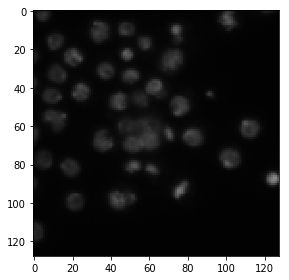

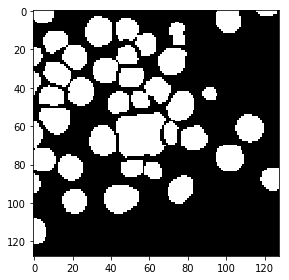

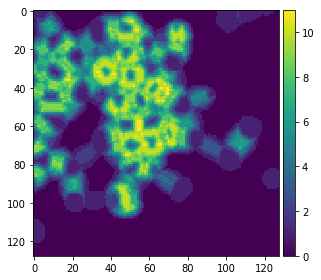

In [13]:
# randomly pick an image and it related mask
image_x = random.randint(0,len(train_ids))
imshow(X_train[image_x])
plt.show()
imshow(np.squeeze(Y_train[image_x]))
plt.show()
imshow(np.squeeze(train_weightmap[image_x]))
plt.show()

In [10]:


#jaidevd.github.io/blog/posts/code/weighted_loss_unet.py /
#@jaidevd
#jaidevd Add script to show the weighted loss integration for UNET


# coding: utf-8

from keras import layers as L
from keras import backend as K
from keras.models import Model
import tensorflow as tf
import numpy as np

_epsilon = tf.convert_to_tensor(K.epsilon(), np.float32)


def my_loss(target, output):
    """
    A custom function defined to simply sum the pixelwise loss.
    This function doesn't compute the crossentropy loss, since that is made a
    part of the model's computational graph itself.
    Parameters
    ----------
    target : tf.tensor
        A tensor corresponding to the true labels of an image.
    output : tf.tensor
        Model output
    Returns
    -------
    tf.tensor
        A tensor holding the aggregated loss.
    """
    return - tf.reduce_sum(target * output,
                           len(output.get_shape()) - 1)


def make_weighted_loss_unet(input_shape, n_classes):
    # two inputs, one for the image and one for the weight maps
    ip = L.Input(shape=input_shape)
    # the shape of the weight maps has to be such that it can be element-wise
    # multiplied to the softmax output.
    weight_ip = L.Input(shape=input_shape[:2] + (n_classes,))

    # adding the layers
    conv1 = L.Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(ip)
    conv1 = L.Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv1)
    conv1 = L.Dropout(0.1)(conv1)
    mpool1 = L.MaxPool2D()(conv1)

    conv2 = L.Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(mpool1)
    conv2 = L.Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv2)
    conv2 = L.Dropout(0.2)(conv2)
    mpool2 = L.MaxPool2D()(conv2)

    conv3 = L.Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(mpool2)
    conv3 = L.Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv3)
    conv3 = L.Dropout(0.3)(conv3)
    mpool3 = L.MaxPool2D()(conv3)

    conv4 = L.Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(mpool3)
    conv4 = L.Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv4)
    conv4 = L.Dropout(0.4)(conv4)
    mpool4 = L.MaxPool2D()(conv4)

    conv5 = L.Conv2D(1024, 3, activation='relu', padding='same', kernel_initializer='he_normal')(mpool4)
    conv5 = L.Conv2D(1024, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv5)
    conv5 = L.Dropout(0.5)(conv5)

    up6 = L.Conv2DTranspose(512, 2, strides=2, kernel_initializer='he_normal', padding='same')(conv5)
    conv6 = L.Concatenate()([up6, conv4])
    conv6 = L.Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv6)
    conv6 = L.Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv6)
    conv6 = L.Dropout(0.4)(conv6)

    up7 = L.Conv2DTranspose(256, 2, strides=2, kernel_initializer='he_normal', padding='same')(conv6)
    conv7 = L.Concatenate()([up7, conv3])
    conv7 = L.Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv7)
    conv7 = L.Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv7)
    conv7 = L.Dropout(0.3)(conv7)

    up8 = L.Conv2DTranspose(128, 2, strides=2, kernel_initializer='he_normal', padding='same')(conv7)
    conv8 = L.Concatenate()([up8, conv2])
    conv8 = L.Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv8)
    conv8 = L.Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv8)
    conv8 = L.Dropout(0.2)(conv8)

    up9 = L.Conv2DTranspose(64, 2, strides=2, kernel_initializer='he_normal', padding='same')(conv8)
    conv9 = L.Concatenate()([up9, conv1])
    conv9 = L.Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv9)
    conv9 = L.Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv9)
    conv9 = L.Dropout(0.1)(conv9)

    c10 = L.Conv2D(n_classes, 1, activation='softmax', kernel_initializer='he_normal')(conv9)
    # have to use softmax for the output layer before applying binary cross_entropy loss

    # Add a few non trainable layers to mimic the computation of the crossentropy
    # loss, so that the actual loss function just has to peform the
    # aggregation.
    c11 = L.Lambda(lambda x: x / tf.reduce_sum(x, len(x.get_shape()) - 1, True))(c10)
    c11 = L.Lambda(lambda x: tf.clip_by_value(x, _epsilon, 1. - _epsilon))(c11)
    # calculate the normal binary cross entropy manually
    
    c11 = L.Lambda(lambda x: K.log(x))(c11) # taking the log
    weighted_sm = L.multiply([c11, weight_ip]) # finally multiply the weight map with the probability map
    # so I think weight_ip should be make_weight_map(input)

    model = Model(inputs=[ip, weight_ip], outputs=[weighted_sm])
    return model

Using TensorFlow backend.


In [ ]:
# https://towardsdatascience.com/advanced-keras-constructing-complex-custom-losses-and-metrics-c07ca130a618
# customize 